In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from scipy.interpolate import interp1d
import json

In [7]:
date = "20230912"
subject = 'KB'
exp = 'VM'
SDS1_time_resolution = 0.10404# [sec/point] 0.10129 0.10404
SDS2_time_resolution = 0.1 # [sec/point]
baseline_end = 60 # [sec]
HP_end = 75 #[sec]
recovery_end = 675  #[sec]

using_SDS = 'SDS2'

In [8]:
# get processed long ch. data
data2 = pd.read_csv(os.path.join("dataset", subject, "SDS2", date, exp, f'in_vivo_result_{exp}.csv')) # wl resolution = 0.171 nm, time resolution = 0.1 secs
np_data2 = data2.to_numpy()[:round(recovery_end/SDS2_time_resolution),2:]
used_wl2 = [float(k.split('nm')[0]) for k in data2.keys().to_list()[2:]]
max_id2 = np.where(data2['peak']==1)[0]
min_id2 = np.where(data2['peak']==-1)[0]

max_id2 = max_id2[np.where(max_id2<round(recovery_end/SDS2_time_resolution))[0]]
min_id2 = min_id2[np.where(min_id2<round(recovery_end/SDS2_time_resolution))[0]]

# get processed short ch. data & sync to use same peak.
data = pd.read_csv(os.path.join("dataset", subject, "SDS1", date, exp, f'in_vivo_result_{exp}.csv')) # wl resolution = 0.171 nm, time resolution =  secs
np_data = data.to_numpy()[:round(recovery_end/SDS1_time_resolution),2:]
used_wl = [float(k.split('nm')[0]) for k in data.keys().to_list()[2:]]
max_id1 = np.where(data['peak']==1)[0]
min_id1 = np.where(data['peak']==-1)[0]

max_id1 = max_id1[np.where(max_id1<round(recovery_end/SDS1_time_resolution))[0]]
min_id1 = min_id1[np.where(min_id1<round(recovery_end/SDS1_time_resolution))[0]]

## Adjust Wavelength

In [9]:
with open(os.path.join("OPs_used", "wavelength.json"), 'r') as f:
    wavelength = json.load(f)
    wavelength = wavelength['wavelength']
wavelength = np.array(wavelength)

## adjust short ch.
# Cubic spline interpolation
f_interpolate = interp1d(used_wl, np_data, kind='linear', bounds_error=False, fill_value='extrapolate')
used_wl_data = f_interpolate(wavelength)

# f_interpolate_ch1 = interp1d(used_wl_ch1, np_data_ch1, kind='linear', bounds_error=False, fill_value='extrapolate')
# used_wl_data_ch1 = f_interpolate_ch1(wavelength)

# f_interpolate_ch2 = interp1d(used_wl_ch2, np_data_ch2, kind='linear', bounds_error=False, fill_value='extrapolate')
# used_wl_data_ch2 = f_interpolate_ch2(wavelength)

## adjust long ch.
# get cumulate wavelength index
acumulate_table = {}
accmulate_range_of_wl = 2 # [nm]
for comp_wl in wavelength:
    cumulate_index = []
    for idx, each_used_wl in enumerate(used_wl2):
        if abs(float(each_used_wl) - comp_wl) < accmulate_range_of_wl:
            cumulate_index += [idx]
    acumulate_table[comp_wl] = cumulate_index

# used cumulate wavelength index to binning
for idx, wl in enumerate(acumulate_table.keys()):
    accmulate_idx = acumulate_table[wl]
    each_wl_data = np_data2[:, accmulate_idx]
    mean_of_each_wl_data = each_wl_data.mean(1).reshape(-1,1)
    if idx == 0:
        used_wl_data2 = mean_of_each_wl_data
    else:
        used_wl_data2 = np.concatenate((used_wl_data2, mean_of_each_wl_data), axis=1)

In [10]:
os.makedirs(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS), exist_ok=True)

In [11]:
# calibration

# cali short ch.
cali = pd.read_csv(os.path.join('dataset', subject, 'calibration_result', date, 'calibrate_SDS_1.csv'))
cali = cali.to_numpy()
cali_used_wl_data = (used_wl_data*cali[0] + cali[1])

# cali long ch.
cali2 = pd.read_csv(os.path.join('dataset', subject, 'calibration_result', date, 'calibrate_SDS_2.csv'))
cali2 = cali2.to_numpy()
cali_used_wl_data2 = (used_wl_data2*cali2[0] + cali2[1])

In [13]:
wavelength

array([700, 710, 717, 725, 732, 740, 743, 748, 751, 753, 758, 763, 768,
       780, 792, 798, 805, 815, 830, 850])

In [ ]:

average_time = 30
time = 10
time_resolution = SDS1_time_resolution
time_resolution2 = SDS2_time_resolution

if using_SDS == 'SDS2':
    using_data = used_wl_data2
    using_max = max_id2
    using_min = min_id2
elif using_SDS == 'SDS1':
    using_data = used_wl_data
    using_max = max_id1
    using_min = min_id1

sds2_ijv_small = using_data[using_max[np.where(abs(using_max-round(time/time_resolution2))<round(average_time/time_resolution2))]].mean(0)
sds2_ijv_large = using_data[using_min[np.where(abs(using_min-round(time/time_resolution2))<round(average_time/time_resolution2))]].mean(0)
RmaxRmin_1 = np.log(sds2_ijv_small/sds2_ijv_large)
# np.save(os.path.join("dataset", subject, using_SDS, date, exp, f"{using_SDS}_OD_baseline.npy"), RmaxRmin_1)

for time in range(0, recovery_end-10, 10):
    average_time = 10
    sds2_ijv_small = using_data[using_max[np.where(abs(using_max-round(time/time_resolution2))<round(average_time/time_resolution2))]].mean(0)
    sds2_ijv_large = using_data[using_min[np.where(abs(using_min-round(time/time_resolution2))<round(average_time/time_resolution2))]].mean(0)
    RmaxRmin_2 = np.log(sds2_ijv_small/sds2_ijv_large)

    # np.save(os.path.join("dataset", subject, using_SDS, date, exp, f"{using_SDS}_OD_{time}s.npy"), RmaxRmin_2)

    plt.figure()
    plt.title(f'time: {time}s')
    # plt.plot(wavelength, RmaxRmin_1, 'o-', label='baseline')
    # plt.plot(wavelength, RmaxRmin_2, 'o-', label=f'T={time}s')
    plt.plot(wavelength, RmaxRmin_2-RmaxRmin_1, 'o-', label=f'T={time}s')
    plt.xlabel('wavelength')
    plt.ylabel('ln(Rmax/Rmin)')
    plt.ylim([-0.05, 0.05])
    plt.legend()
    # plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, f'time_{time}s.png'), dpi=300, format='png', bbox_inches='tight')
    plt.show()
    
# time = 100
# time_resolution = SDS1_time_resolution
# time_resolution2 = SDS2_time_resolution
# for time in range(10, recovery_end, 10):
#     sds2_ijv_small = using_data[using_max[np.where(abs(using_max-round(time/time_resolution2))<round(average_time/time_resolution2))]].mean(0)
#     sds2_ijv_large = using_data[using_min[np.where(abs(using_min-round(time/time_resolution2))<round(average_time/time_resolution2))]].mean(0)
#     RmaxRmin_2 = np.log(sds2_ijv_small/sds2_ijv_large)

#     RmaxRmin = RmaxRmin_2 - RmaxRmin_1
#     plt.figure()
#     plt.title(f'{using_SDS}, basetime=10 sec, comptime={time} sec, RmaxRmin={np.mean(sds2_ijv_small/sds2_ijv_large):.4f}')
#     plt.plot(wavelength, RmaxRmin, "o--")
#     plt.axhline(y=0, linestyle='--', color='r')
#     plt.xlabel('wavelength(nm)')
#     plt.ylabel('$\Delta$ln(Rmax/Rmin)')
#     plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, f'time_{time}s.png'), dpi=300, format='png', bbox_inches='tight')
#     plt.close()


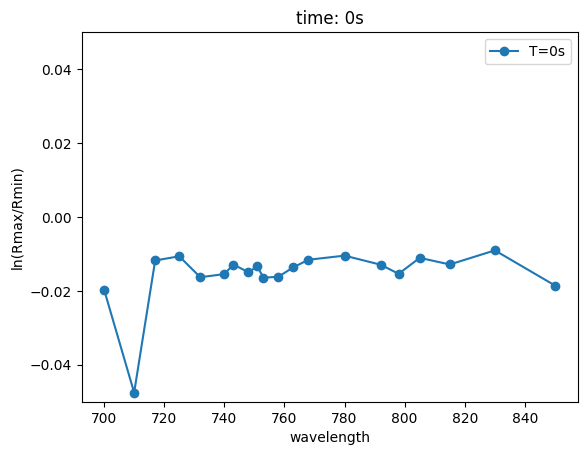

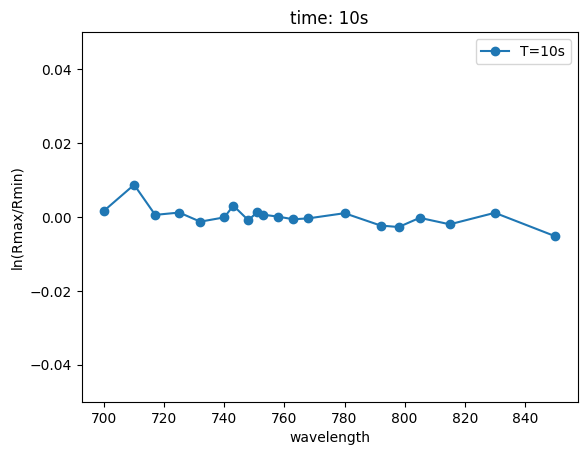

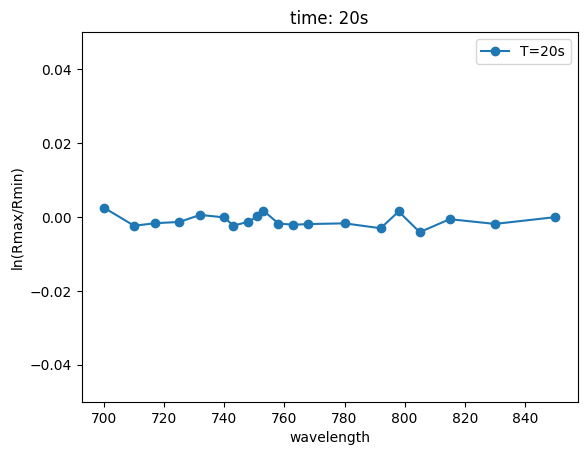

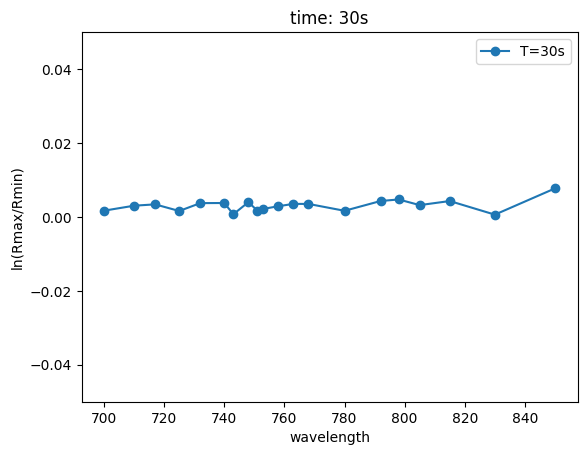

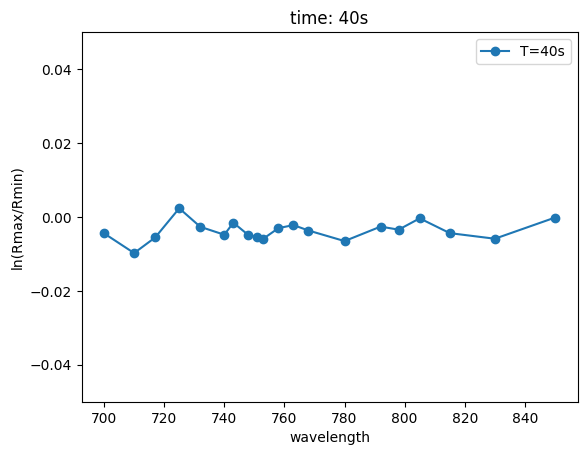

...

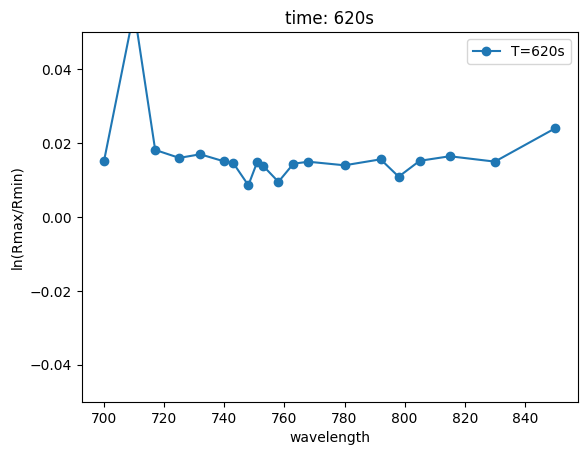

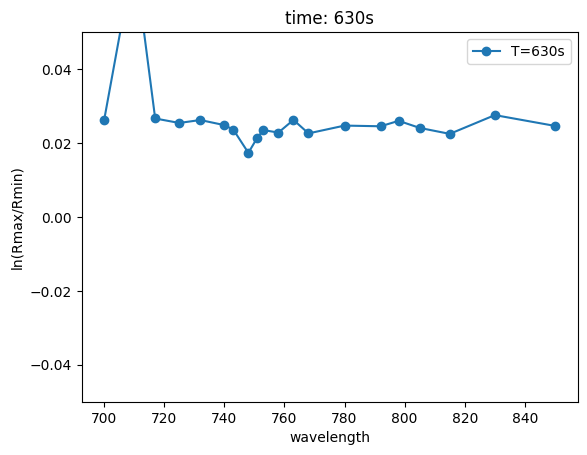

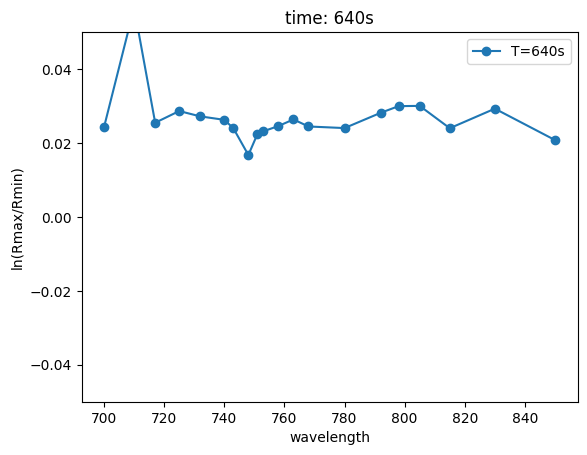

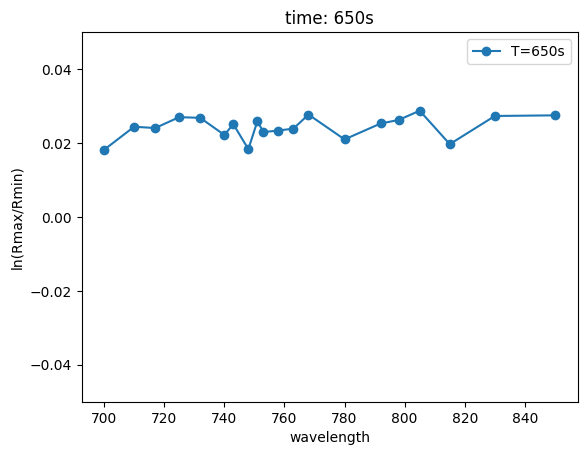

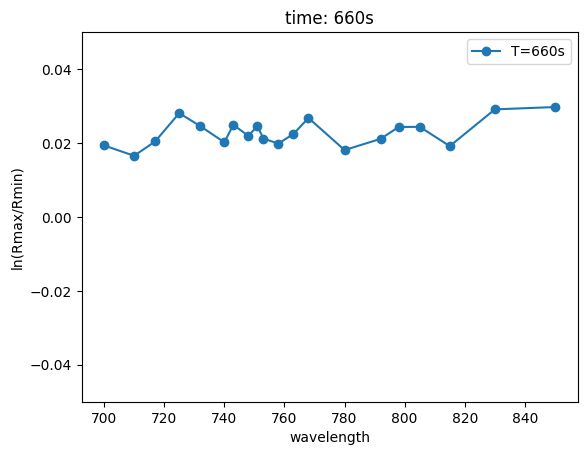

In [19]:

average_time = 30
time = 10
time_resolution = SDS1_time_resolution
time_resolution2 = SDS2_time_resolution

if using_SDS == 'SDS2':
    using_data = used_wl_data2
    using_max = max_id2
    using_min = min_id2
elif using_SDS == 'SDS1':
    using_data = used_wl_data
    using_max = max_id1
    using_min = min_id1

sds2_ijv_small = using_data[using_max[np.where(abs(using_max-round(time/time_resolution2))<round(average_time/time_resolution2))]].mean(0)
sds2_ijv_large = using_data[using_min[np.where(abs(using_min-round(time/time_resolution2))<round(average_time/time_resolution2))]].mean(0)
RmaxRmin_1 = np.log(sds2_ijv_small/sds2_ijv_large)
# np.save(os.path.join("dataset", subject, using_SDS, date, exp, f"{using_SDS}_OD_baseline.npy"), RmaxRmin_1)

for time in range(0, recovery_end-10, 10):
    average_time = 10
    sds2_ijv_small = using_data[using_max[np.where(abs(using_max-round(time/time_resolution2))<round(average_time/time_resolution2))]].mean(0)
    sds2_ijv_large = using_data[using_min[np.where(abs(using_min-round(time/time_resolution2))<round(average_time/time_resolution2))]].mean(0)
    RmaxRmin_2 = np.log(sds2_ijv_small/sds2_ijv_large)

    # np.save(os.path.join("dataset", subject, using_SDS, date, exp, f"{using_SDS}_OD_{time}s.npy"), RmaxRmin_2)

    plt.figure()
    plt.title(f'time: {time}s')
    # plt.plot(wavelength, RmaxRmin_1, 'o-', label='baseline')
    # plt.plot(wavelength, RmaxRmin_2, 'o-', label=f'T={time}s')
    plt.plot(wavelength, RmaxRmin_2-RmaxRmin_1, 'o-', label=f'T={time}s')
    plt.xlabel('wavelength')
    plt.ylabel('ln(Rmax/Rmin)')
    plt.ylim([-0.05, 0.05])
    plt.legend()
    # plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, f'time_{time}s.png'), dpi=300, format='png', bbox_inches='tight')
    plt.show()
    
# time = 100
# time_resolution = SDS1_time_resolution
# time_resolution2 = SDS2_time_resolution
# for time in range(10, recovery_end, 10):
#     sds2_ijv_small = using_data[using_max[np.where(abs(using_max-round(time/time_resolution2))<round(average_time/time_resolution2))]].mean(0)
#     sds2_ijv_large = using_data[using_min[np.where(abs(using_min-round(time/time_resolution2))<round(average_time/time_resolution2))]].mean(0)
#     RmaxRmin_2 = np.log(sds2_ijv_small/sds2_ijv_large)

#     RmaxRmin = RmaxRmin_2 - RmaxRmin_1
#     plt.figure()
#     plt.title(f'{using_SDS}, basetime=10 sec, comptime={time} sec, RmaxRmin={np.mean(sds2_ijv_small/sds2_ijv_large):.4f}')
#     plt.plot(wavelength, RmaxRmin, "o--")
#     plt.axhline(y=0, linestyle='--', color='r')
#     plt.xlabel('wavelength(nm)')
#     plt.ylabel('$\Delta$ln(Rmax/Rmin)')
#     plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, f'time_{time}s.png'), dpi=300, format='png', bbox_inches='tight')
#     plt.close()


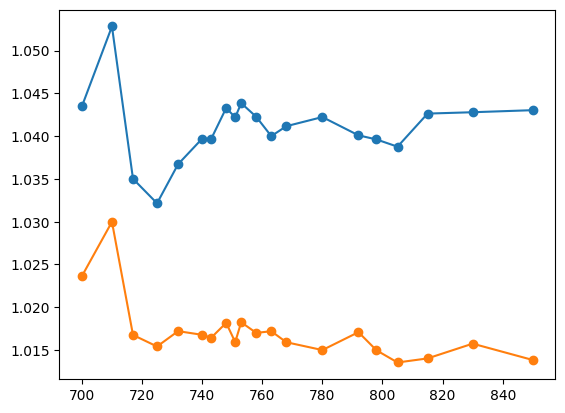

In [58]:
plt.plot(wavelength, RmaxRmin_1, 'o-')
plt.plot(wavelength, RmaxRmin_2, 'o-')
plt.show()

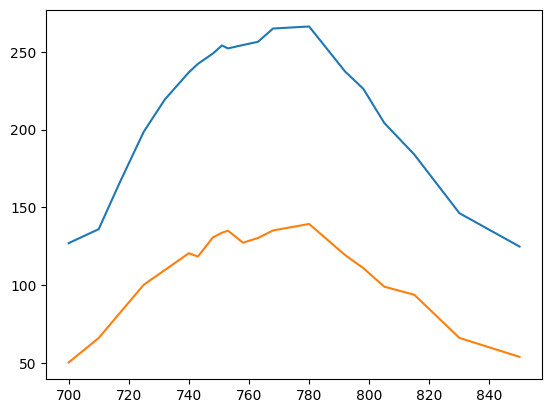

In [8]:
plt.plot(wavelength, sds2_ijv_small)
plt.plot(wavelength, sds2_ijv_large)
plt.show()

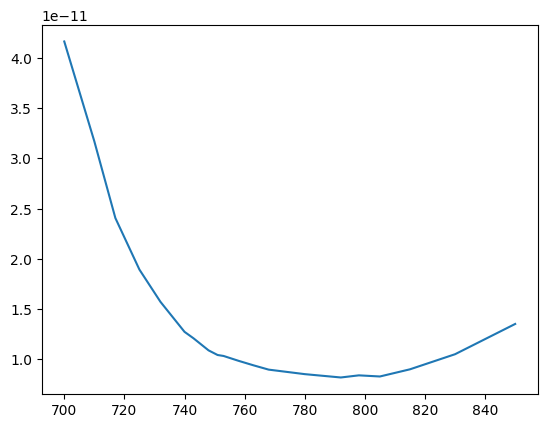

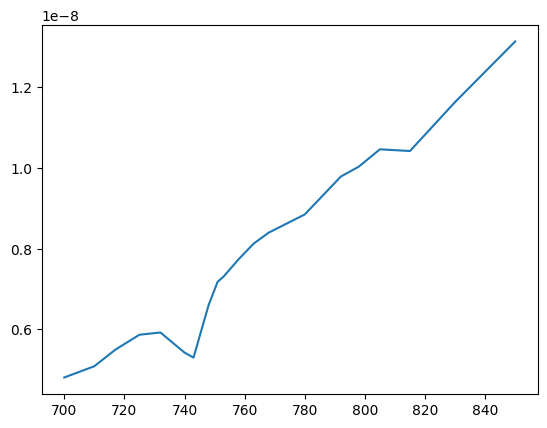

In [107]:
plt.plot(wavelength, cali2[0])
plt.show()

plt.plot(wavelength, cali2[1])
plt.show()

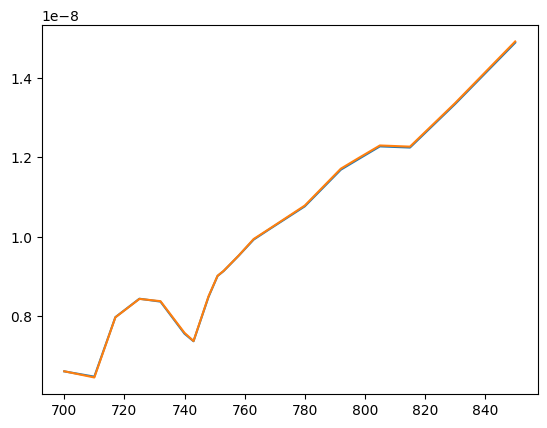

In [106]:
# cali long ch.
cali2 = pd.read_csv(os.path.join('dataset', subject, 'calibration_result', date, 'calibrate_SDS_2.csv'))
cali2 = cali2.to_numpy()
cali_used_wl_data2 = (used_wl_data2*cali2[0] + cali2[1])

average_time = 10
time = 90
sds2_ijv_small = cali_used_wl_data2[using_max[np.where(abs(using_max-round(time/time_resolution2))<round(average_time/time_resolution2))]].mean(0)
sds2_ijv_large = cali_used_wl_data2[using_min[np.where(abs(using_min-round(time/time_resolution2))<round(average_time/time_resolution2))]].mean(0)
# np.save("SDS2_ijv_large_baseline.npy", sds2_ijv_large)
plt.plot(wavelength, sds2_ijv_small)
plt.plot(wavelength, sds2_ijv_large)
plt.show()

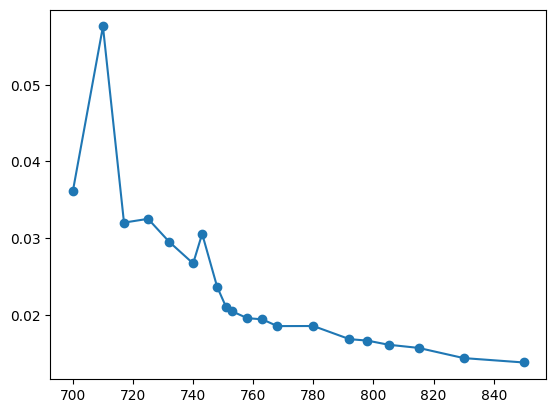

In [88]:
RmaxRmin_2 = np.log(sds2_ijv_small/sds2_ijv_large)
plt.plot(wavelength, RmaxRmin_2, 'o-')
plt.show()

In [ ]:
# import cv2 
# import os
# import random
# from glob import glob

# img = cv2.imread(os.path.join('pic', subject, f'{date}_invivo_result', exp, 'fitting', using_SDS, 'time_10s.png'))
# fps = 3
# size = (img.shape[1], img.shape[0]) # 寬 和 高
# print(size)
# fourcc = cv2.VideoWriter_fourcc('m', 'p', '4', 'v') #影片編碼格式
# videoWrite = cv2.VideoWriter(os.path.join('pic', subject, f'{date}_invivo_result', exp, 'fitting', using_SDS, 'video.mp4'), fourcc, fps, size)

# files = glob(os.path.join('pic', subject, f'{date}_invivo_result', exp, 'fitting', using_SDS, "time_*.png"))
# files = sorted(files, key=lambda x: int(x.split('.')[-2].split('_')[-1].split('s')[-2]))
# # images = [img for img in os.listdir(os.path.join('pic', subject, f'{date}_invivo_result',  'MBLL')) if img.endswith(".png")]
# out_num = len(files)
# for i in range(0, out_num, 1):
#     fileName = files[i]
#     img = cv2.imread(fileName)
#     img = cv2.resize(img, size, interpolation = cv2.INTER_AREA)
#     videoWrite.write(img)
# videoWrite.release()

In [12]:
import torch
from ANN_models import SurrogateModel

large_ANN_model = SurrogateModel().cuda()
large_ANN_model.load_state_dict(torch.load(os.path.join('surrogate_model', 'kb', 'large_ANN_model.pth')))

small_ANN_model = SurrogateModel().cuda()
small_ANN_model.load_state_dict(torch.load(os.path.join('surrogate_model', 'kb', 'small_ANN_model.pth')))


<All keys matched successfully>

In [14]:
OPs = np.array(np.random.random((20,10)))
# OPs = torch.from_numpy(OPs).to(torch.float32).cuda()

mus_set = pd.read_csv(os.path.join("OPs_used","mus_set.csv")).to_numpy()
mua_set = pd.read_csv(os.path.join("OPs_used","mua_set.csv")).to_numpy()

tissue = ['skin', 'fat', 'muscle', 'blood']
with open(os.path.join("OPs_used", "wavelength.json"), 'r') as f:
    wavelength = json.load(f)
    wavelength = wavelength['wavelength']
    
# mus
MUSPBASEWL = 800 #nm
with open(os.path.join("OPs_used","mus_ab_bound.json"),"r") as f:
    mus_ab_bound = json.load(f)

# mua
data = pd.read_csv(os.path.join('OPs_used', 'absorbing_chromophores.csv'))
# get correspond wavelength
chromophores_wavelength = data['wl'].to_numpy() # convert 1/cm --> 1/mm
find_same_wl_idx = []
for i in range(len(wavelength)):
    find_same_wl_idx += [np.where(chromophores_wavelength == wavelength[i])[0][0]]
# adjust wavelength 
mel_mua_spec = data['melanan(cm)'].to_numpy()[find_same_wl_idx]*0.1 # convert 1/cm --> 1/mm
epi_mua_spec = data['epithelial cells(cm)'].to_numpy()[find_same_wl_idx]*0.1 # convert 1/cm --> 1/mm
hbo2_mua_spec = data['hbo2(cm)'].to_numpy()[find_same_wl_idx]*0.1 # convert 1/cm --> 1/mm
hb_mua_spec = data['hb(cm)'].to_numpy()[find_same_wl_idx]*0.1 # convert 1/cm --> 1/mm
col_mua_spec = data['collagen(cm)'].to_numpy()[find_same_wl_idx]*0.1 # convert 1/cm --> 1/mm
water_mua_spec = data['water(cm)'].to_numpy()[find_same_wl_idx]*0.1 # convert 1/cm --> 1/mm
lipid_mua_spec = data['lipid(cm)'].to_numpy()[find_same_wl_idx]*0.1 # convert 1/cm --> 1/mm
with open(os.path.join("OPs_used", "absorbing_chromophores_frac.json"), "r") as f:
    absorbing_chromophores_frac = json.load(f)


def OPs_normalized(OPs):
    """_summary_

    Args:
        OPs (_type_): _description_

    Returns:
        Numpy array: [skin_mus, fat_mus, muscle_mus, ijv_mus, cca_mus, 
                    skin_mua, fat_mua, muscle_mua, ijv_mua, cca_mua]
    """
    
    # normalized OPs
    OPs_normalized = torch.from_numpy(OPs)
    max_mus = np.max(mus_set, axis=0)[:5]
    max_mua = np.max(mua_set, axis=0)[:5]
    x_max = torch.from_numpy(np.concatenate((max_mus,max_mua)))
    min_mus = np.min(mus_set, axis=0)[:5]
    min_mua = np.min(mua_set, axis=0)[:5]
    x_min = torch.from_numpy(np.concatenate((min_mus,min_mua)))
    OPs_normalized = (OPs_normalized - x_min) / (x_max - x_min)
    
    return OPs_normalized

def calculateMua(f_blood, SO2, f_fat, f_water, f_mel, f_col):
    """_summary_

    Args:
        f_blood (float): _description_
        SO2 (float): in [0,1]
        f_fat (float): _description_
        f_water (float): _description_
        f_mel (float): _description_
        f_col (float): _description_

    Returns:
        NParray: 1D array (spectrum)
    """

    mua_spec = f_water*water_mua_spec + f_mel*mel_mua_spec + f_fat*lipid_mua_spec + \
        SO2*f_blood*150*2.303/64500*hbo2_mua_spec + (1-SO2)*f_blood*150*2.303/64500*hb_mua_spec + f_col*col_mua_spec
    
    return mua_spec

def calculateMus(tissue, a, b):
    mus_spec = []
    for wl in wavelength:
        musp = a * (wl/MUSPBASEWL) ** (-b)
        if tissue == "blood":
            mus = musp/(1-0.95)
        else:
            mus = musp/(1-0.9)
        mus_spec.append(mus)
    return np.array(mus_spec)

def fun(args, need_fit_data, weight, channel):
    """_summary_

    Args:
        skin_mus: [a1, k1]
        fat_mus: [a2, k2]
        muscle_mus: [a3, k3]
        blood_mus: [a4, k4]
        args (int): args[:8] = [a1, k1, a2, k2, a3, k3, a4, k4]
        
        skin_mua: [f_blood, SO2, f_fat, f_water, f_mel, f_col]
        fat_mua: [f_blood, SO2, f_fat, f_water, f_mel, f_col]
        muscle_mua: [f_blood, SO2, f_fat, f_water, f_mel, f_col]
        ijv_mua: [f_blood, SO2, f_fat, f_water, f_mel, f_col]
        cca_mua: [f_blood, SO2, f_fat, f_water, f_mel, f_col]
        args (int): args[8:30] = [skin_mua(6), fat_mua(6), muscle_mua(6), ijv_mua(6), cca_mua(6)]
        
        need_fit_data (Numpy array(1D)): 
        weight (Numpy Array(1D)): wavelengthwise weight
        channel (int): 0 = short ch., 1 = long ch.
        
    Returns:
        float : RMSPE loss
    """
    # mus
    a1, k1 = args[0], args[1]
    a2, k2 = args[2], args[3]
    a3, k3 = args[4], args[5]
    a4, k4 = args[6], args[7]
    skin_mus_spec = calculateMus('skin', a1, k1).reshape(-1, 1) 
    fat_mus_spec = calculateMus('fat', a2, k2).reshape(-1, 1) 
    muscle_mus_spec = calculateMus('muscle', a3, k3).reshape(-1, 1)
    ijv_mus_spec = calculateMus('blood', a4, k4).reshape(-1, 1)
    cca_mus_spec = ijv_mus_spec.copy()
    mus_spec = np.concatenate((skin_mus_spec, fat_mus_spec, muscle_mus_spec, ijv_mus_spec, cca_mus_spec), axis=1)
    
    # mua
    skin_mua_spec = calculateMua(*args[8:14]).reshape(-1, 1) 
    fat_mua_spec = calculateMua(*args[14:20]).reshape(-1, 1) 
    muscle_mua_spec = calculateMua(*args[20:26]).reshape(-1, 1) 
    ijv_mua_spec = calculateMua(*args[26:32]).reshape(-1, 1) 
    cca_mua_spec = calculateMua(*args[32:38]).reshape(-1, 1) 
    mua_spec = np.concatenate((skin_mua_spec, fat_mua_spec, muscle_mua_spec, ijv_mua_spec, cca_mua_spec), axis=1)
    
    # OPs1 = args[:200].reshape((20,-1))
    # OPs2 = args[200:].reshape((20,-1))
    OPs2 = np.concatenate((mus_spec, mua_spec), axis=1)
    
    # OPs1_normalized = OPs_normalized(OPs1) # Nx: wavelength, Ny: tissue = {skin, fat, muscle, ijv, cca}
    # ln_R_large = large_ANN_model(OPs1_normalized.to(torch.float32).cuda())
    # R_large = torch.exp(-ln_R_large).detach().cpu().numpy()
    # ln_R_small = small_ANN_model(OPs1_normalized.to(torch.float32).cuda())
    # R_small = torch.exp(-ln_R_small).detach().cpu().numpy()
    # predict_RmaxRmin_1 = np.log(R_small/R_large)
    
    OPs2_normalized = OPs_normalized(OPs2)
    ln_R_large = large_ANN_model(OPs2_normalized.to(torch.float32).cuda())
    R_large = torch.exp(-ln_R_large).detach().cpu().numpy() + 1e-9
    # # do normalize 
    # for R in R_large:
    #     if R_large.max() == R_large.min():
    #         break
    #     else:
    #         R_large = (R_large - R_large.min()) / (R_large.max() - R_large.min()) + 1e-9
    
    ln_R_small = small_ANN_model(OPs2_normalized.to(torch.float32).cuda())
    R_small = torch.exp(-ln_R_small).detach().cpu().numpy() + 1e-9
    # # do normalize
    # for R in R_small:
    #     if R_small.max() == R_small.min():
    #         break
    #     else:
    #         R_small = (R_small - R_small.min()) / (R_small.max() - R_small.min()) + 1e-9
    
    predict_RmaxRmin_2 = np.log(R_small/R_large)
    # predict_RmaxRmin_2 = R_large
    
    # predict_delta_RmaxRmin = predict_RmaxRmin_2 - predict_RmaxRmin_1
    
    loss = np.sqrt(np.mean(np.square(100*weight*(predict_RmaxRmin_2[:,channel] - need_fit_data)/need_fit_data))) 
    # if np.sum(predict_RmaxRmin_2[:,channel]) < 0.00001:
    #     loss = 1000000000
    # else:
    #     loss = np.sqrt(np.mean(np.square(100*weight*(predict_RmaxRmin_2[:,channel] - need_fit_data)/need_fit_data))) 
    
    # loss = np.sqrt(np.mean(np.square(100*weight*(predict_RmaxRmin_2[:,1] - need_fit_data)/need_fit_data))) 
    
    return loss

def Rmax_Rmin(args):
    # mus
    a1, k1 = args[0], args[1]
    a2, k2 = args[2], args[3]
    a3, k3 = args[4], args[5]
    a4, k4 = args[6], args[7]
    skin_mus_spec = calculateMus('skin', a1, k1).reshape(-1, 1) 
    fat_mus_spec = calculateMus('fat', a2, k2).reshape(-1, 1) 
    muscle_mus_spec = calculateMus('muscle', a3, k3).reshape(-1, 1)
    ijv_mus_spec = calculateMus('blood', a4, k4).reshape(-1, 1)
    cca_mus_spec = ijv_mus_spec.copy()
    mus_spec = np.concatenate((skin_mus_spec, fat_mus_spec, muscle_mus_spec, ijv_mus_spec, cca_mus_spec), axis=1)
    
    # mua
    skin_mua_spec = calculateMua(*args[8:14]).reshape(-1, 1) 
    fat_mua_spec = calculateMua(*args[14:20]).reshape(-1, 1) 
    muscle_mua_spec = calculateMua(*args[20:26]).reshape(-1, 1) 
    ijv_mua_spec = calculateMua(*args[26:32]).reshape(-1, 1) 
    cca_mua_spec = calculateMua(*args[32:38]).reshape(-1, 1) 
    mua_spec = np.concatenate((skin_mua_spec, fat_mua_spec, muscle_mua_spec, ijv_mua_spec, cca_mua_spec), axis=1)
    
    OPs2 = np.concatenate((mus_spec, mua_spec), axis=1)
    OPs2_normalized = OPs_normalized(OPs2)
    ln_R_large = large_ANN_model(OPs2_normalized.to(torch.float32).cuda())
    R_large = torch.exp(-ln_R_large).detach().cpu().numpy()
    ln_R_small = small_ANN_model(OPs2_normalized.to(torch.float32).cuda())
    R_small = torch.exp(-ln_R_small).detach().cpu().numpy()
    
    return R_large, R_small, ln_R_large, ln_R_small
    

In [15]:
from scipy.optimize import minimize

In [67]:
def plot_fitting_result(time, using_SDS, args, log_loss_short, log_loss_long, weight, need_fit_data):
    os.makedirs(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "loss"), exist_ok=True)
    os.makedirs(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "chromophore"), exist_ok=True)
    os.makedirs(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "mua"), exist_ok=True)
    os.makedirs(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "mus"), exist_ok=True)
    os.makedirs(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "spectrum"), exist_ok=True)
    
    # # plot loss
    # fig = plt.figure()
    # if time == 0:
    #     fig.suptitle(f"loss {using_SDS}, basline")
    # else:
    #     fig.suptitle(f"loss {using_SDS}, time = {time}s")
    # ax = plt.subplot(2, 1, 1)
    # ax.plot(log_loss_short, 'o')
    # ax.set_ylabel("loss")
    # ax.set_xlabel("fitting phase#")

    # ax = plt.subplot(2, 1, 2)
    # ax.plot(log_loss_long, 'o')
    # ax.set_ylabel("loss")
    # ax.set_xlabel("fitting phase#")
    # plt.tight_layout()
    # if time == 0:
    #     plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "loss", f'baseline_loss.png'), dpi=300, format='png', bbox_inches='tight')
    # else:
    #     plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "loss", f'{time}s_loss.png'), dpi=300, format='png', bbox_inches='tight')
    # plt.close()
    
    # plot mua 
    fig = plt.figure()
    if time == 0:
        fig.suptitle(f"{using_SDS}, basline")
    else:
        fig.suptitle(f"{using_SDS}, time = {time}s")

    skin_mua_spec = calculateMua(*args.x[8:14]).reshape(-1, 1) 
    ax = plt.subplot(2, 3, 1)
    ax.set_title('skin mua spectrum')
    ax.plot(wavelength, skin_mua_spec)
    ax.set_ylabel("mua($mm^{-1}$)")

    fat_mua_spec = calculateMua(*args.x[14:20]).reshape(-1, 1) 
    ax = plt.subplot(2, 3, 2)
    ax.set_title('fat mua spectrum')
    ax.plot(wavelength, fat_mua_spec)

    muscle_mua_spec = calculateMua(*args.x[20:26]).reshape(-1, 1) 
    ax = plt.subplot(2, 3, 3)
    ax.set_title('muscle mua spectrum')
    ax.plot(wavelength, muscle_mua_spec)

    ijv_mua_spec = calculateMua(*args.x[26:32]).reshape(-1, 1) 
    ax = plt.subplot(2, 3, 4)
    ax.set_title('ijv mua spectrum')
    ax.plot(wavelength, ijv_mua_spec)

    cca_mua_spec = calculateMua(*args.x[32:38]).reshape(-1, 1) 
    ax = plt.subplot(2, 3, 5)
    ax.set_title('cca mua spectrum')
    ax.plot(wavelength, cca_mua_spec)


    plt.tight_layout()
    if time == 0:
        plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "mua", 'baseline_mua.png'), dpi=300, format='png', bbox_inches='tight')
    else:
        plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "mua", f'{time}s_mua.png'), dpi=300, format='png', bbox_inches='tight')
    plt.show()
    # plt.close()
    
    # save chromophore table
    skin_mua_consist = args.x[8:14].reshape(1,-1)
    fat_mua_consist = args.x[14:20].reshape(1,-1)
    muscle_mua_consist = args.x[20:26].reshape(1,-1)
    ijv_mua_consist = args.x[26:32].reshape(1,-1)
    cca_mua_consist = args.x[32:38].reshape(1,-1)

    mua_chromophore_array = np.concatenate((skin_mua_consist, fat_mua_consist, muscle_mua_consist,
                                            ijv_mua_consist, cca_mua_consist))
    df = pd.DataFrame(mua_chromophore_array, columns=['f_blood', 'SO2', 'f_fat', 'f_water', 'f_mel', 'fol'], 
                    index=['skin', 'fat', 'muscle', 'ijv', 'cca'])
    if time == 0:
        df.to_csv(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "chromophore", 'baseline_chromophore.csv'))
    else:
        df.to_csv(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "chromophore", f'{time}s_chromophore.csv'))
        
    # plot mus
    fig = plt.figure()
    if time == 0:
        fig.suptitle(f"{using_SDS}, baseline")
    else:
        fig.suptitle(f"{using_SDS}, time = {time}s")

    a1, k1 = args.x[0], args.x[1]
    ax = plt.subplot(2, 2, 1)
    ax.set_title('skin mus spectrum')
    ax.plot(wavelength, calculateMus('skin', a1, k1).reshape(-1, 1))
    ax.set_ylabel("mus($mm^{-1}$)")

    a2, k2 = args.x[2], args.x[3]
    ax = plt.subplot(2, 2, 2)
    ax.set_title('fat mus spectrum')
    ax.plot(wavelength, calculateMus('fat', a2, k2).reshape(-1, 1) )

    a3, k3 = args.x[4], args.x[5]
    ax = plt.subplot(2, 2, 3)
    ax.set_title('muscle mus spectrum')
    ax.plot(wavelength, calculateMus('muscle', a3, k3).reshape(-1, 1) )

    a4, k4 = args.x[6], args.x[7]
    ax = plt.subplot(2, 2, 4)
    ax.set_title('blood mus spectrum')
    ax.plot(wavelength, calculateMus('blood', a4, k4).reshape(-1, 1) )
    plt.tight_layout()
    if time == 0:
        plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "mus", 'baseline_mus.png'), dpi=300, format='png', bbox_inches='tight')
    else:
        plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "mus", f'{time}s_mus.png'), dpi=300, format='png', bbox_inches='tight')
    plt.show()
    # plt.close()
    
    ## plot spectrum
    # mus
    a1, k1 = args.x[0], args.x[1]
    a2, k2 = args.x[2], args.x[3]
    a3, k3 = args.x[4], args.x[5]
    a4, k4 = args.x[6], args.x[7]
    skin_mus_spec = calculateMus('skin', a1, k1).reshape(-1, 1) 
    fat_mus_spec = calculateMus('fat', a2, k2).reshape(-1, 1) 
    muscle_mus_spec = calculateMus('muscle', a3, k3).reshape(-1, 1)
    ijv_mus_spec = calculateMus('blood', a4, k4).reshape(-1, 1)
    cca_mus_spec = ijv_mus_spec.copy()
    mus_spec = np.concatenate((skin_mus_spec, fat_mus_spec, muscle_mus_spec, ijv_mus_spec, cca_mus_spec), axis=1)

    # mua
    skin_mua_spec = calculateMua(*args.x[8:14]).reshape(-1, 1) 
    fat_mua_spec = calculateMua(*args.x[14:20]).reshape(-1, 1) 
    muscle_mua_spec = calculateMua(*args.x[20:26]).reshape(-1, 1) 
    ijv_mua_spec = calculateMua(*args.x[26:32]).reshape(-1, 1) 
    cca_mua_spec = calculateMua(*args.x[32:38]).reshape(-1, 1) 
    mua_spec = np.concatenate((skin_mua_spec, fat_mua_spec, muscle_mua_spec, ijv_mua_spec, cca_mua_spec), axis=1)

    OPs2 = np.concatenate((mus_spec, mua_spec), axis=1)
    OPs2_normalized = OPs_normalized(OPs2)
    ln_R_large = large_ANN_model(OPs2_normalized.to(torch.float32).cuda())
    R_large = torch.exp(-ln_R_large).detach().cpu().numpy() 
    ln_R_small = small_ANN_model(OPs2_normalized.to(torch.float32).cuda())
    R_small = torch.exp(-ln_R_small).detach().cpu().numpy() 
    predict_RmaxRmin_2 = np.log(R_small/R_large)
    # predict_RmaxRmin_2 = R_large
    if time == 0:
        plt.title(f'baseline, SO2 = {args.x[-11]*100:.2f}%, RMSPE: {np.sqrt(np.mean(np.square(100*weight*(predict_RmaxRmin_2[:,int(using_SDS[-1])-1] - need_fit_data)/need_fit_data))):.2f}%')
    else:
        plt.title(f'time = {time}s, SO2 = {args.x[-11]*100:.2f}%, RMSPE: {np.sqrt(np.mean(np.square(100*weight*(predict_RmaxRmin_2[:,int(using_SDS[-1])-1] - need_fit_data)/need_fit_data))):.2f}%')
    plt.plot(wavelength, predict_RmaxRmin_2[:,int(using_SDS[-1])-1], 'o-', label='fitting spectrum')
    plt.plot(wavelength, need_fit_data, 'o-', label="target spectrum")
    
    plt.ylabel("log(Rmax/Rmin)")
    plt.xlabel("wavelength(nm)")
    plt.legend(loc='center left', bbox_to_anchor=(1.05, 0.5),
            fancybox=True, shadow=True)
    if time == 0:
        plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "spectrum", 'baseline_spectrum.png'), dpi=300, format='png', bbox_inches='tight')
    else:
        plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "spectrum", f'{time}s_spectrum.png'), dpi=300, format='png', bbox_inches='tight')
    plt.show()
    # plt.close()

==========first phase==========
 message: Optimization terminated successfully
 success: True
  status: 0
     fun: 44.04981568265778
       x: [ 1.293e+00  8.564e-01 ...  0.000e+00  0.000e+00]
     nit: 48
     jac: [-5.767e+01 -1.789e+01 ...        nan        nan]
    nfev: 1488
    njev: 44


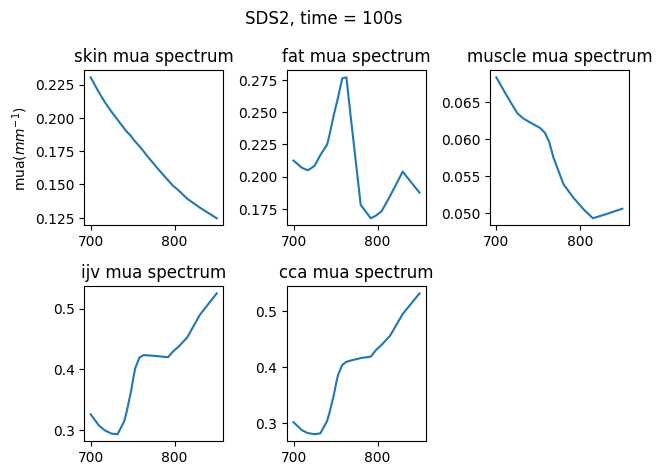

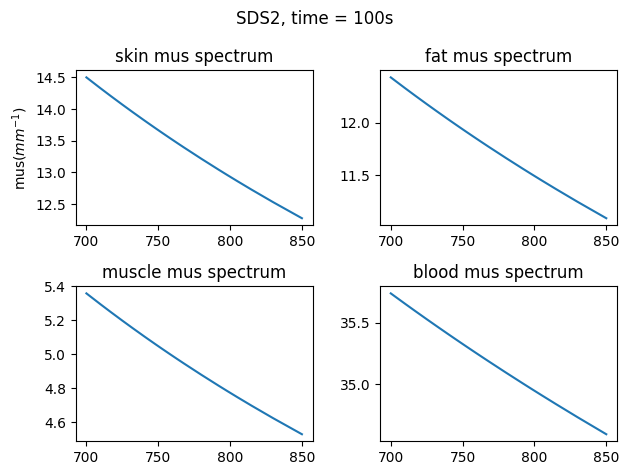

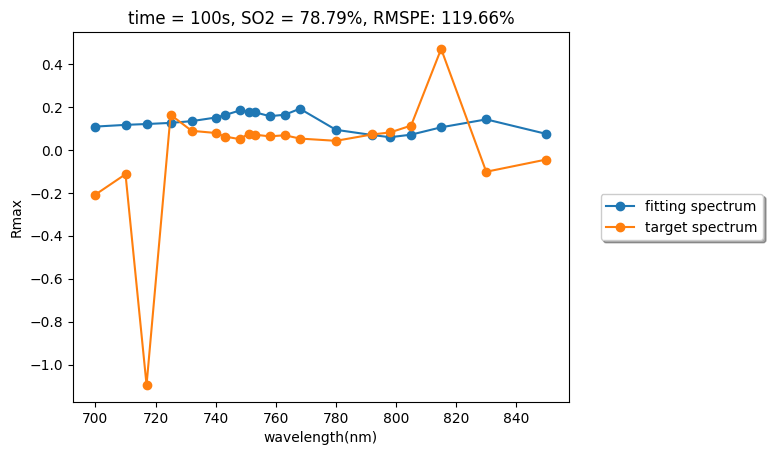

In [66]:
# only fit short channel
# for time in range(0, recovery_end-10, 10):
    
for time in [100]:
    if time == 0:
        # fit baseline go get stable superficial OPs
        need_fit_data_SDS1 = np.load(os.path.join("dataset", subject, 'SDS1', date, exp, f"SDS1_OD_baseline.npy"))
        need_fit_data_SDS2 = np.load(os.path.join("dataset", subject, 'SDS2', date, exp, f"SDS2_OD_baseline.npy"))
    else:
        # fit baseline go get stable superficial OPs
        need_fit_data_SDS1 = np.load(os.path.join("dataset", subject, 'SDS1', date, exp, f"SDS1_OD_baseline.npy"))
        need_fit_data_SDS2 = np.load(os.path.join("dataset", subject, 'SDS2', date, exp, f"SDS2_OD_{time}s.npy"))

    # 1st fit short 
    x0 = np.array([np.random.random()*(mus_ab_bound['skin']['max'][0]-mus_ab_bound['skin']['min'][0]), 
                np.random.random()*(mus_ab_bound['skin']['max'][1]-mus_ab_bound['skin']['min'][1]),
                np.random.random()*(mus_ab_bound['fat']['max'][0]-mus_ab_bound['fat']['min'][0]), 
                np.random.random()*(mus_ab_bound['fat']['max'][1]-mus_ab_bound['fat']['min'][1]),
                np.random.random()*(mus_ab_bound['muscle']['max'][0]-mus_ab_bound['muscle']['min'][0]), 
                np.random.random()*(mus_ab_bound['muscle']['max'][1]-mus_ab_bound['muscle']['min'][1]),
                np.random.random()*(mus_ab_bound['blood']['max'][0]-mus_ab_bound['blood']['min'][0]), 
                np.random.random()*(mus_ab_bound['blood']['max'][1]-mus_ab_bound['blood']['min'][1]),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                np.random.random(),
                ])

    bounds = ((mus_ab_bound['skin']['min'][0], mus_ab_bound['skin']['max'][0]), 
            (0.001, mus_ab_bound['skin']['max'][1]),
            (mus_ab_bound['fat']['min'][0], mus_ab_bound['fat']['max'][0]), 
            (mus_ab_bound['fat']['min'][1], mus_ab_bound['fat']['max'][1]),
            (mus_ab_bound['muscle']['min'][0], mus_ab_bound['muscle']['max'][0]), 
            (mus_ab_bound['muscle']['min'][1], mus_ab_bound['muscle']['max'][1]),
            (mus_ab_bound['blood']['min'][0], mus_ab_bound['blood']['max'][0]), 
            (mus_ab_bound['blood']['min'][1], mus_ab_bound['blood']['max'][1]),
            (absorbing_chromophores_frac['skin']['f_blood_bound'][0], absorbing_chromophores_frac['skin']['f_blood_bound'][1]),
            (absorbing_chromophores_frac['skin']['SO2_bound'][0], absorbing_chromophores_frac['skin']['SO2_bound'][1]),
            (0, 0),
            (absorbing_chromophores_frac['skin']['f_water_bound'][0], absorbing_chromophores_frac['skin']['f_water_bound'][1]),
            (absorbing_chromophores_frac['skin']['f_mel_bound'][0], absorbing_chromophores_frac['skin']['f_mel_bound'][1]),
            (0, None),
            (absorbing_chromophores_frac['fat']['f_blood_bound'][0], absorbing_chromophores_frac['fat']['f_blood_bound'][1]),
            (absorbing_chromophores_frac['fat']['SO2_bound'][0], absorbing_chromophores_frac['fat']['SO2_bound'][1]),
            (absorbing_chromophores_frac['fat']['f_fat_bound'][0], absorbing_chromophores_frac['fat']['f_fat_bound'][1]),
            (absorbing_chromophores_frac['fat']['f_water_bound'][0], absorbing_chromophores_frac['fat']['f_water_bound'][1]),
            (0, 0),
            (0, None),
            (absorbing_chromophores_frac['muscle']['f_blood_bound'][0], absorbing_chromophores_frac['muscle']['f_blood_bound'][1]),
            (absorbing_chromophores_frac['muscle']['SO2_bound'][0], absorbing_chromophores_frac['muscle']['SO2_bound'][1]),
            (0, 0),
            (absorbing_chromophores_frac['muscle']['f_water_bound'][0], absorbing_chromophores_frac['muscle']['f_water_bound'][1]),
            (0, 0),
            (0, None),
            (absorbing_chromophores_frac['ijv']['f_blood_bound'][0], absorbing_chromophores_frac['ijv']['f_blood_bound'][1]),
            (absorbing_chromophores_frac['ijv']['SO2_bound'][0], absorbing_chromophores_frac['ijv']['SO2_bound'][1]),
            (0, 0),
            (absorbing_chromophores_frac['ijv']['f_water_bound'][0], absorbing_chromophores_frac['ijv']['f_water_bound'][1]),
            (0, 0),
            (0, 0),
            (absorbing_chromophores_frac['cca']['f_blood_bound'][0], absorbing_chromophores_frac['cca']['f_blood_bound'][1]),
            (absorbing_chromophores_frac['cca']['SO2_bound'][0], absorbing_chromophores_frac['cca']['SO2_bound'][1]),
            (0, 0),
            (absorbing_chromophores_frac['cca']['f_water_bound'][0], absorbing_chromophores_frac['cca']['f_water_bound'][1]),
            (0, 0),
            (0, 0)
            )
    weight = np.array([0, 0, 0, 0.2, 0.4, 0.4, 0.5, 0.7, 0.7, 0.8, 1, 1, 0.9, 0.8, 0.8, 0.9, 1, 0.7, 0.8, 1])
    channel = 0
    res = minimize(fun, x0, args=(need_fit_data_SDS1, weight, channel), method='SLSQP', tol=1e-6, bounds=bounds, options={'eps': 0.000001, 'disp': False}) # 85s eps=0.00005,  long eps= 0.00000001
    print('==========first phase==========')
    print(res)
    
plot_fitting_result(time=time, using_SDS="SDS2", args=res, log_loss_short=0, log_loss_long=0, weight=weight, need_fit_data=need_fit_data_SDS1)

In [78]:
S2_AF_total_predict = np.load("S2_AF_total_predict.npy")
assume_base = 70
abs_SO2 = (S2_AF_total_predict + assume_base)/100
abs_SO2

array([0.69815901, 0.71665751, 0.69815901, 0.71665751, 0.71913475,
       0.72317353, 0.6937058 , 0.67069142, 0.6489746 , 0.65274381,
       0.65371952, 0.65365018, 0.65460967, 0.65292001, 0.65085629,
       0.65335986, 0.66767768, 0.67253126, 0.68038933, 0.68214671,
       0.69710519, 0.70486841, 0.7078136 , 0.70657455, 0.70700964,
       0.70847814, 0.7110911 , 0.70892534, 0.70763029, 0.7022171 ,
       0.68835434, 0.67920761, 0.67257033, 0.68731443, 0.69643423,
       0.70620812, 0.70614737, 0.71087988, 0.71160575, 0.715848  ,
       0.71113266, 0.70988608, 0.70510695, 0.70374367, 0.70626659,
       0.70792643, 0.71354964, 0.72053014, 0.71925705, 0.70458328,
       0.68567217, 0.68352613, 0.69606387, 0.69053824, 0.69021754,
       0.67900786, 0.70277782, 0.71045401, 0.72770598, 0.72281612,
       0.72128649, 0.71633287])

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

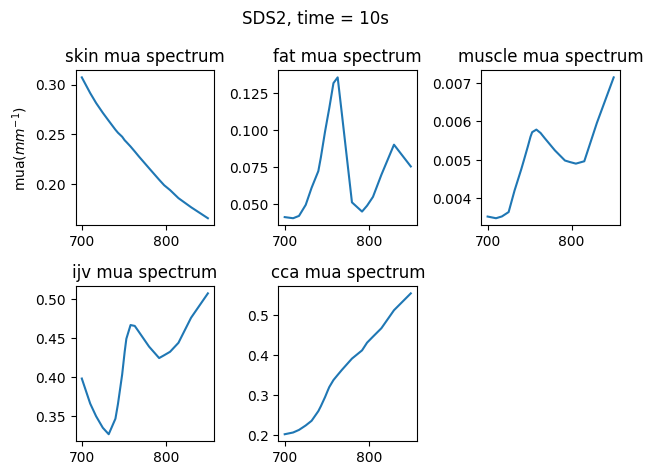

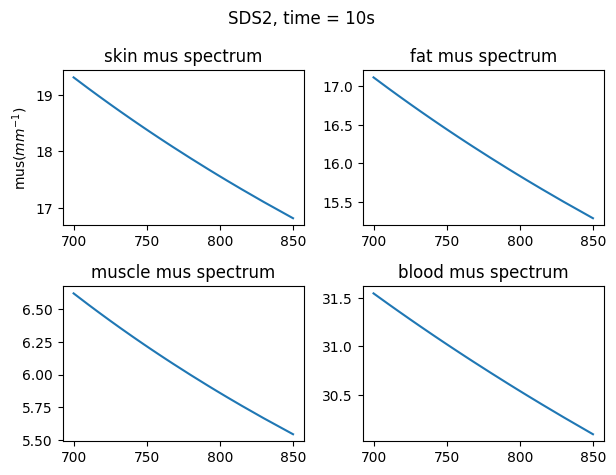

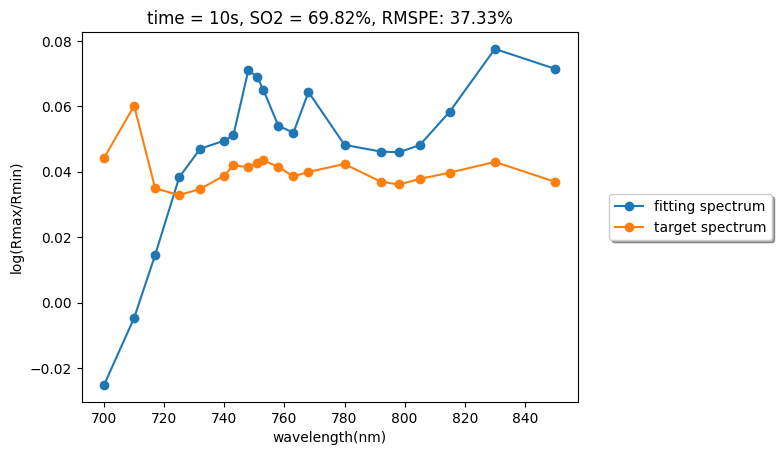

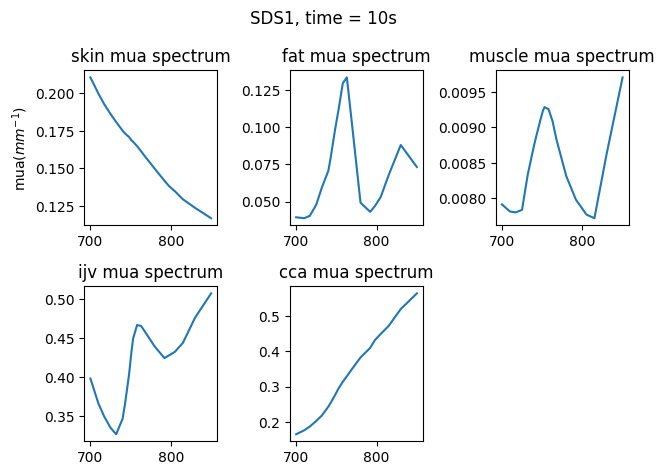

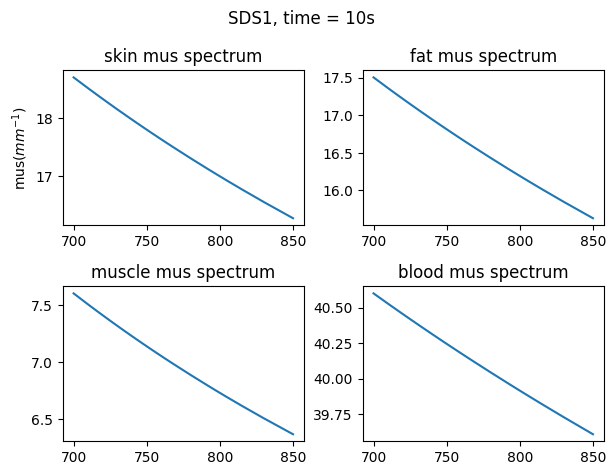

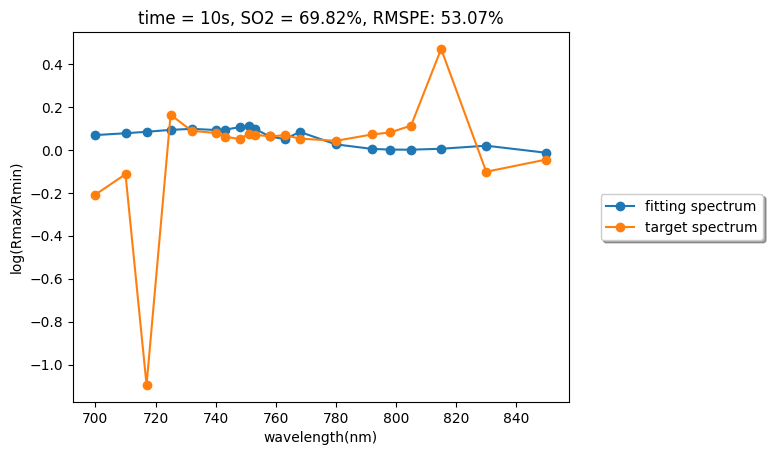

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

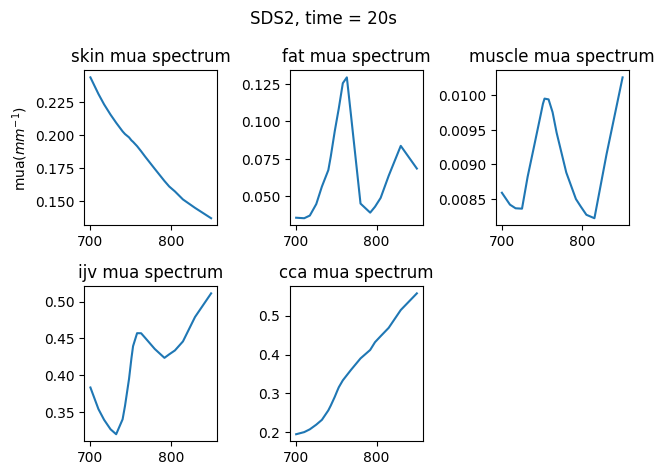

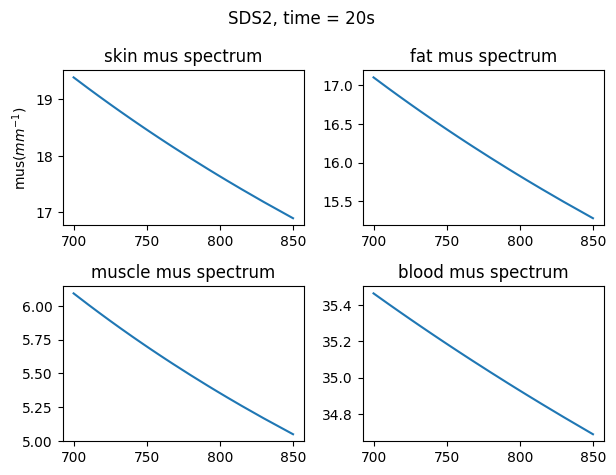

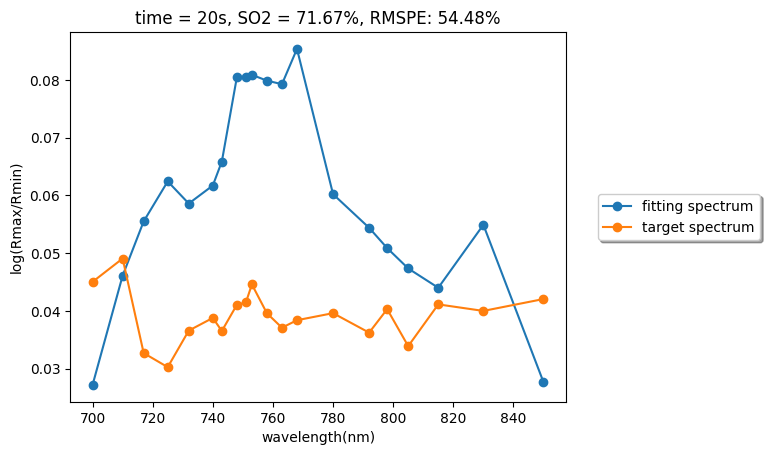

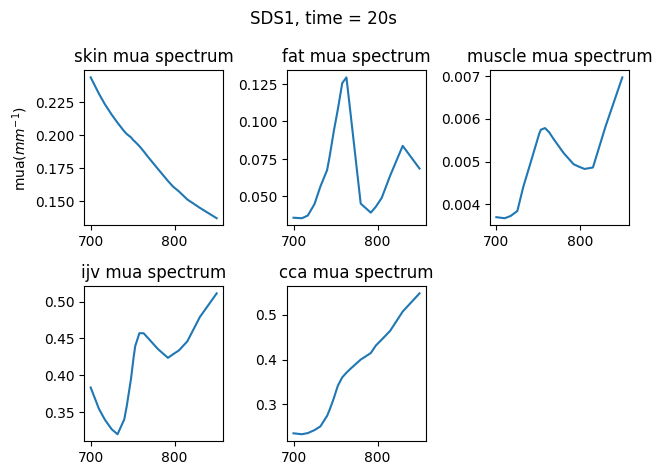

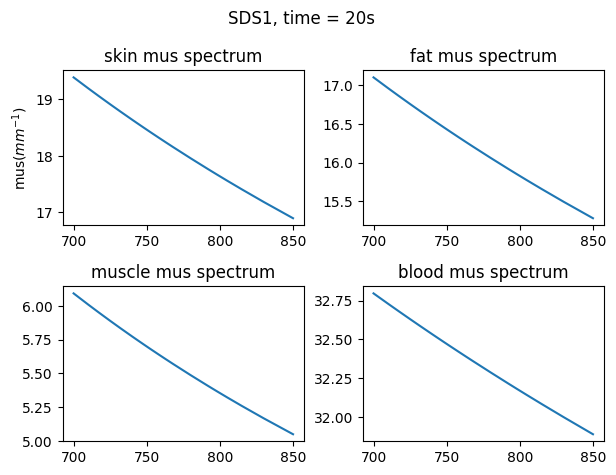

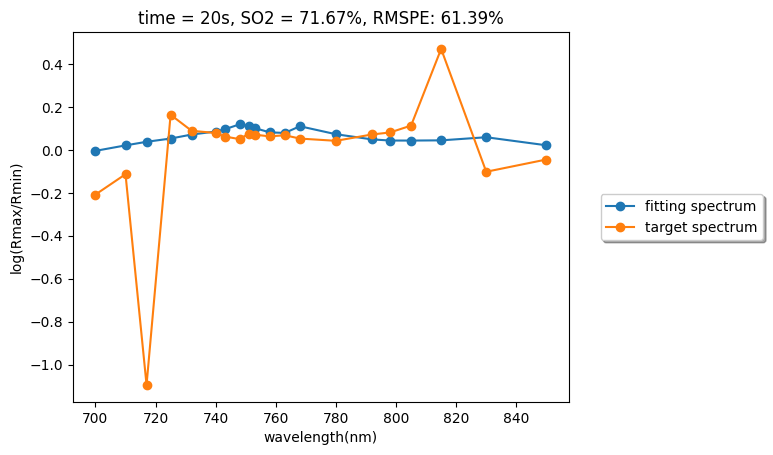

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

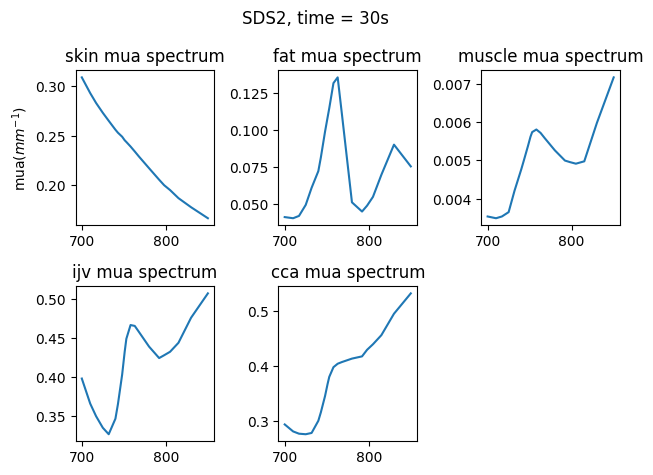

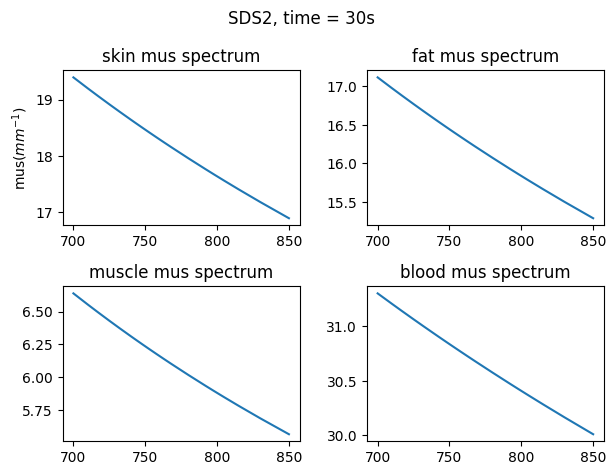

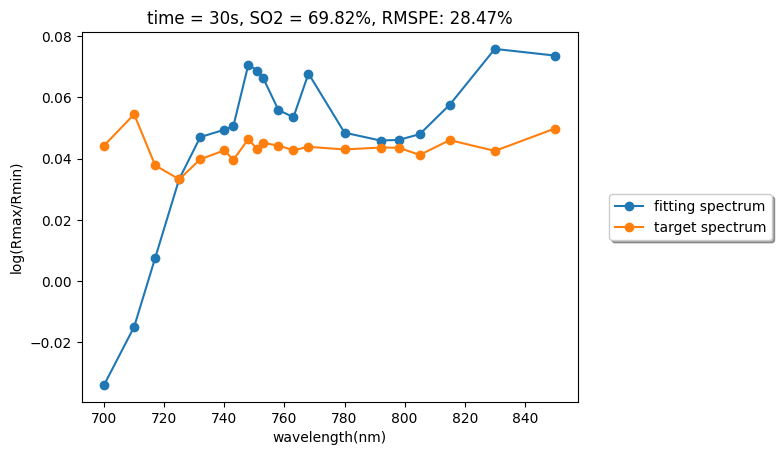

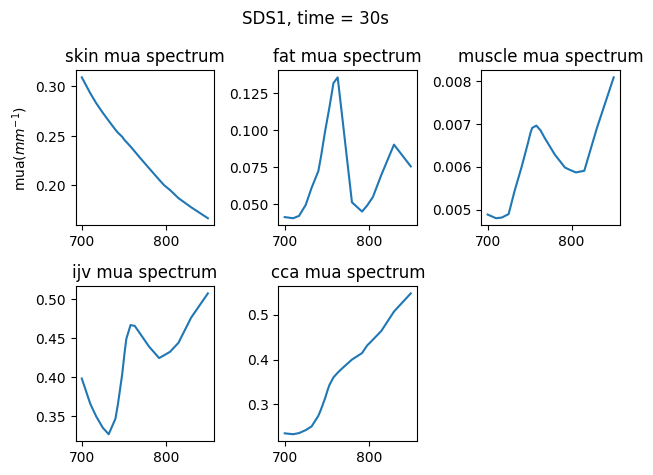

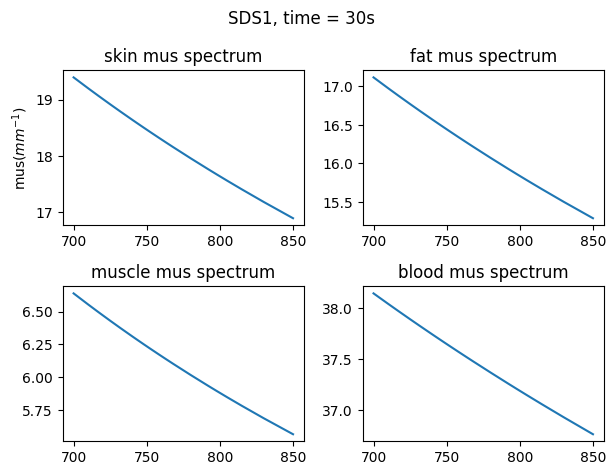

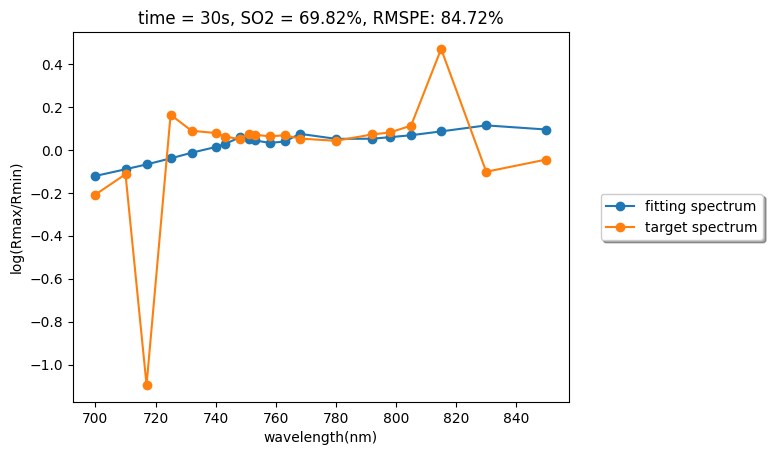

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

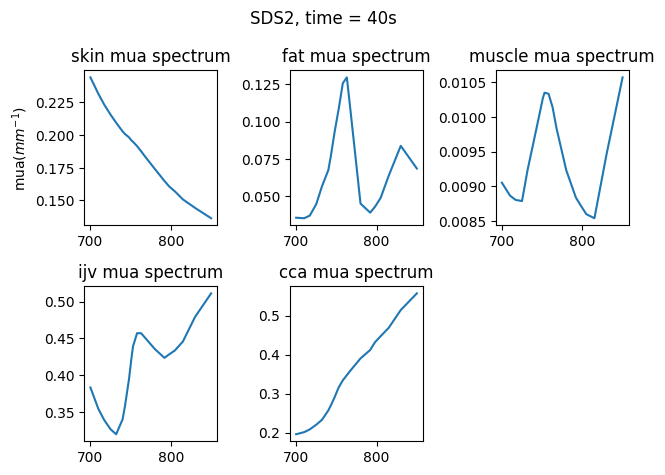

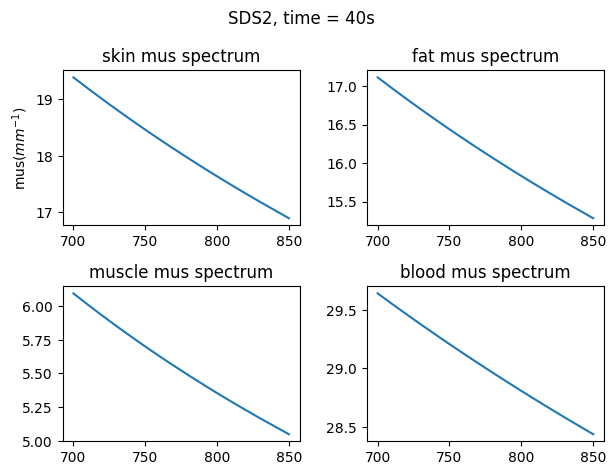

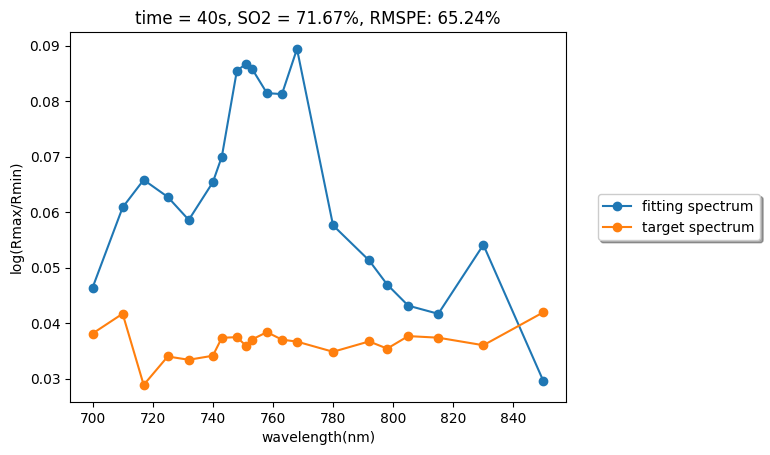

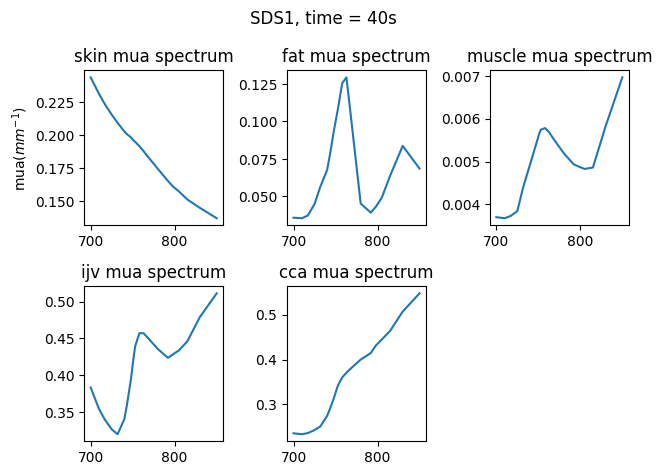

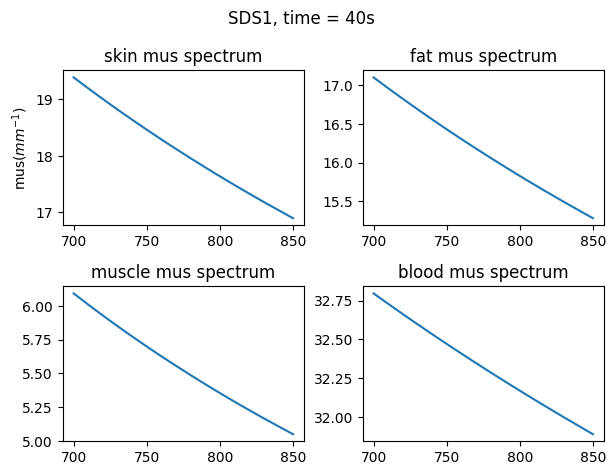

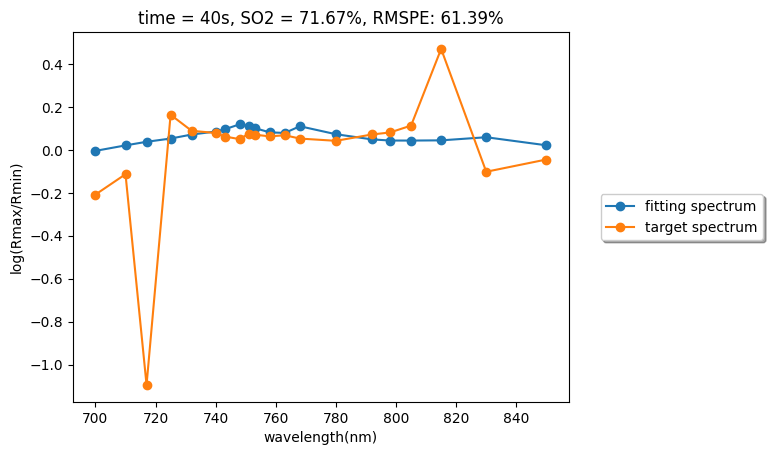

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

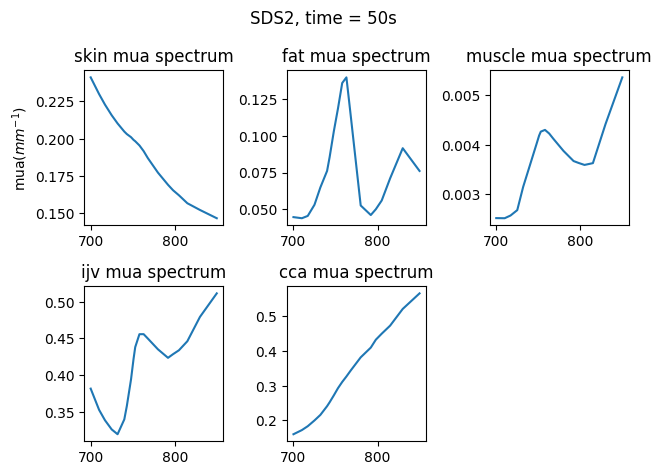

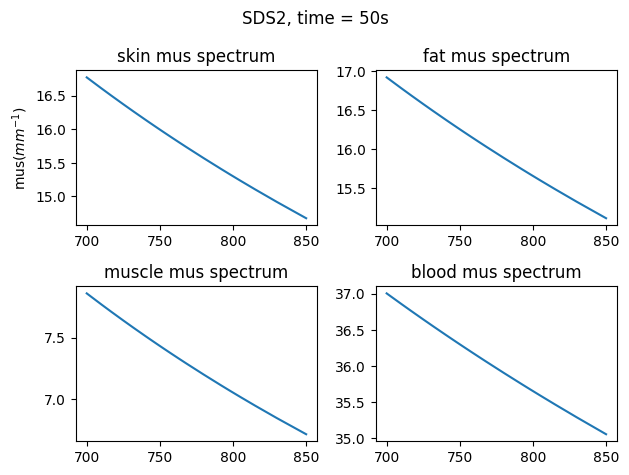

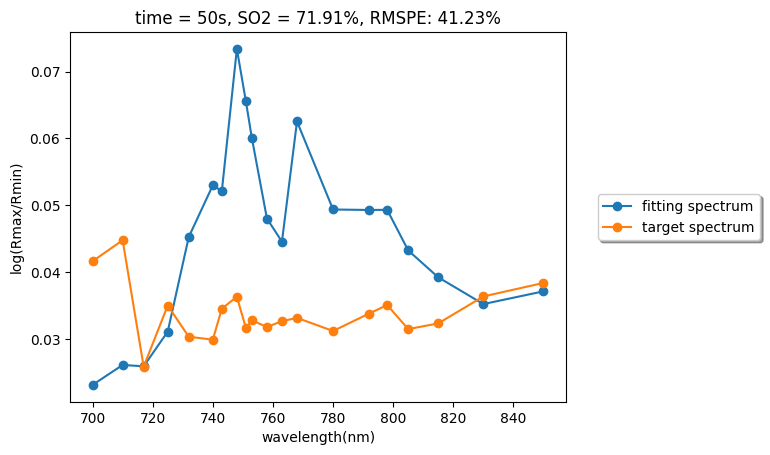

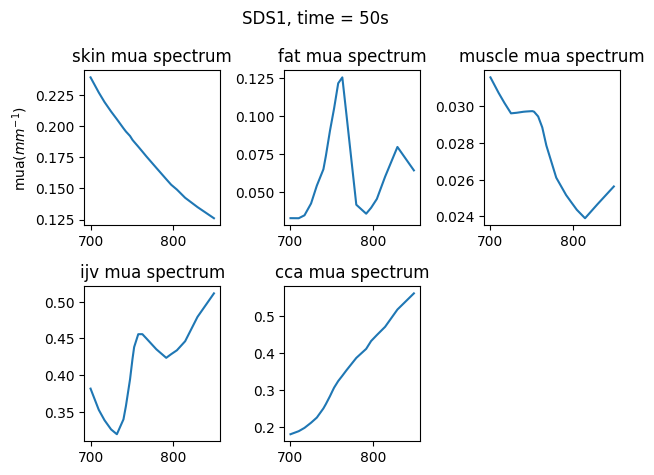

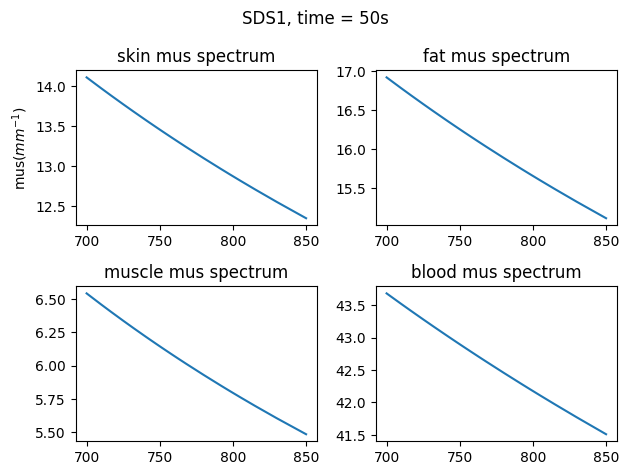

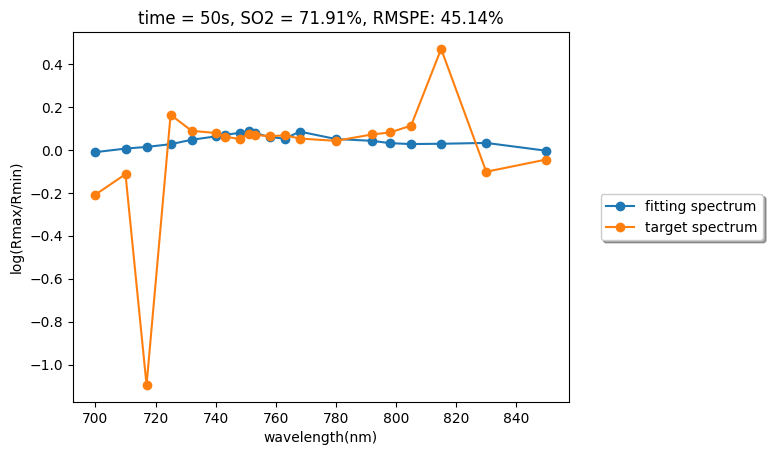

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

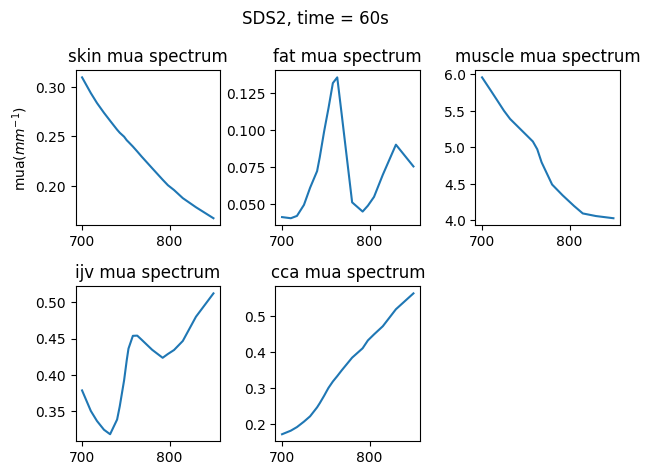

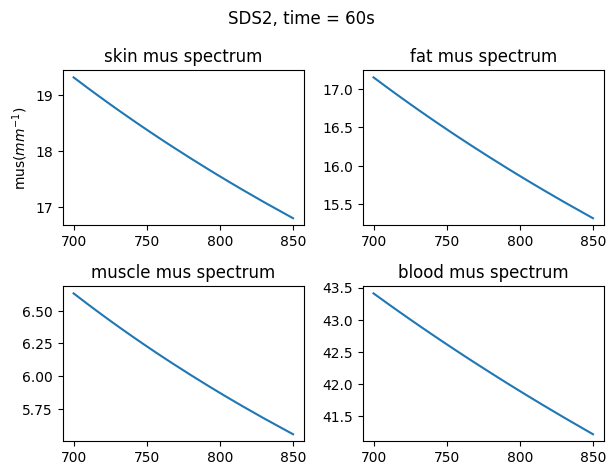

C:\Users\dicky1031\AppData\Local\Temp\ipykernel_36896\650935199.py:150: RuntimeWarning: invalid value encountered in divide
  predict_RmaxRmin_2 = np.log(R_small/R_large)
C:\Users\dicky1031\AppData\Local\Temp\ipykernel_36896\650935199.py:150: RuntimeWarning: divide by zero encountered in log
  predict_RmaxRmin_2 = np.log(R_small/R_large)


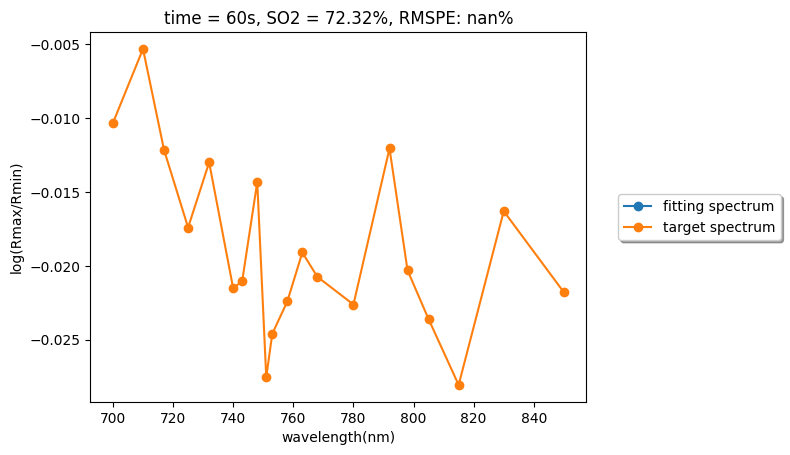

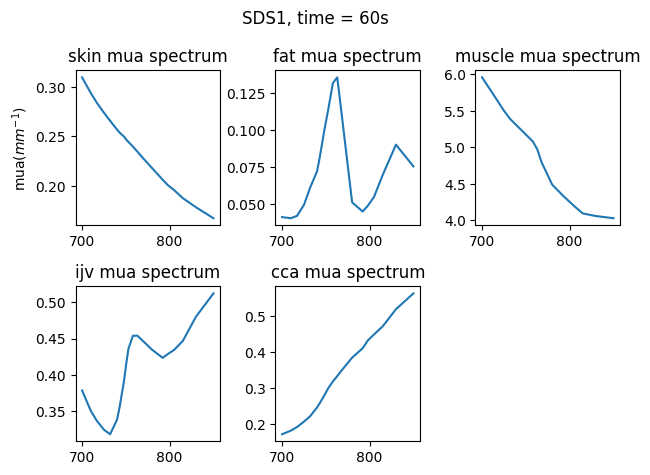

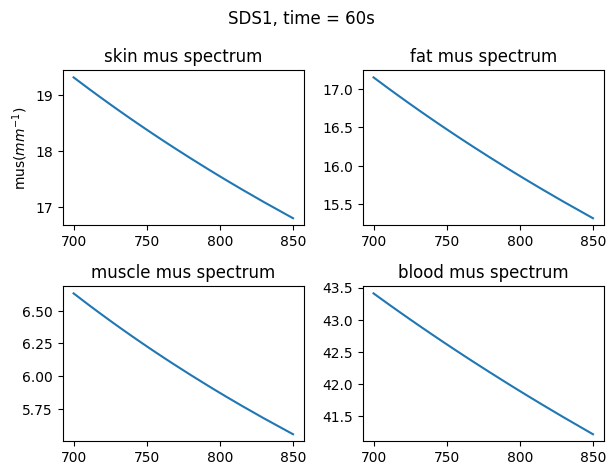

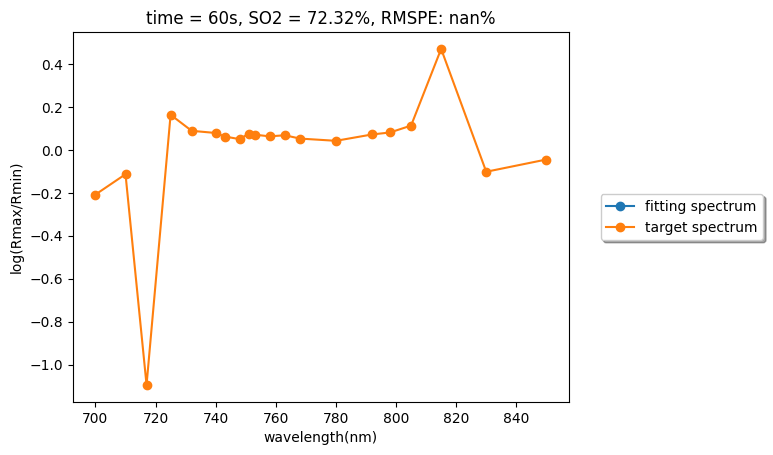

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

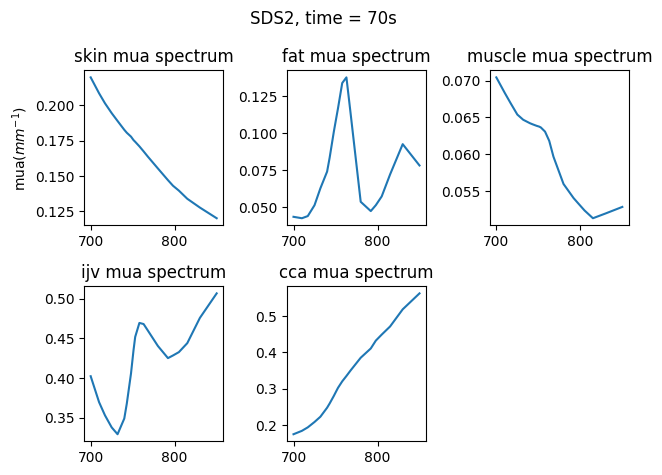

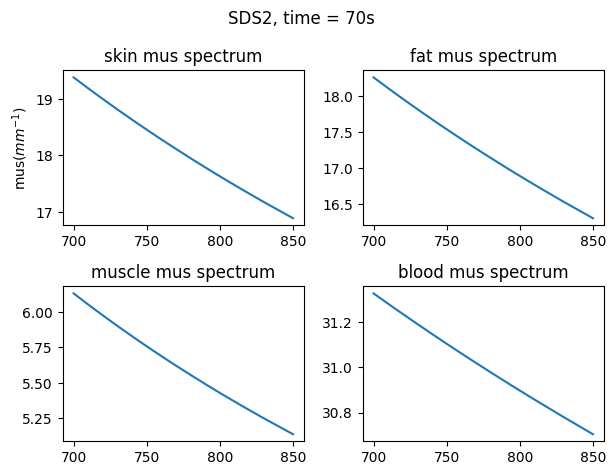

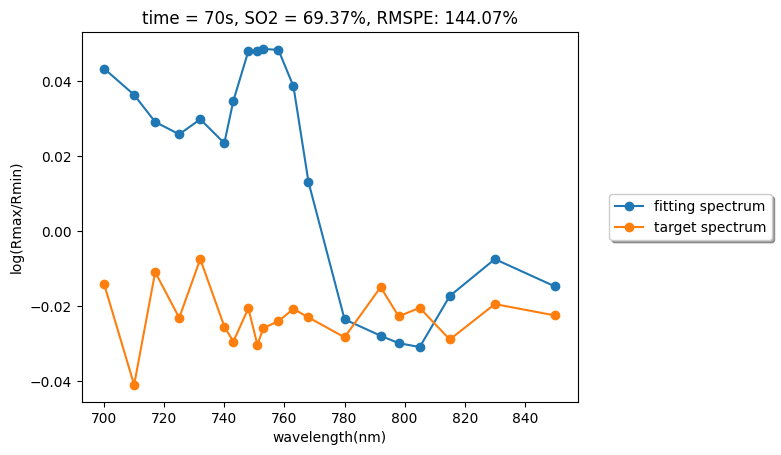

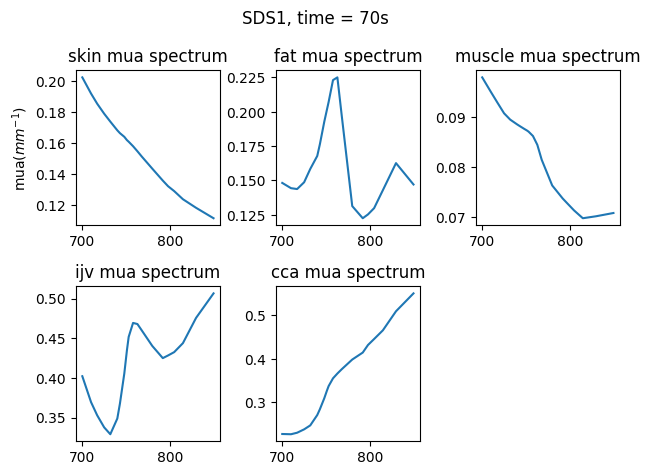

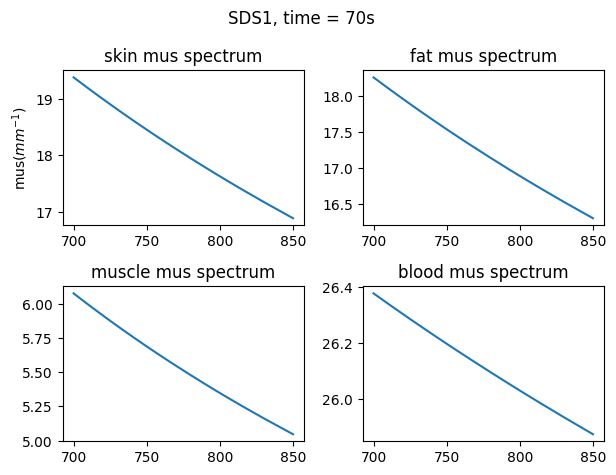

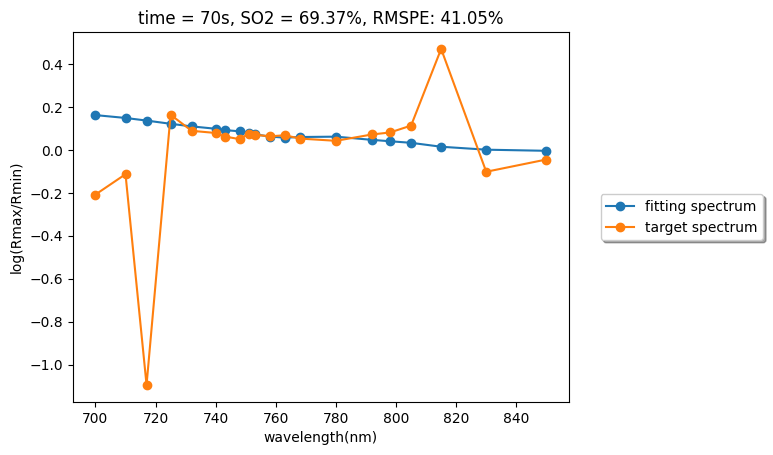

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

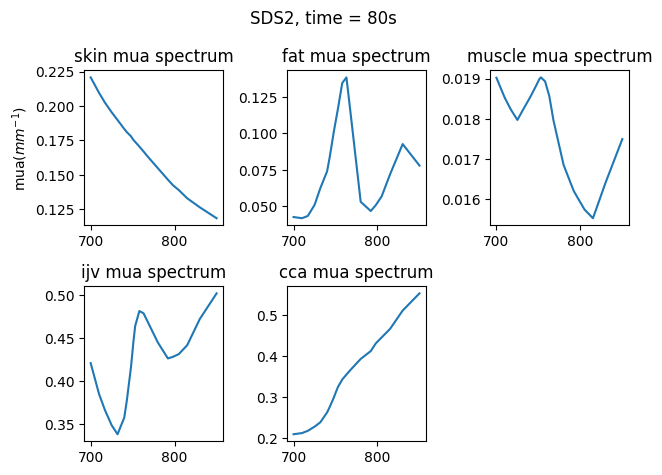

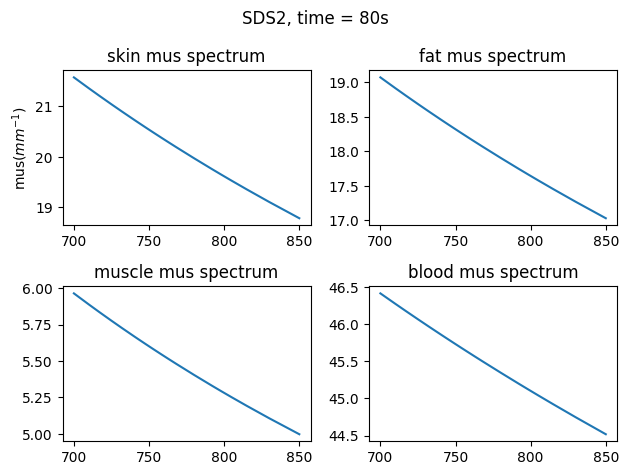

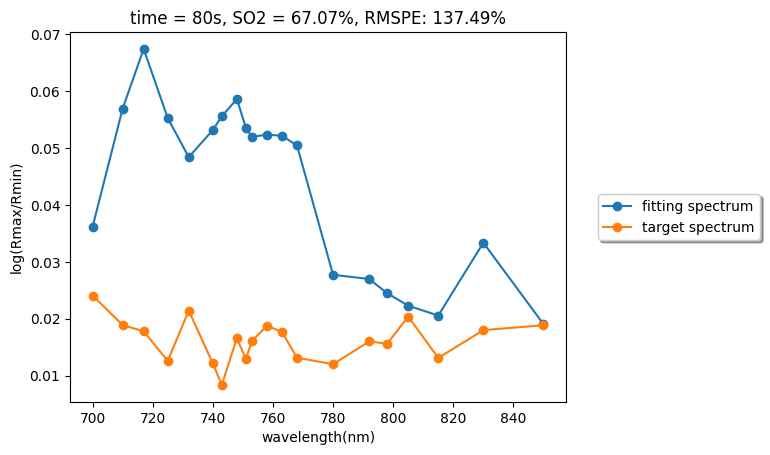

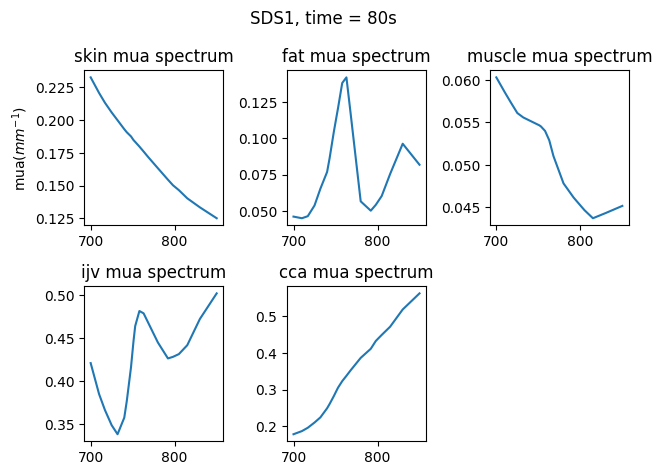

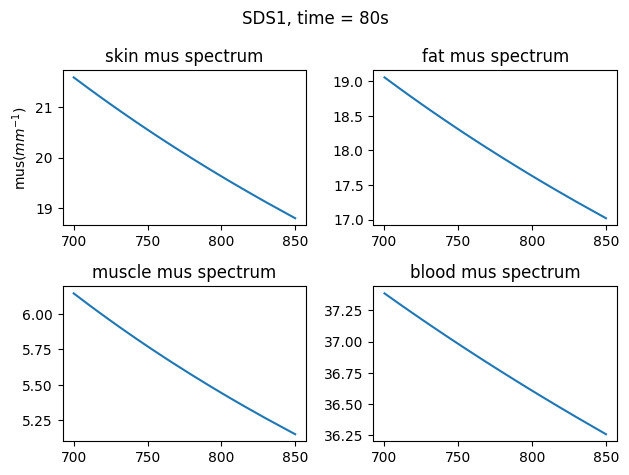

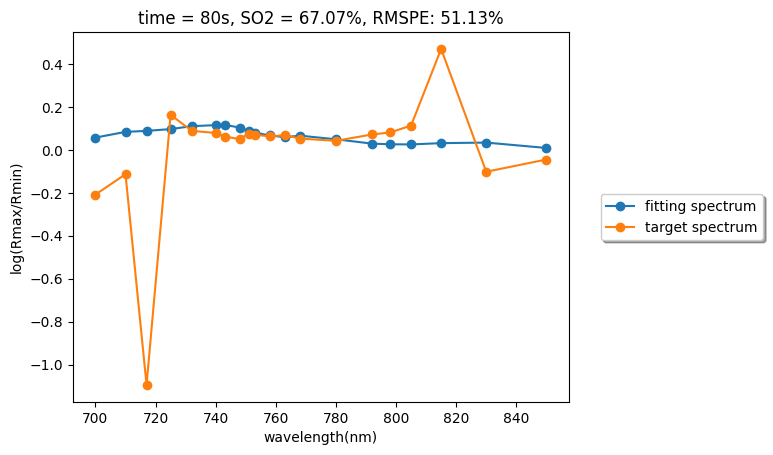

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

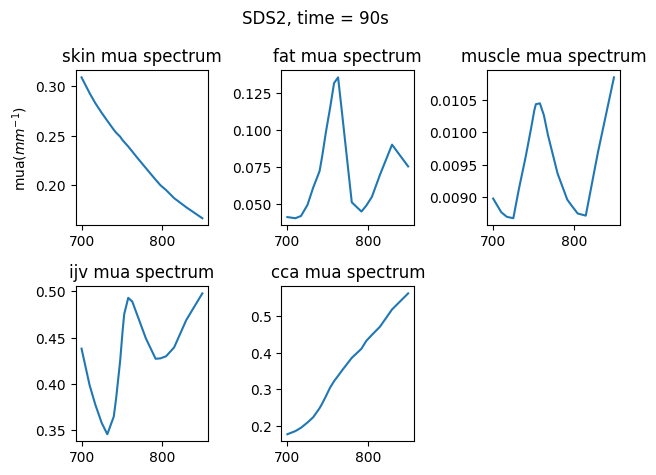

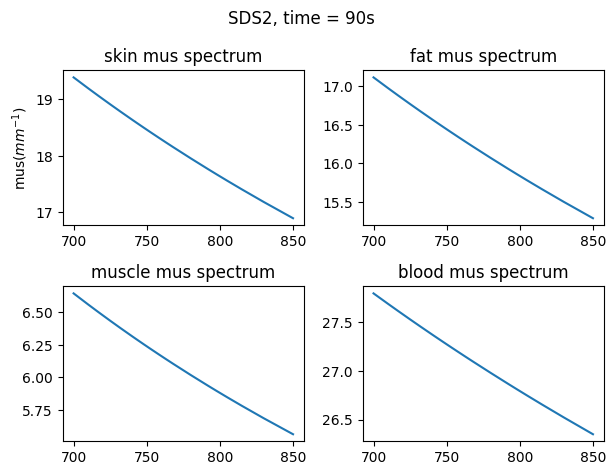

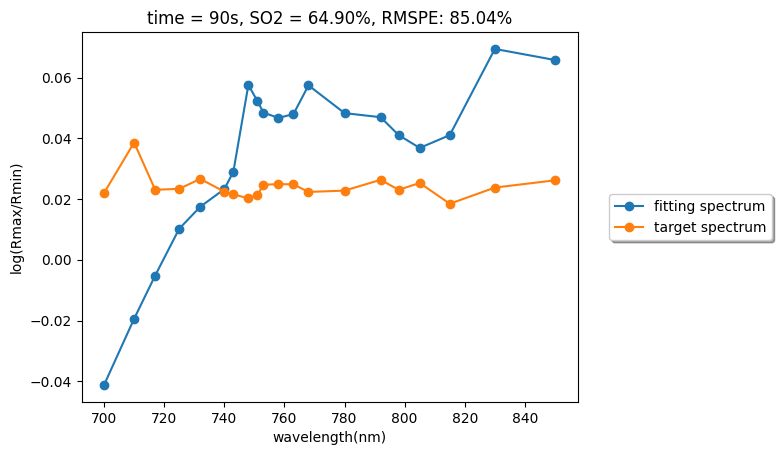

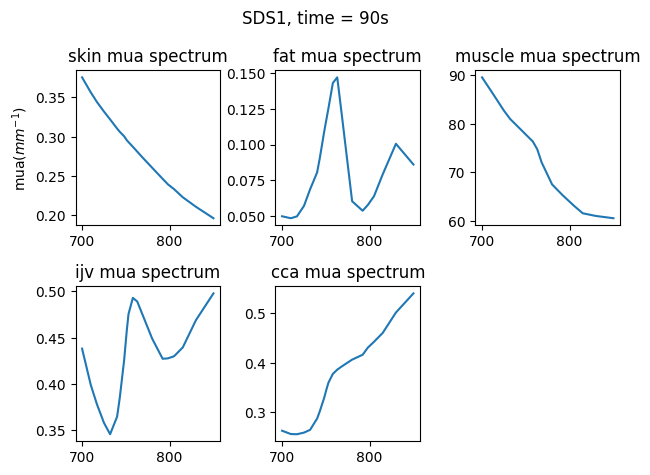

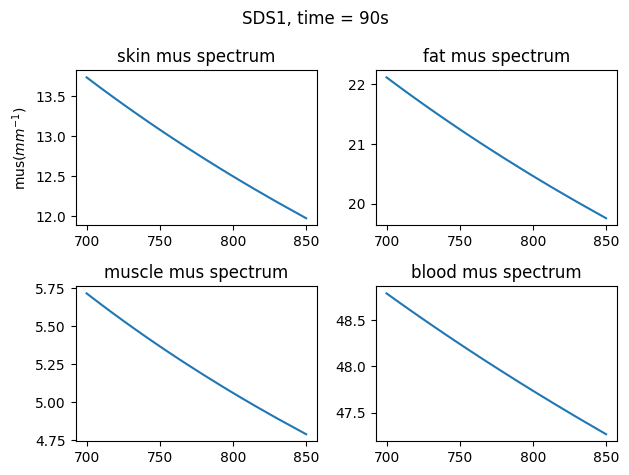

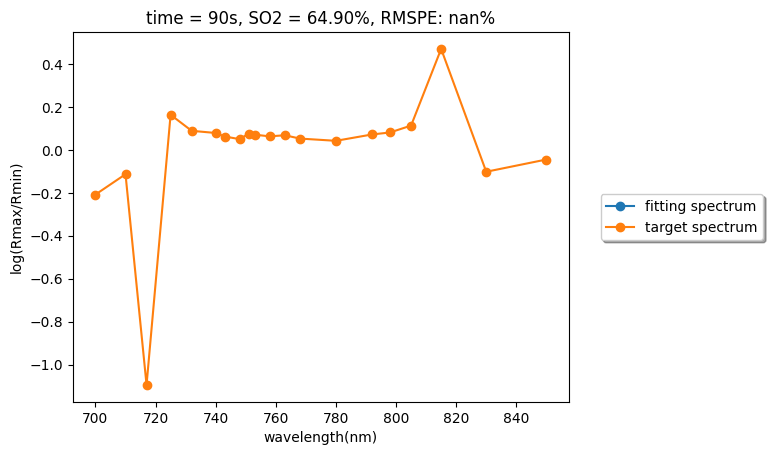

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

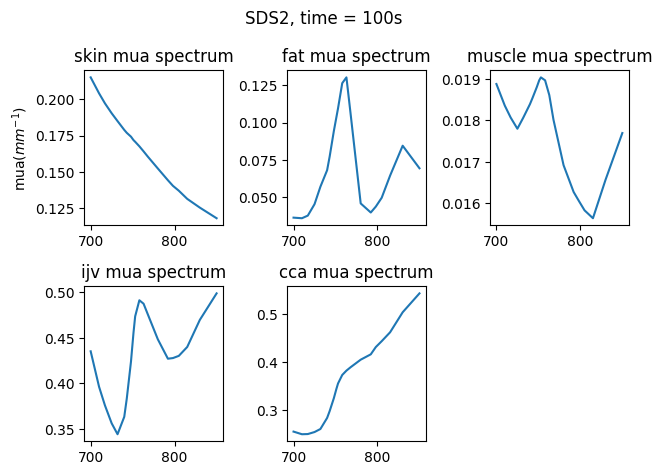

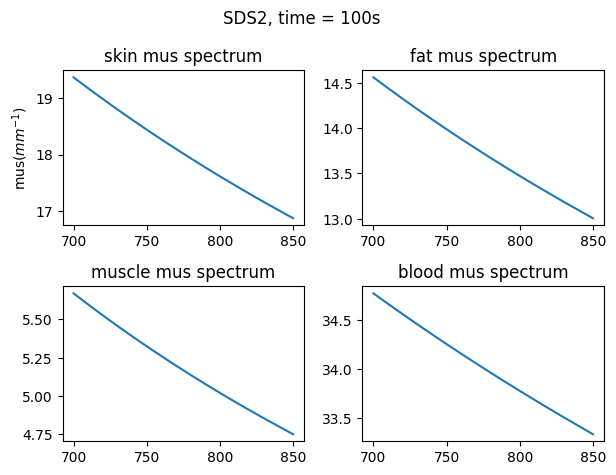

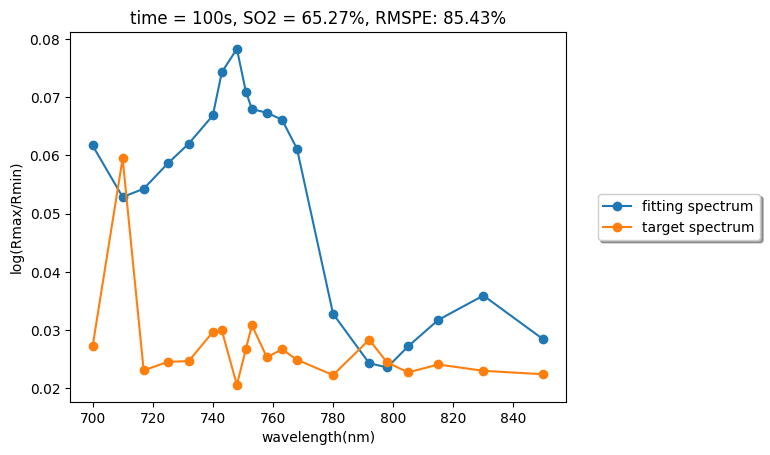

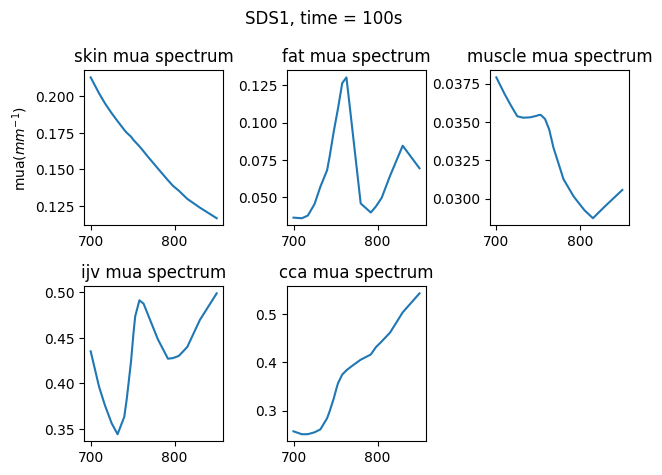

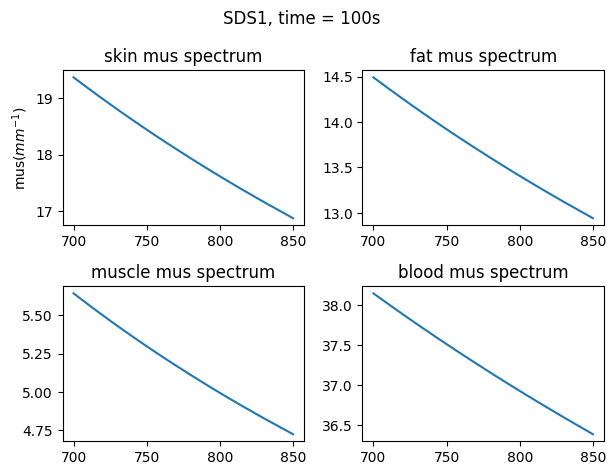

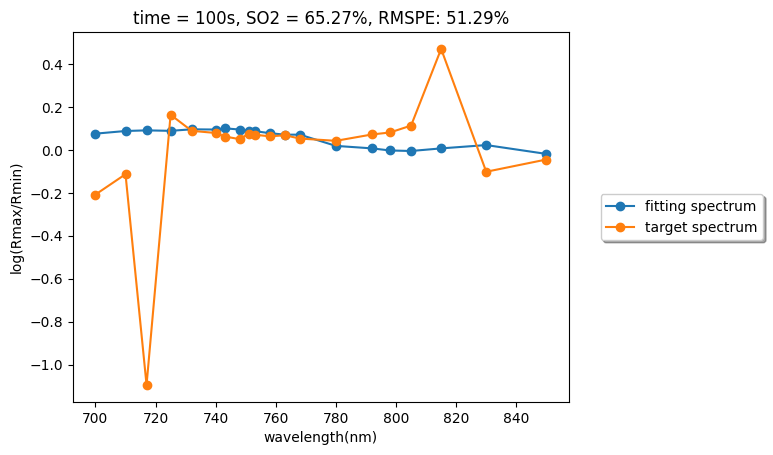

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

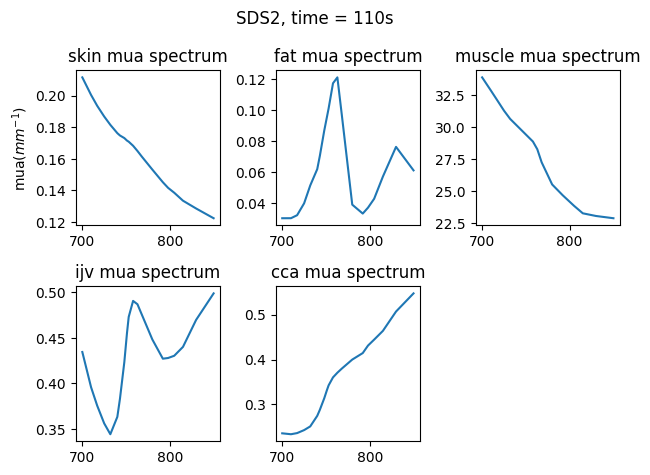

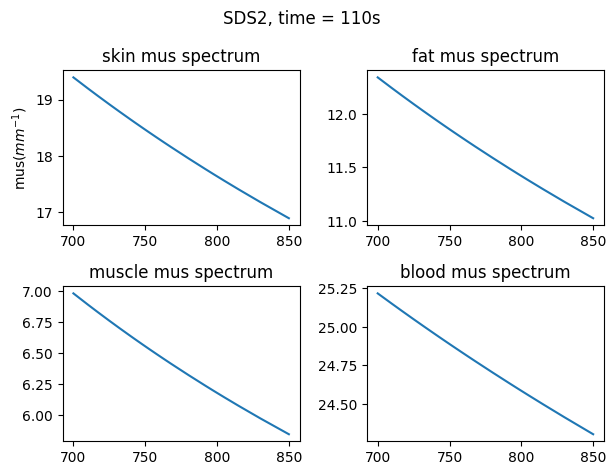

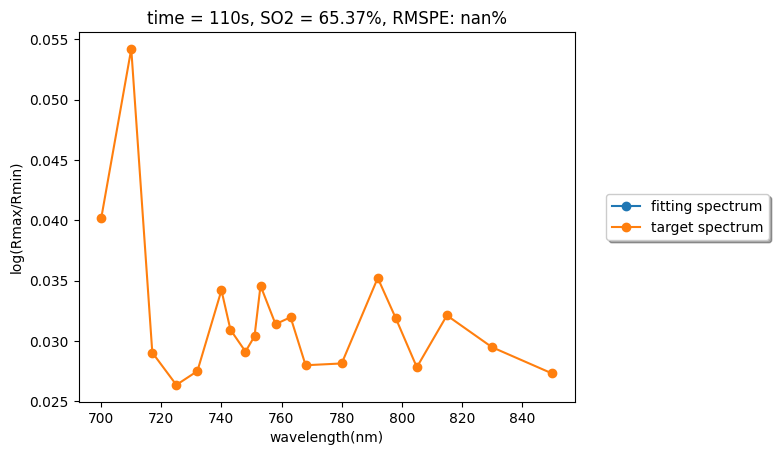

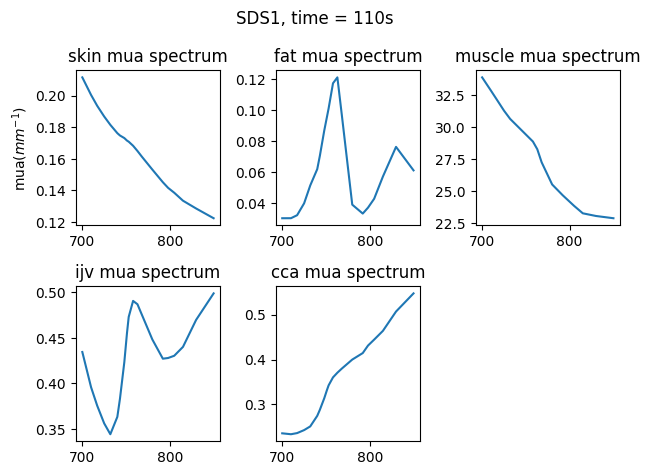

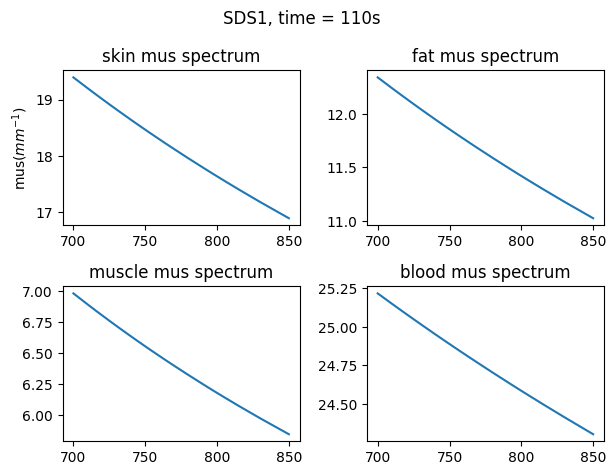

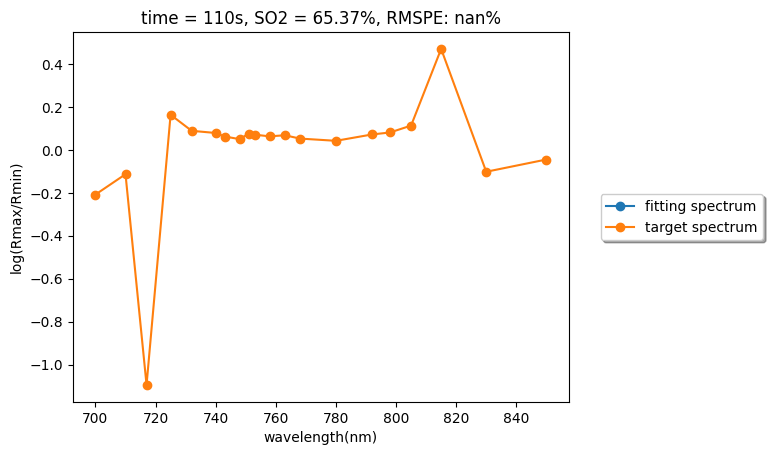

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

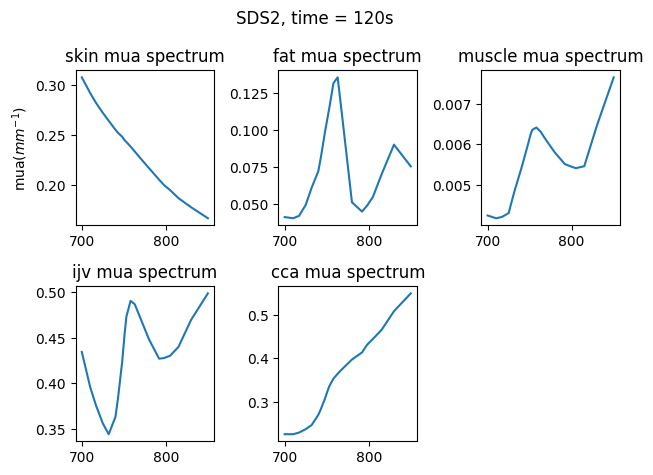

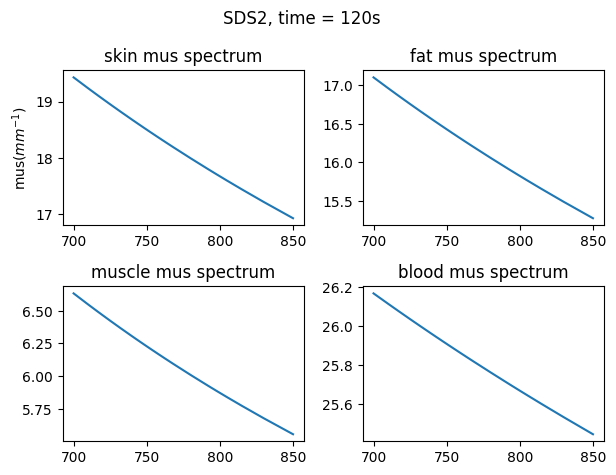

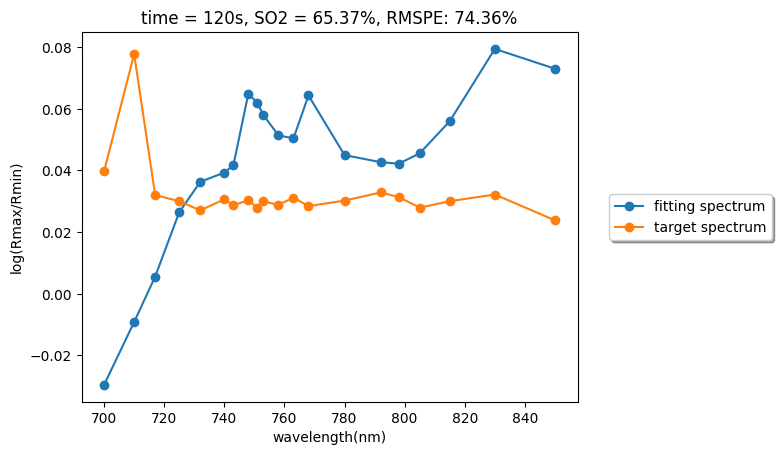

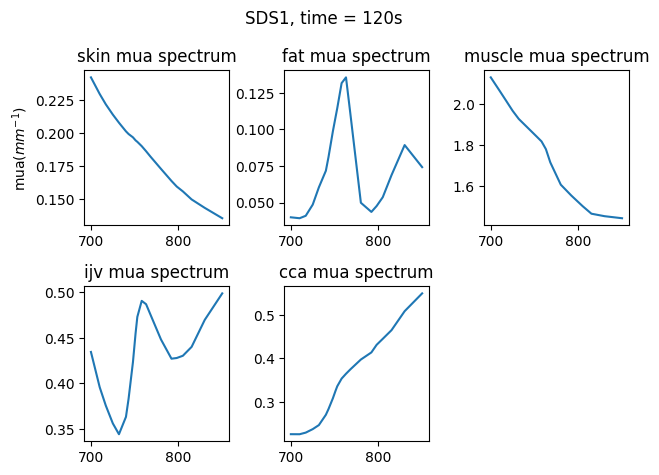

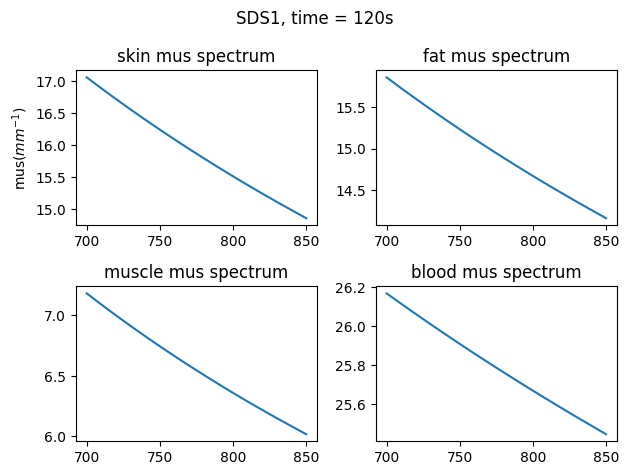

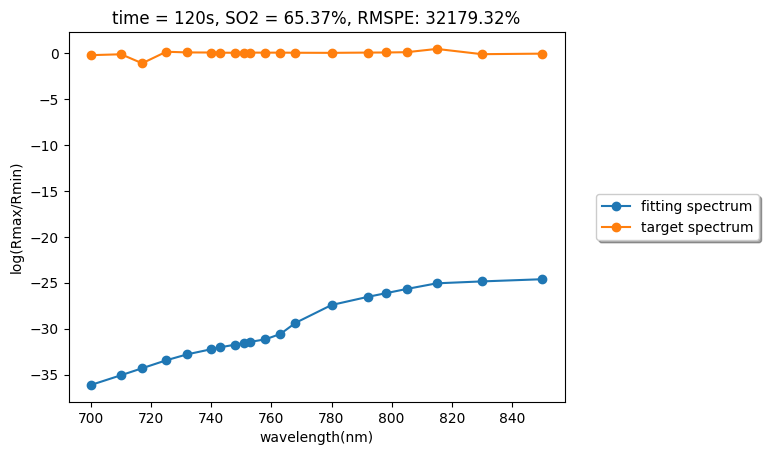

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

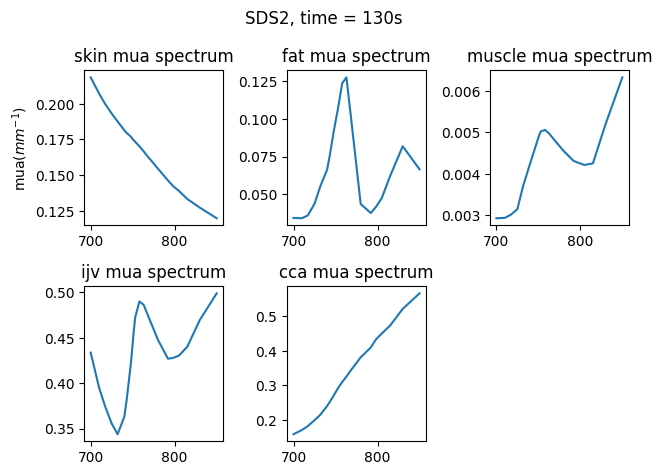

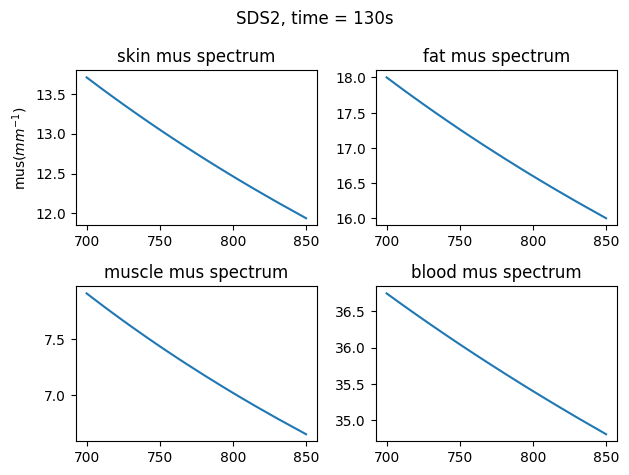

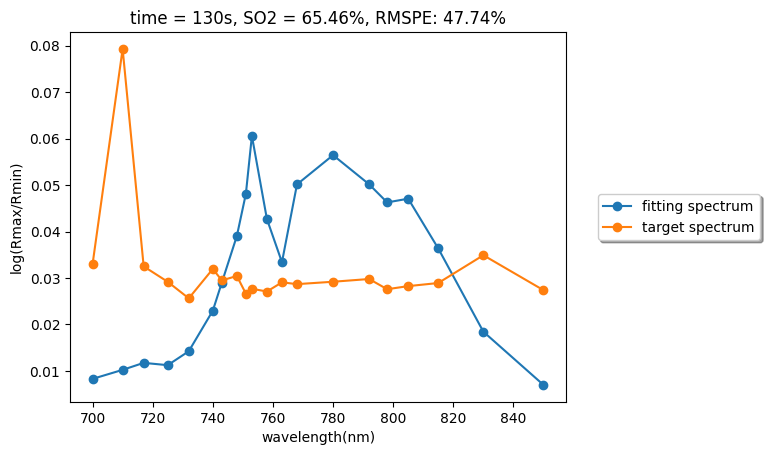

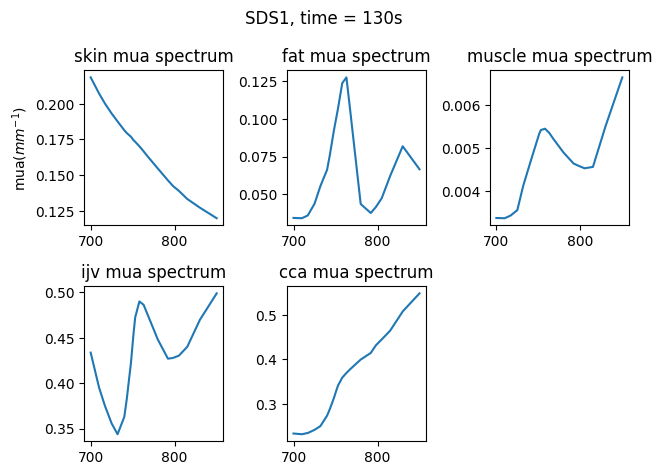

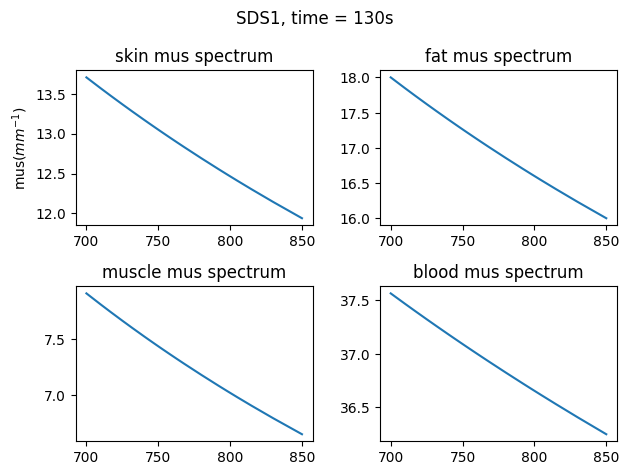

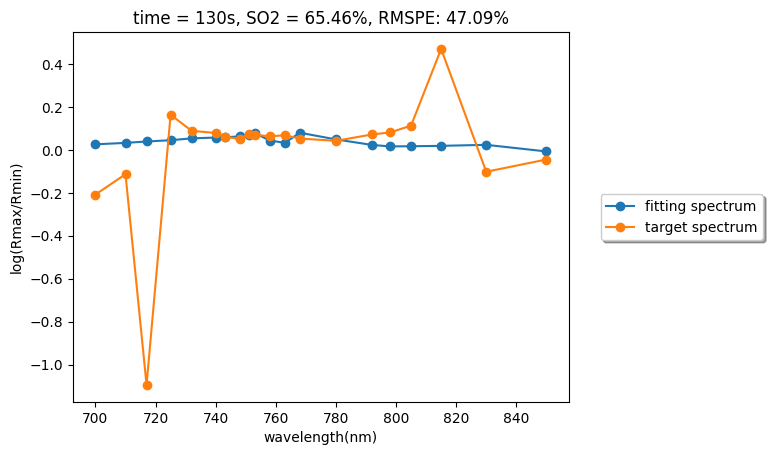

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

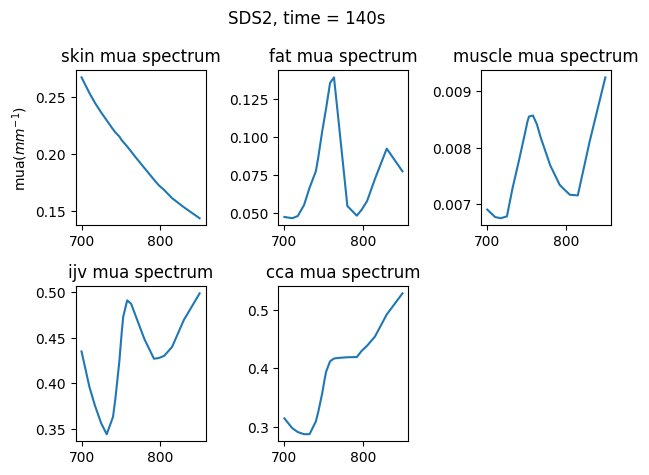

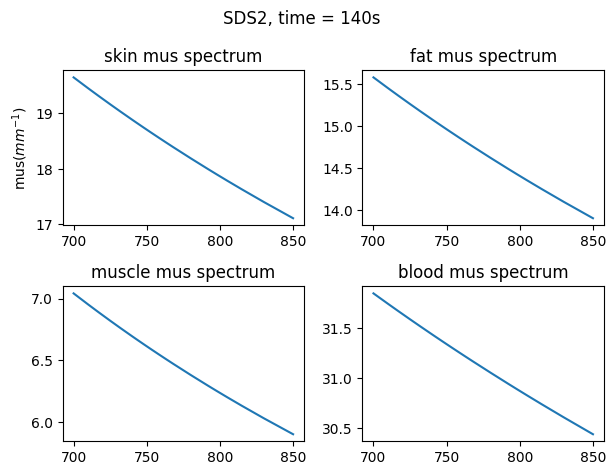

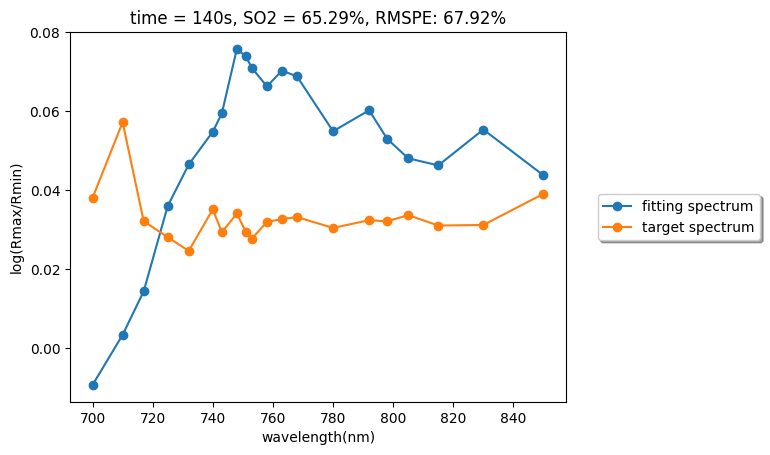

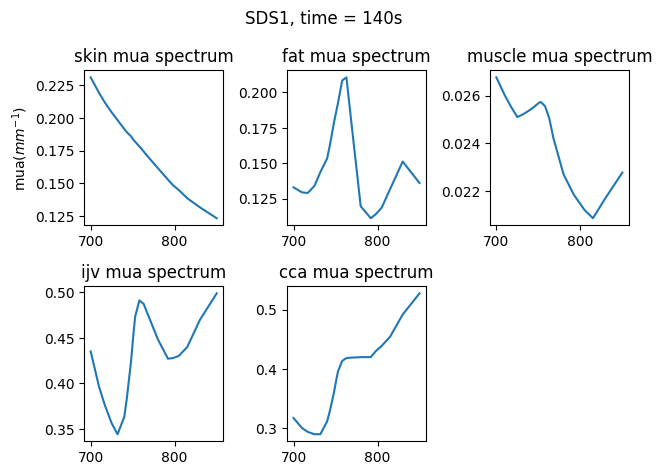

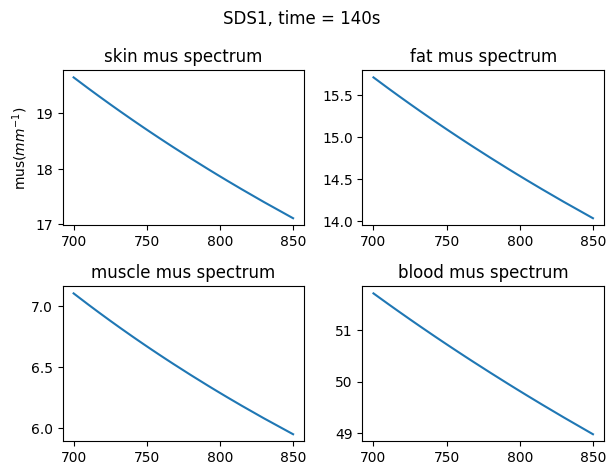

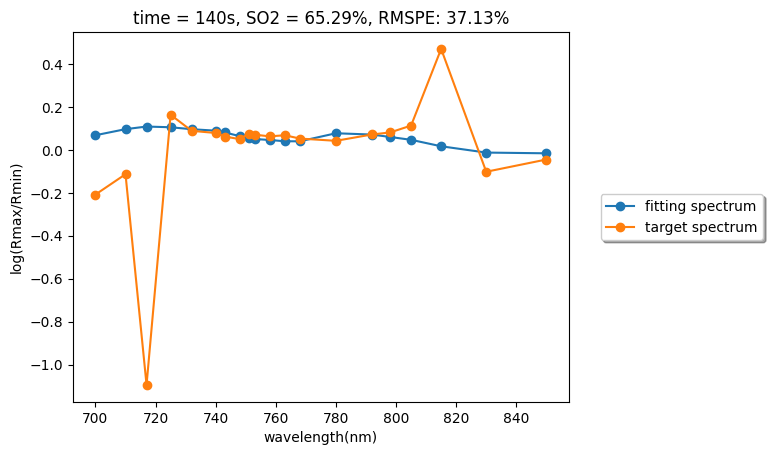

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

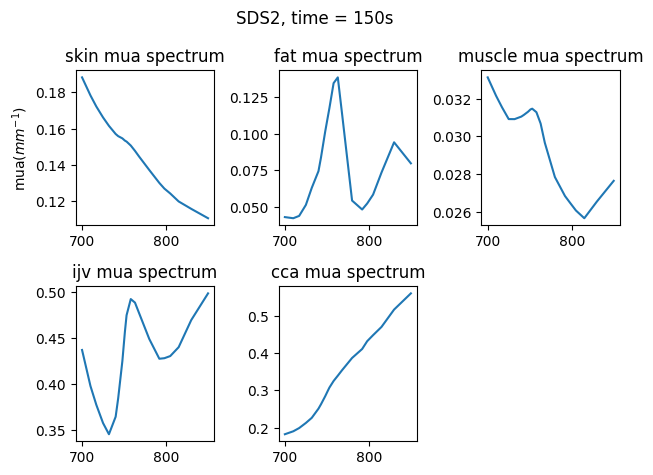

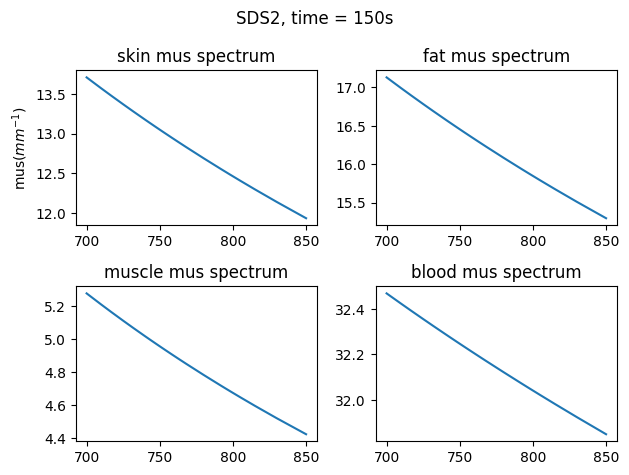

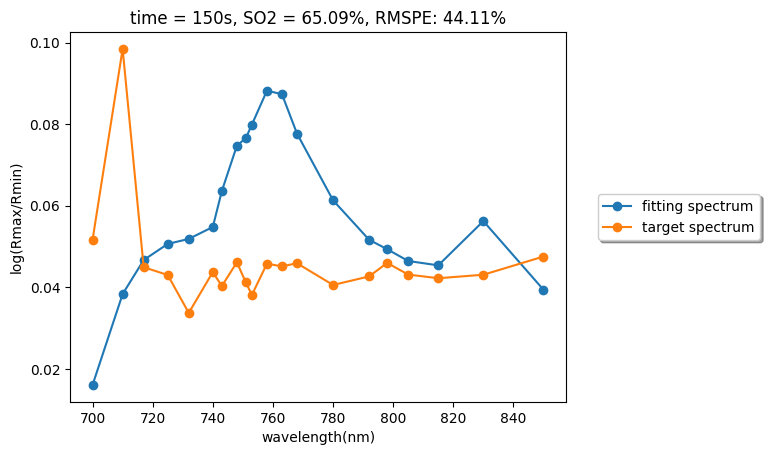

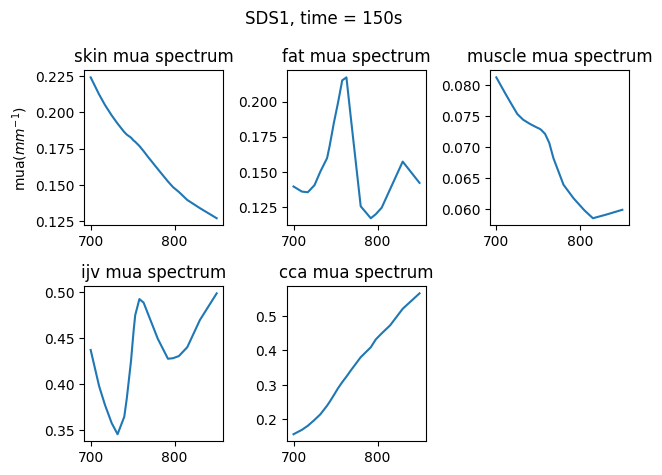

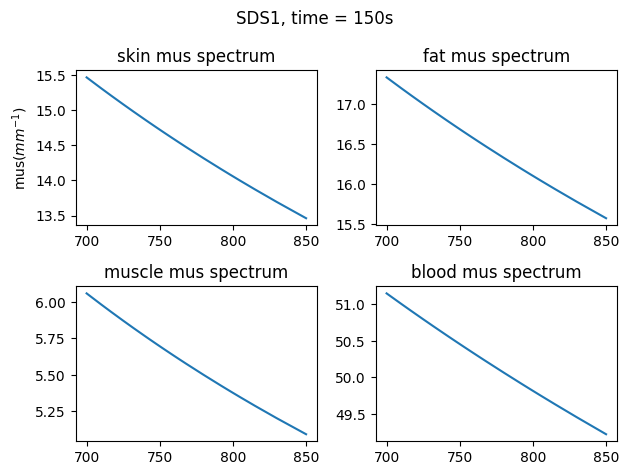

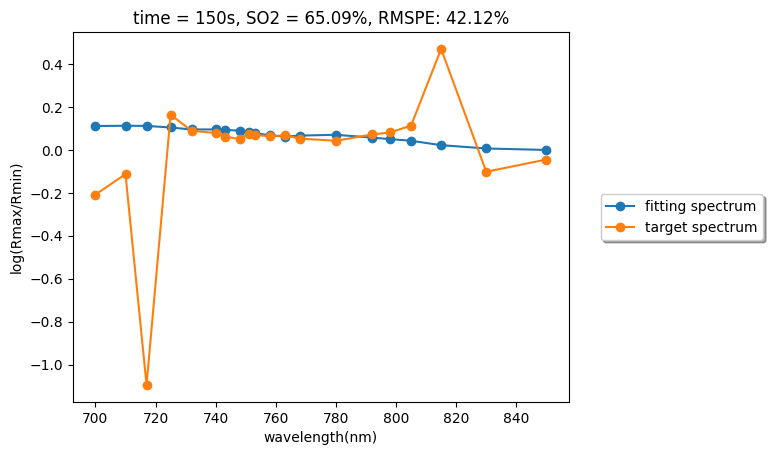

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

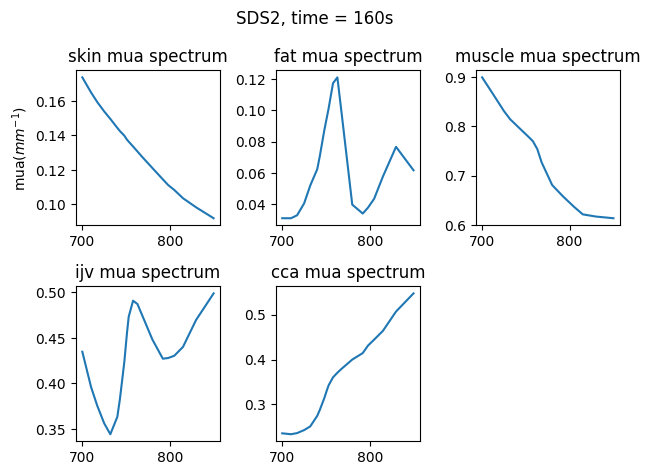

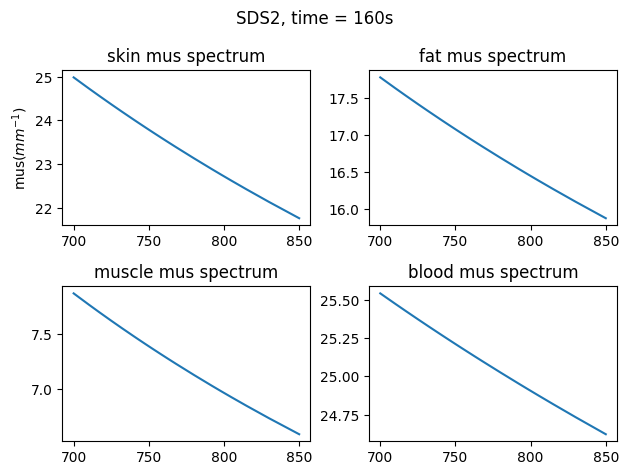

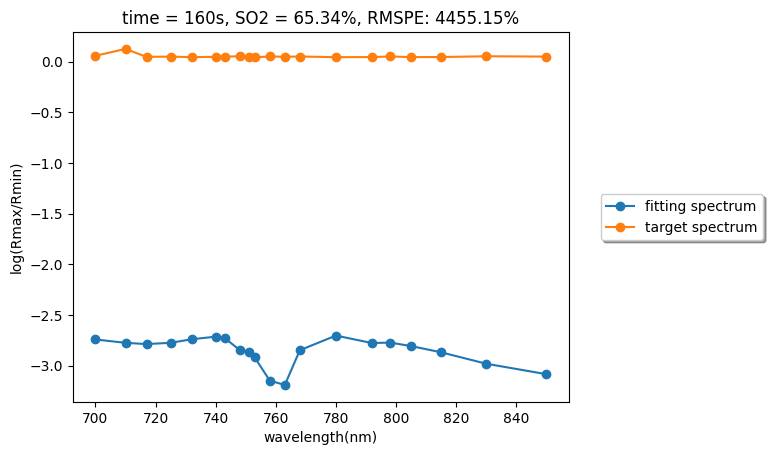

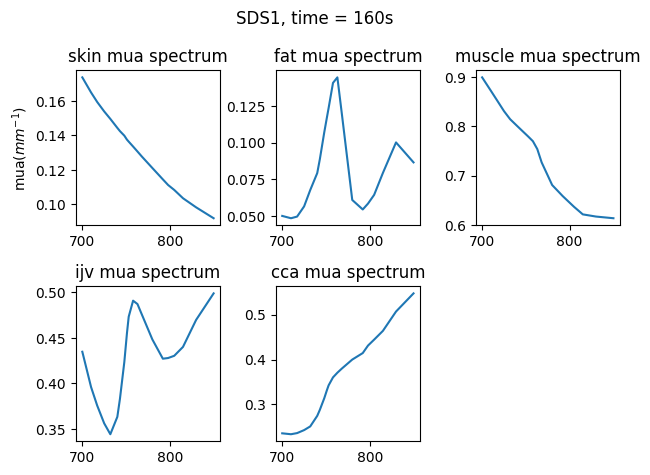

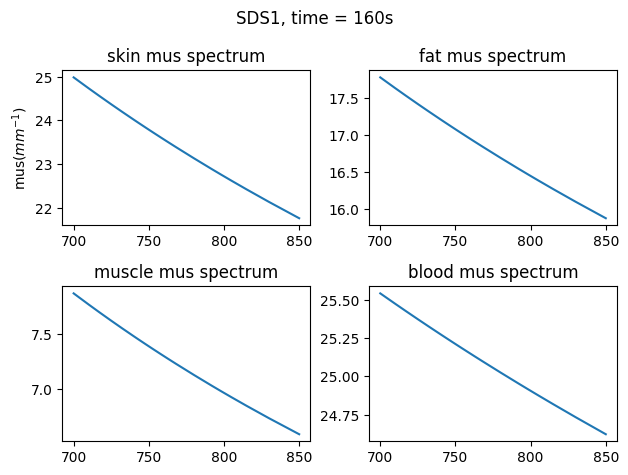

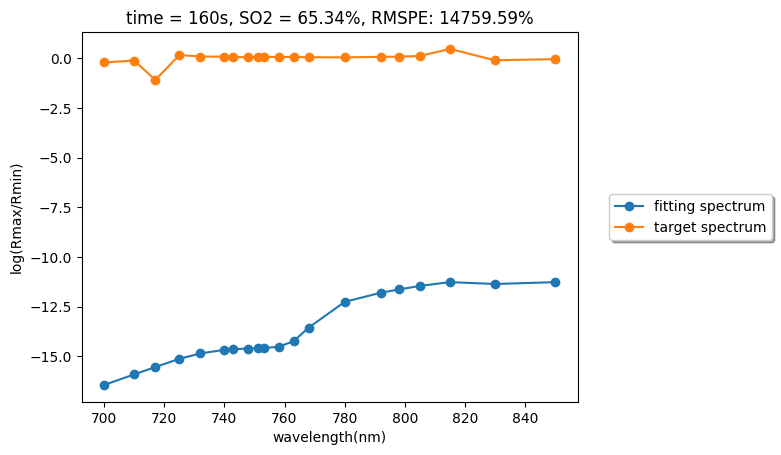

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

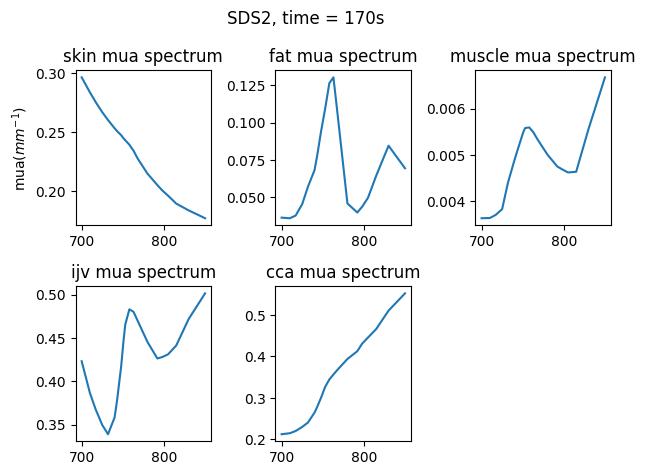

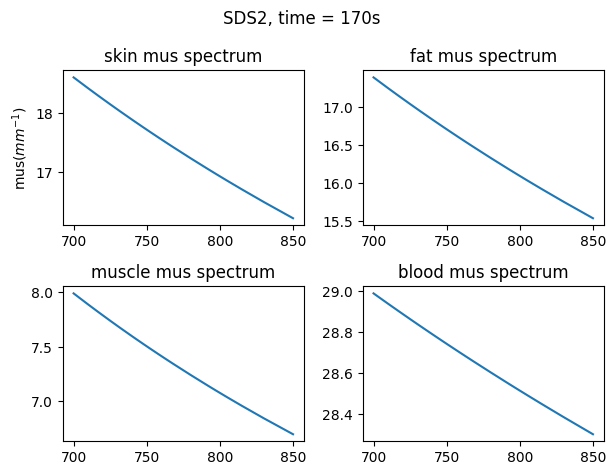

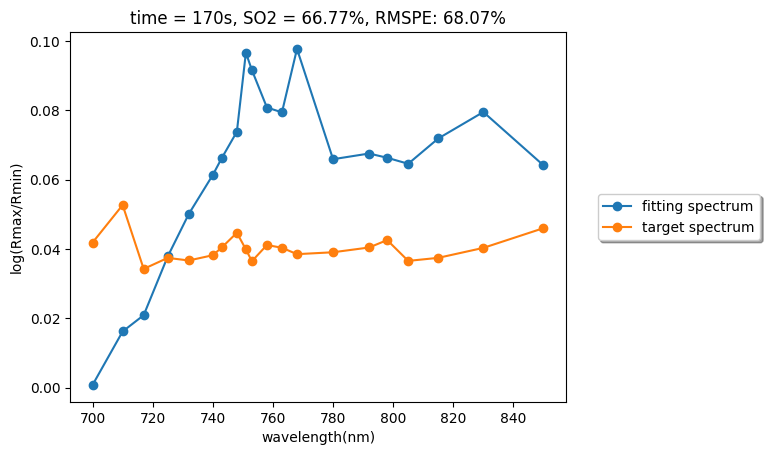

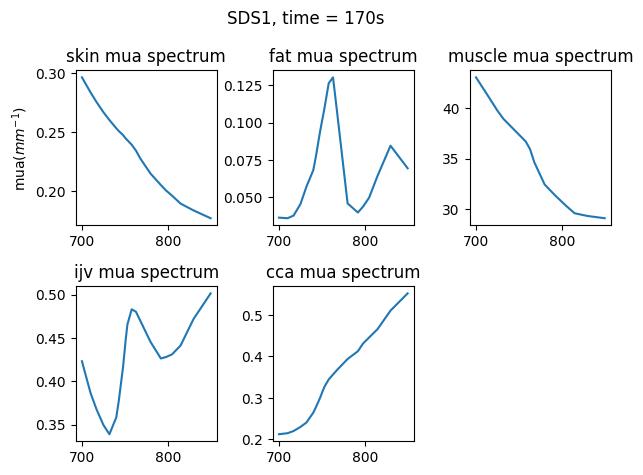

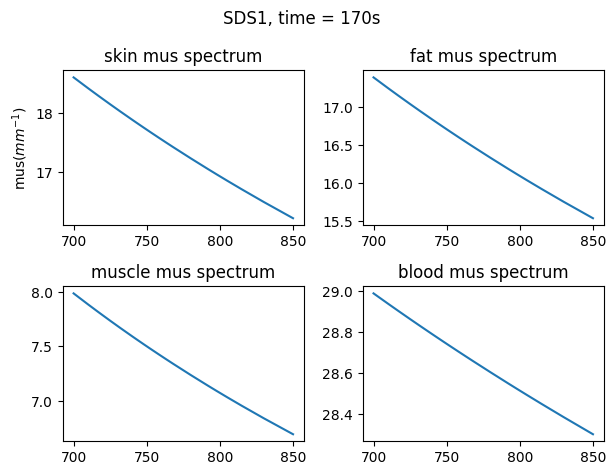

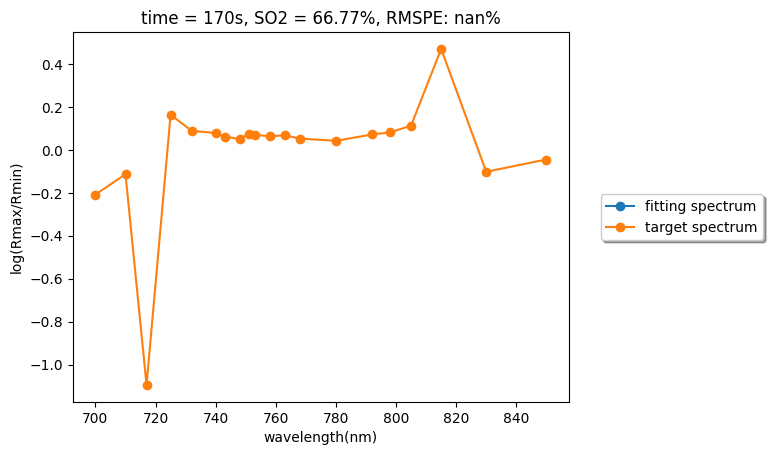

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

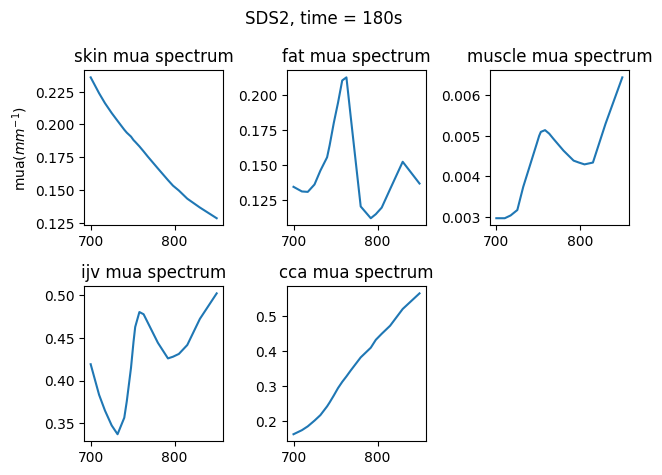

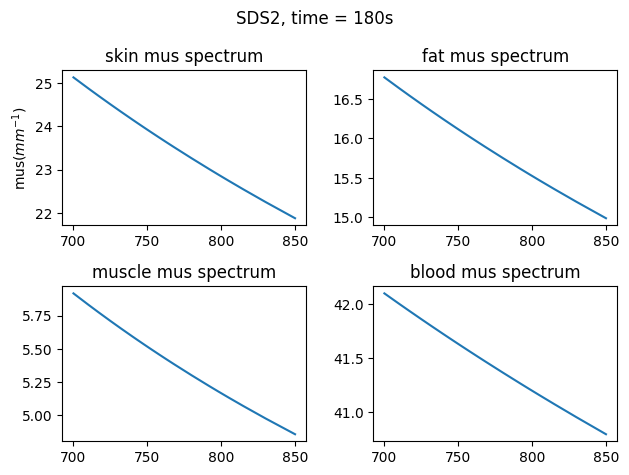

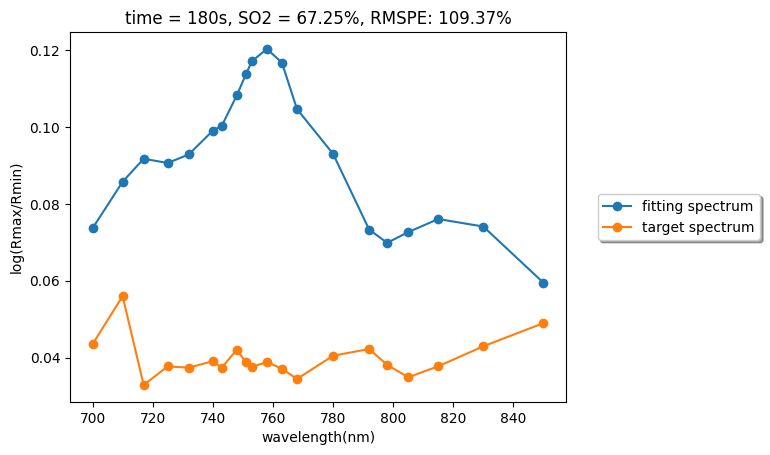

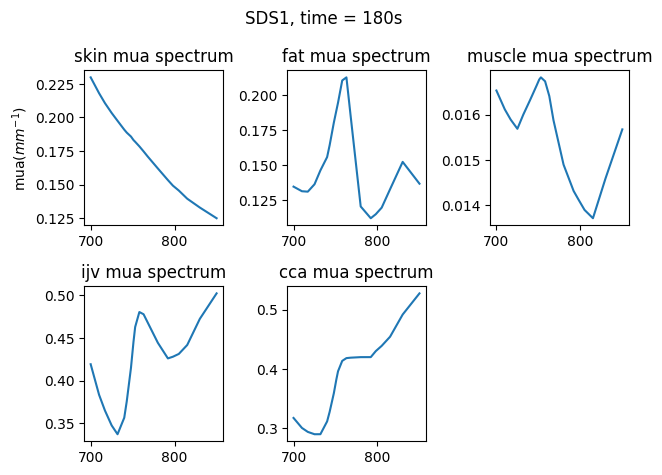

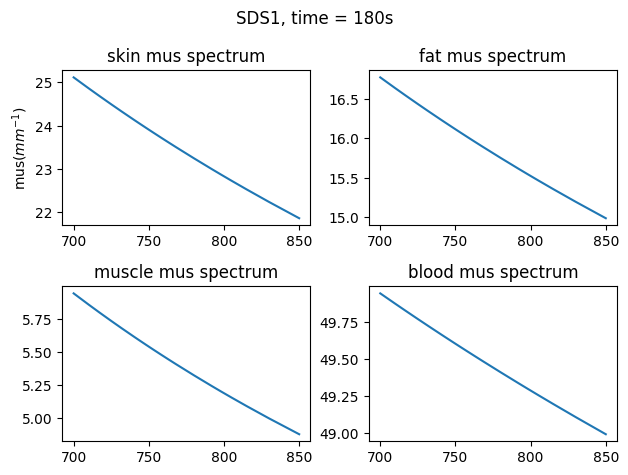

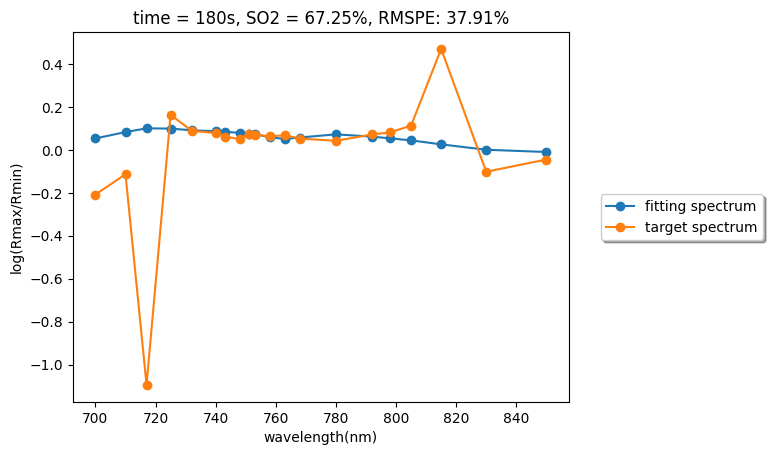

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

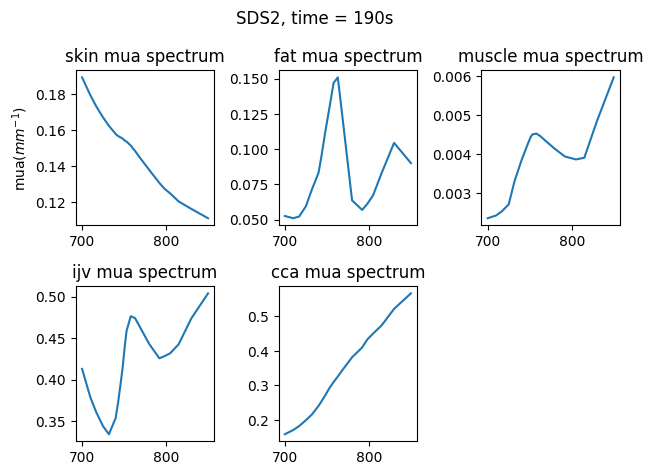

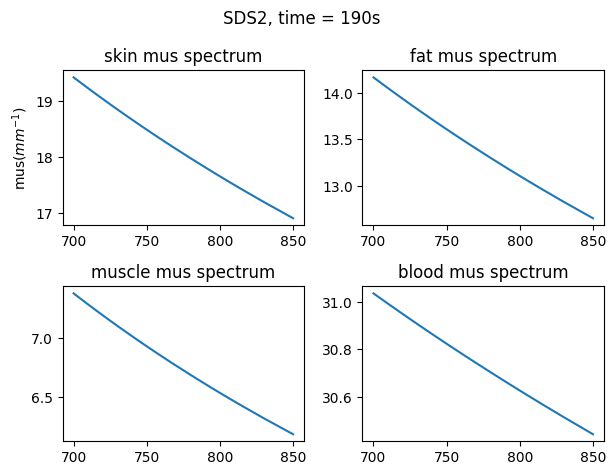

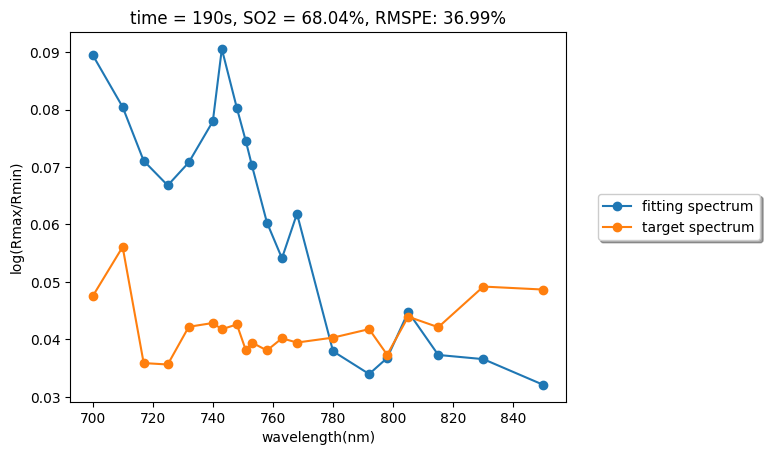

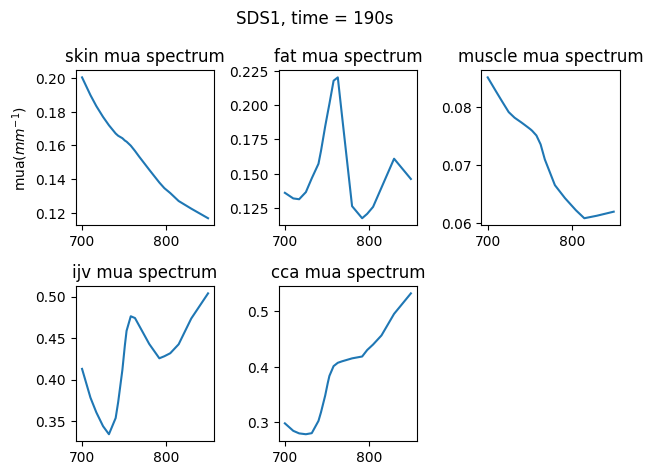

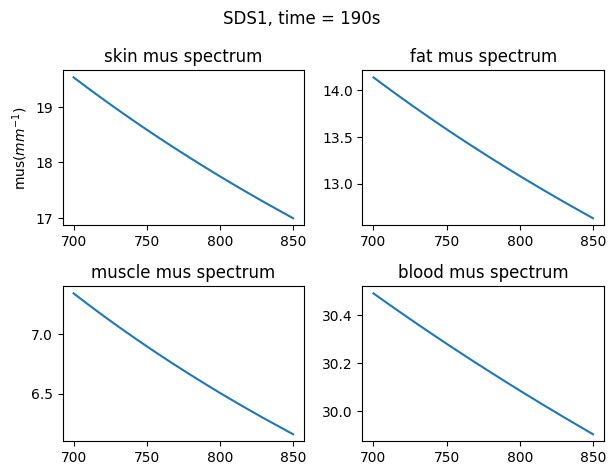

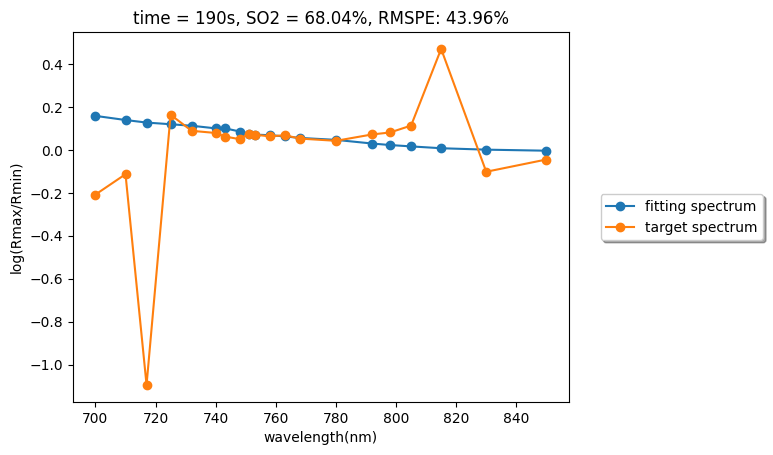

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

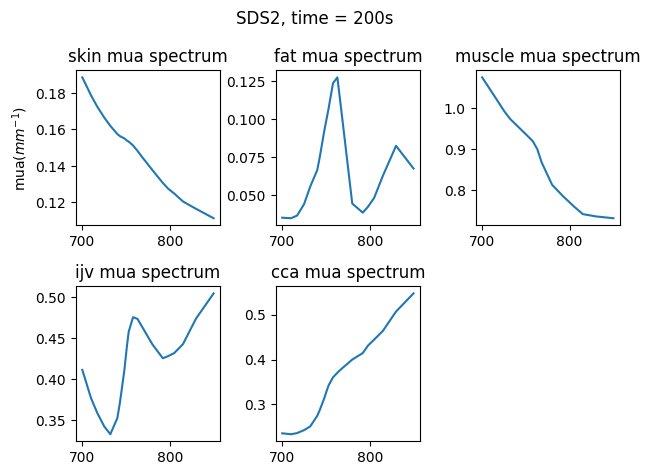

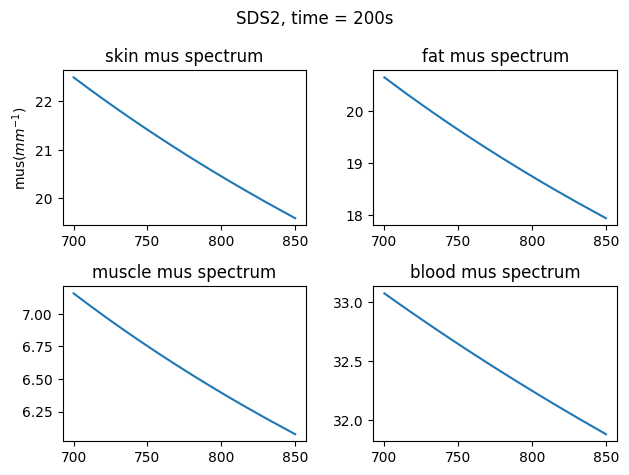

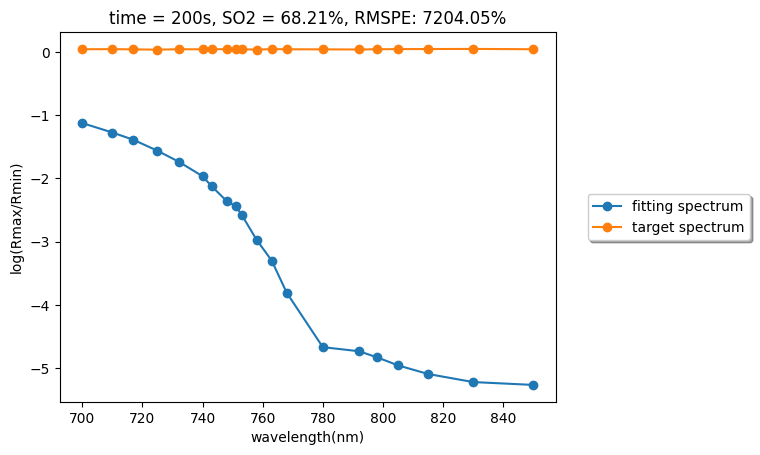

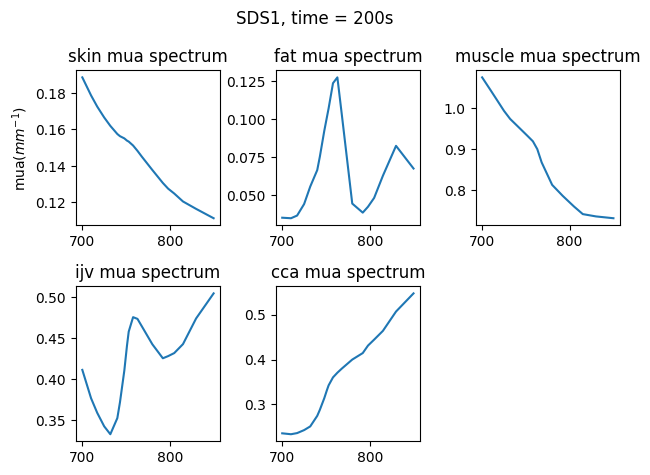

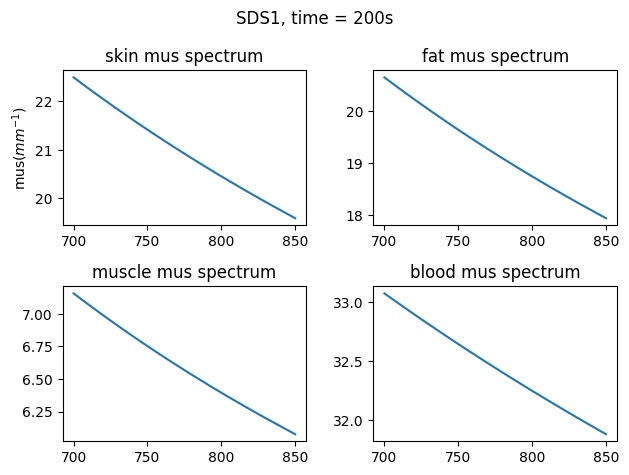

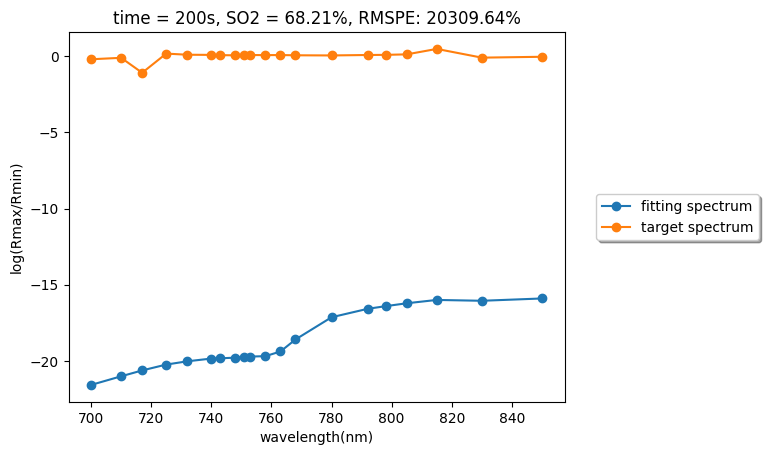

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

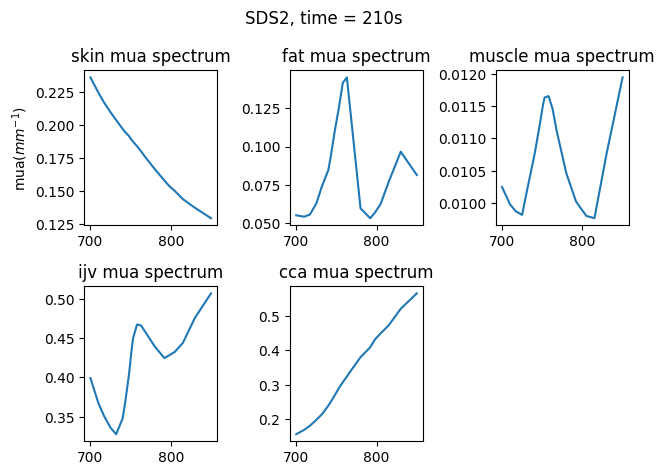

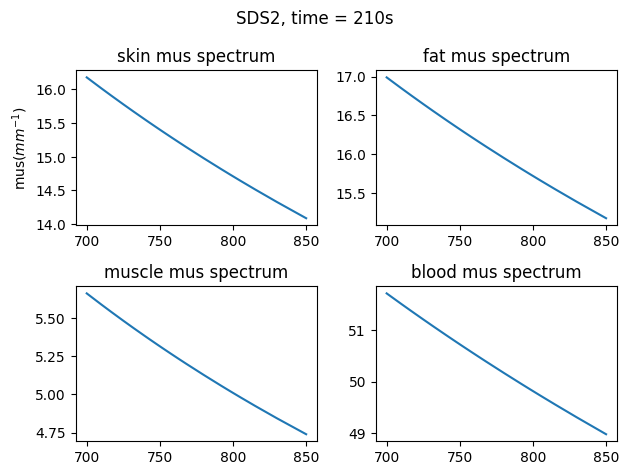

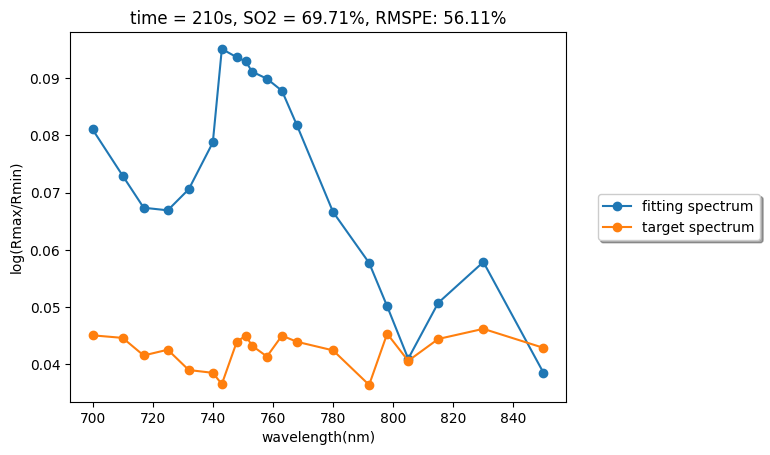

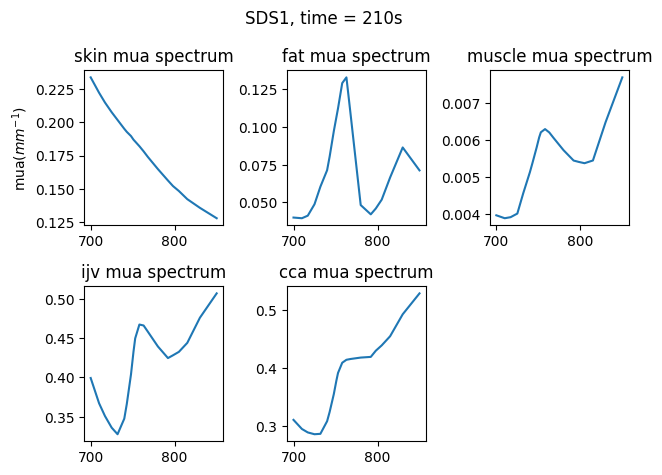

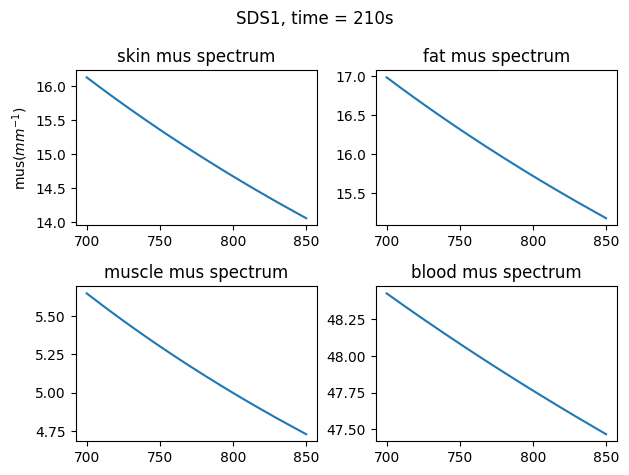

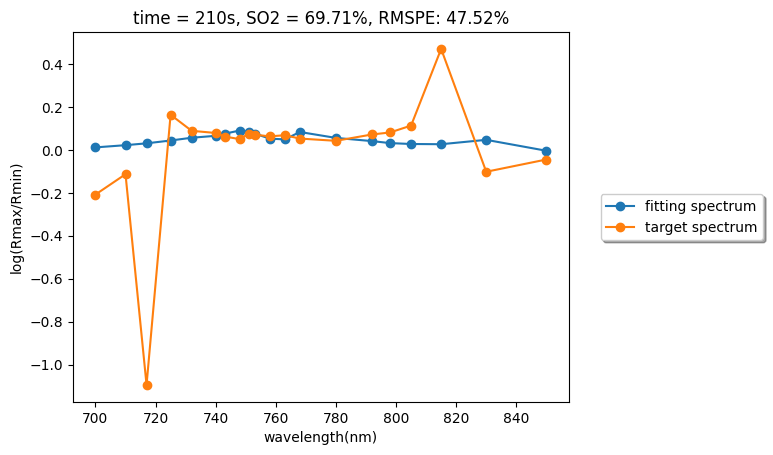

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

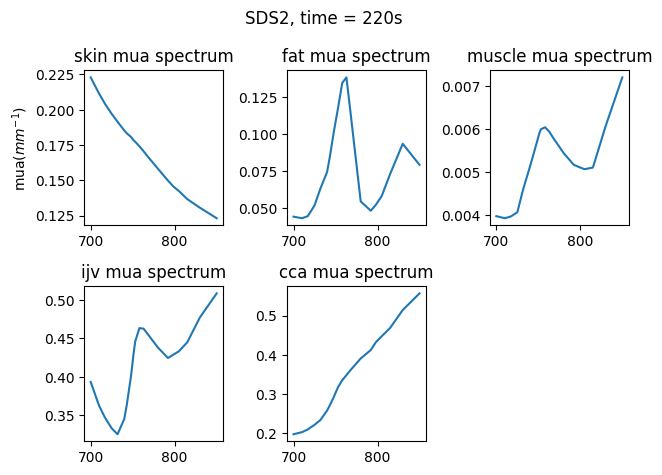

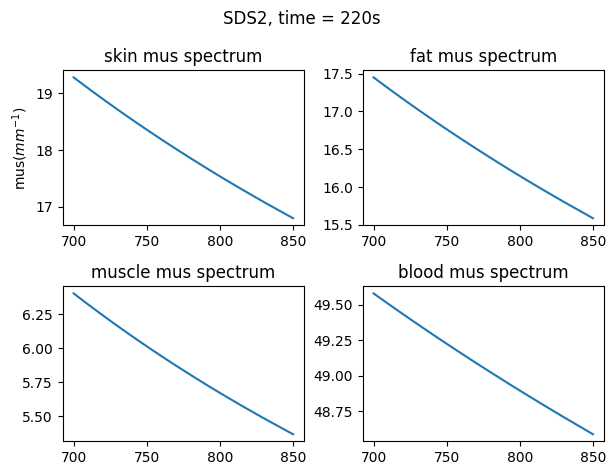

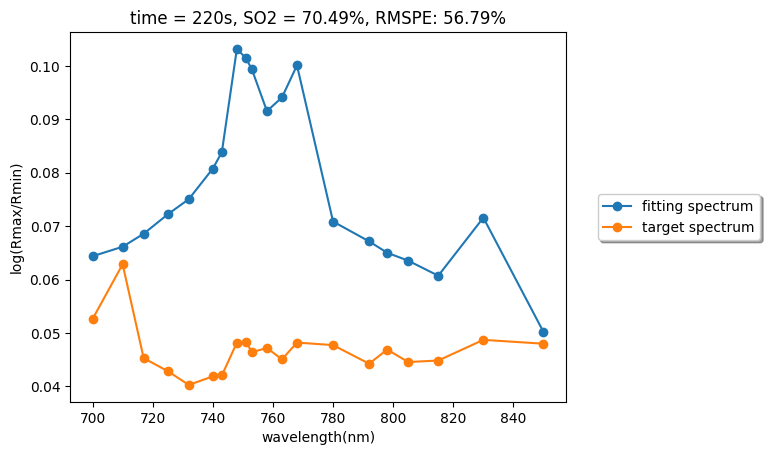

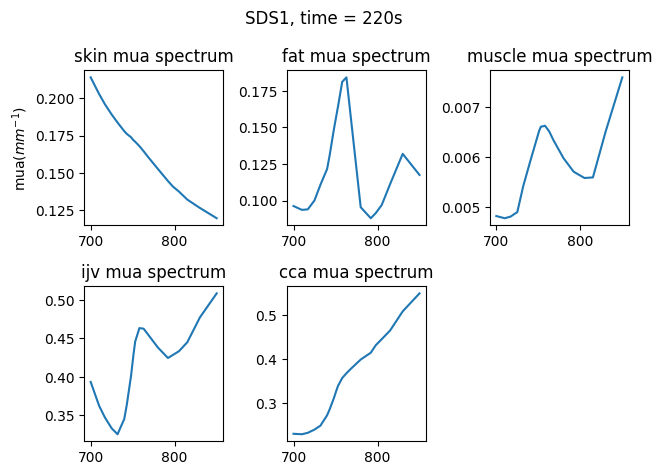

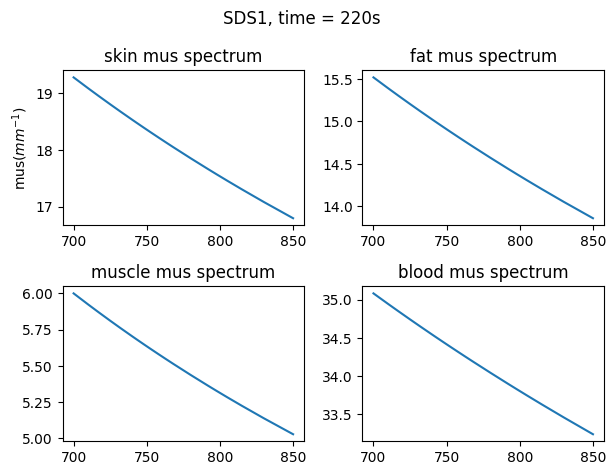

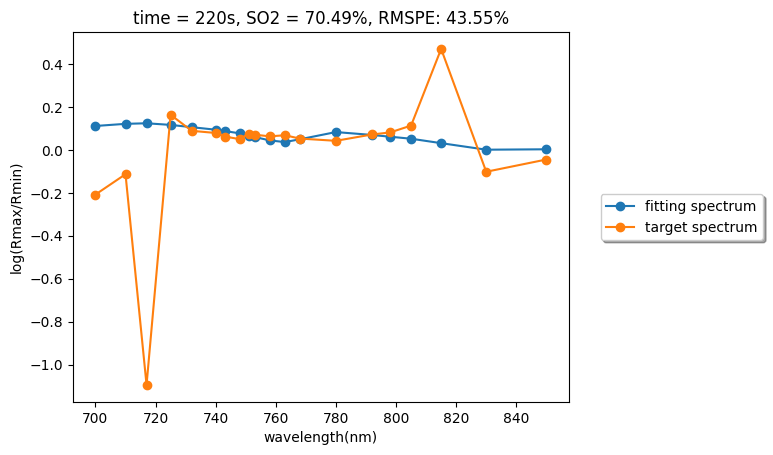

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

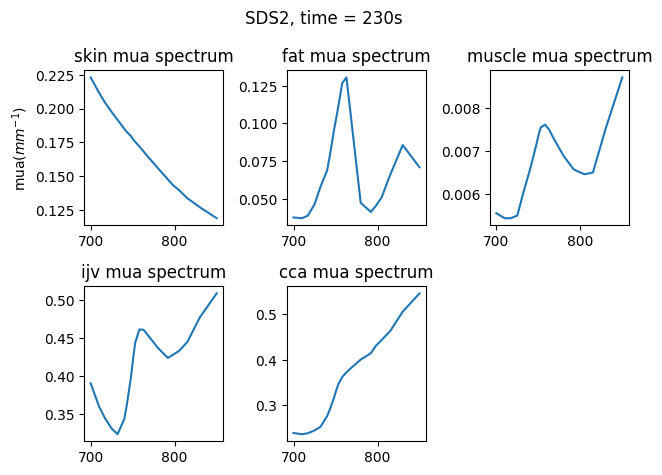

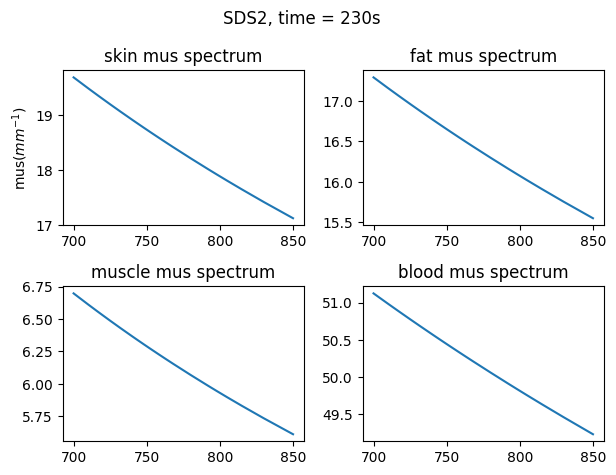

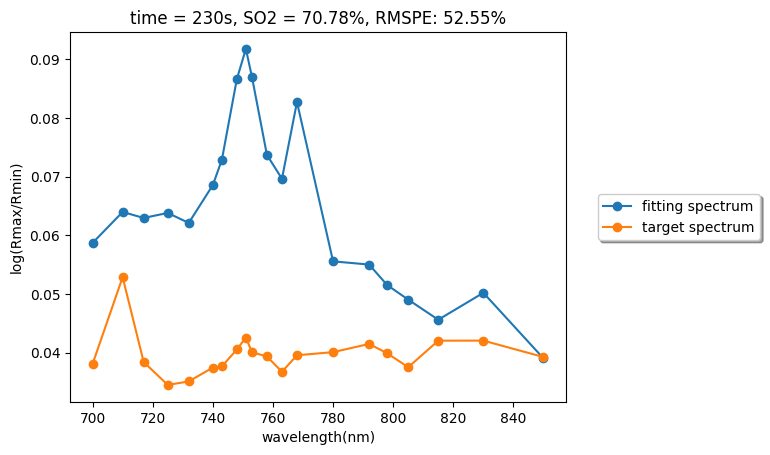

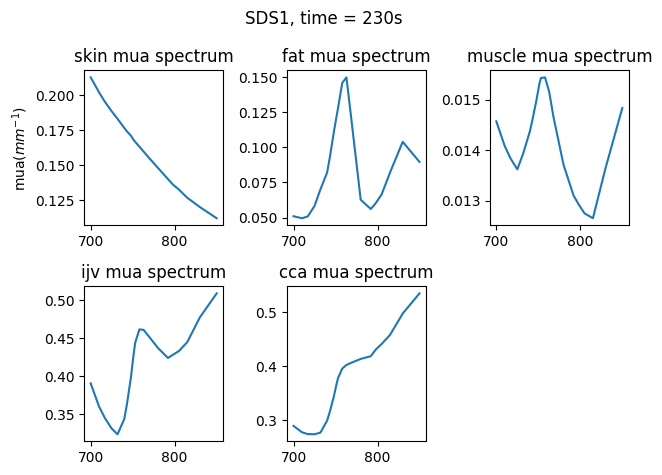

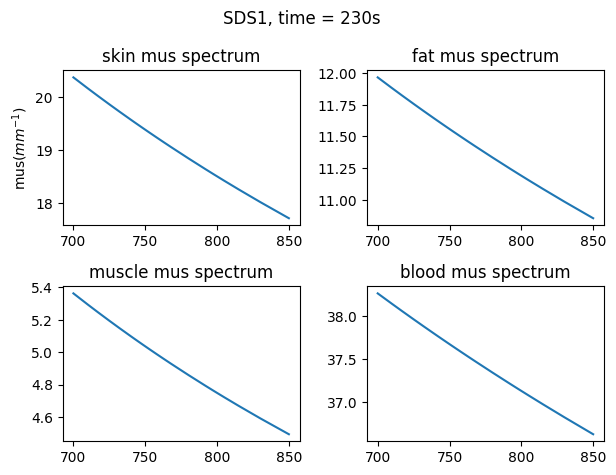

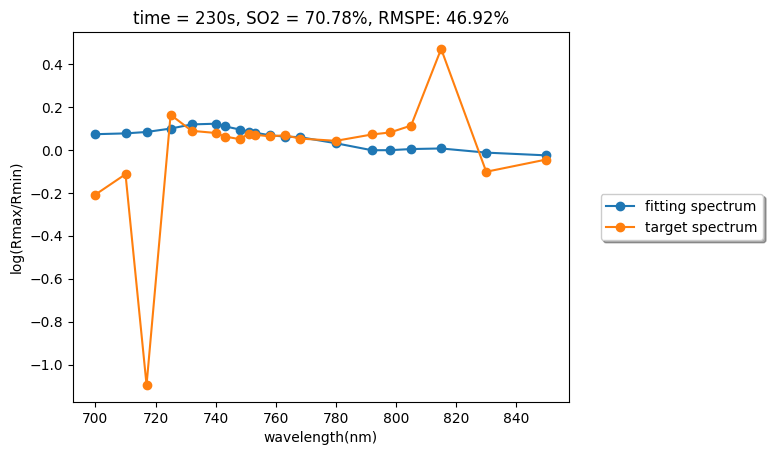

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

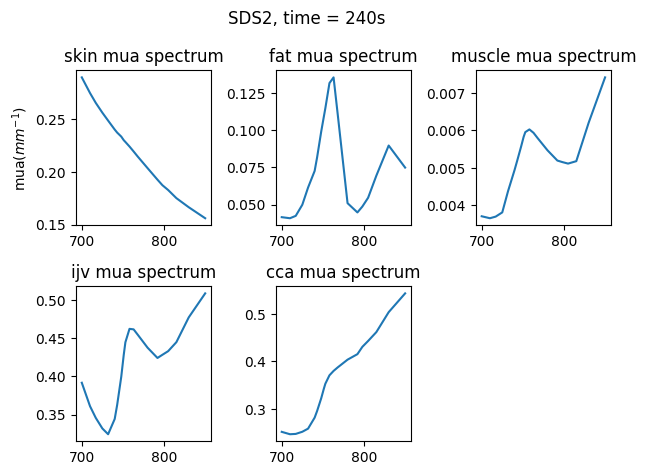

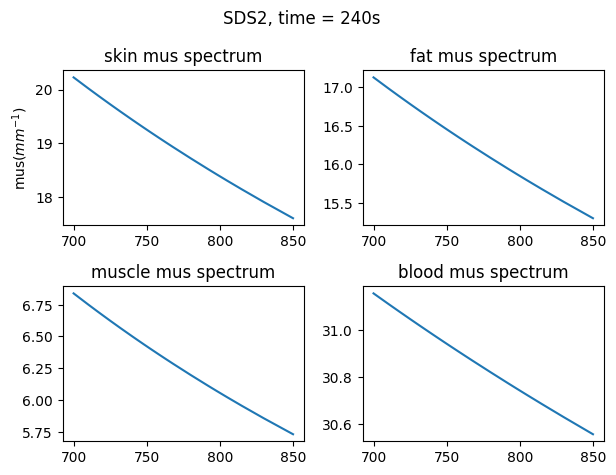

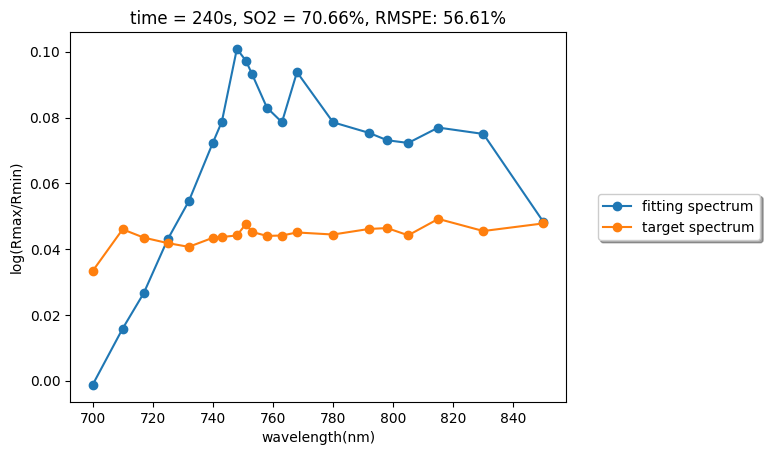

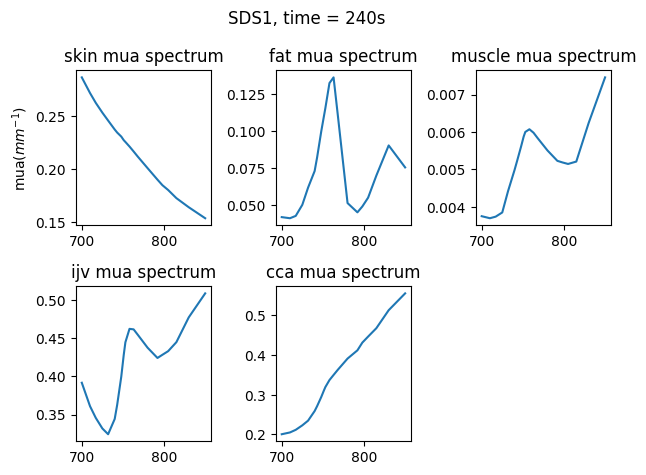

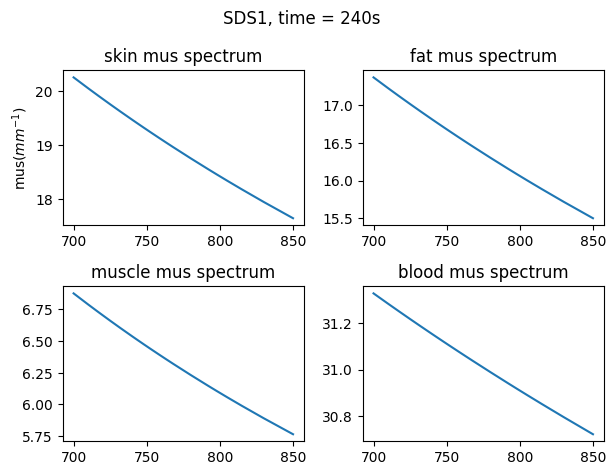

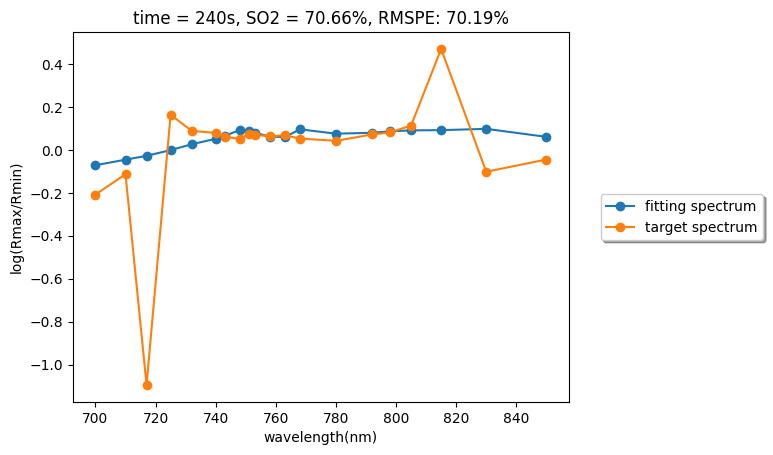

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

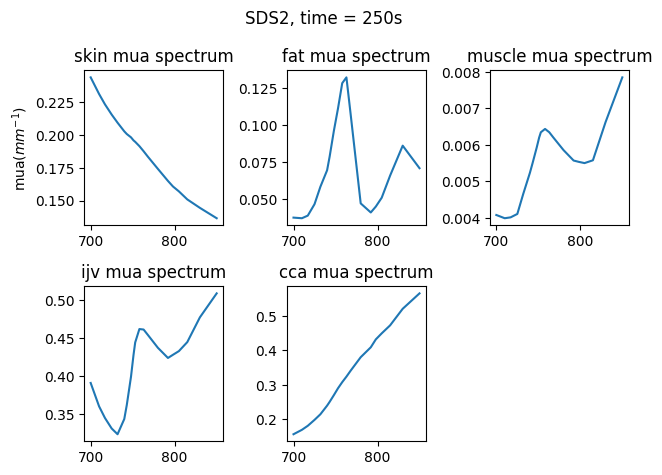

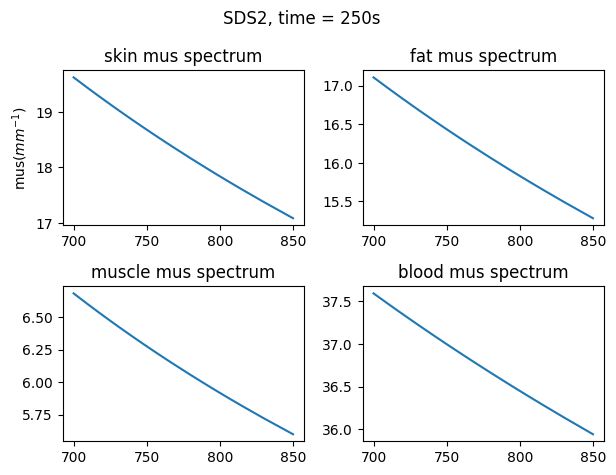

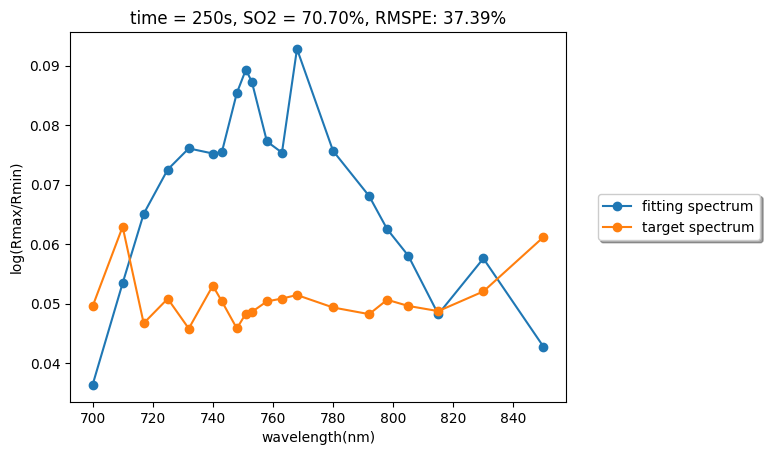

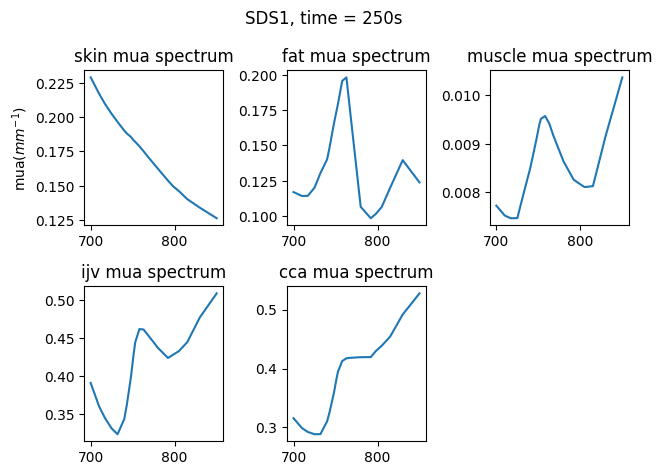

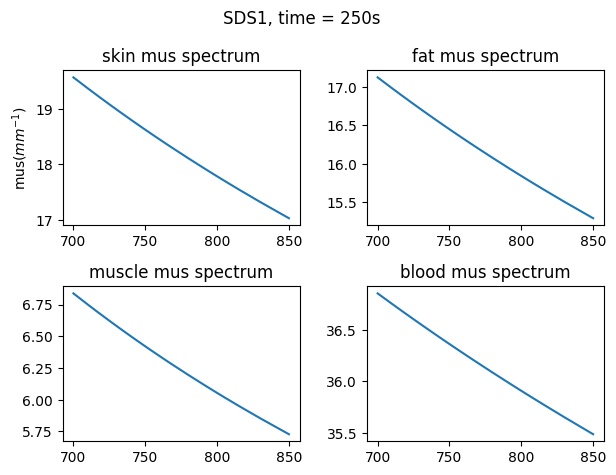

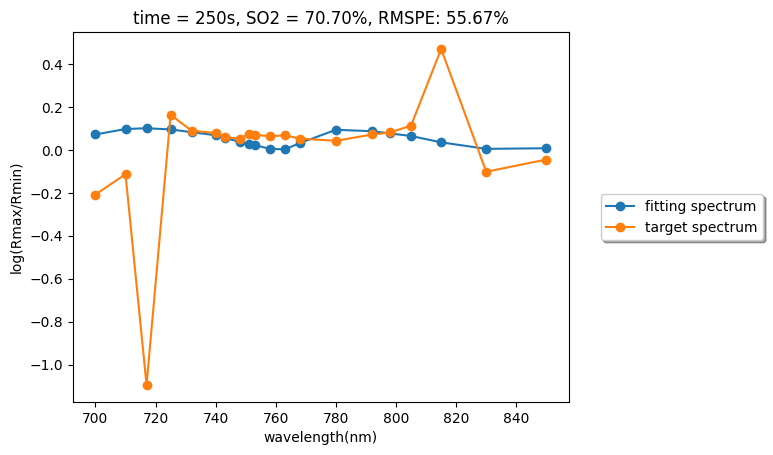

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

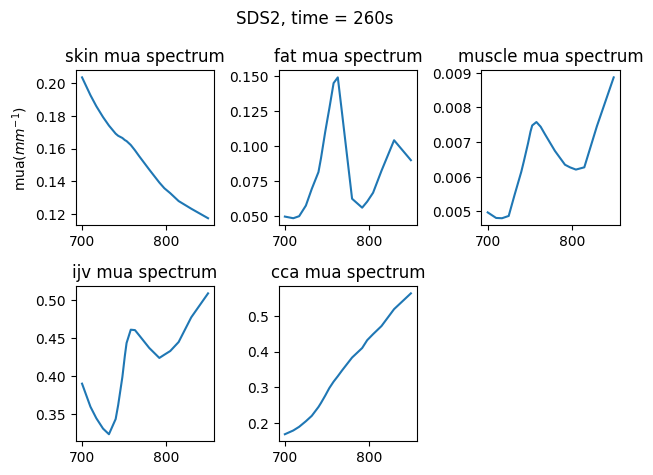

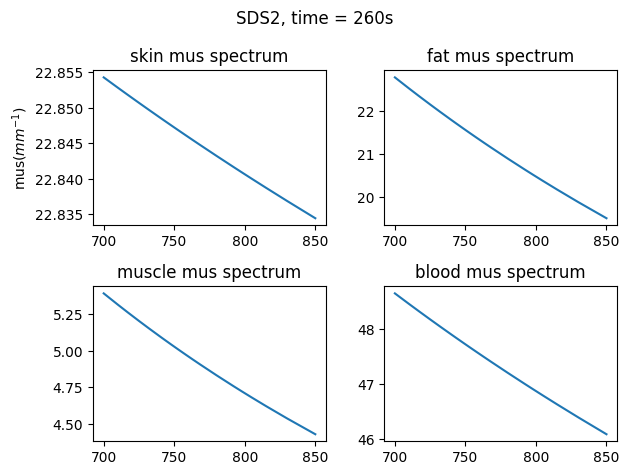

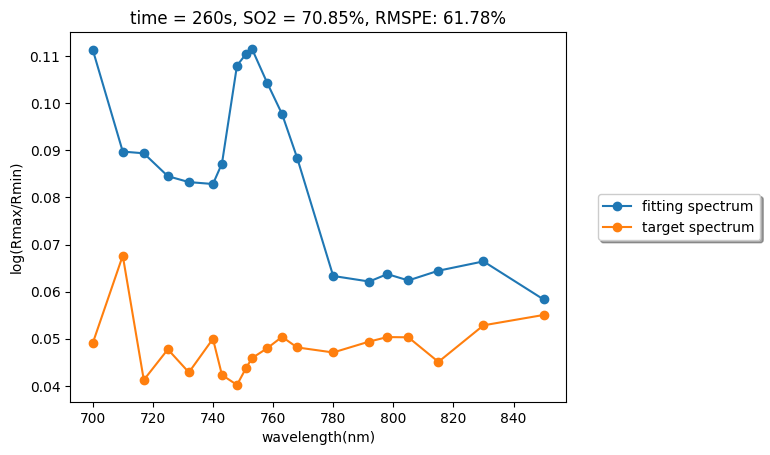

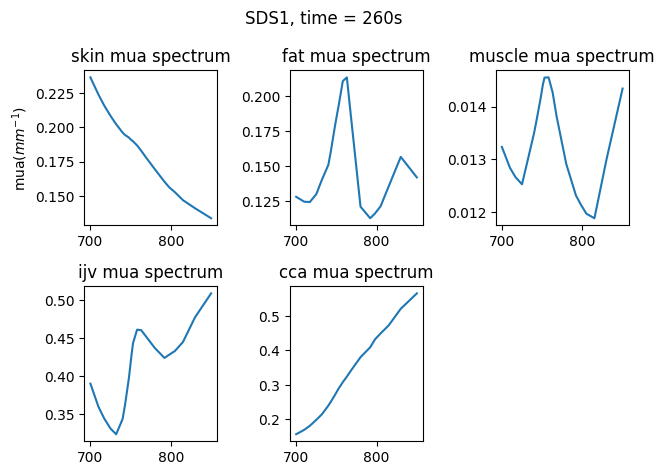

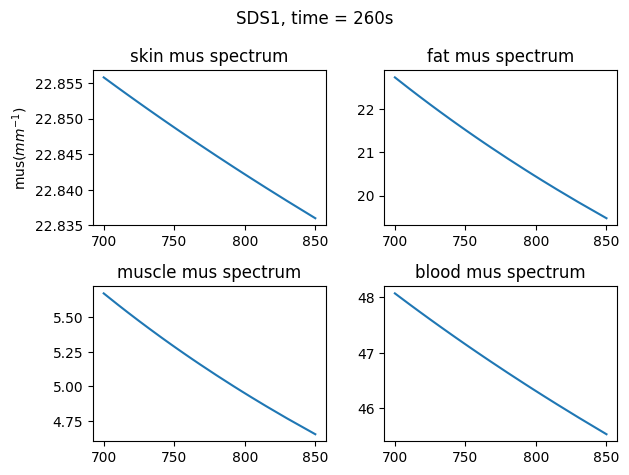

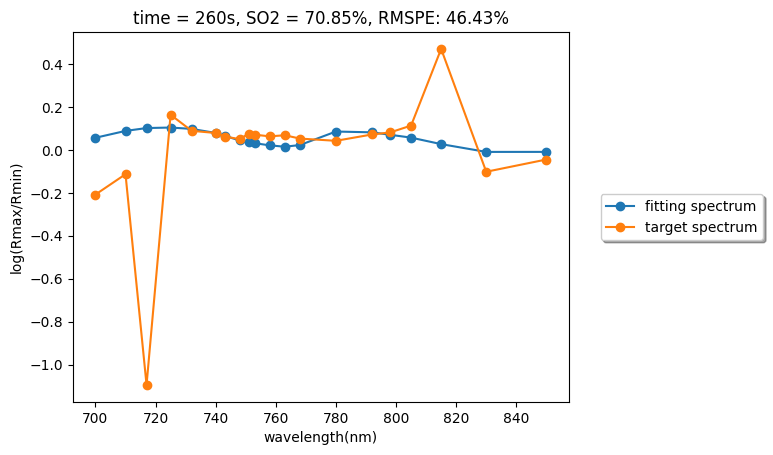

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

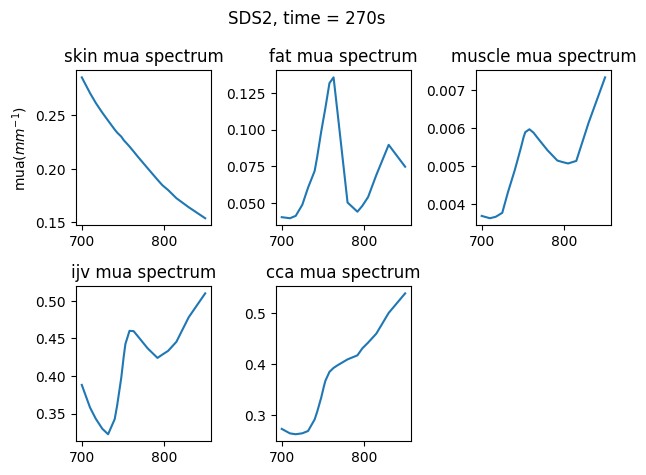

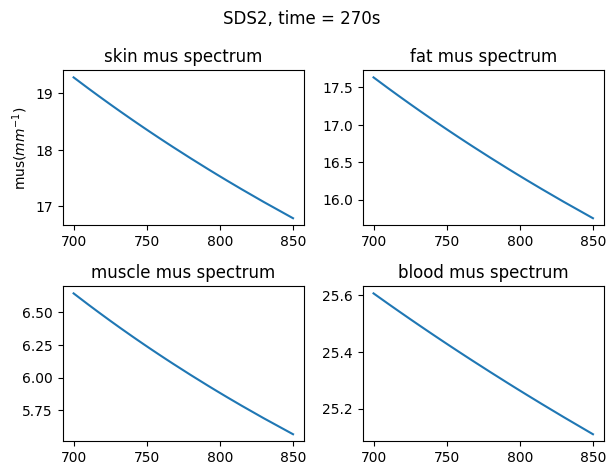

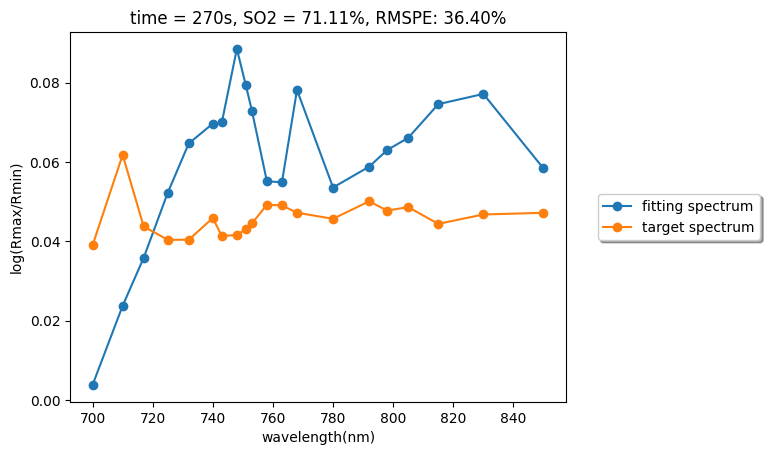

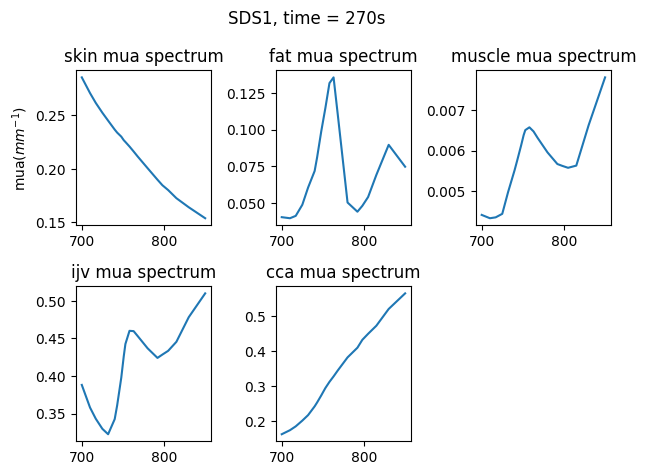

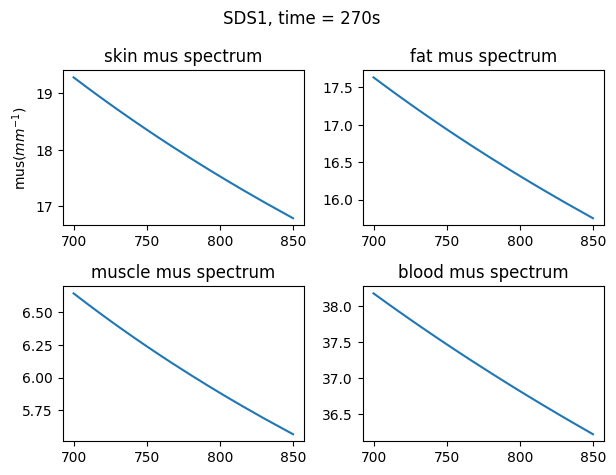

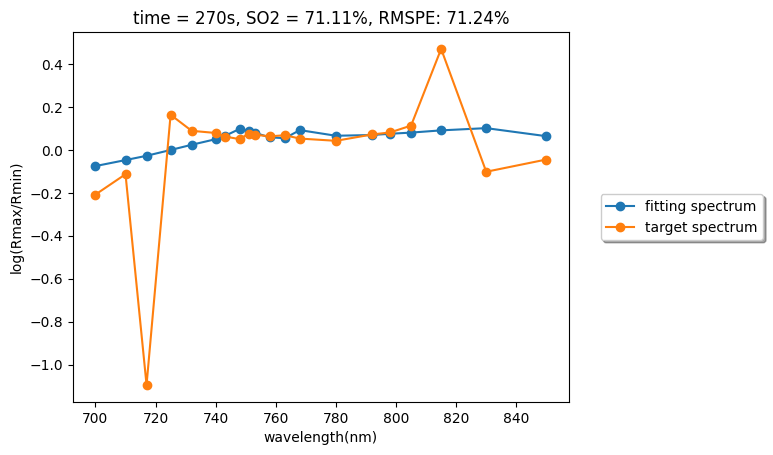

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

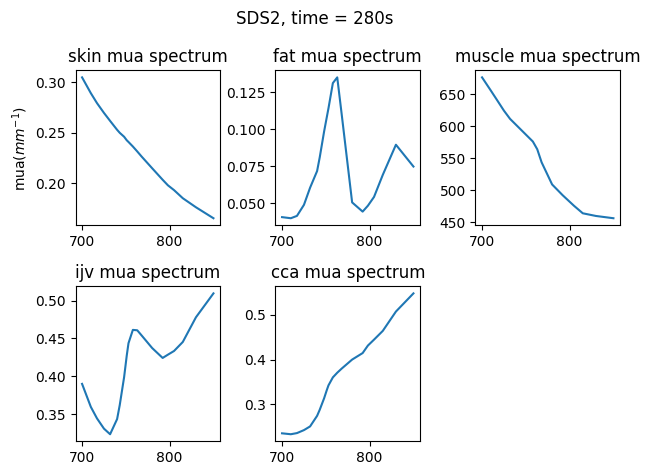

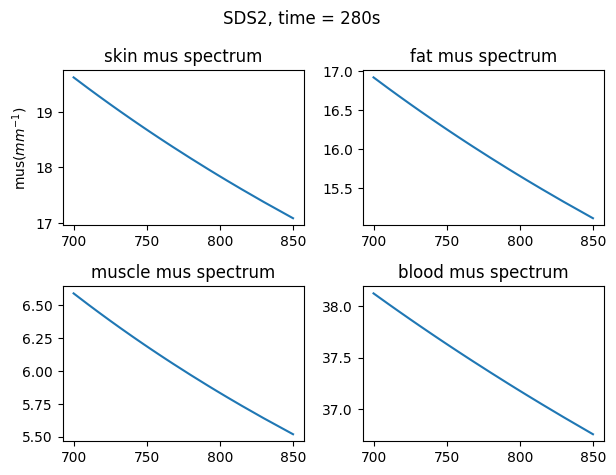

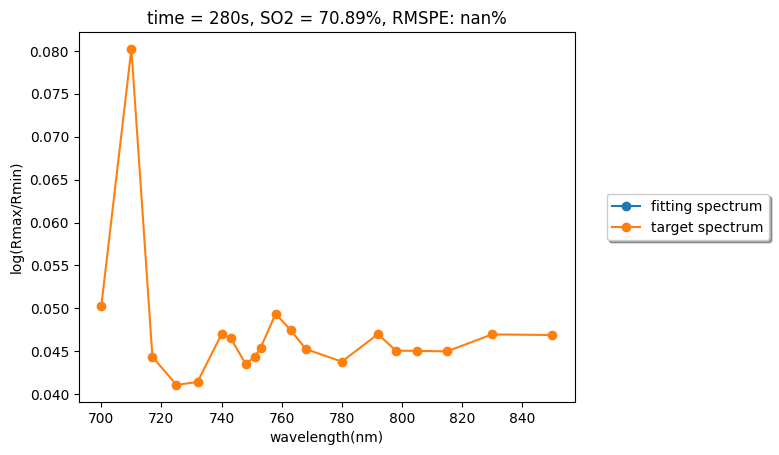

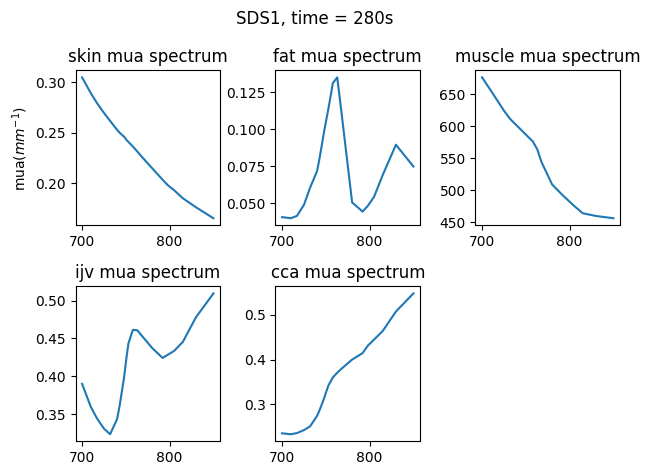

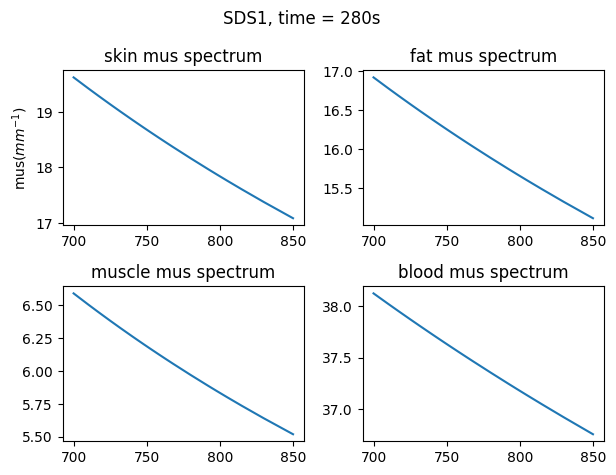

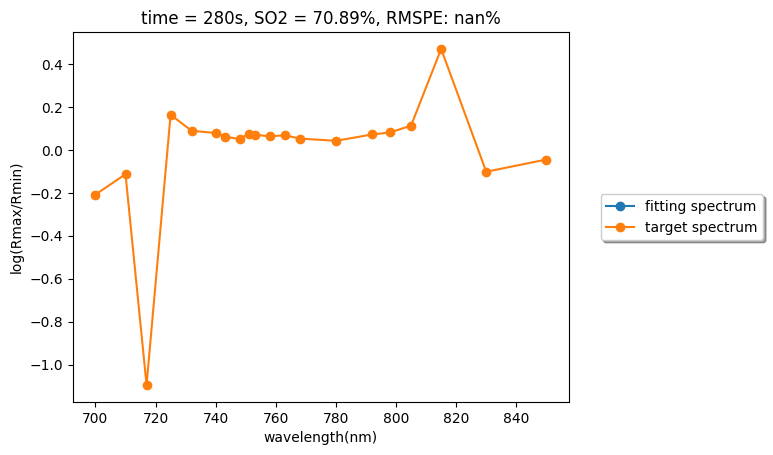

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

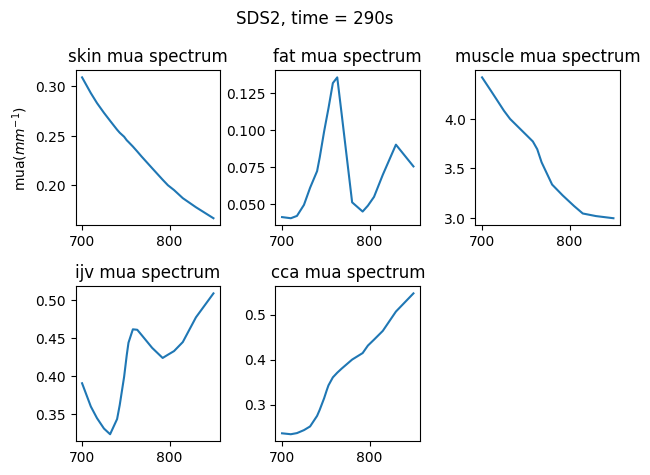

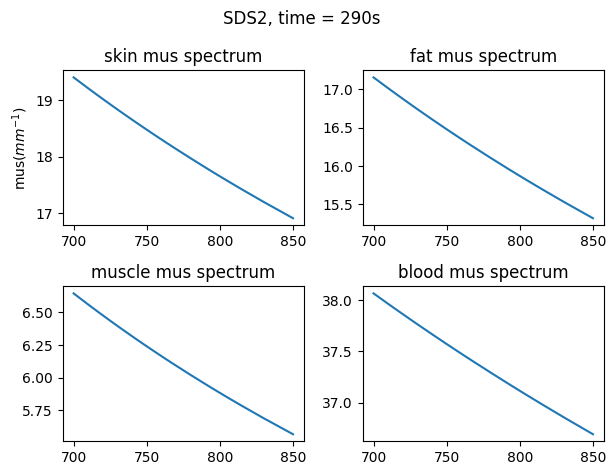

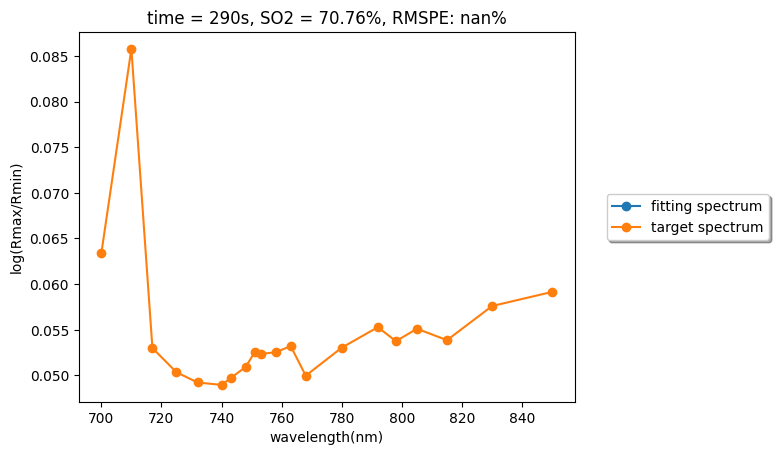

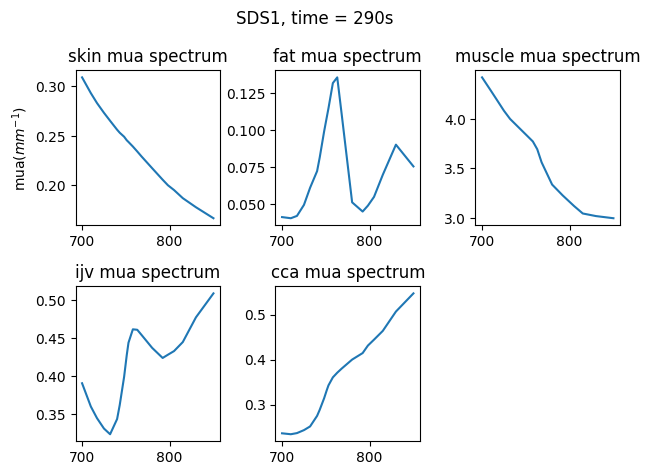

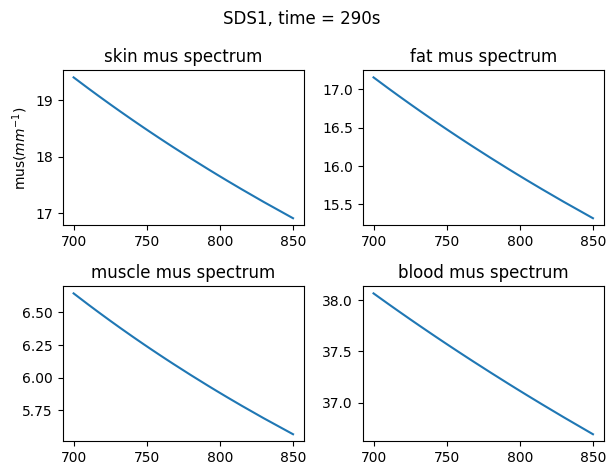

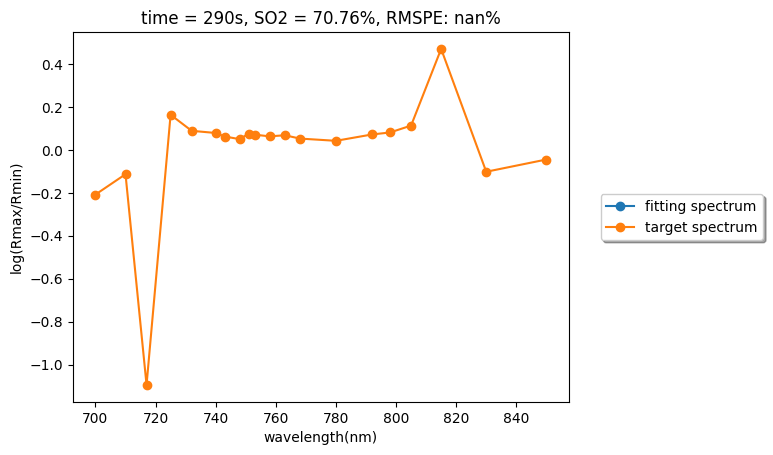

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

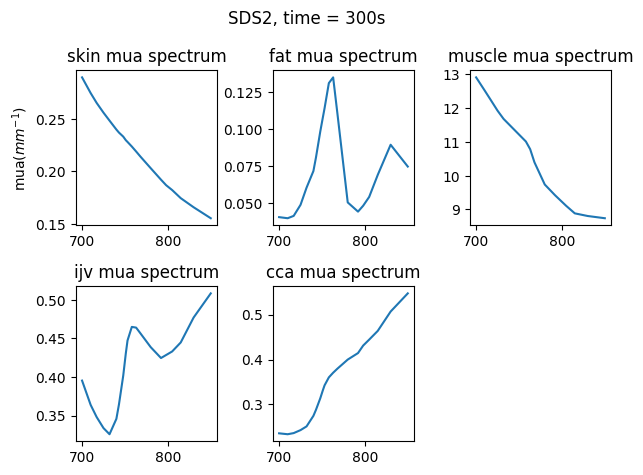

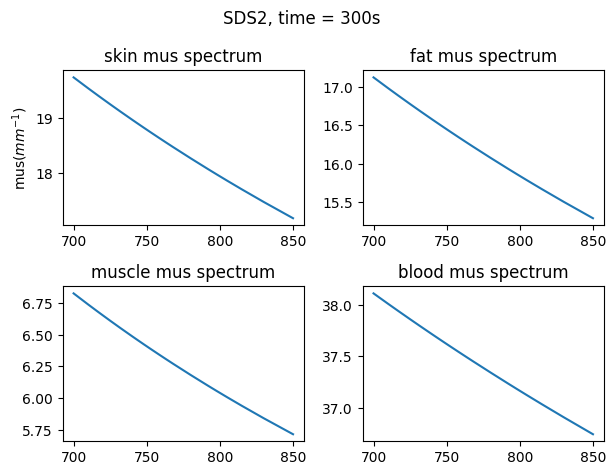

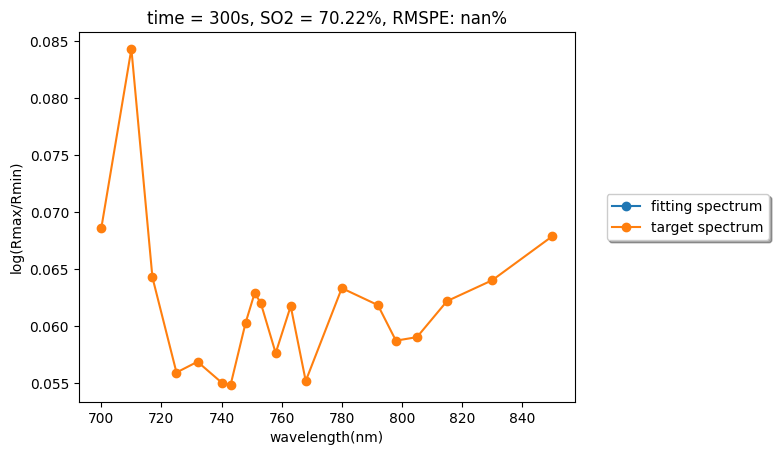

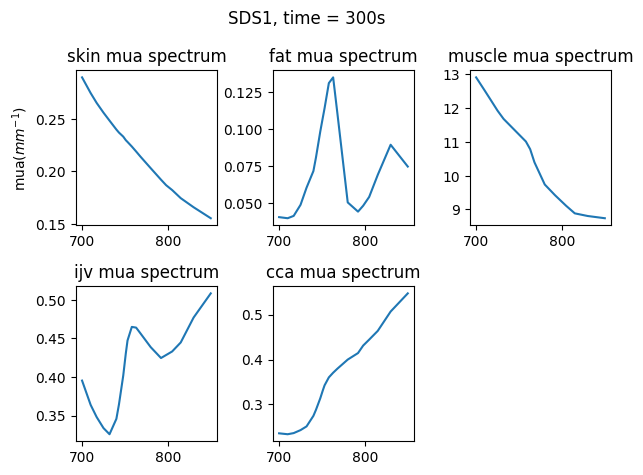

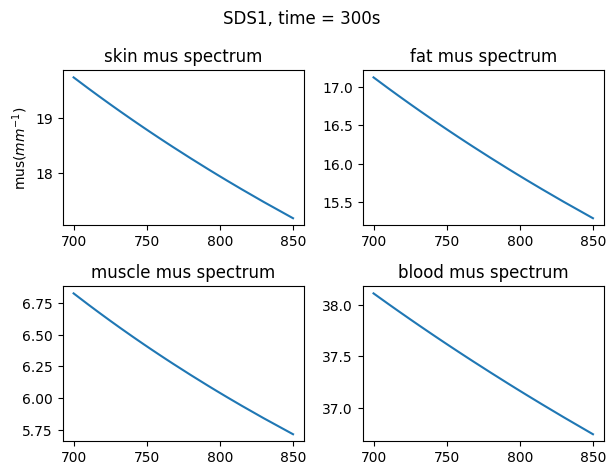

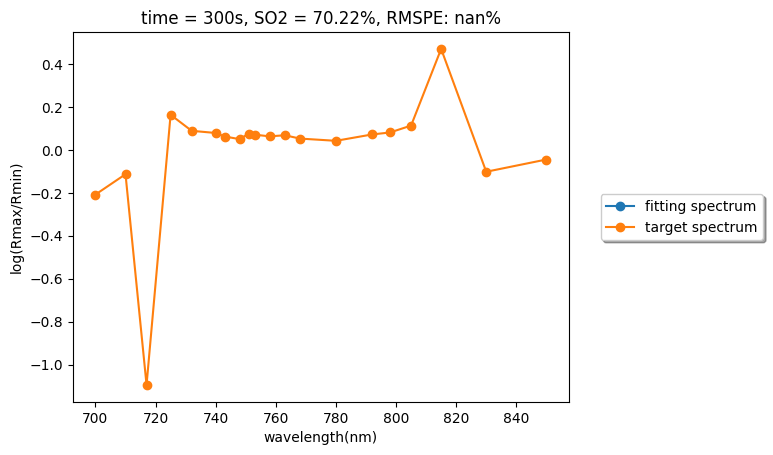

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

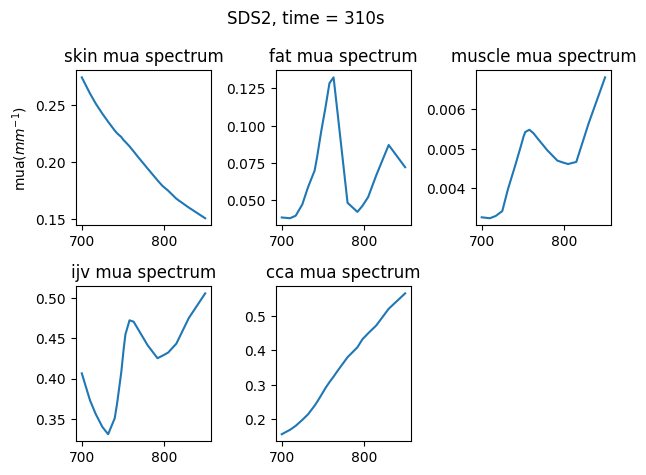

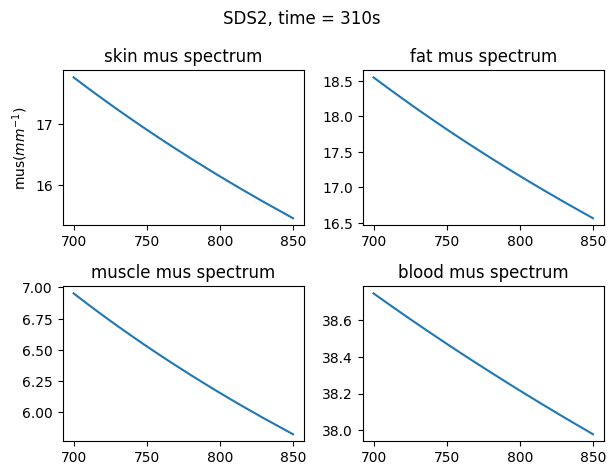

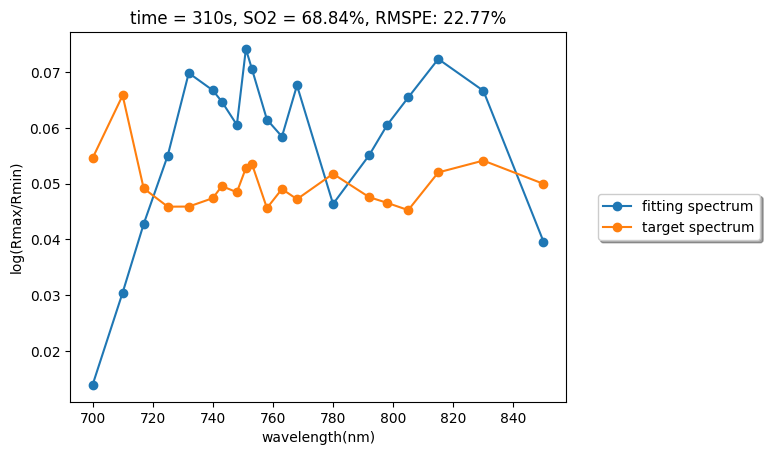

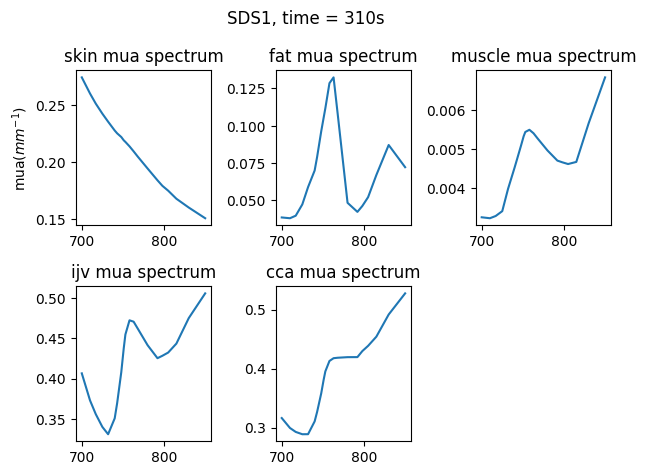

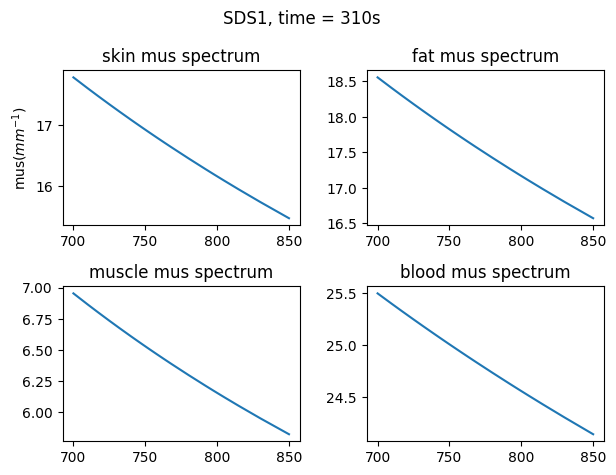

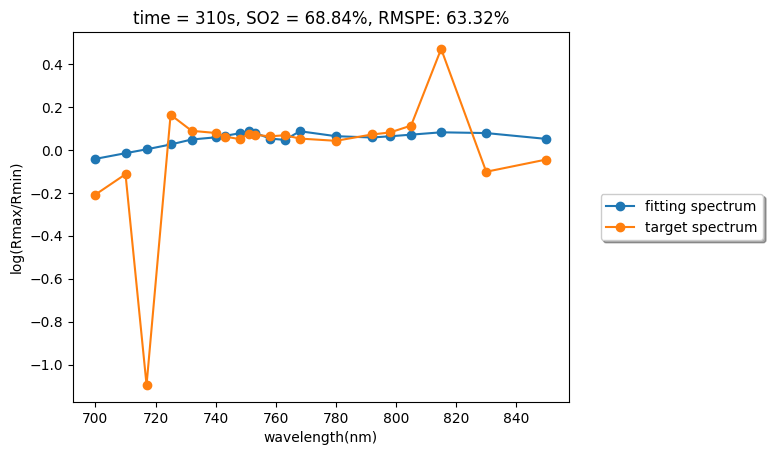

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

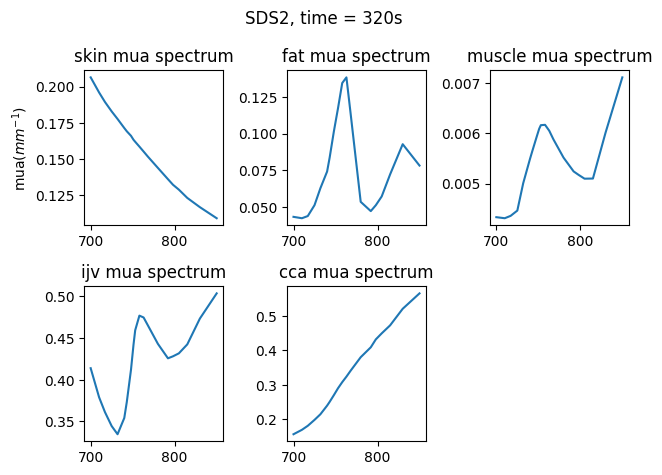

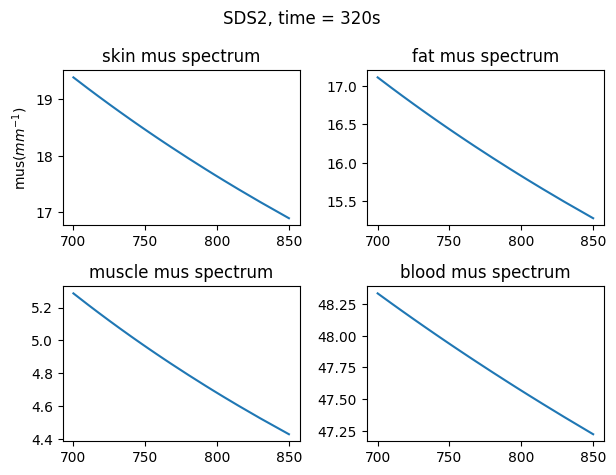

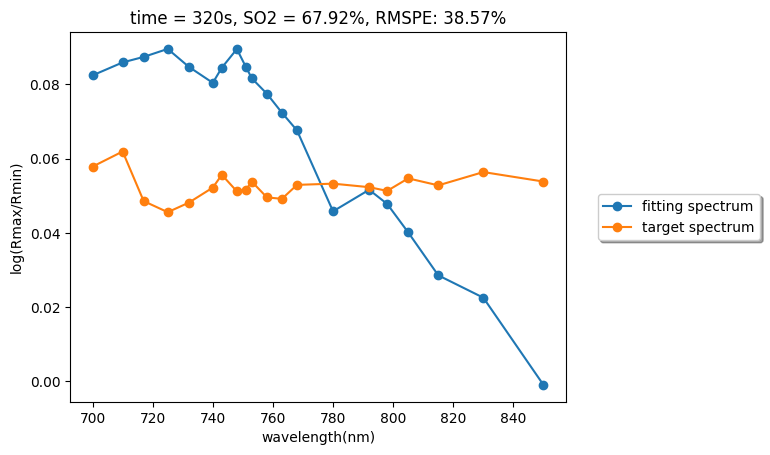

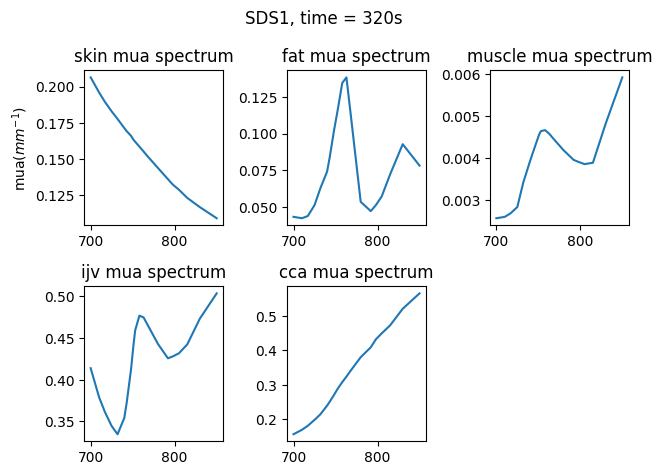

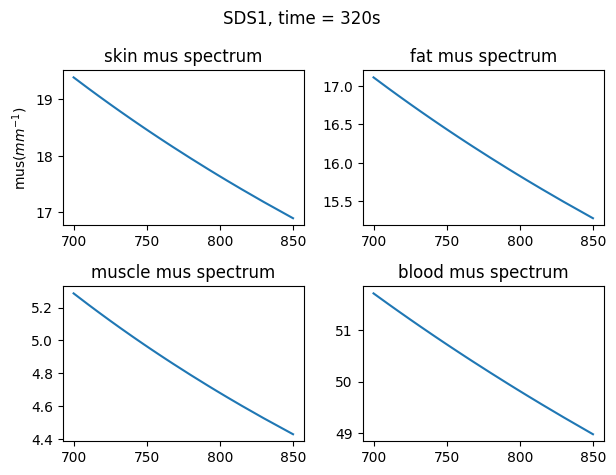

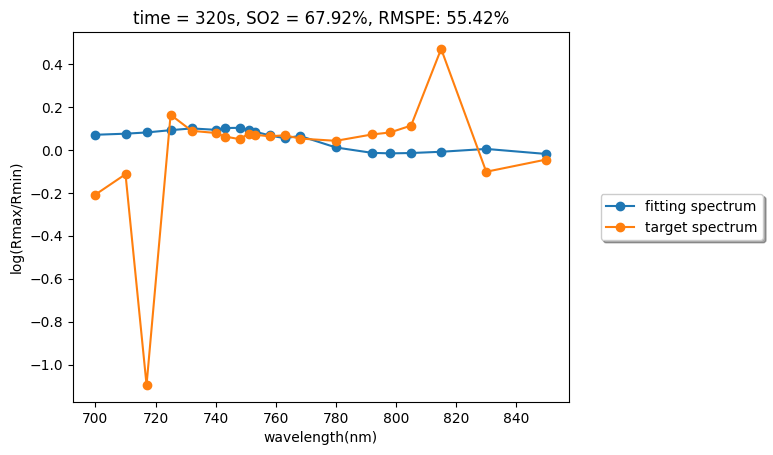

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

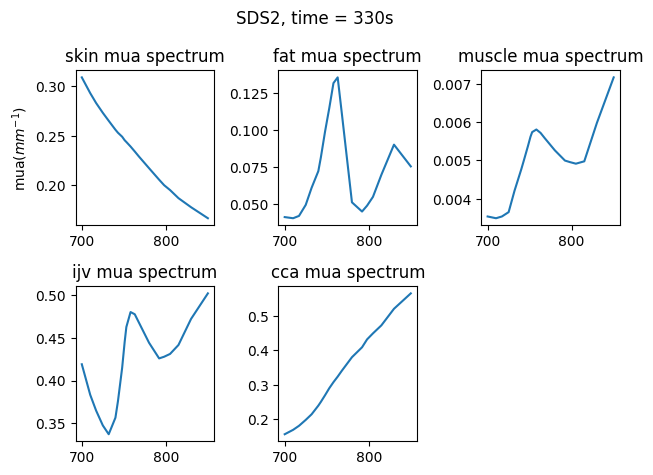

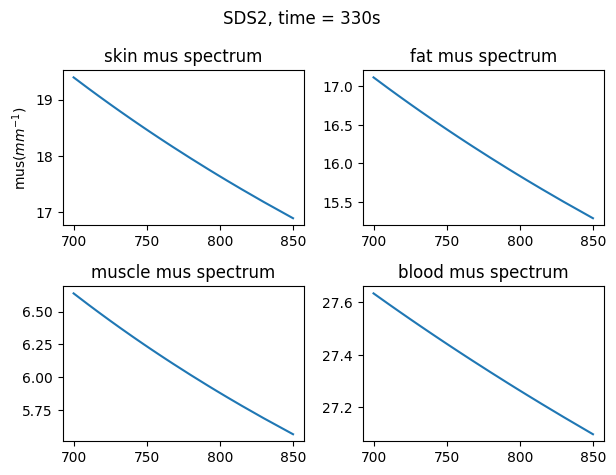

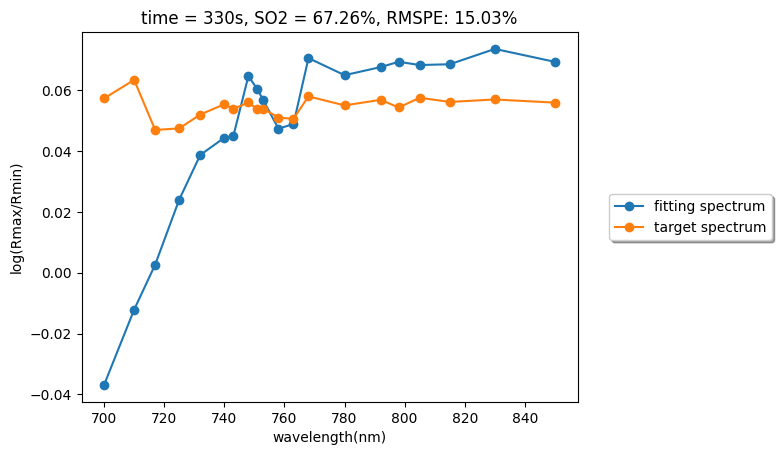

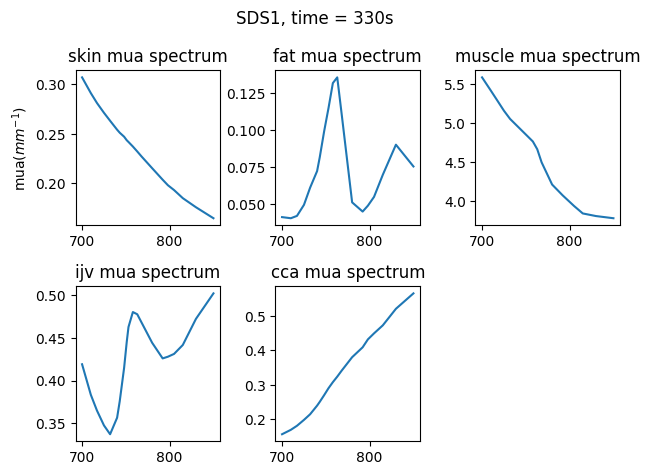

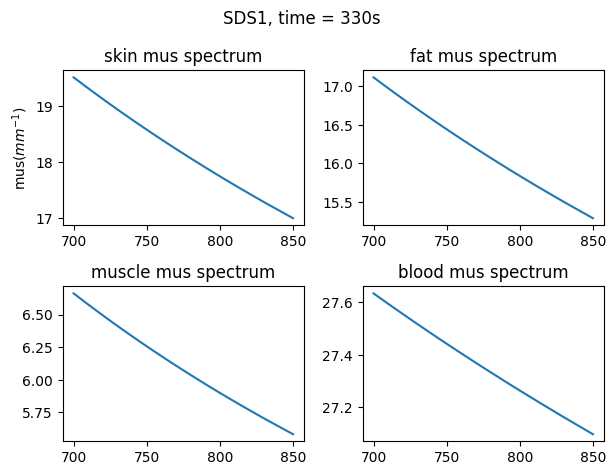

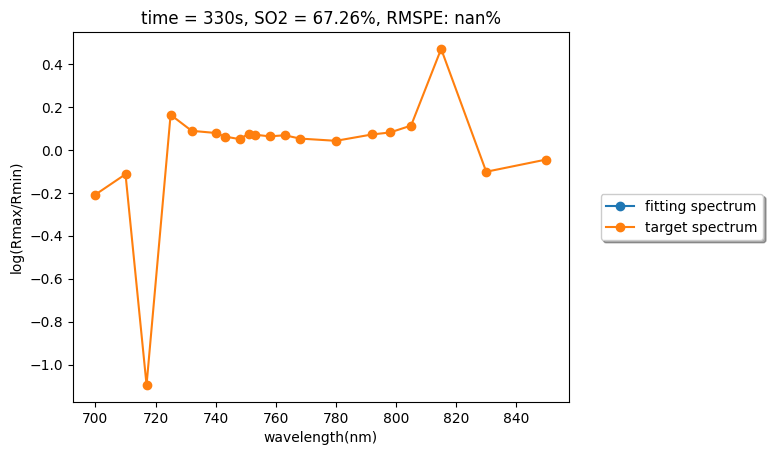

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

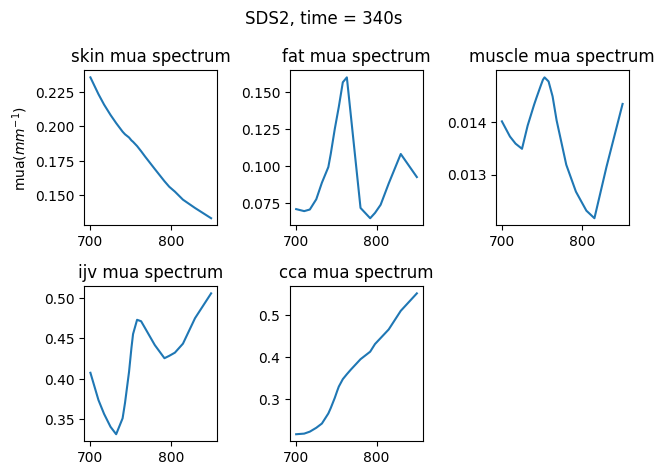

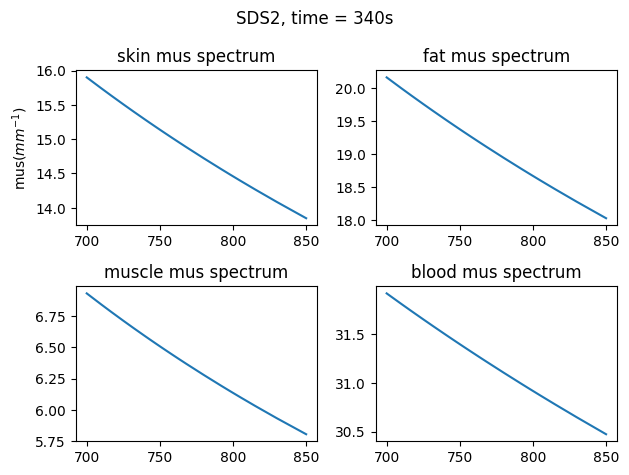

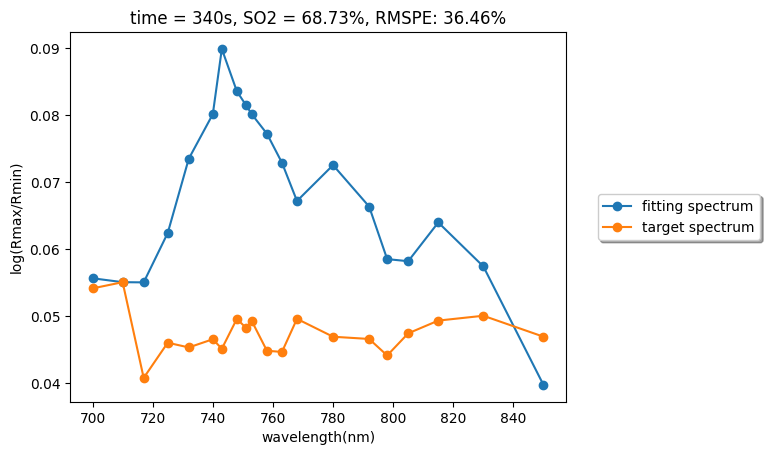

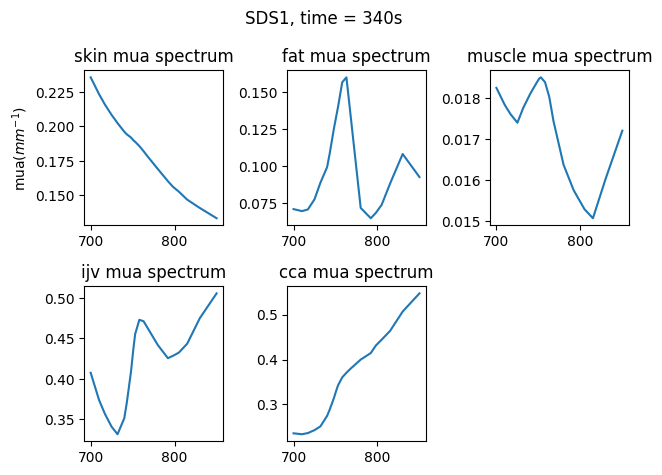

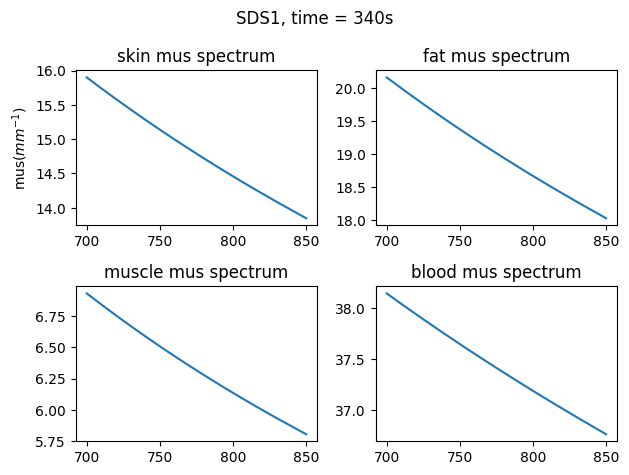

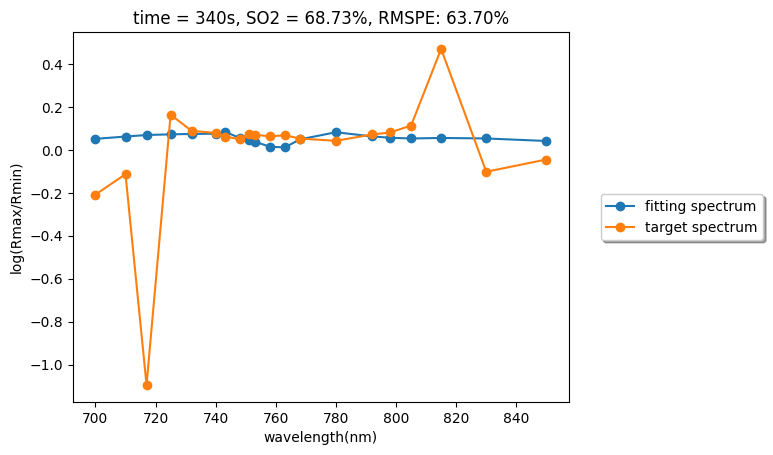

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

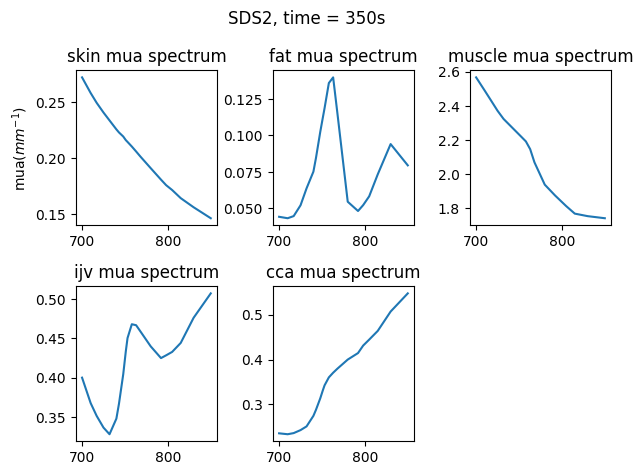

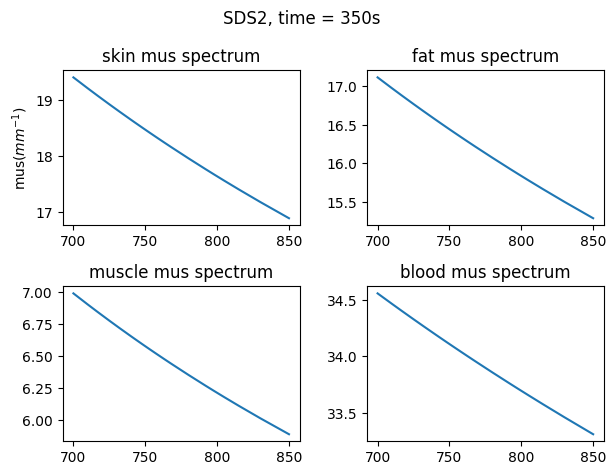

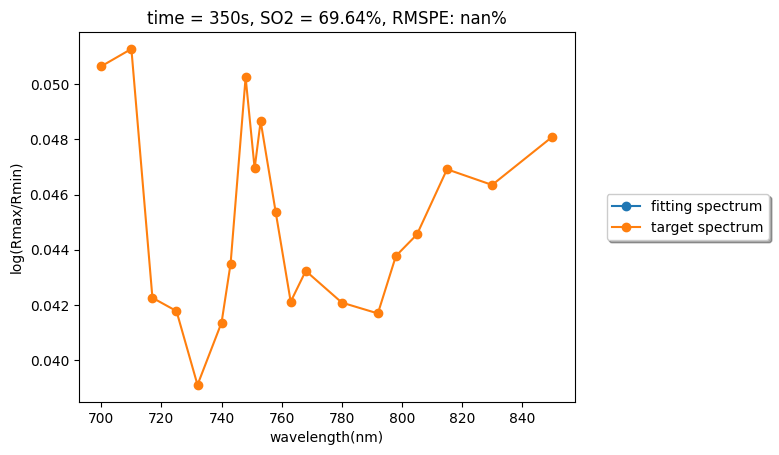

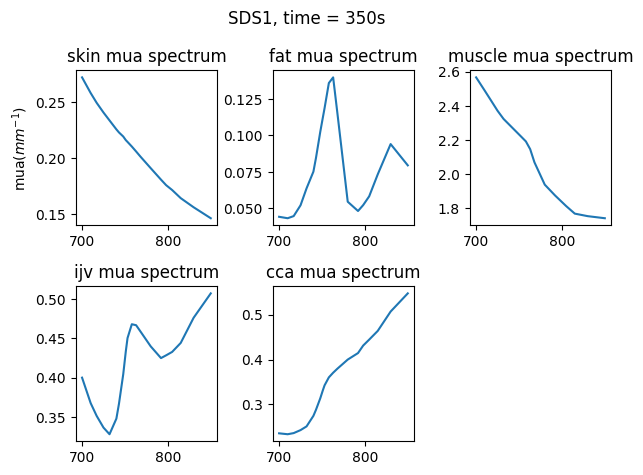

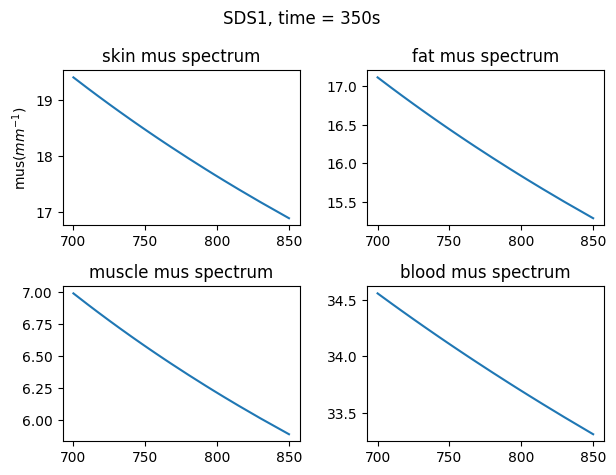

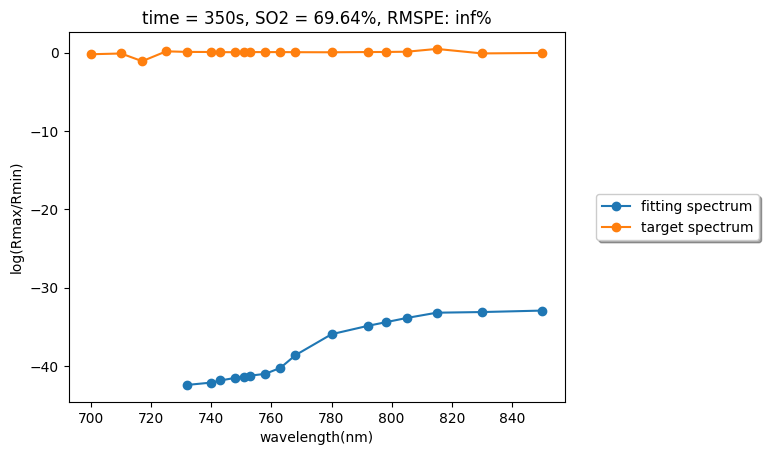

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

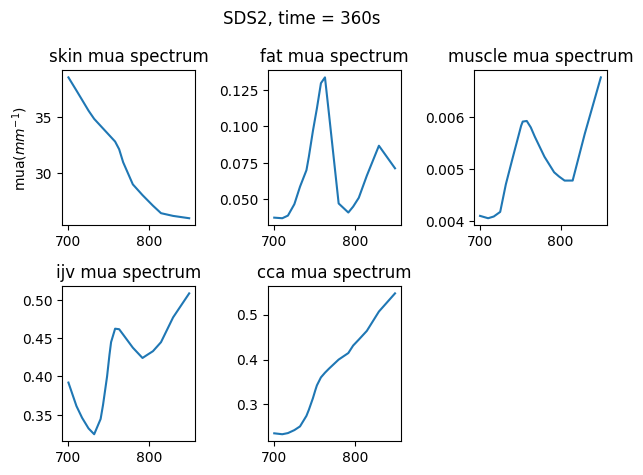

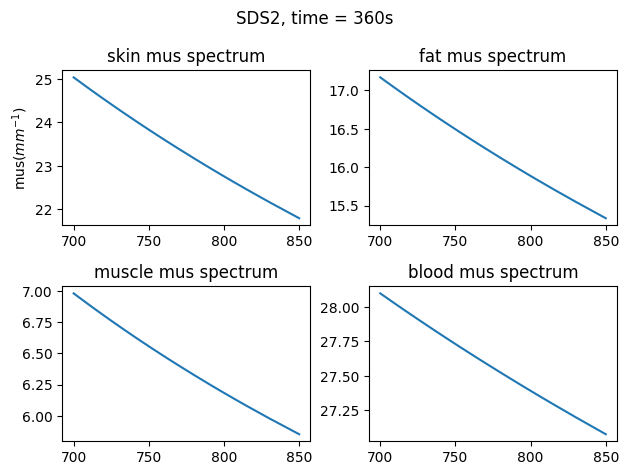

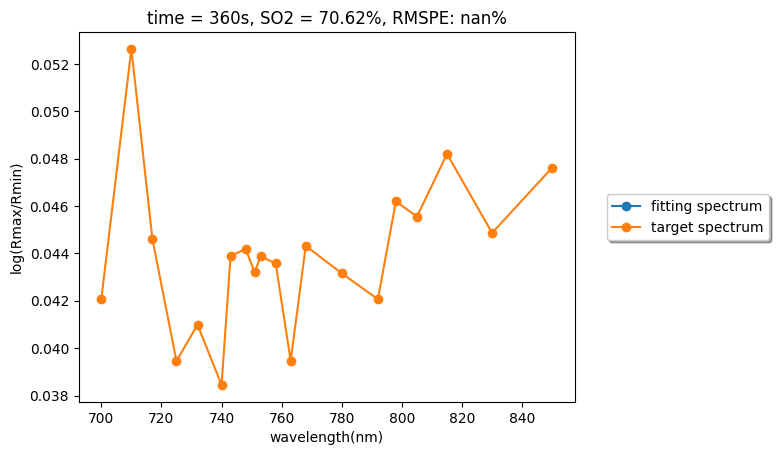

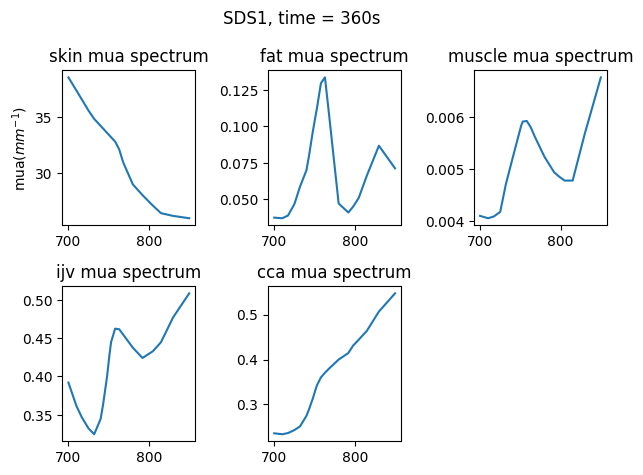

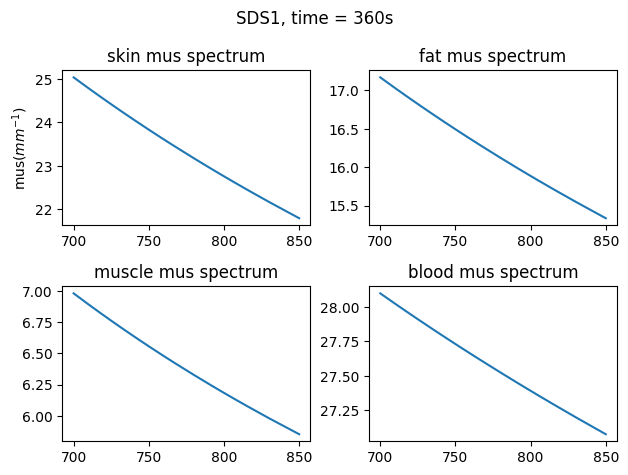

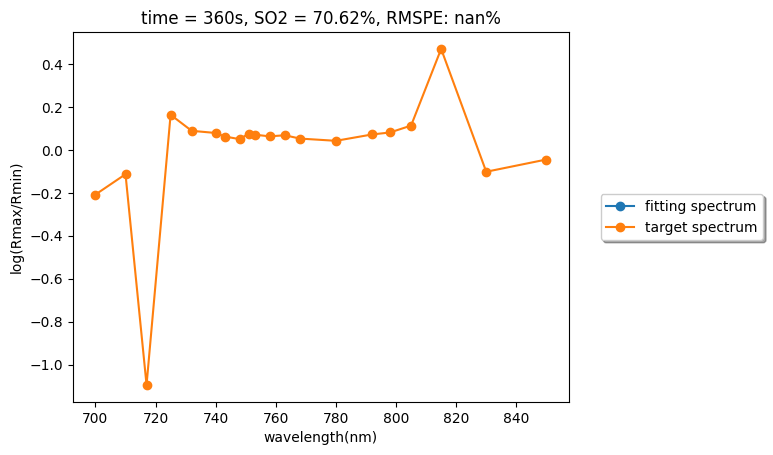

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

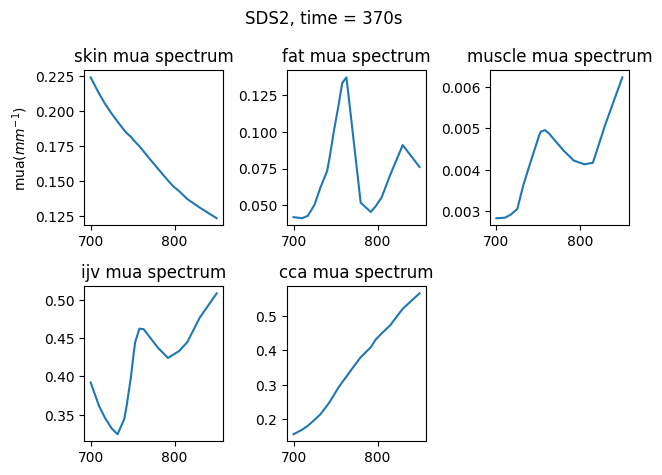

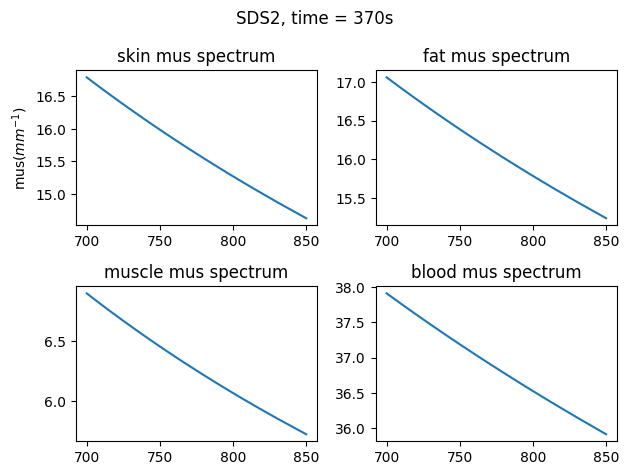

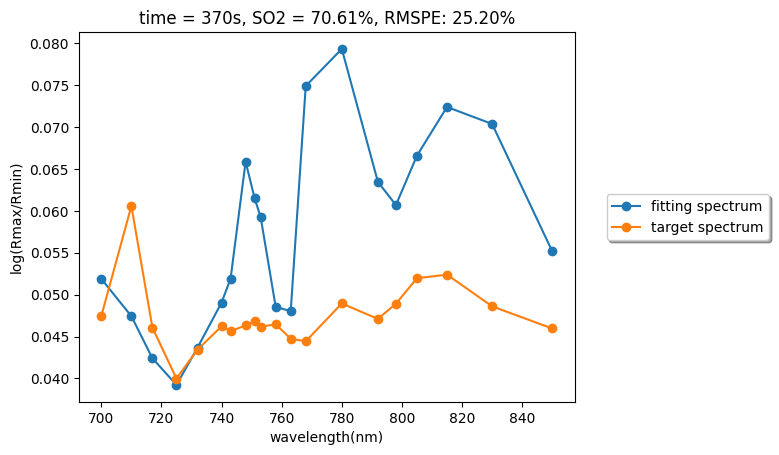

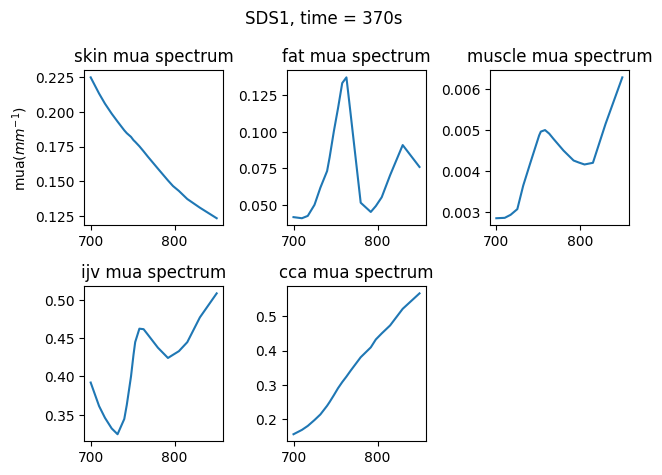

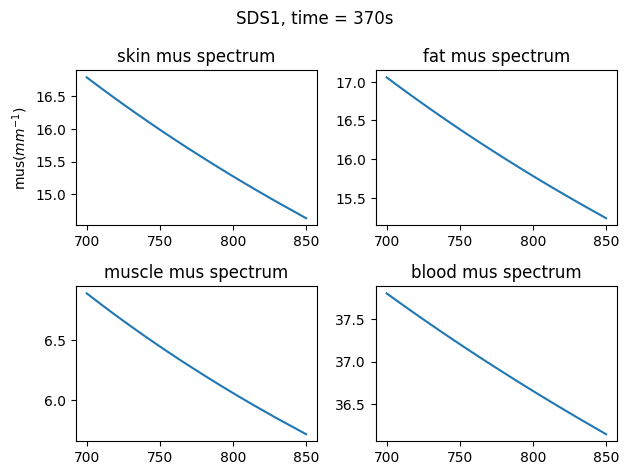

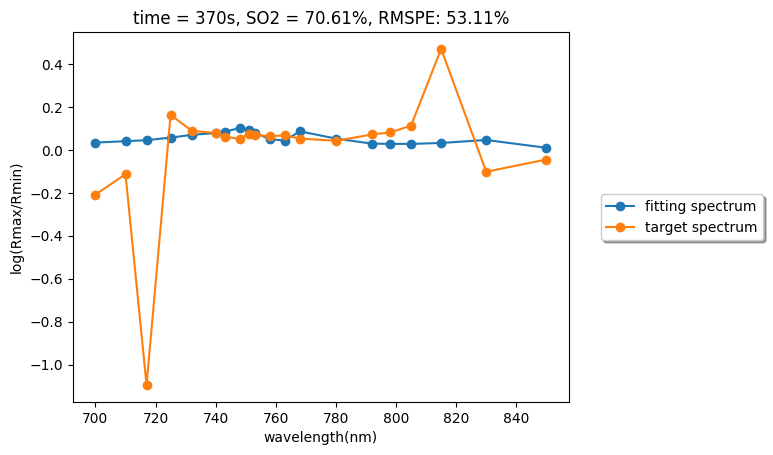

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

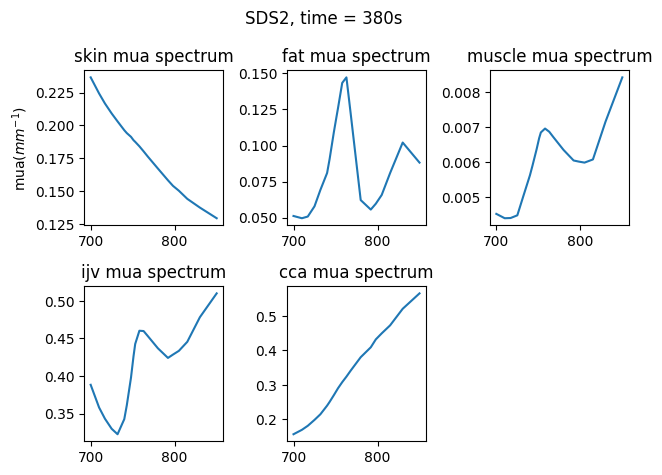

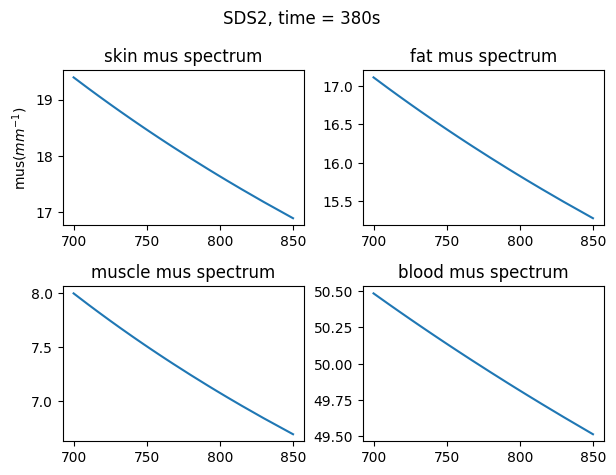

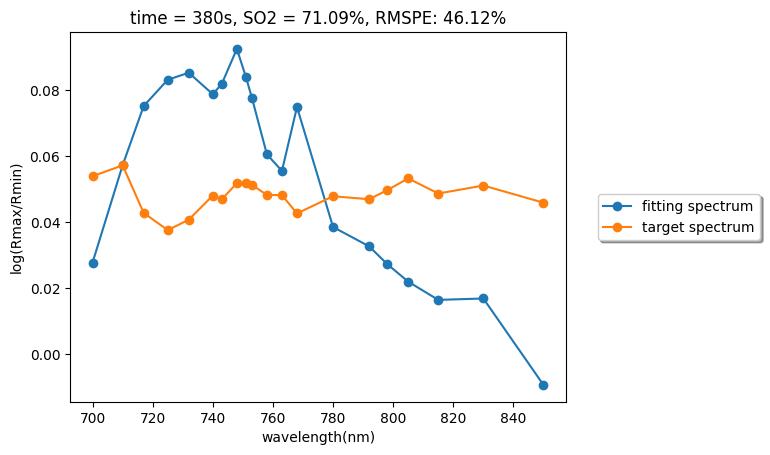

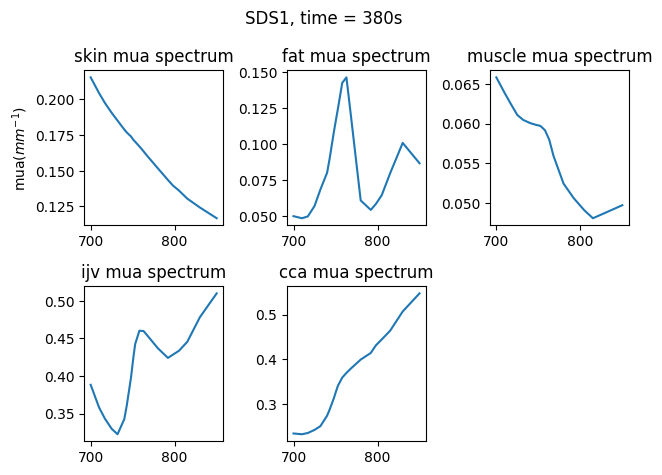

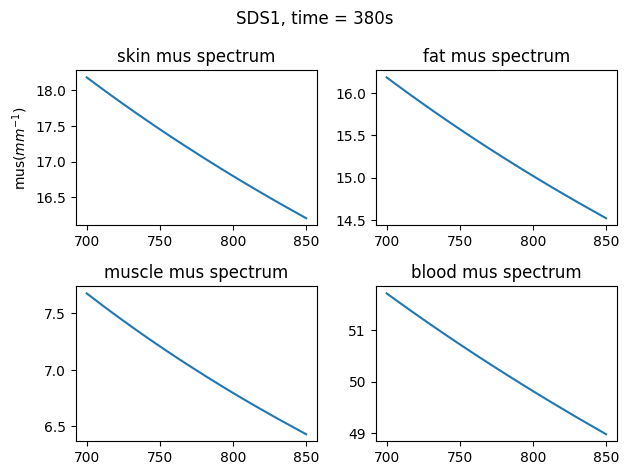

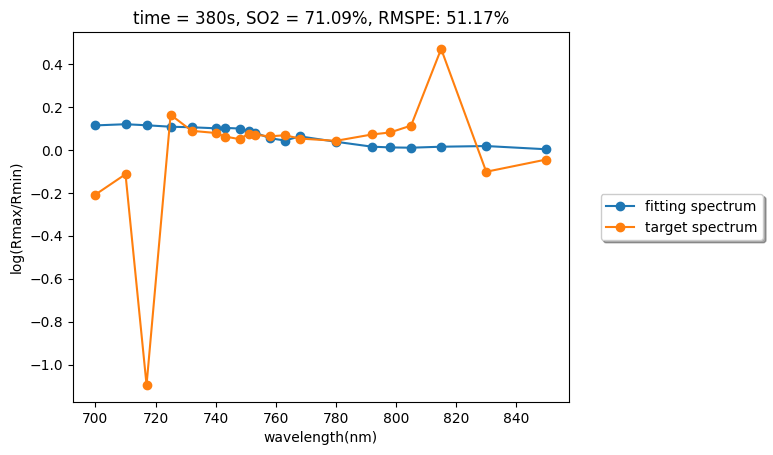

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

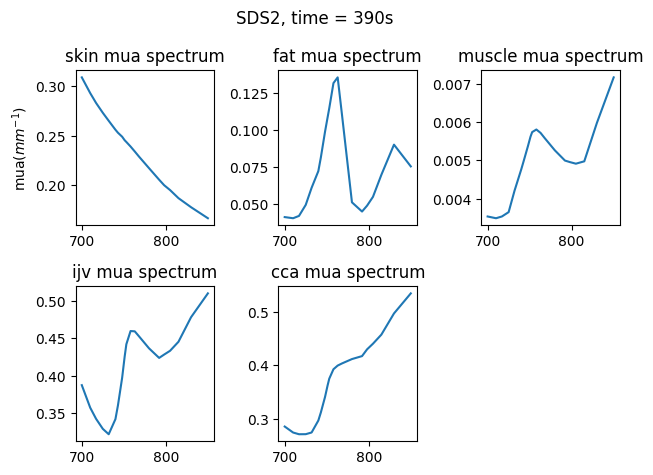

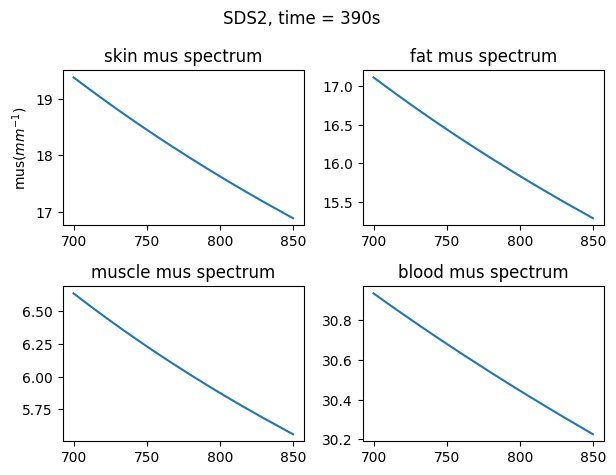

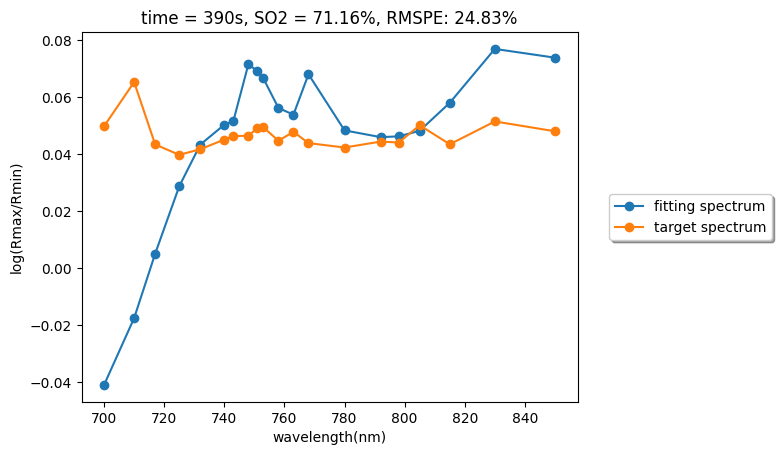

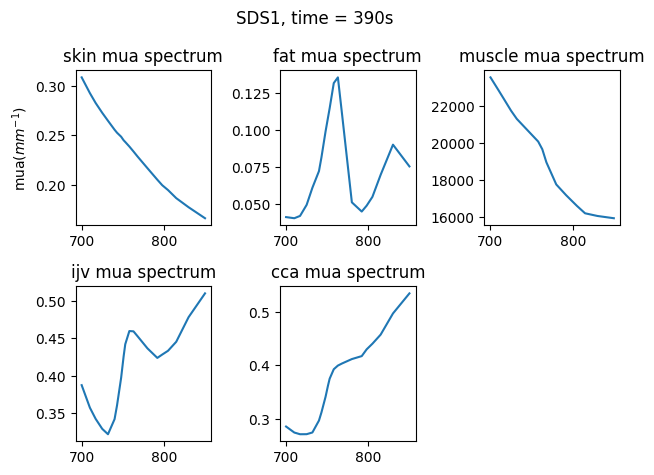

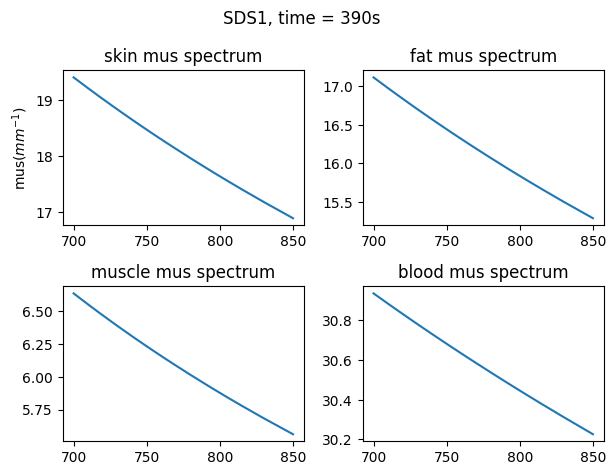

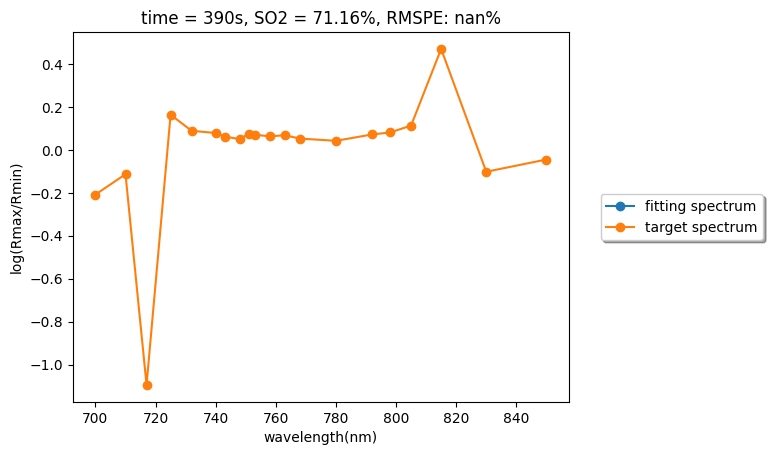

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

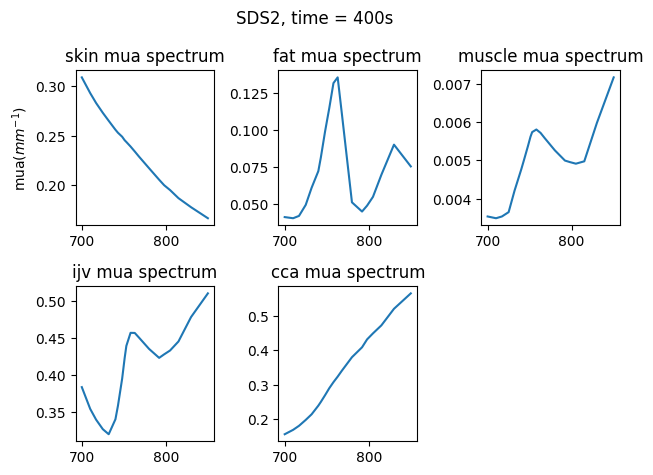

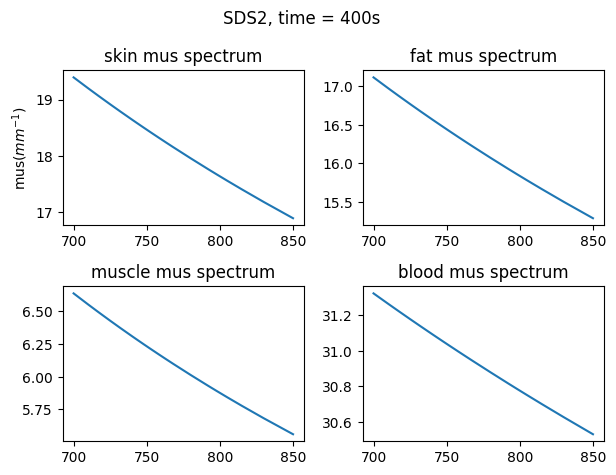

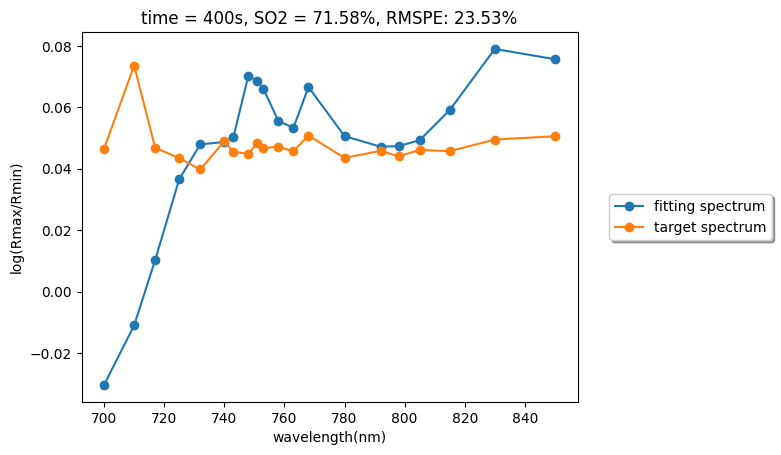

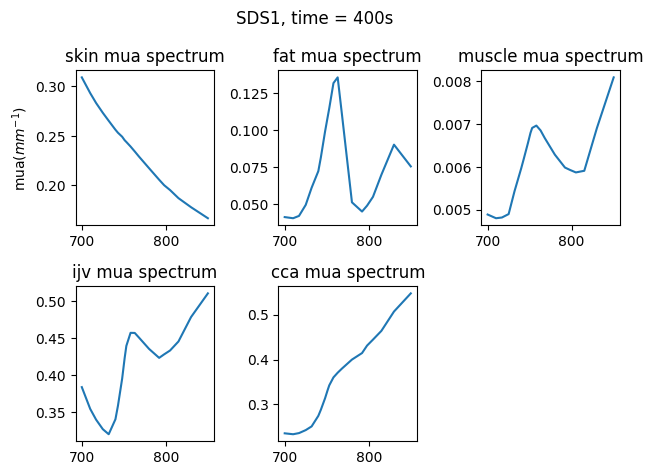

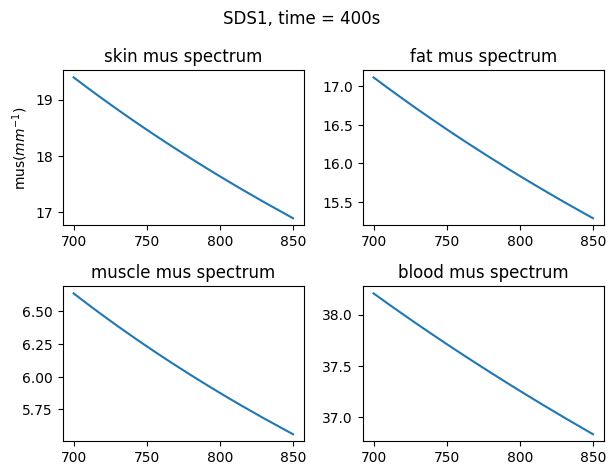

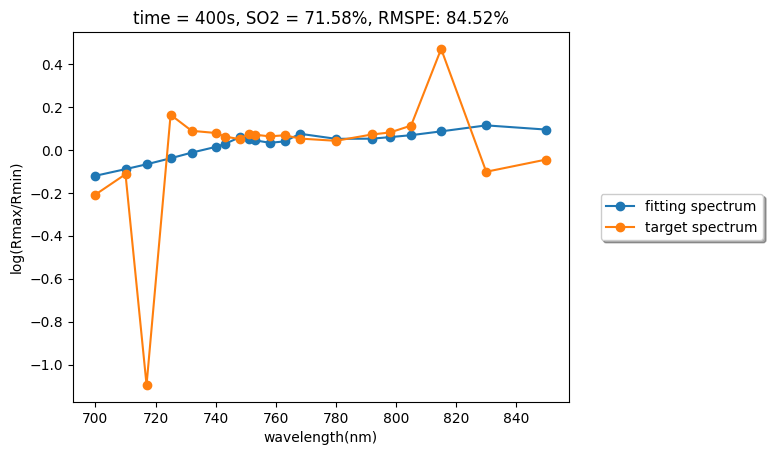

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

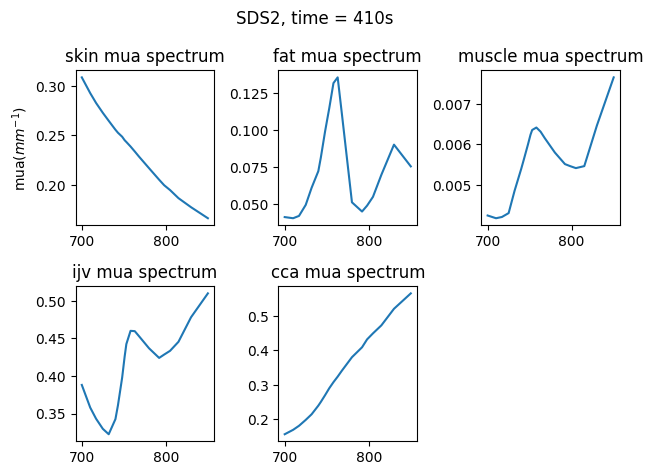

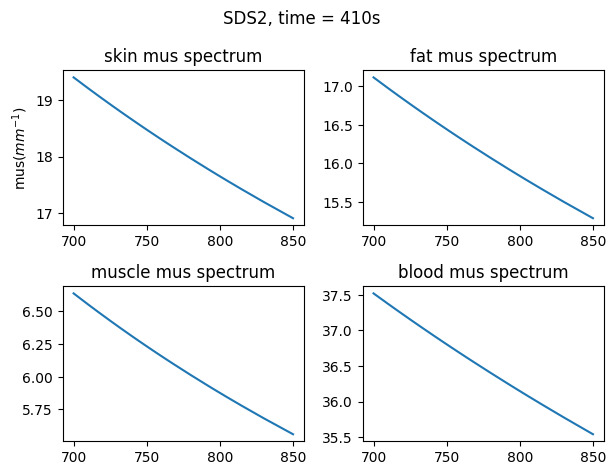

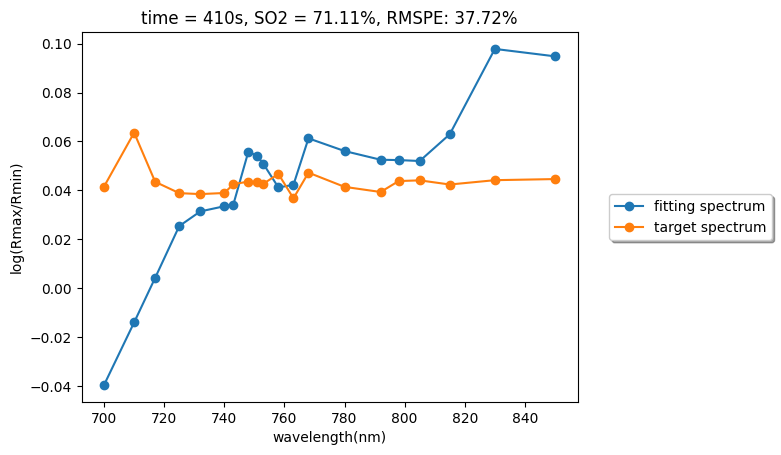

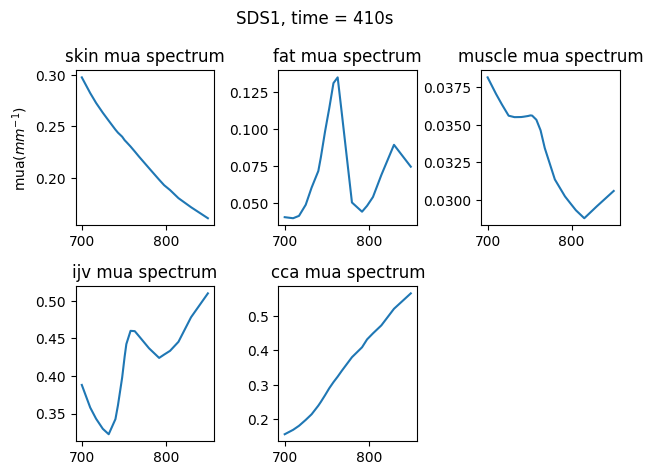

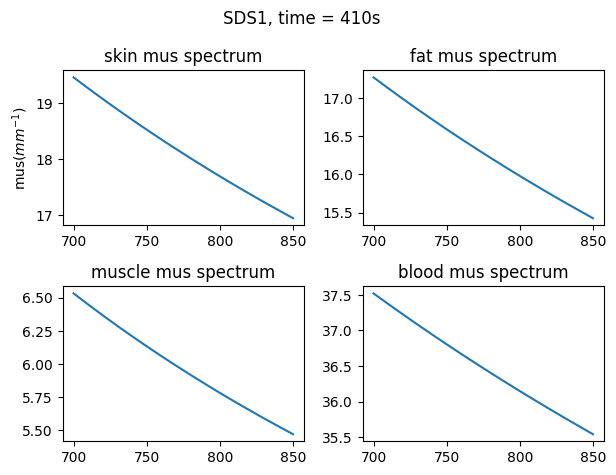

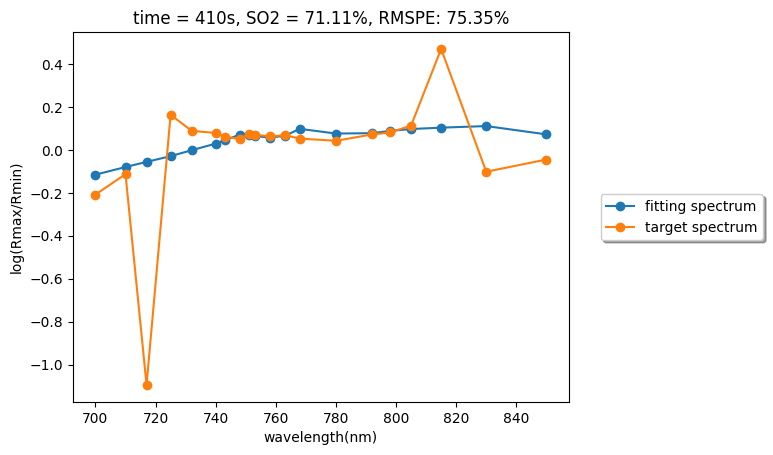

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

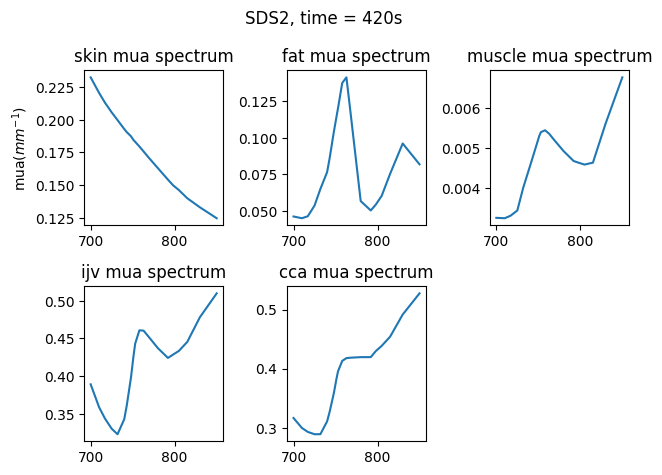

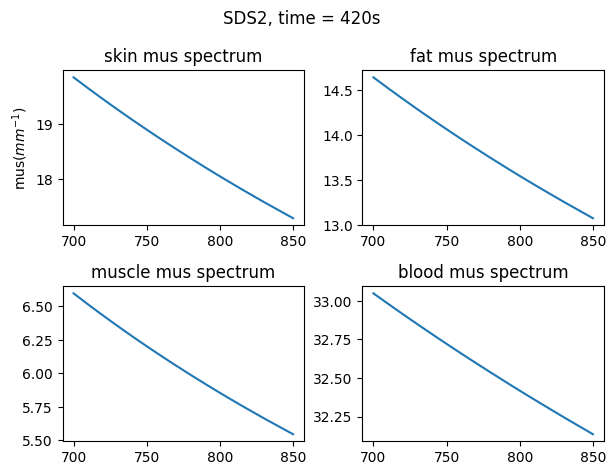

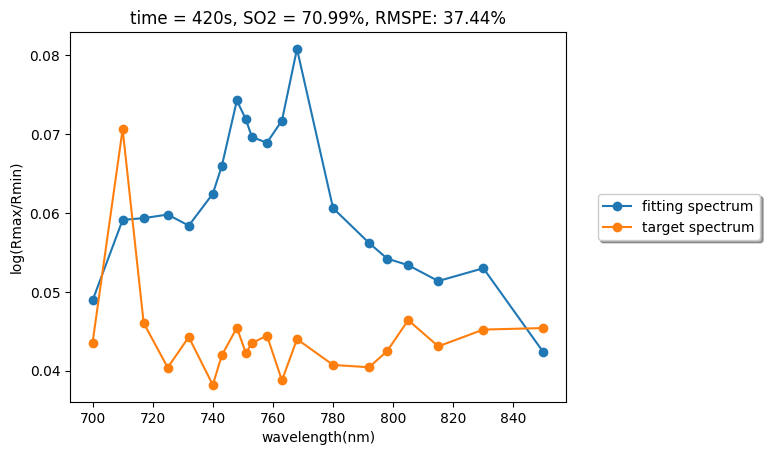

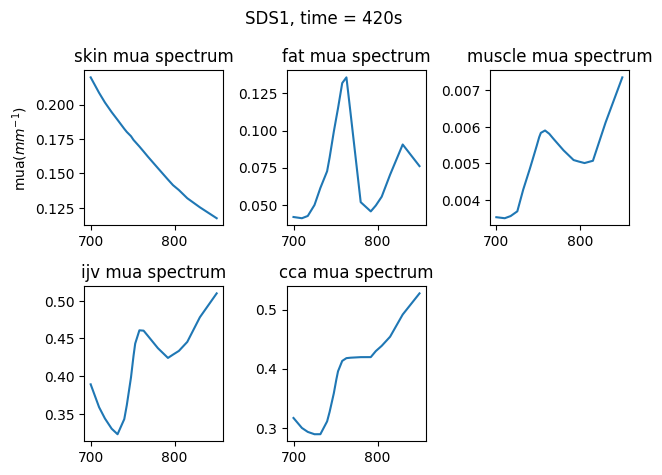

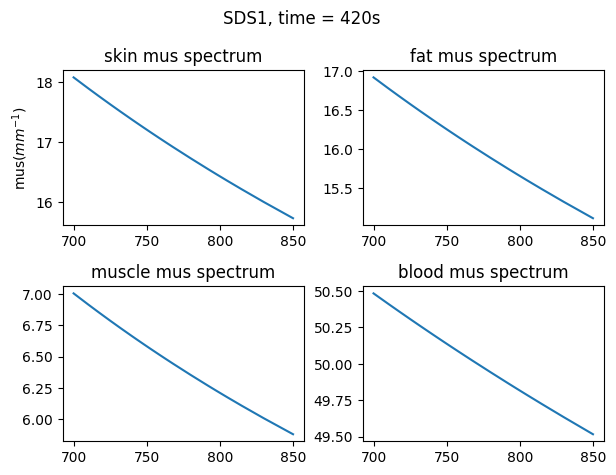

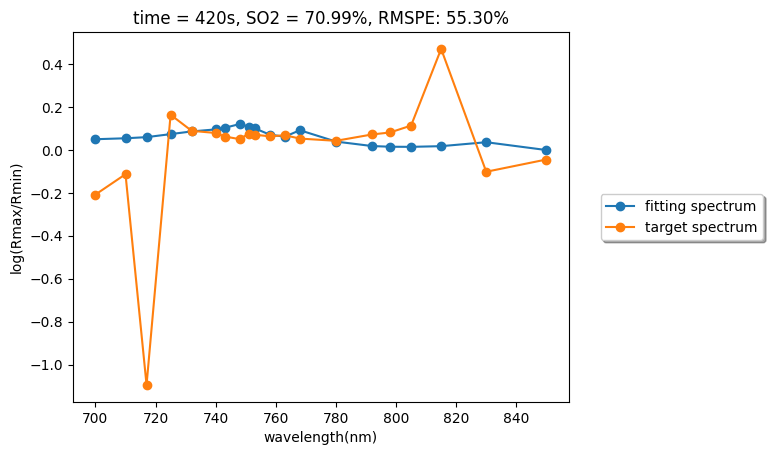

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

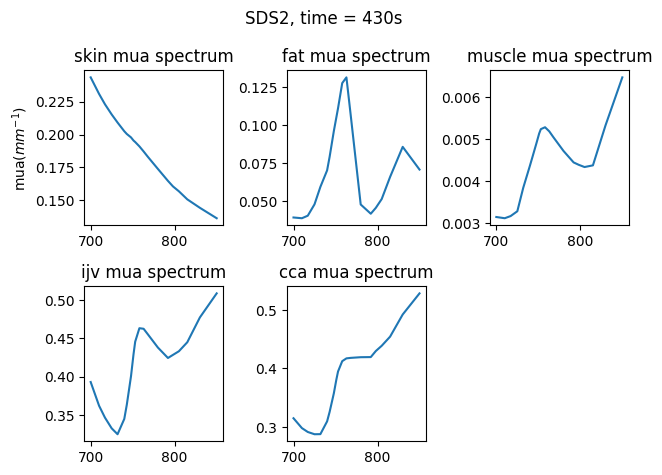

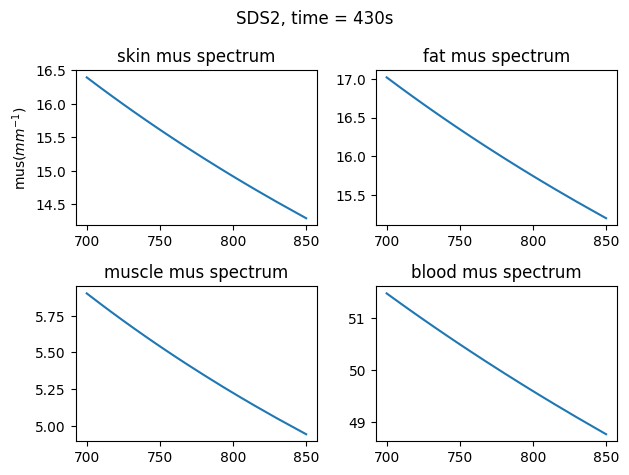

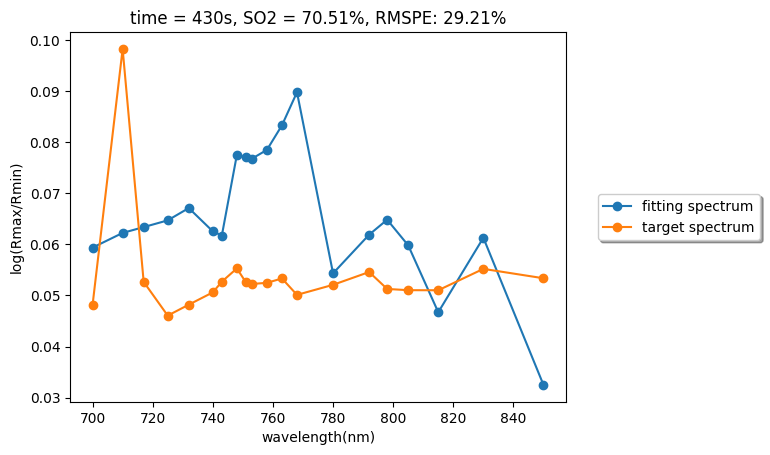

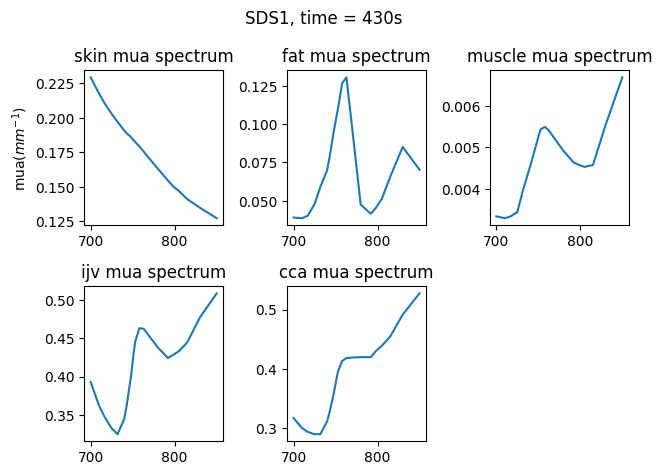

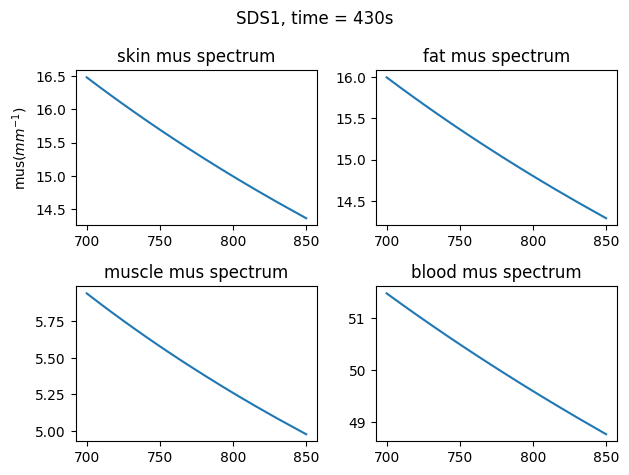

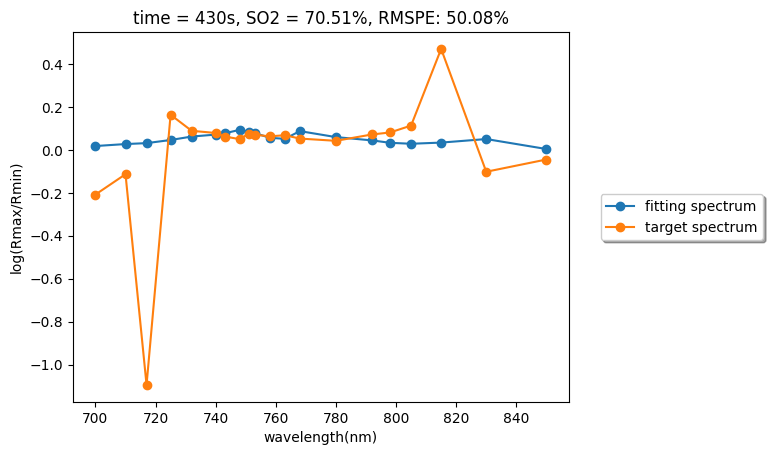

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

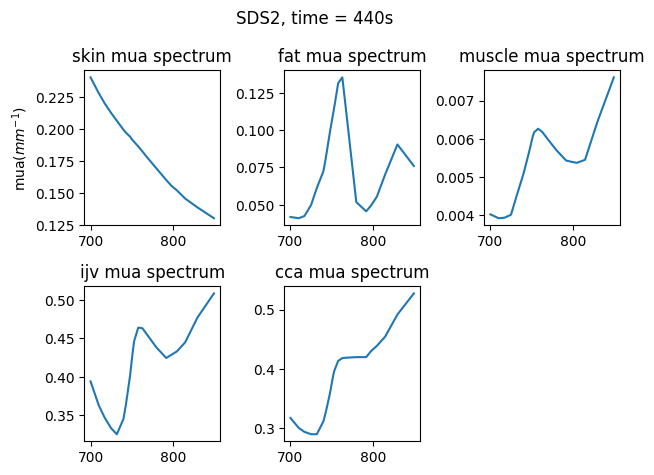

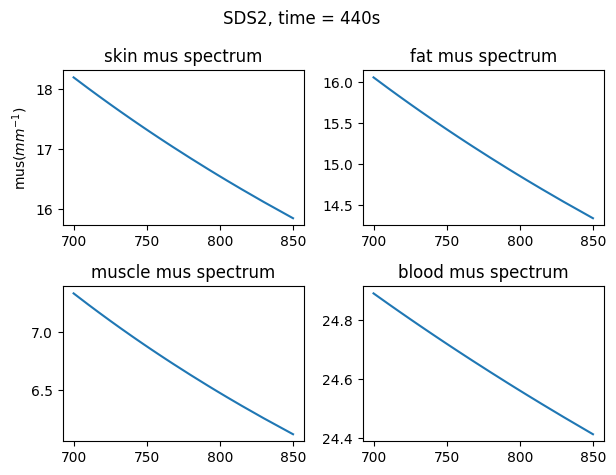

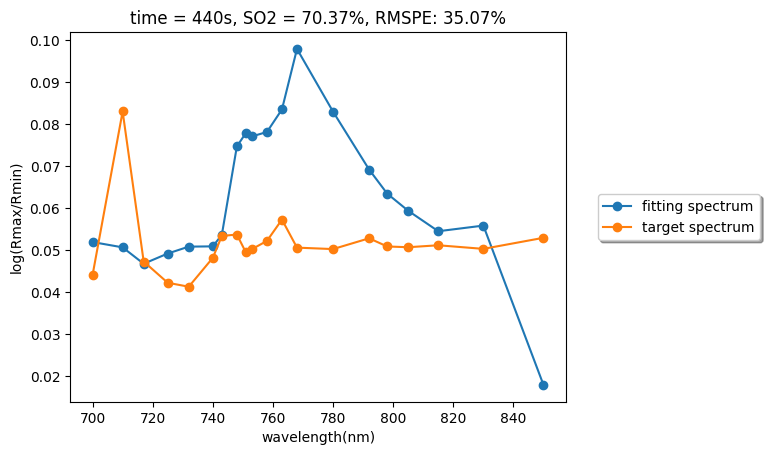

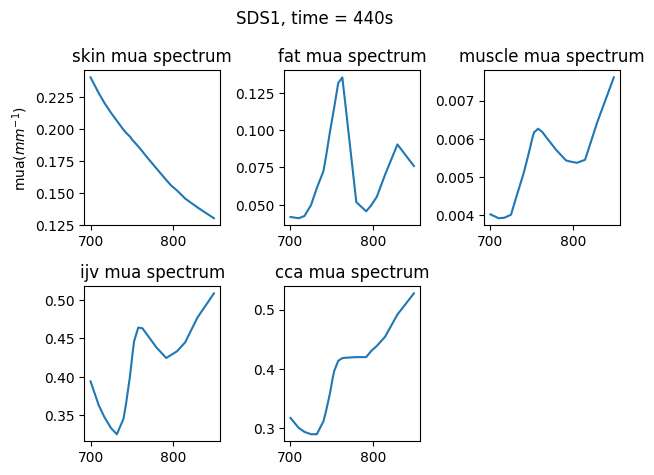

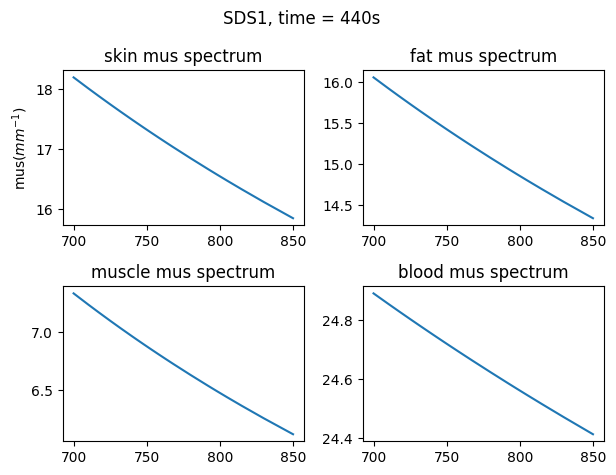

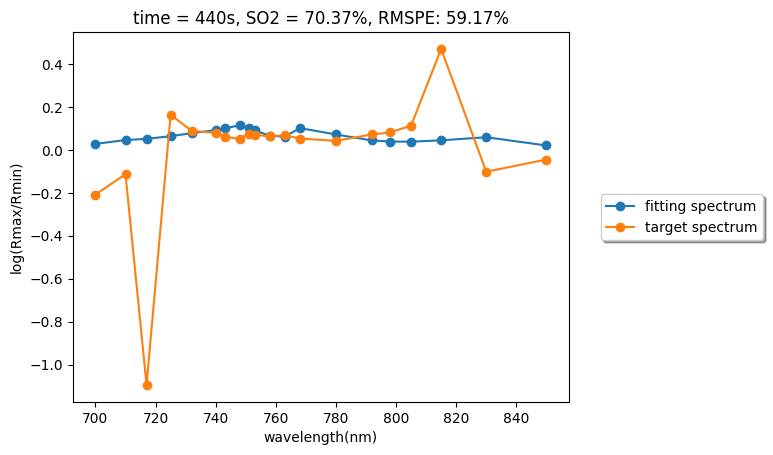

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

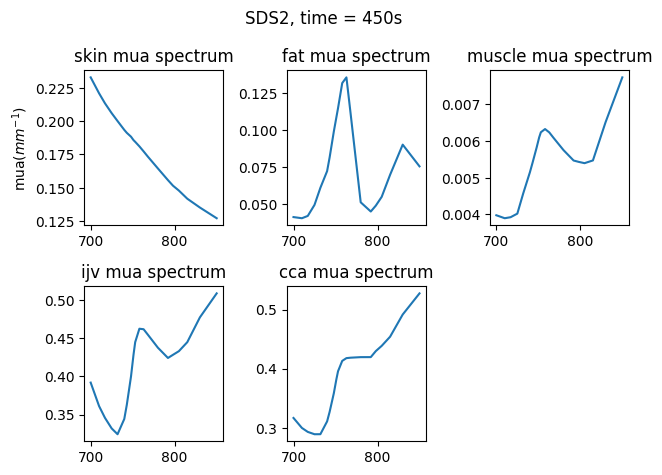

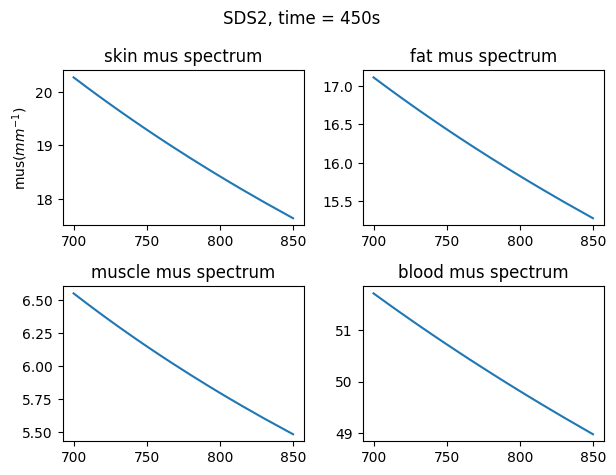

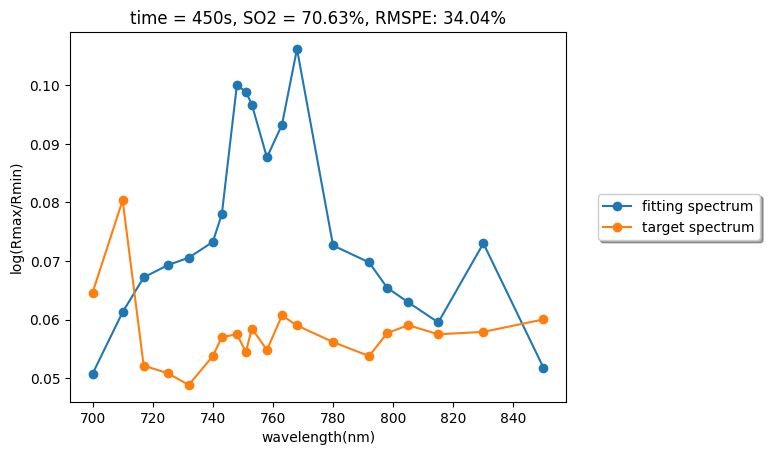

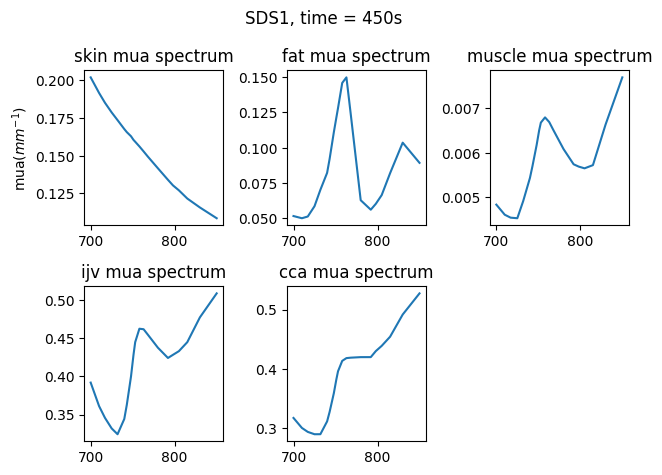

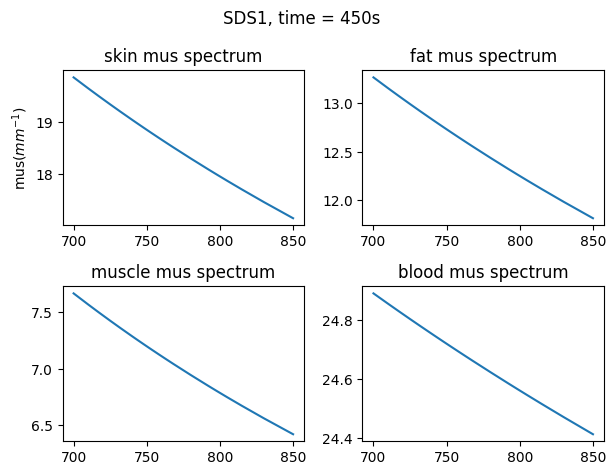

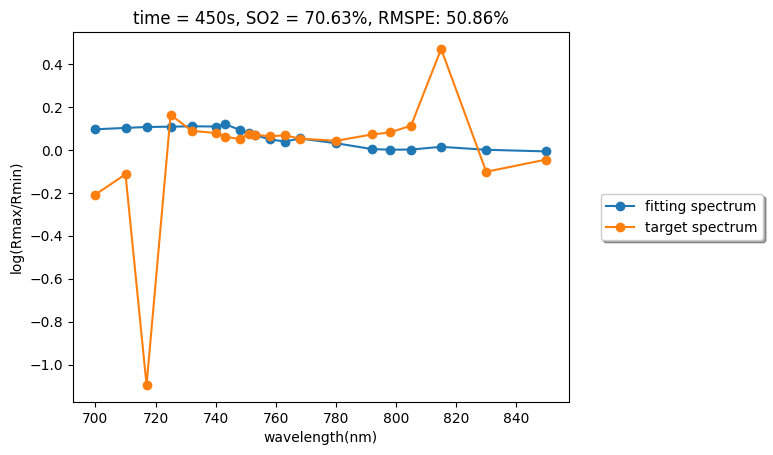

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

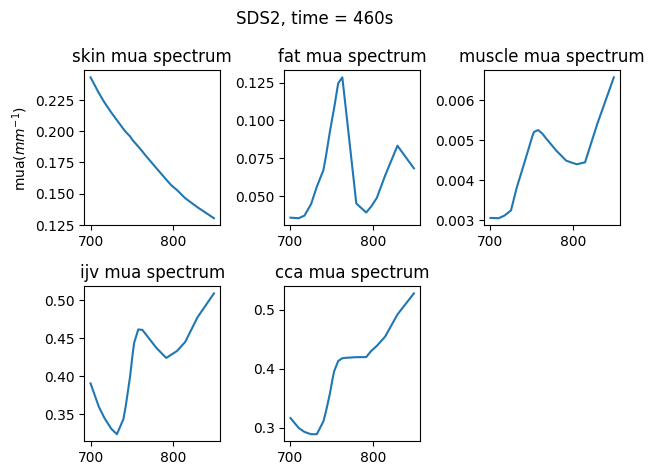

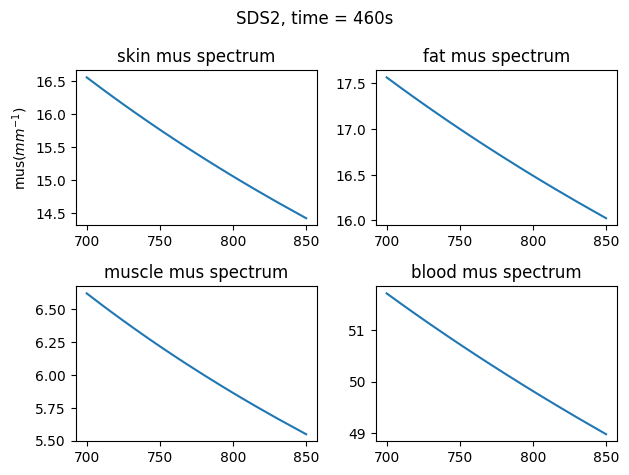

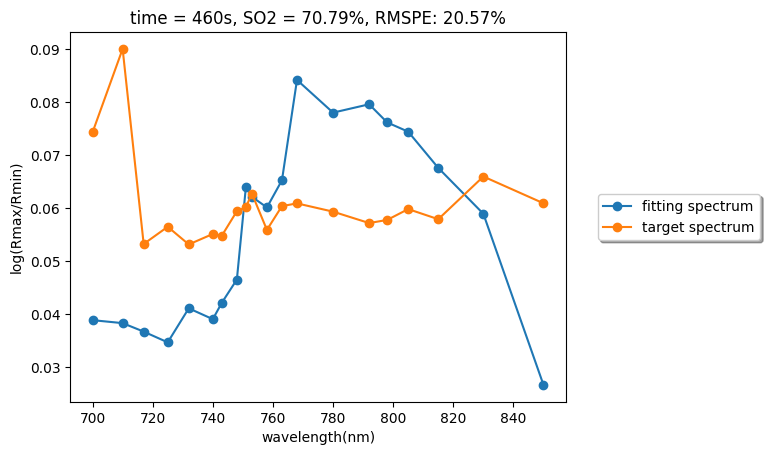

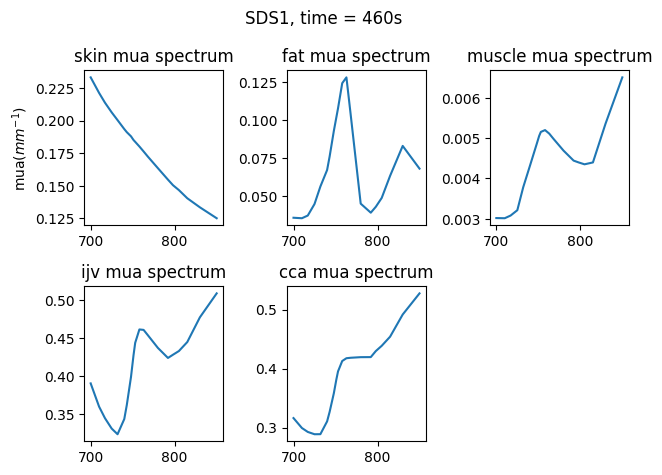

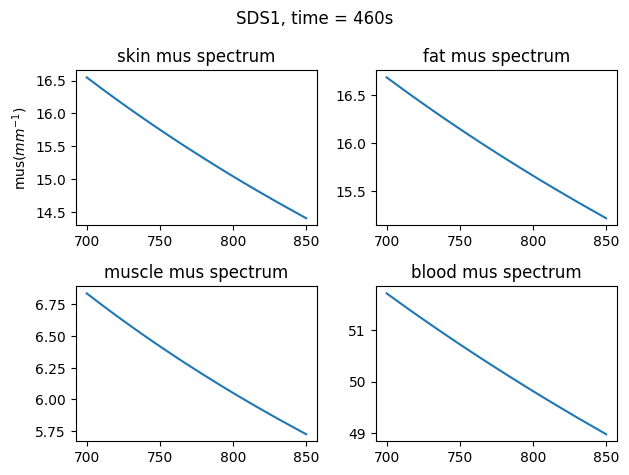

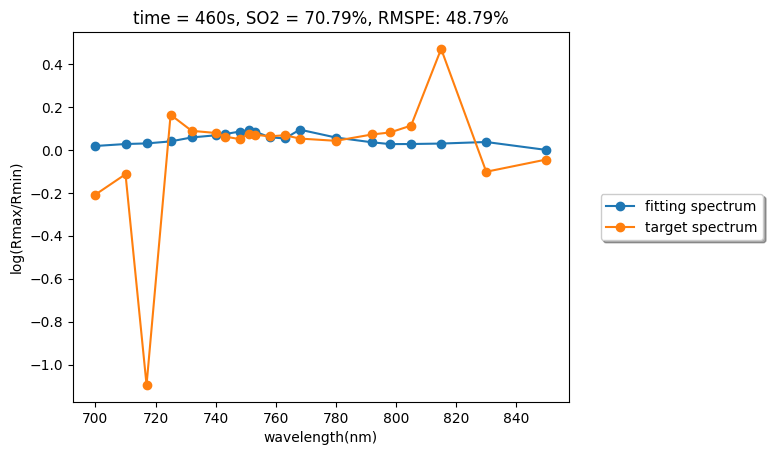

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

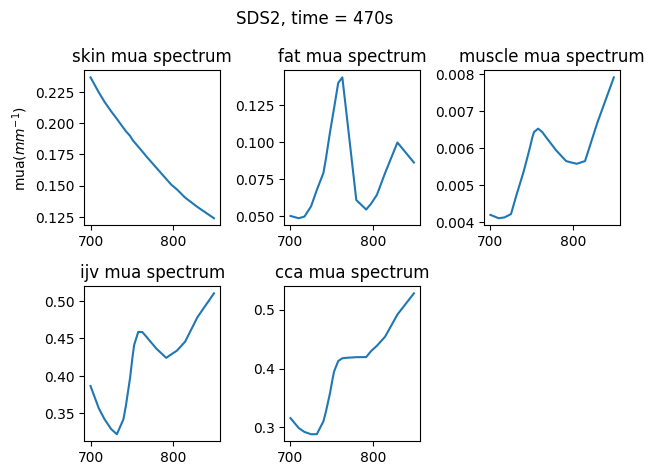

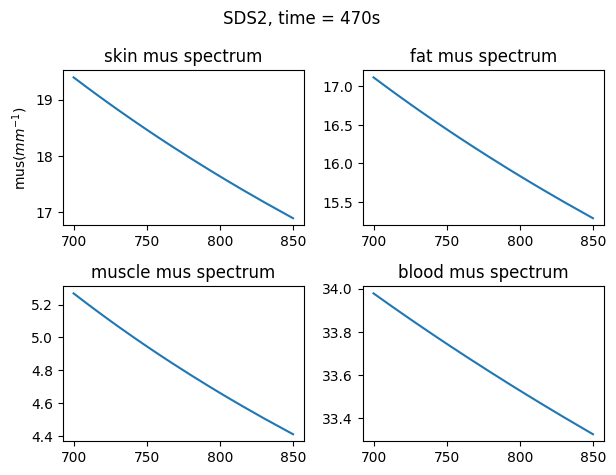

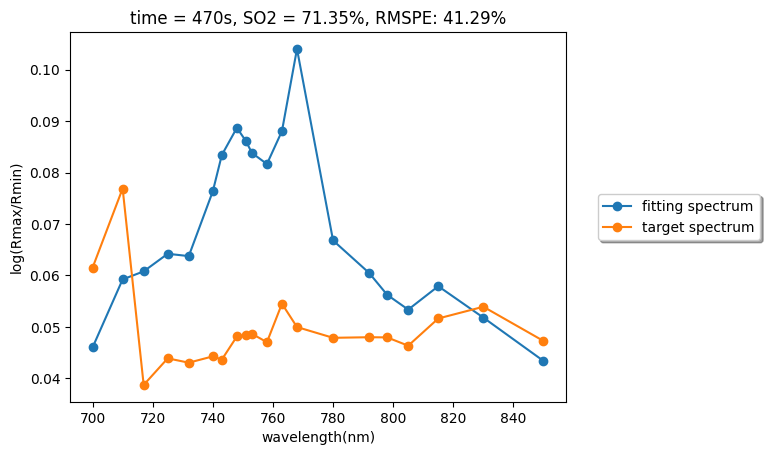

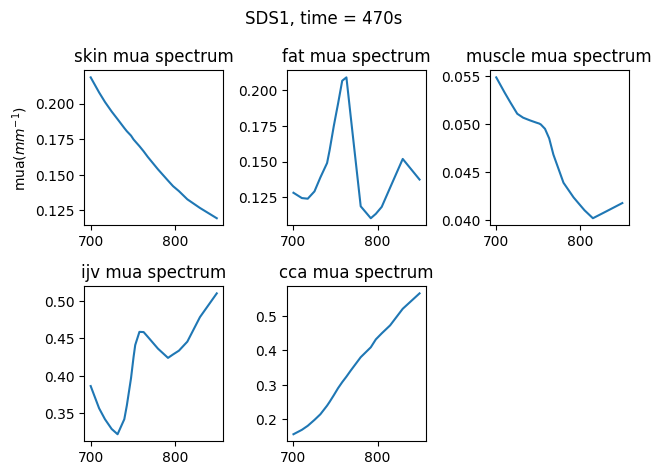

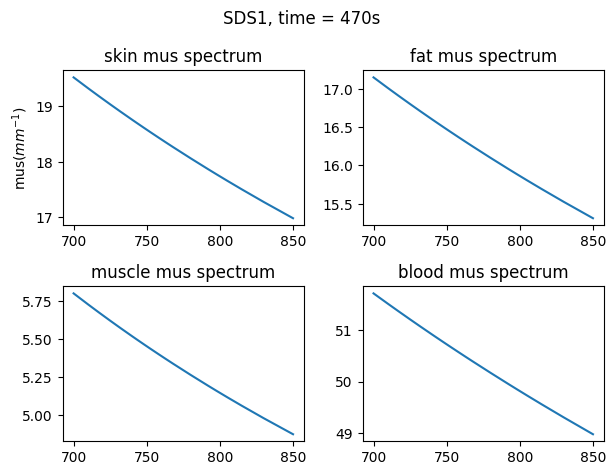

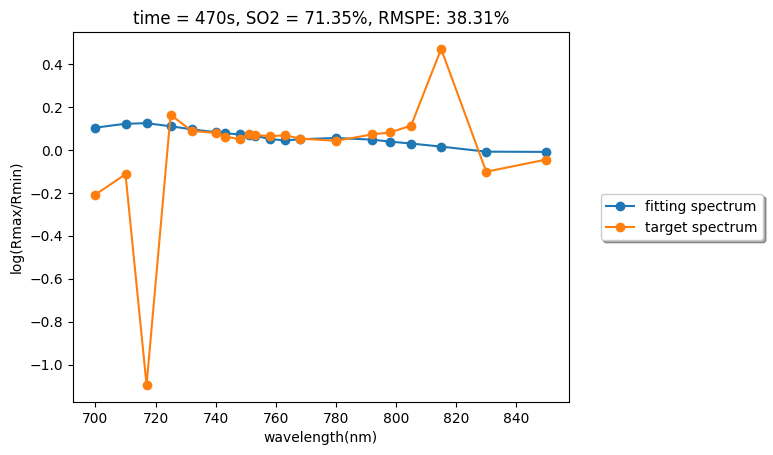

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

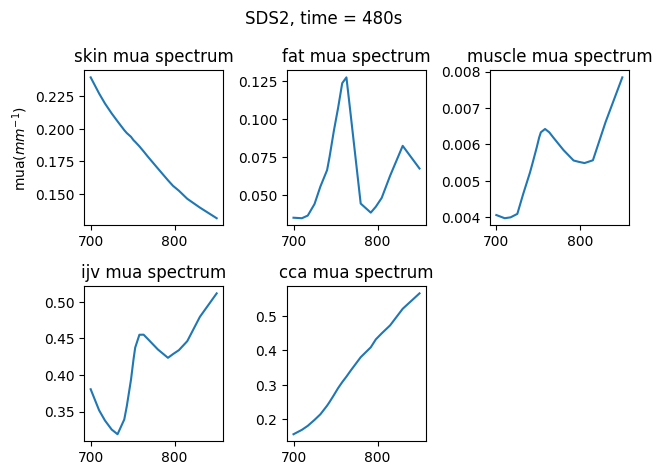

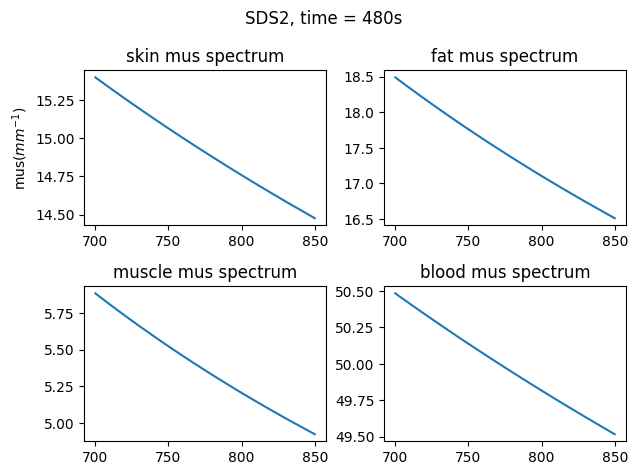

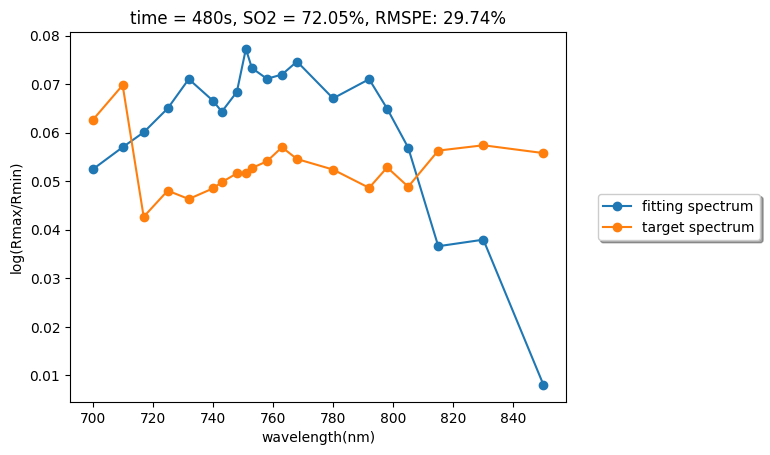

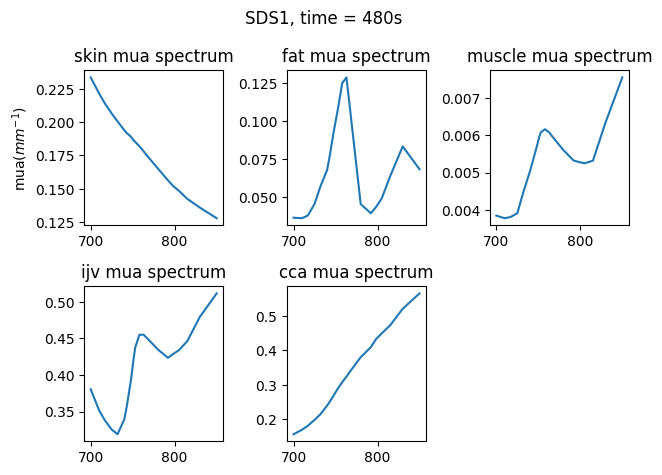

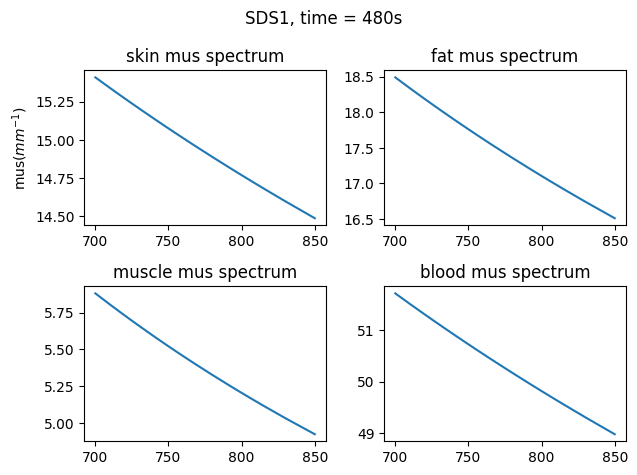

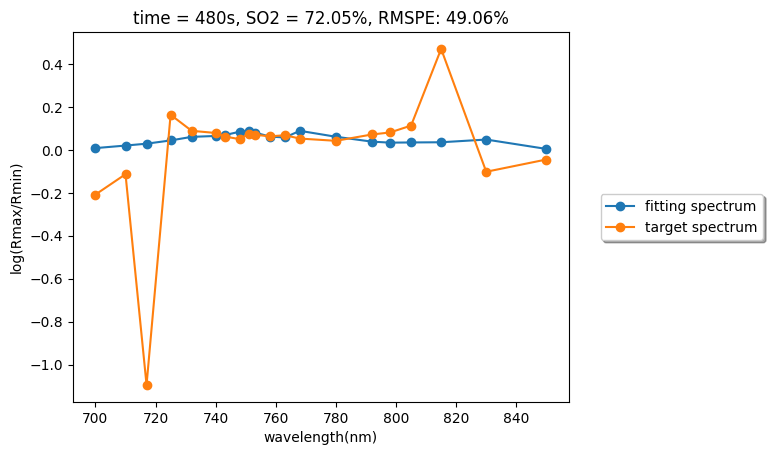

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

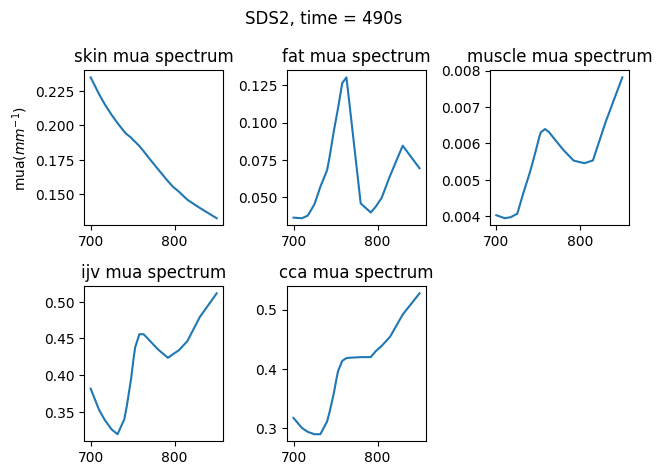

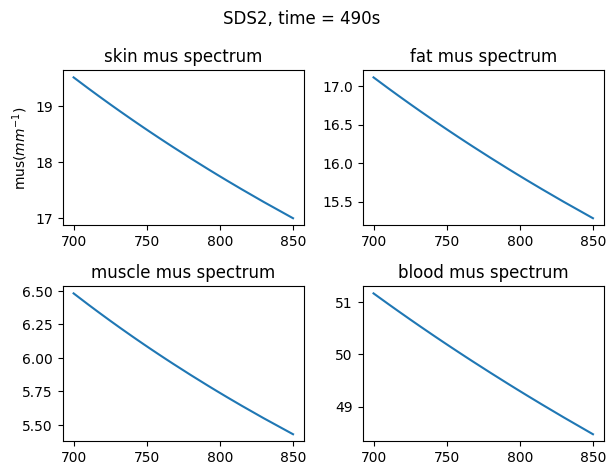

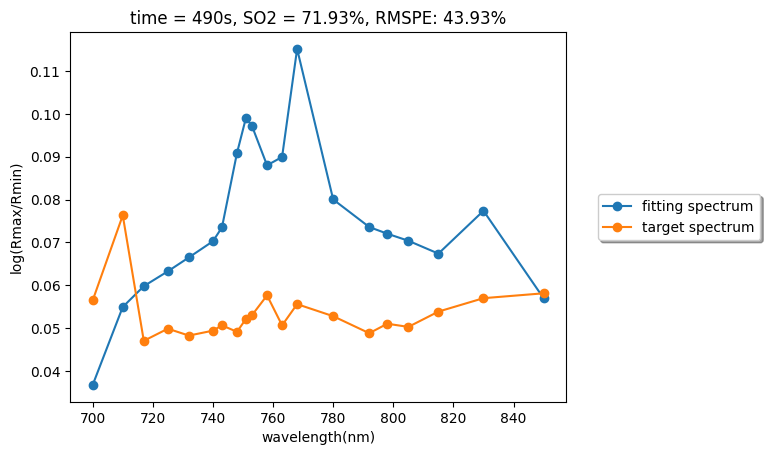

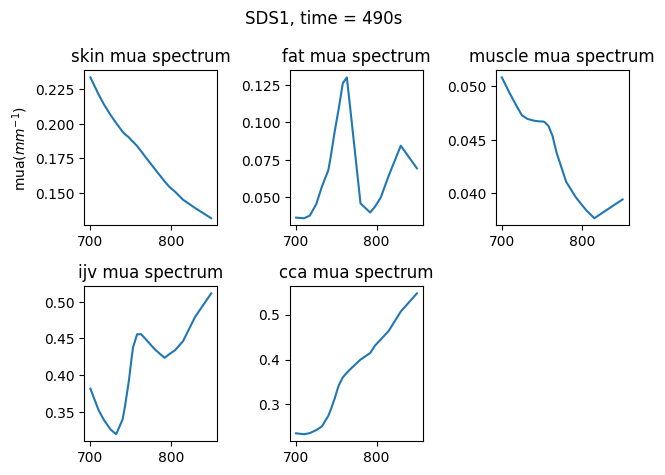

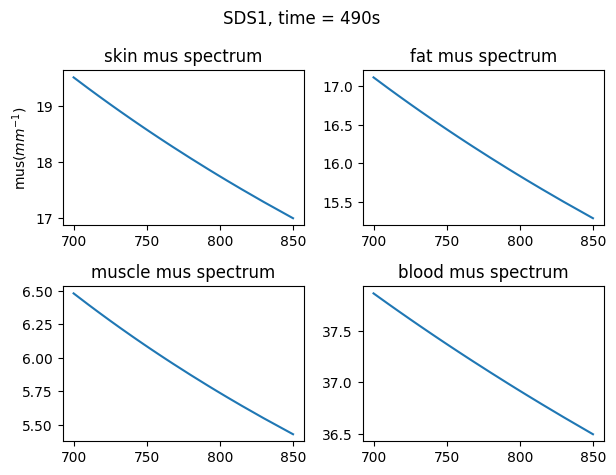

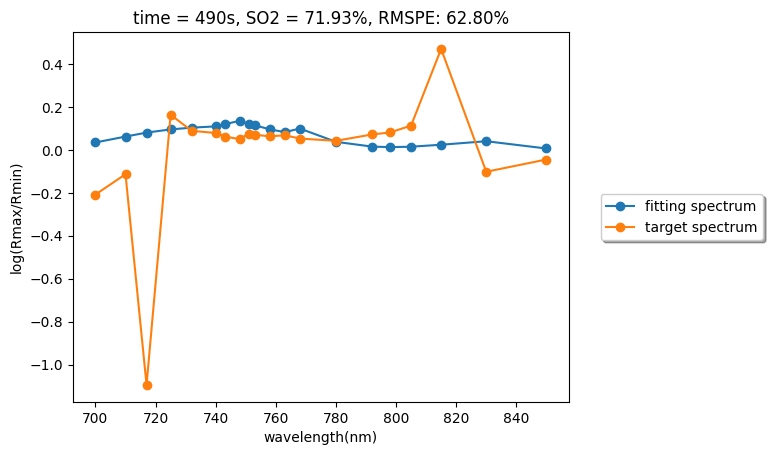

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

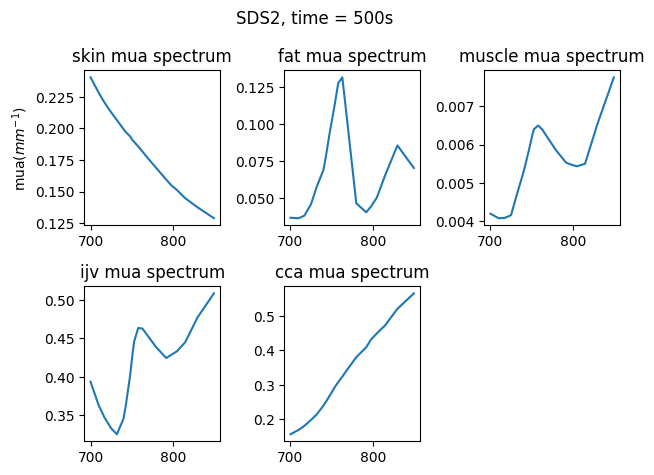

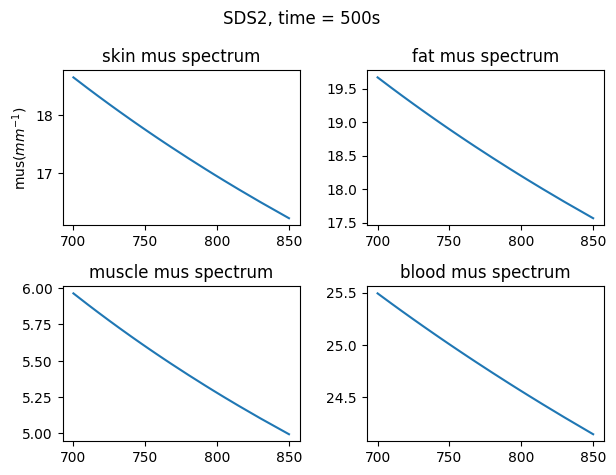

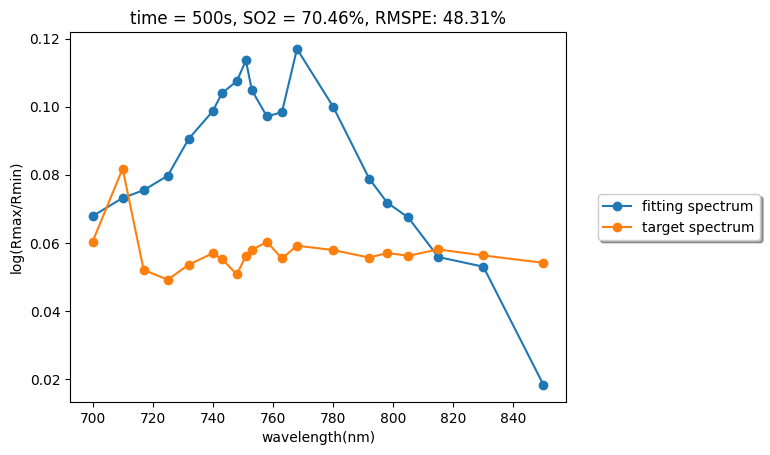

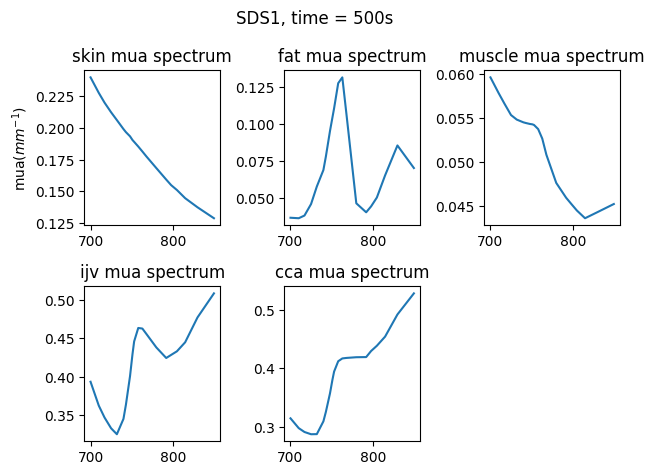

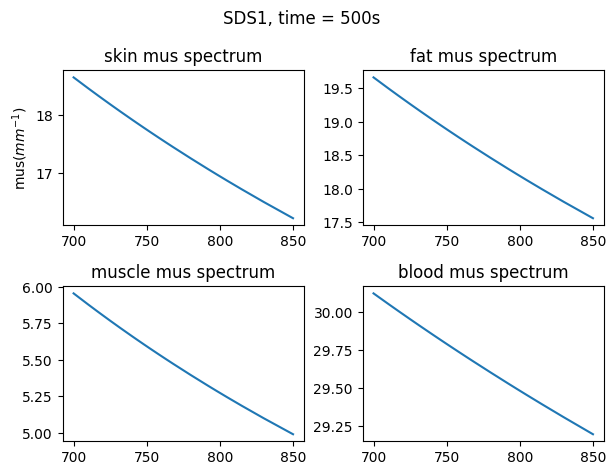

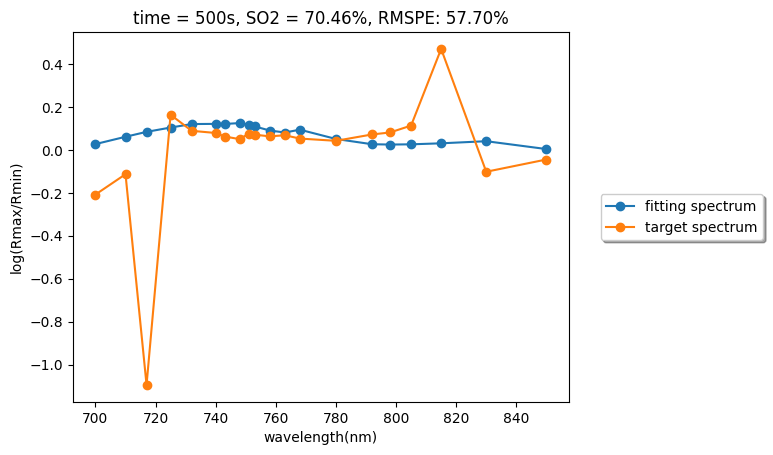

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

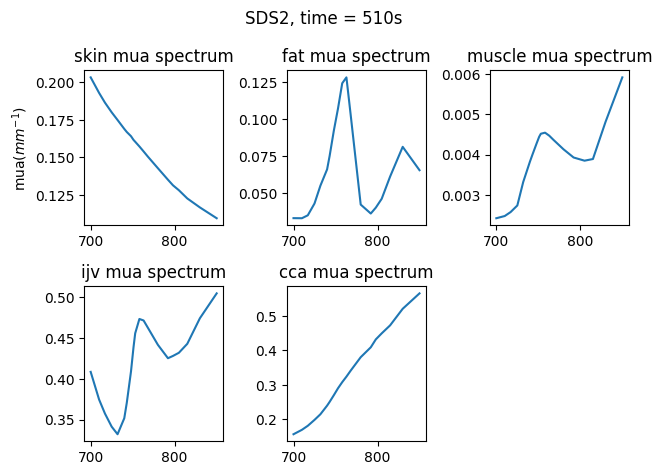

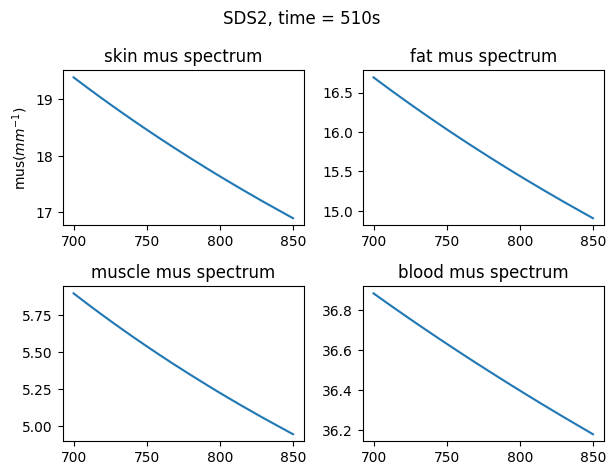

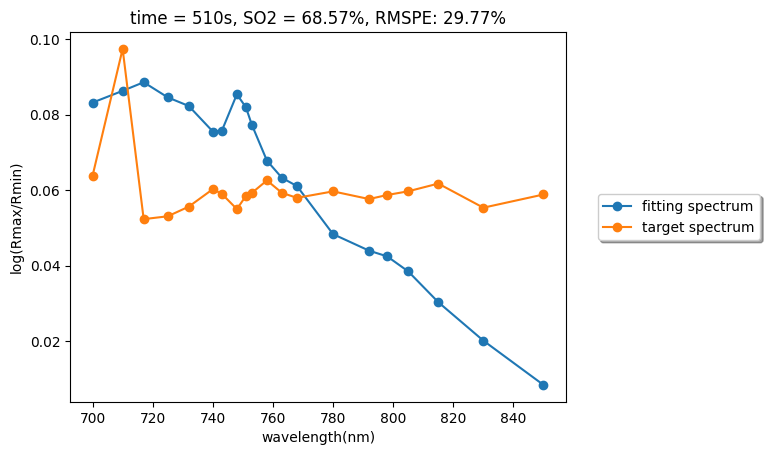

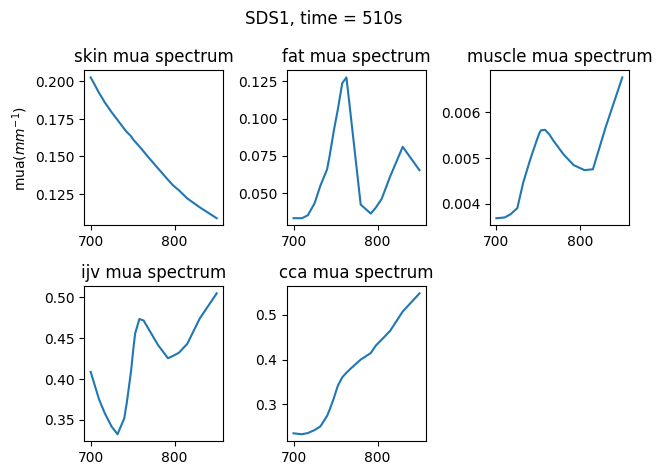

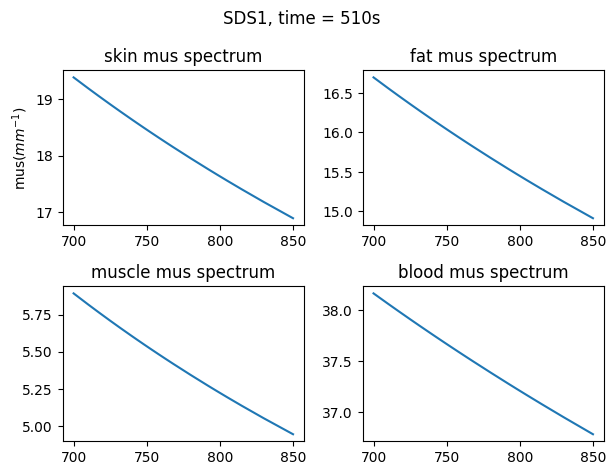

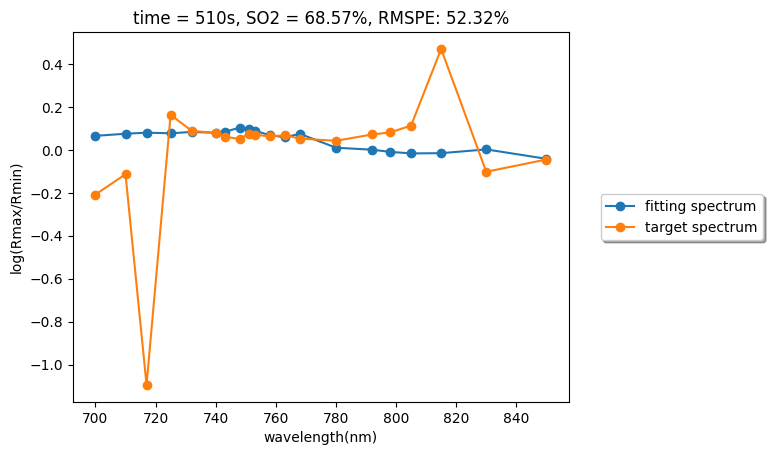

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

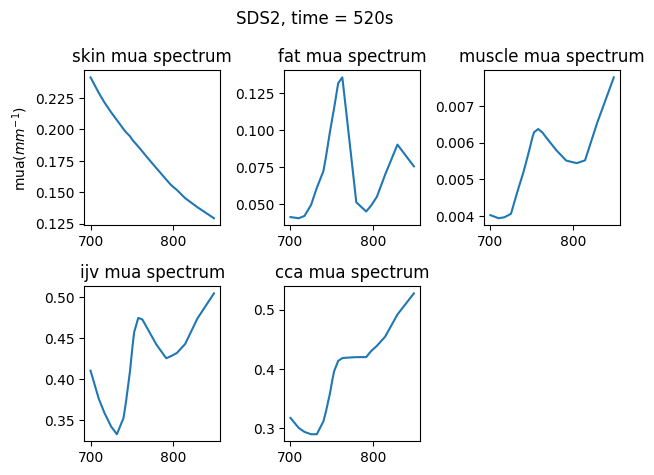

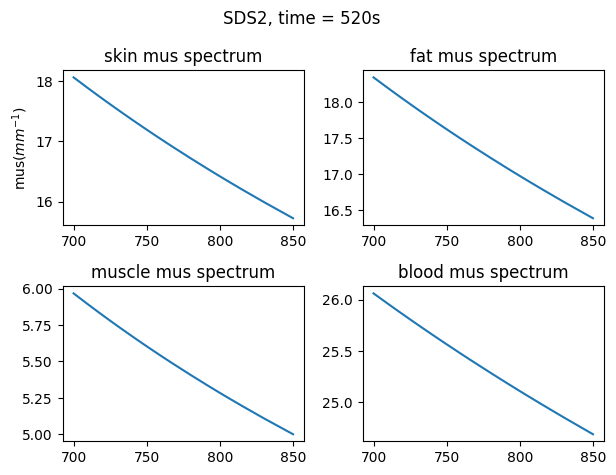

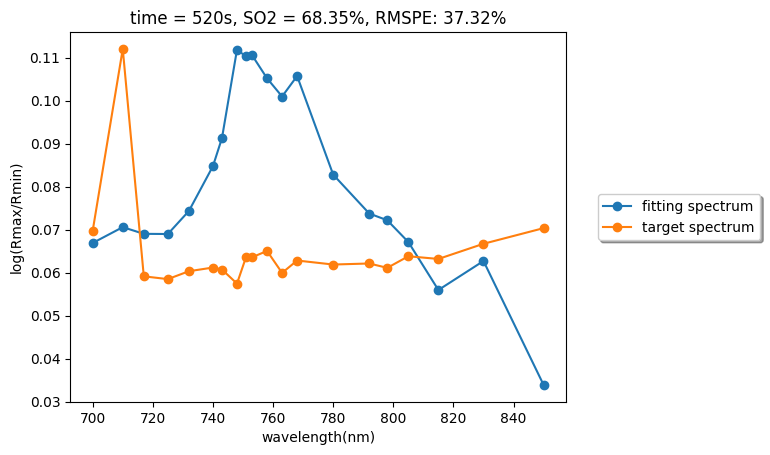

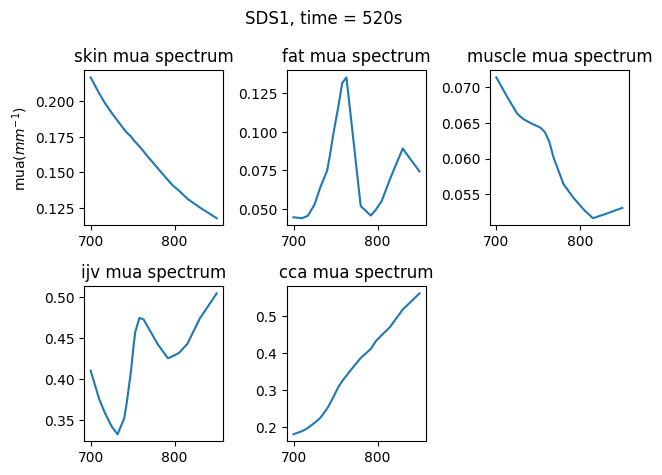

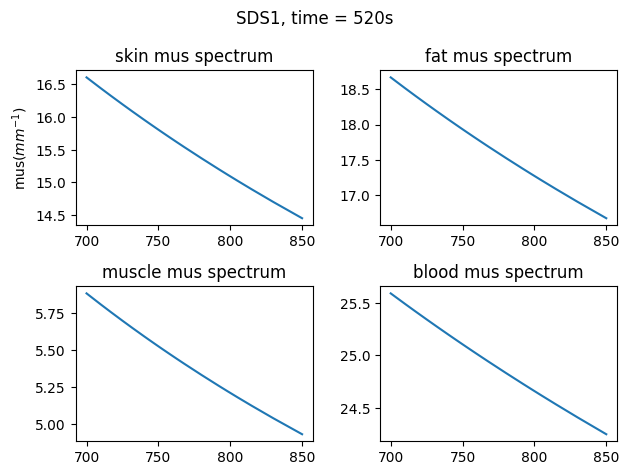

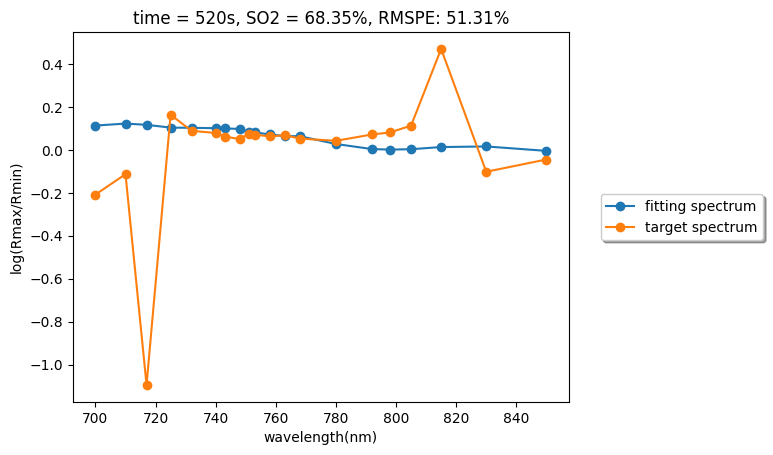

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

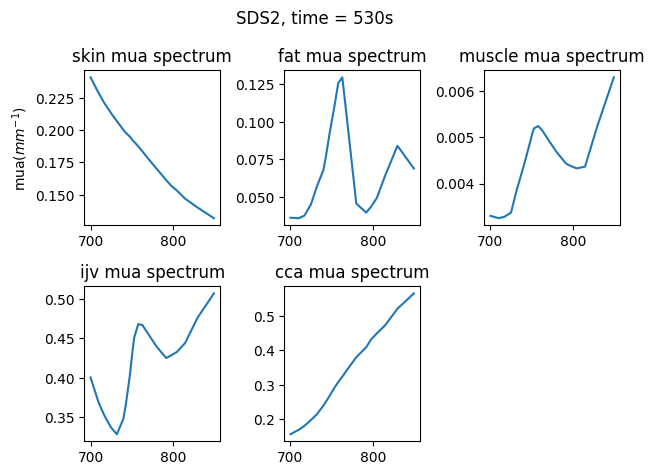

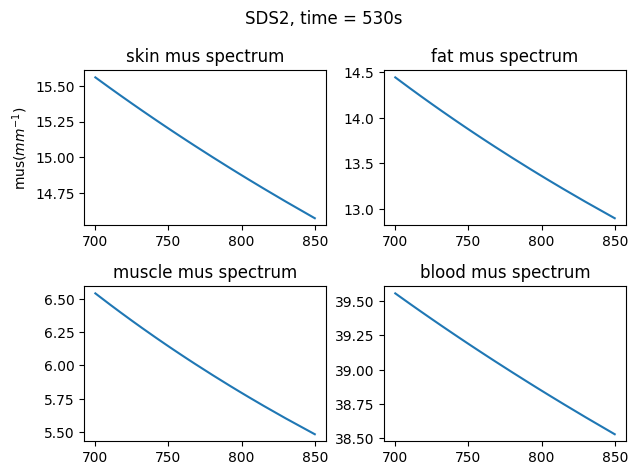

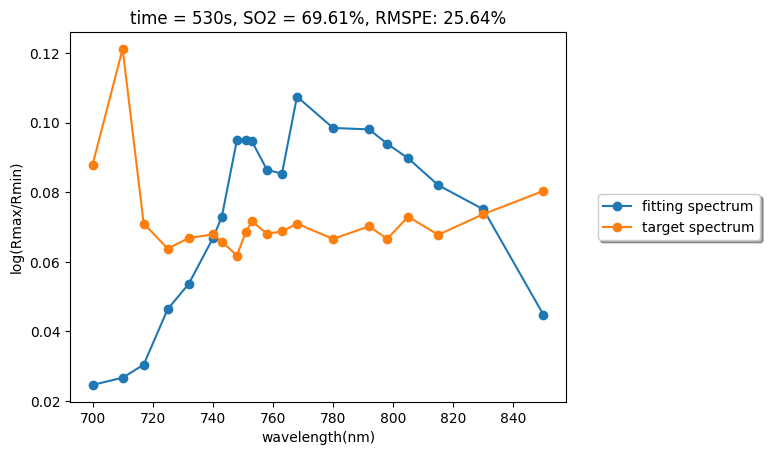

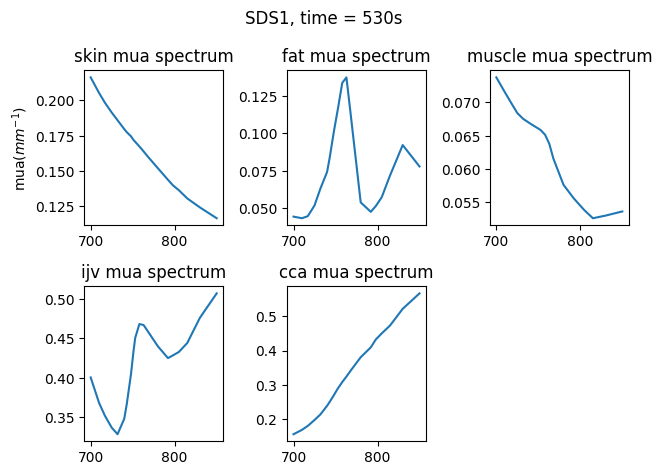

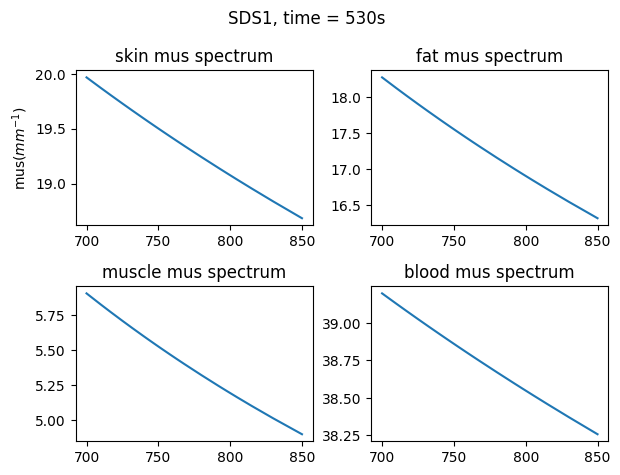

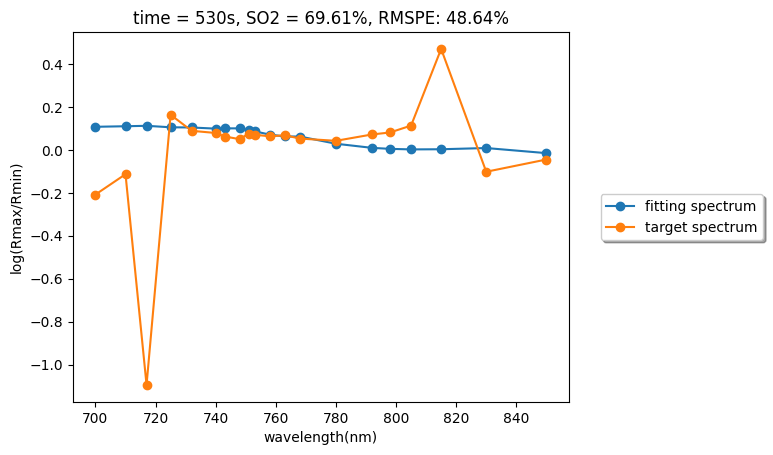

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

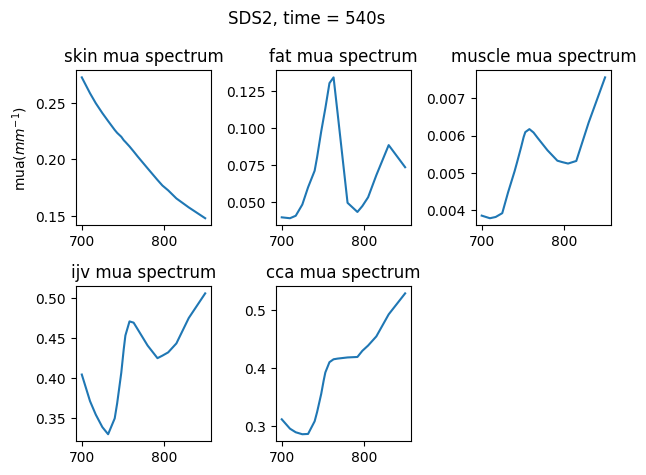

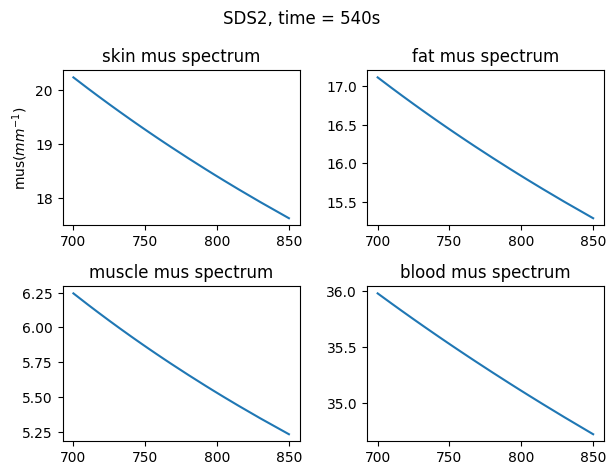

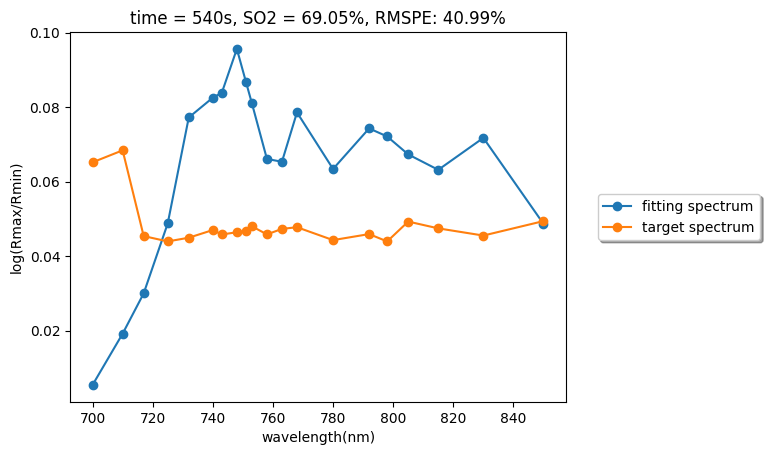

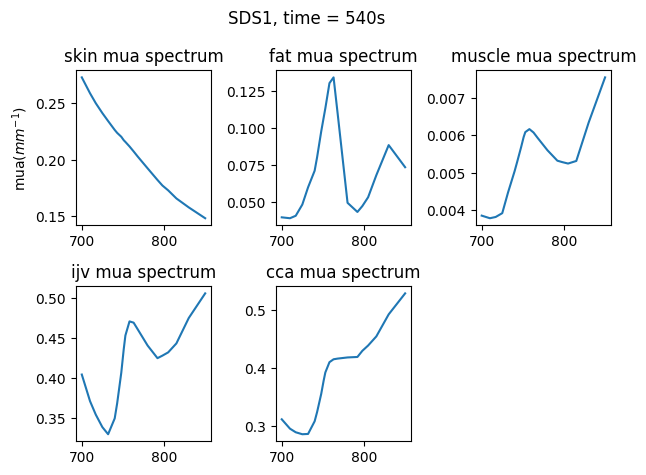

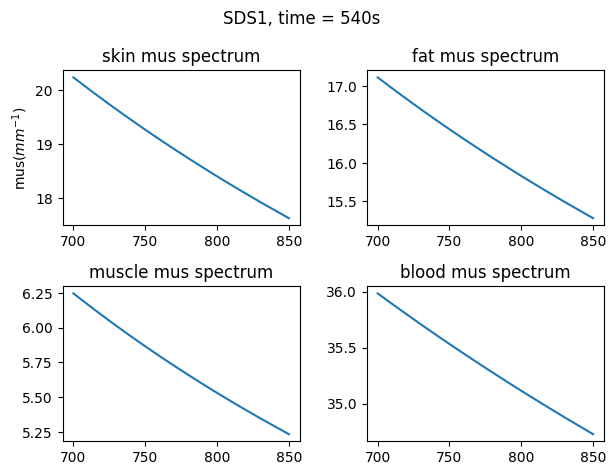

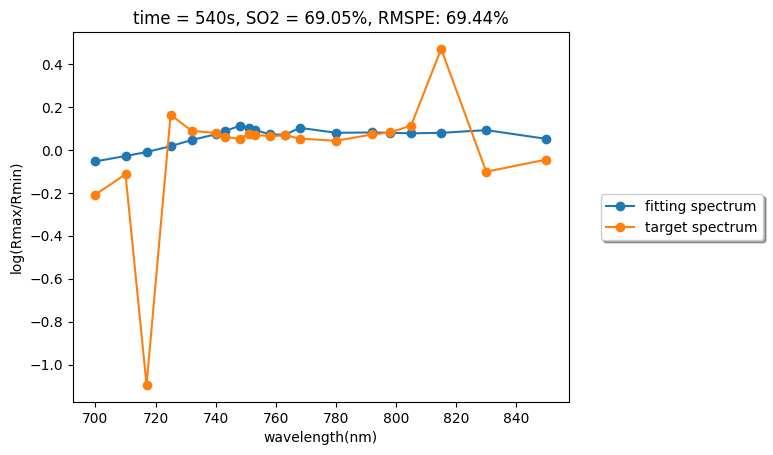

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

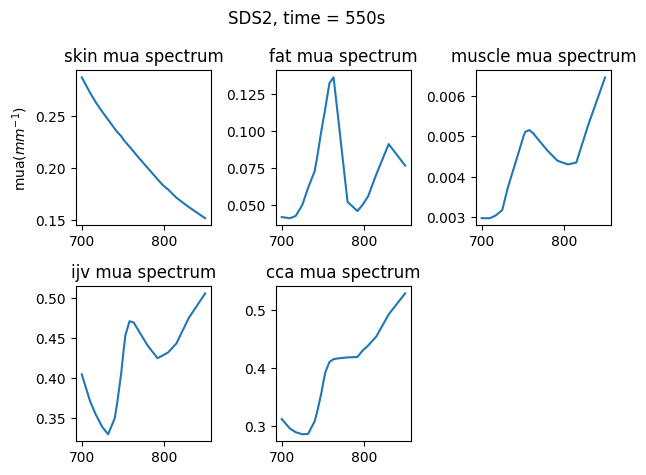

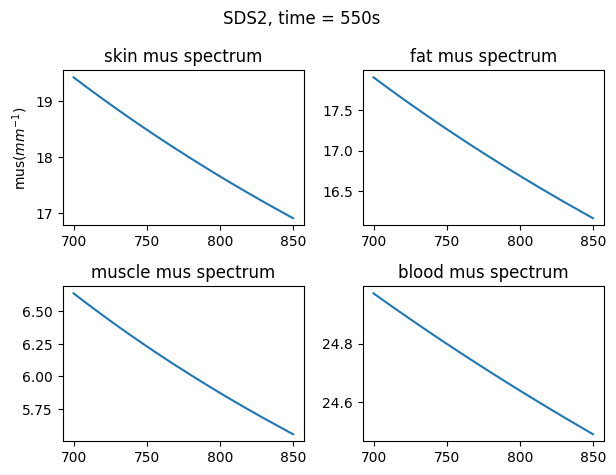

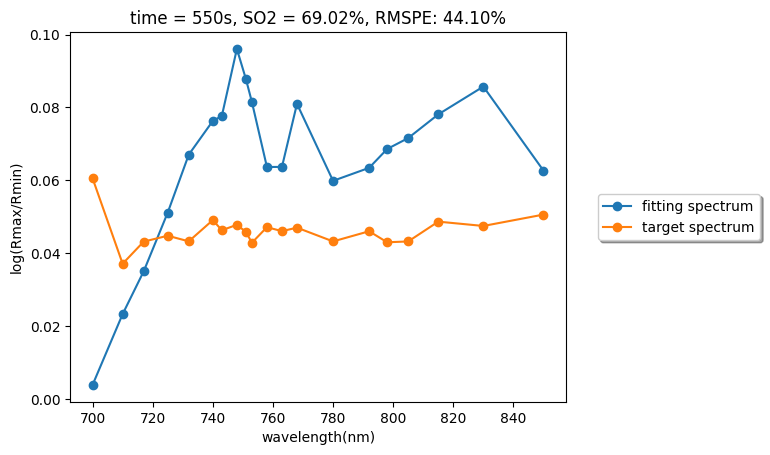

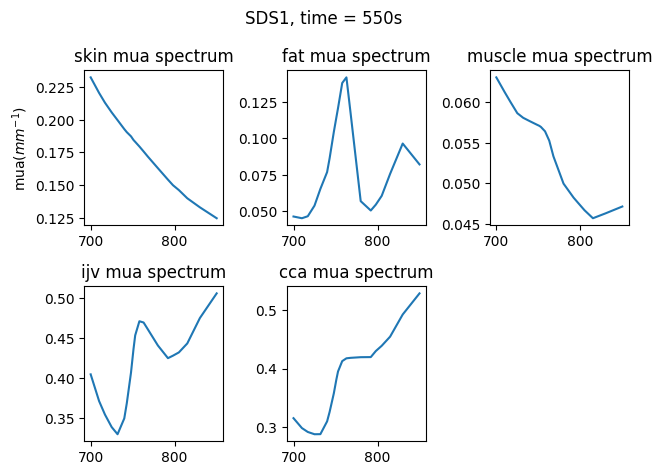

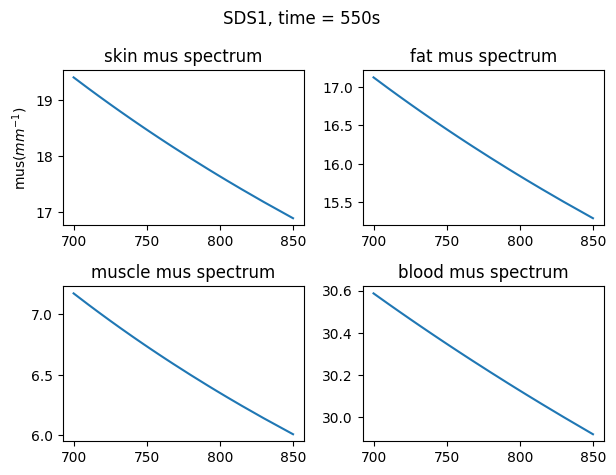

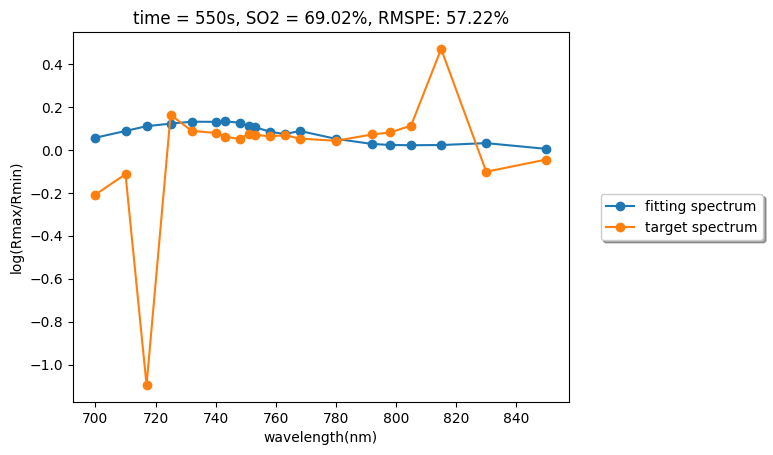

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

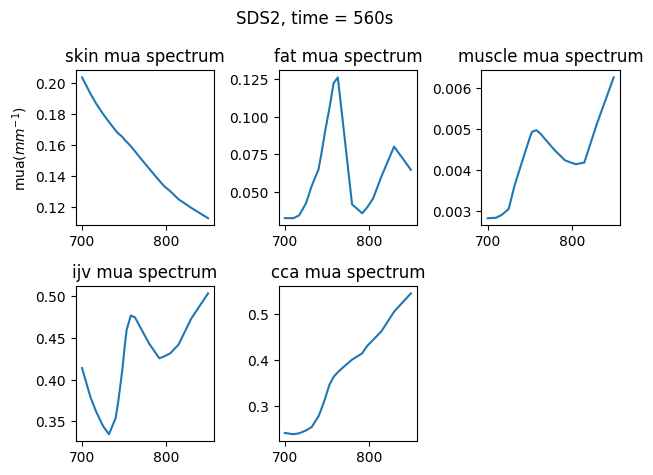

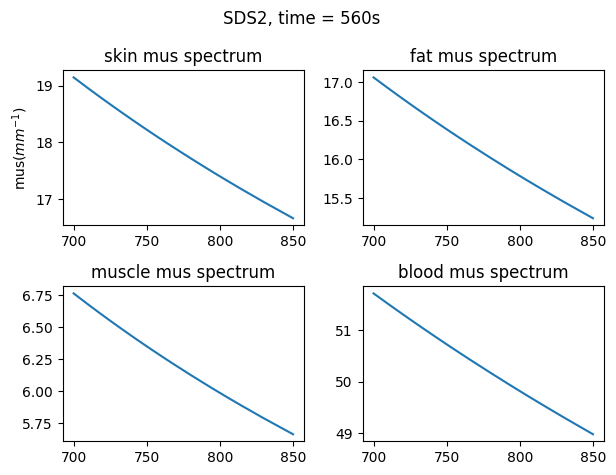

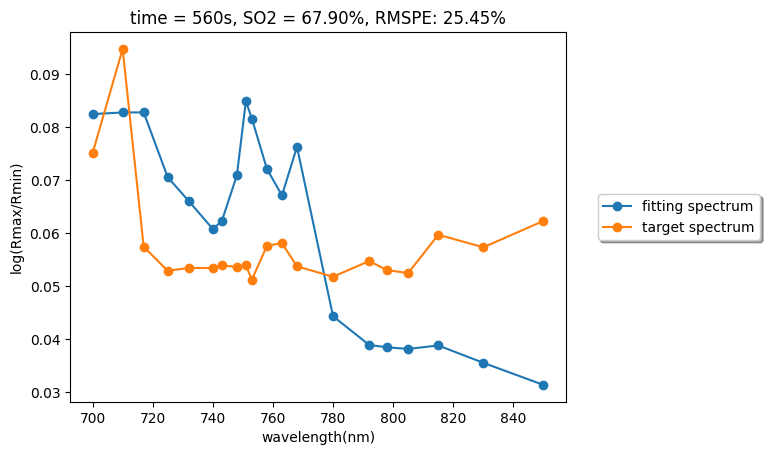

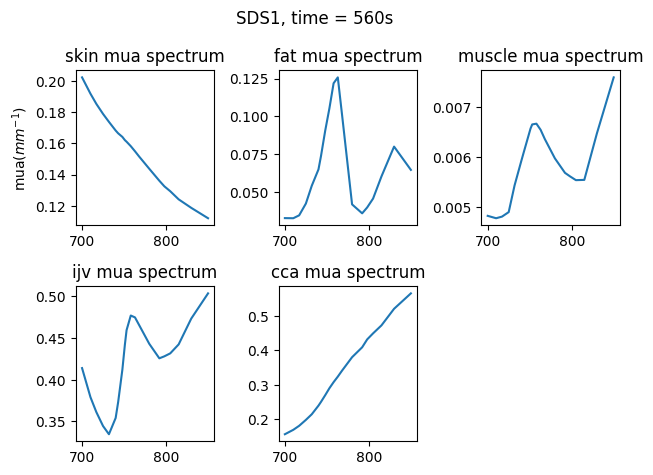

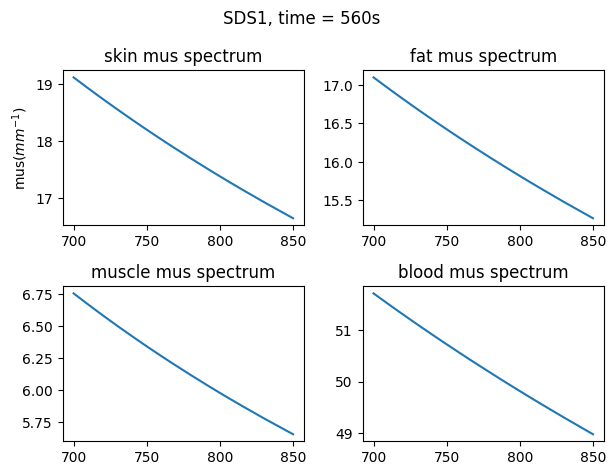

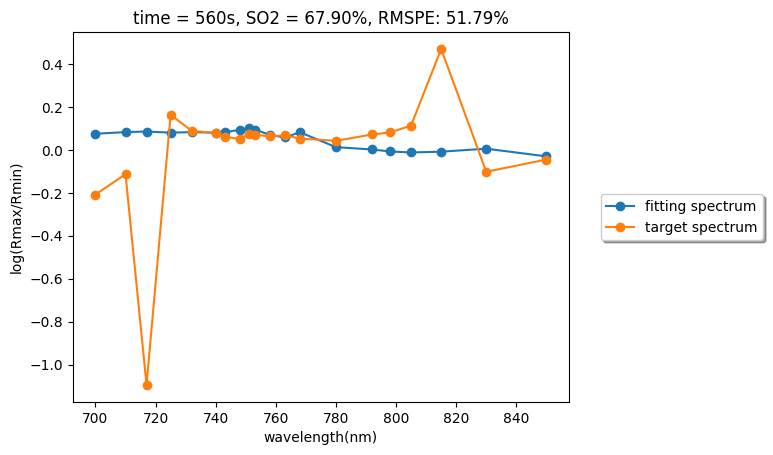

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

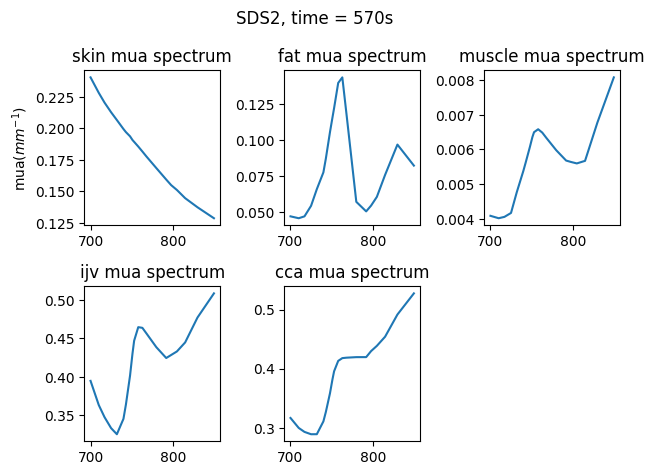

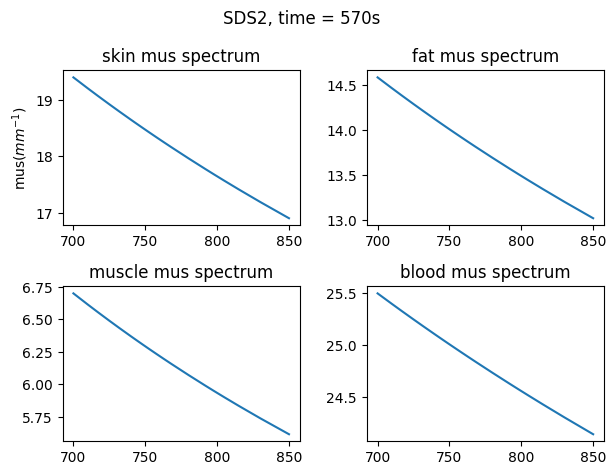

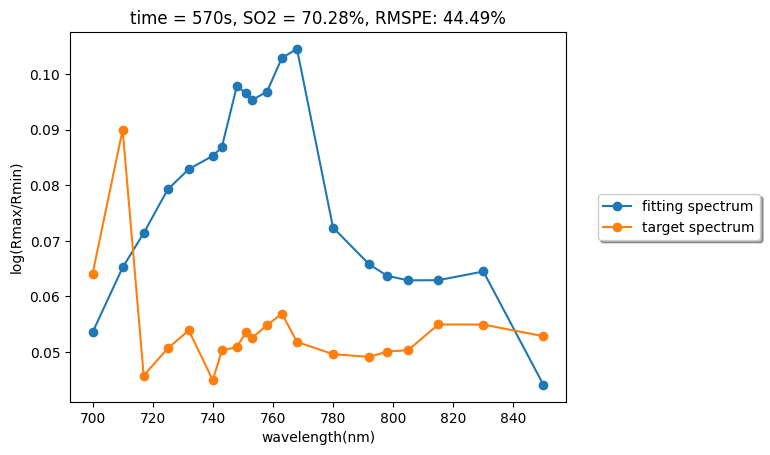

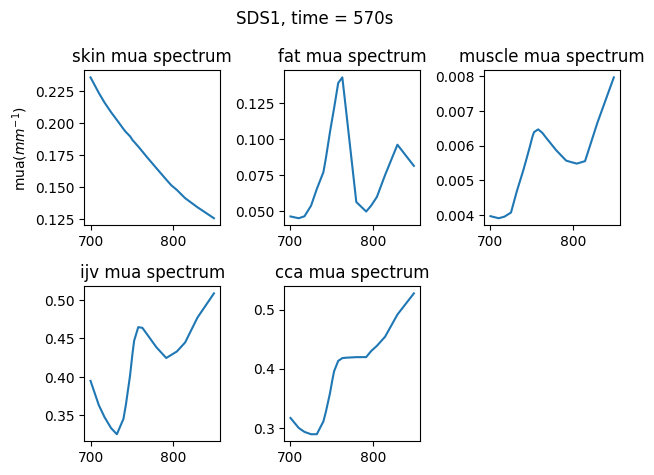

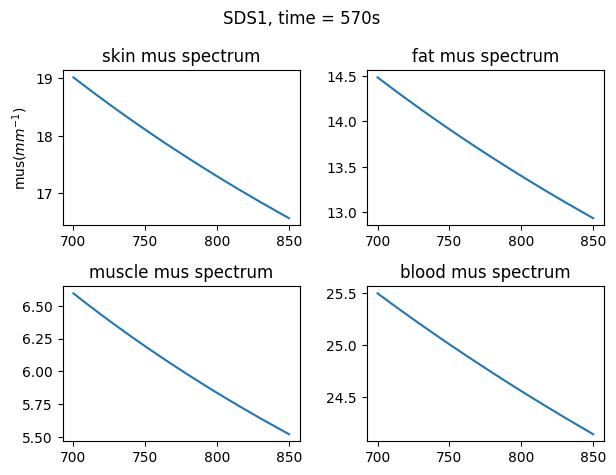

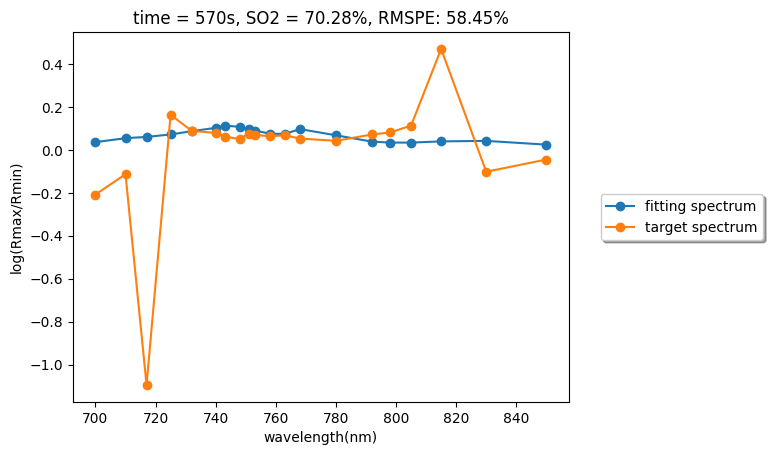

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

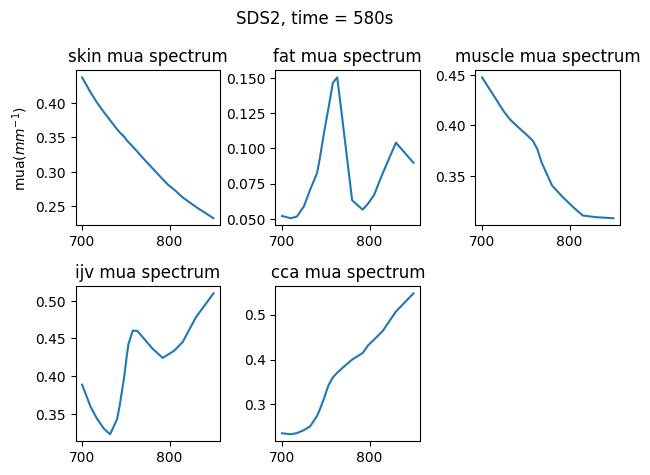

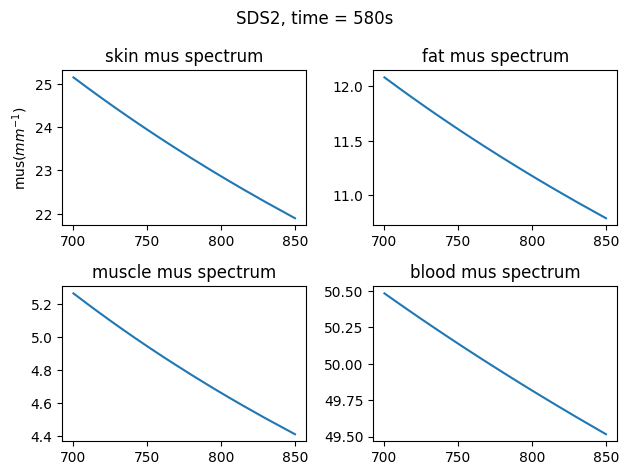

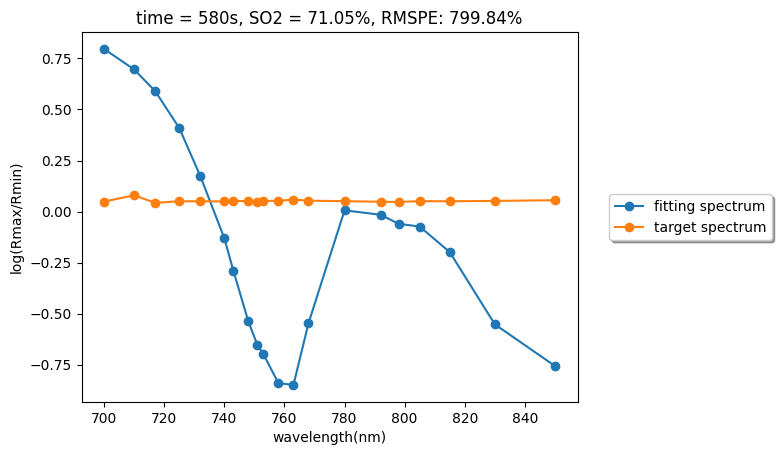

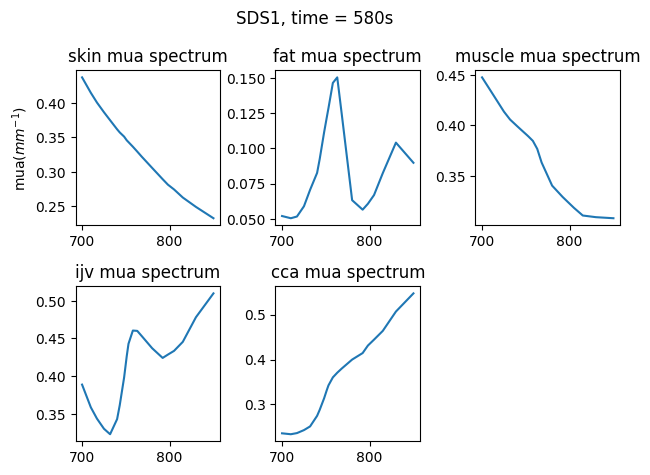

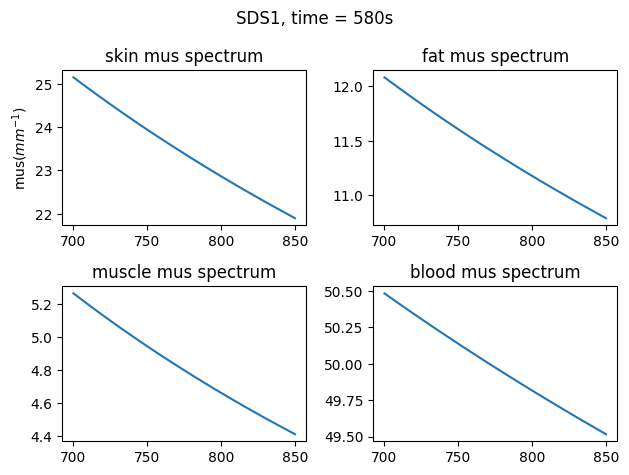

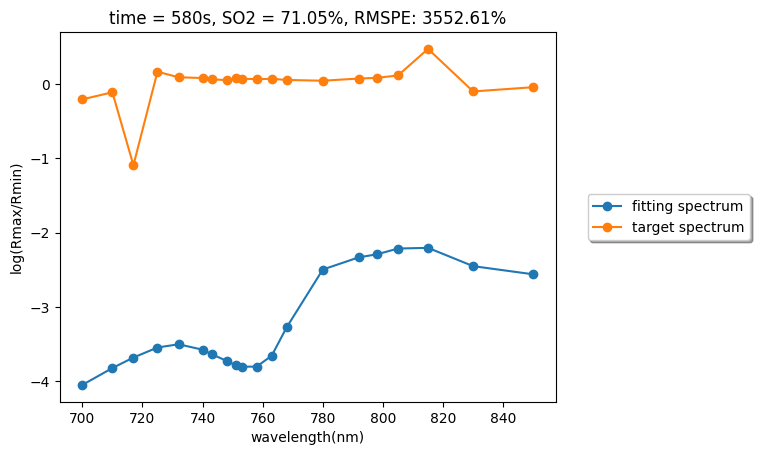

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

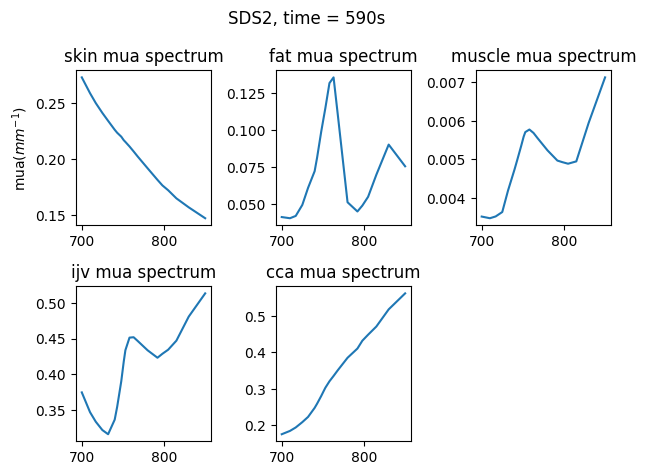

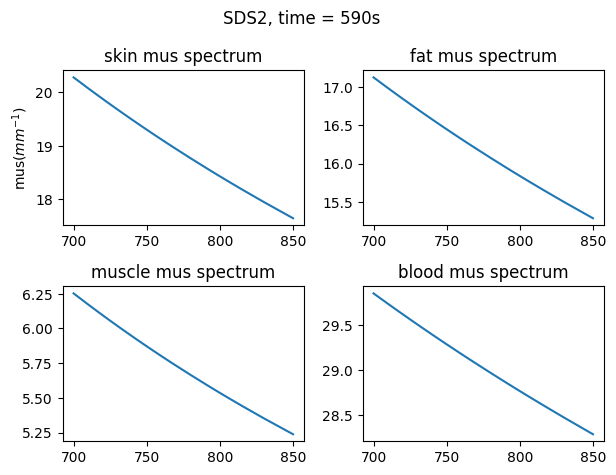

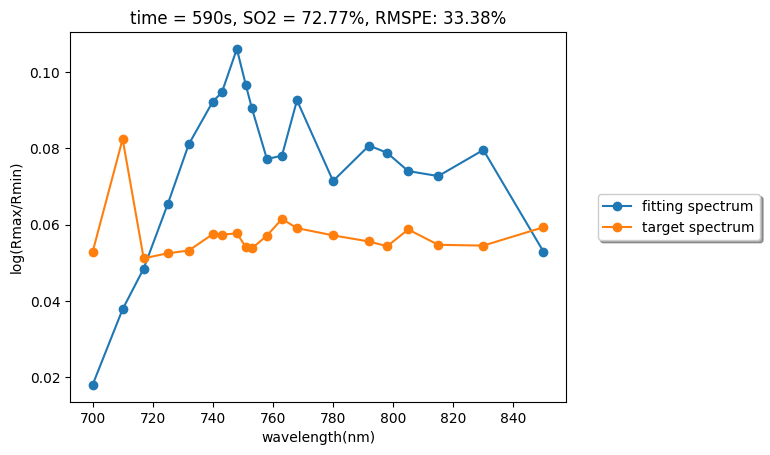

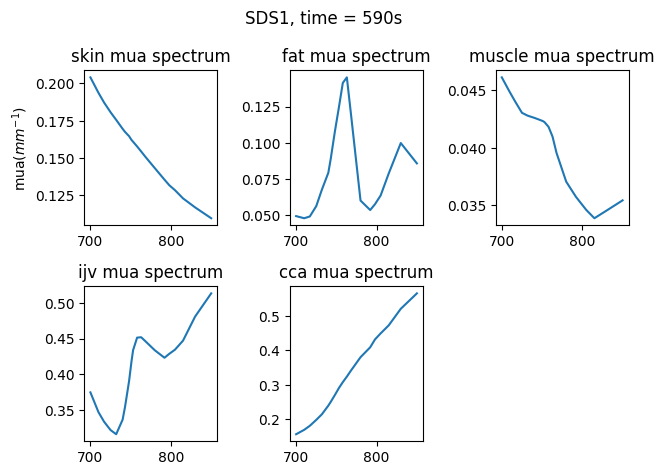

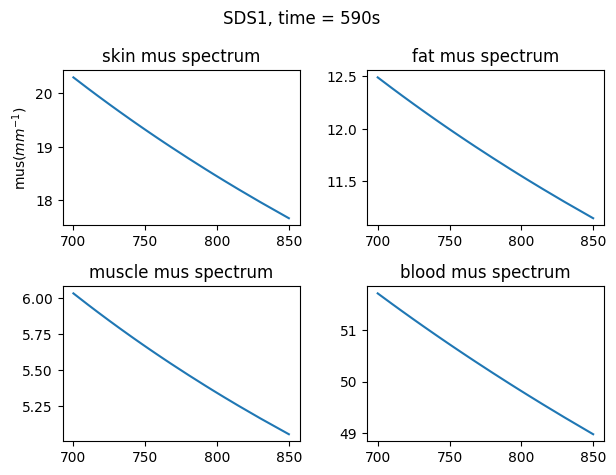

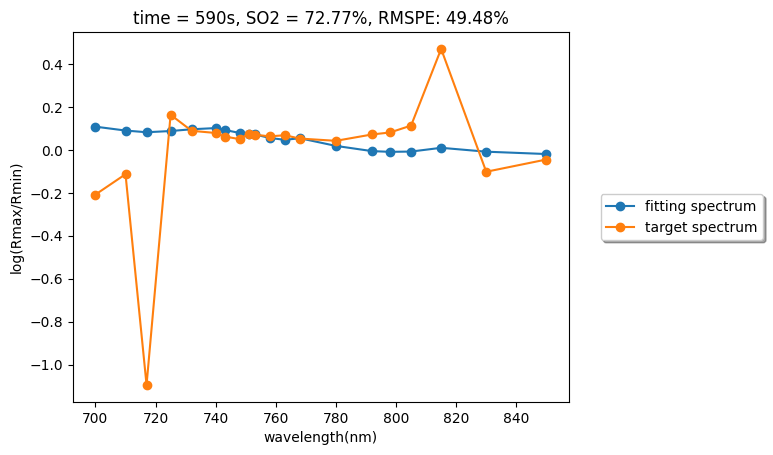

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

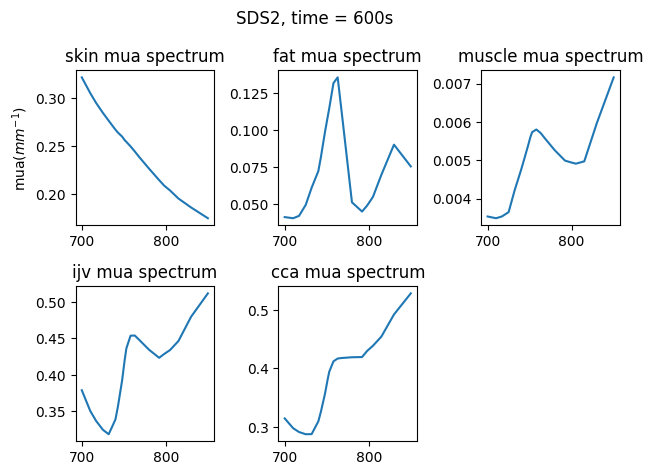

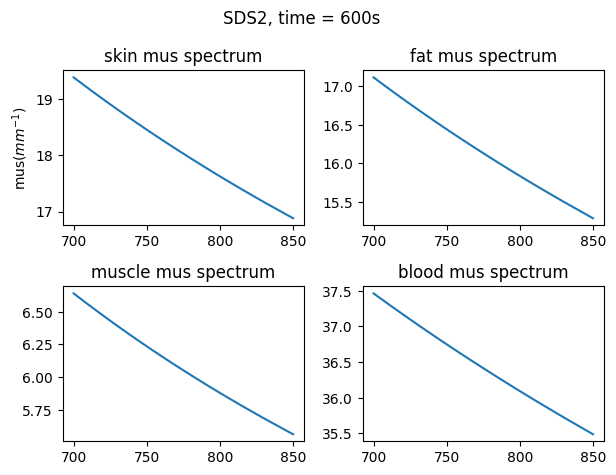

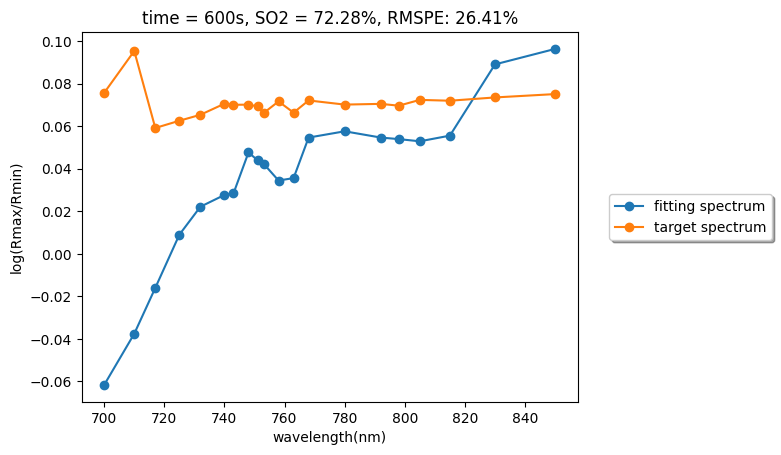

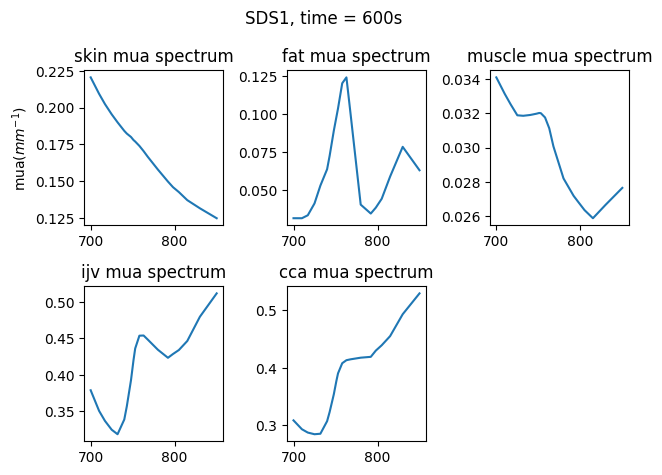

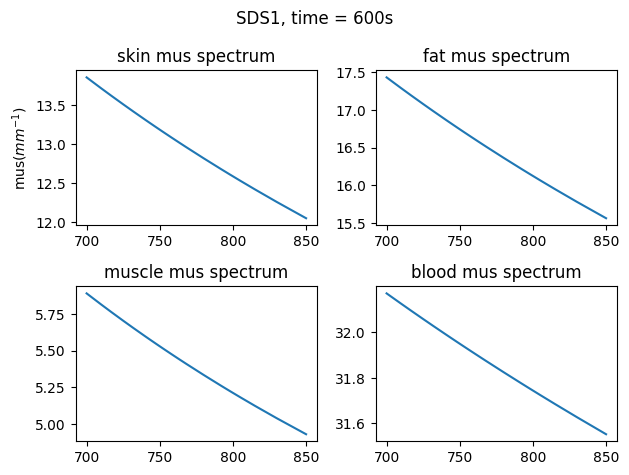

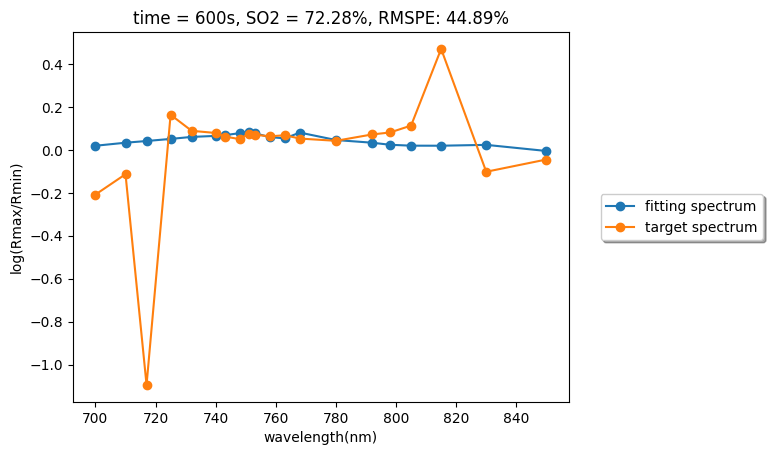

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

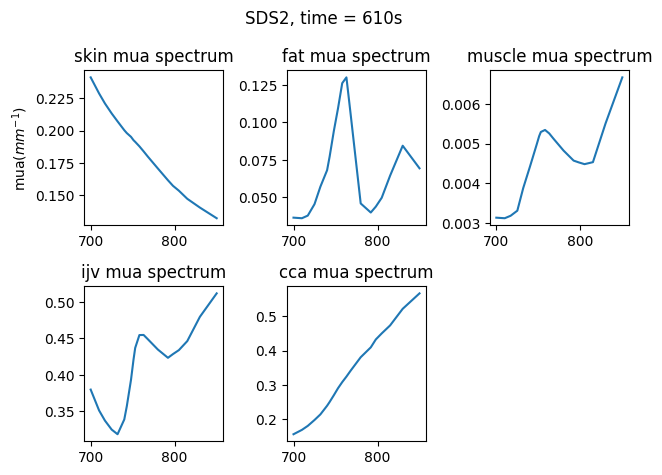

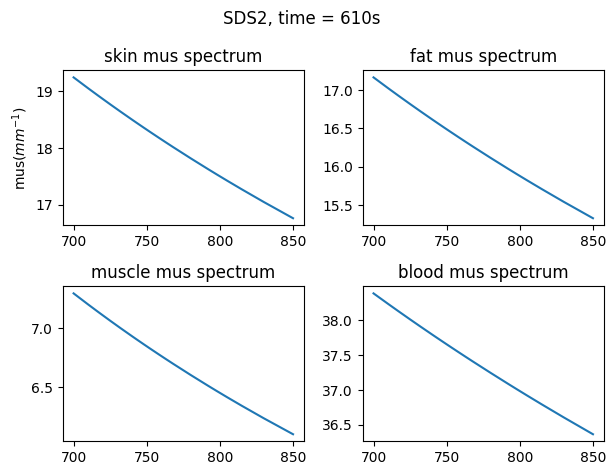

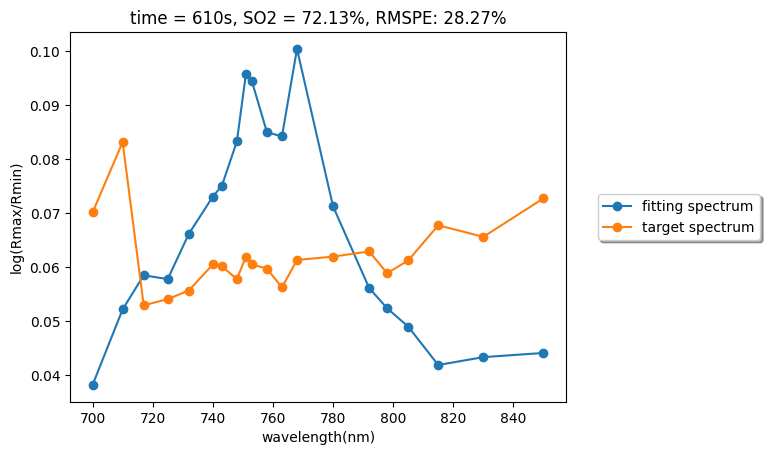

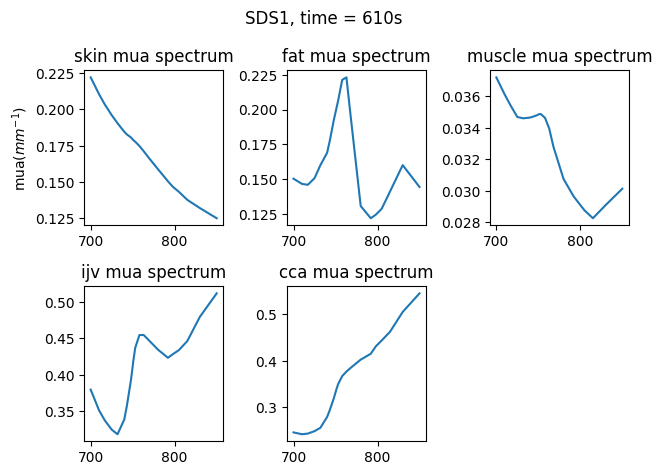

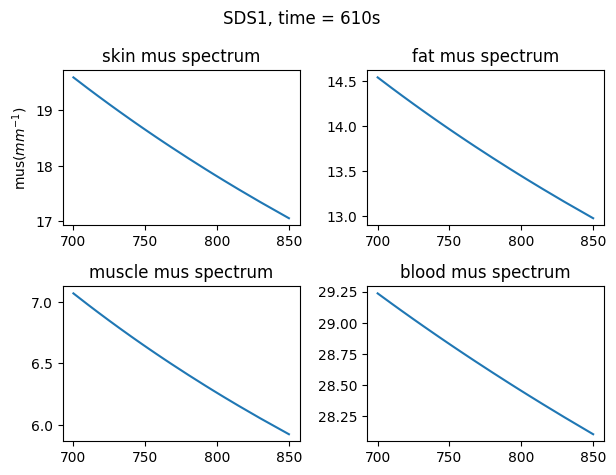

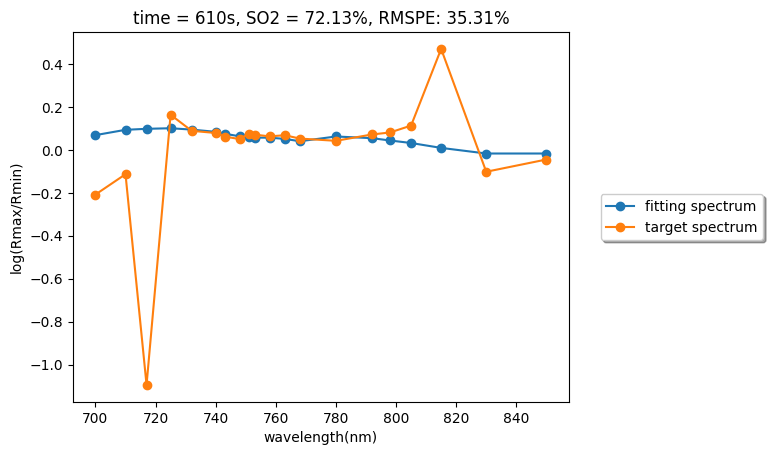

now run 0
now run 1
now run 2
now run 3
now run 4
now run 5
now run 6
now run 7
now run 8
now run 9
now run 10
now run 11
now run 12
now run 13
now run 14
now run 15
now run 16
now run 17
now run 18
now run 19
now run 20
now run 21
now run 22
now run 23
now run 24
now run 25
now run 26
now run 27
now run 28
now run 29
now run 30
now run 31
now run 32
now run 33
now run 34
now run 35
now run 36
now run 37
now run 38
now run 39
now run 40
now run 41
now run 42
now run 43
now run 44
now run 45
now run 46
now run 47
now run 48
now run 49
now run 50
now run 51
now run 52
now run 53
now run 54
now run 55
now run 56
now run 57
now run 58
now run 59
now run 60
now run 61
now run 62
now run 63
now run 64
now run 65
now run 66
now run 67
now run 68
now run 69
now run 70
now run 71
now run 72
now run 73
now run 74
now run 75
now run 76
now run 77
now run 78
now run 79
now run 80
now run 81
now run 82
now run 83
now run 84
now run 85
now run 86
now run 87
now run 88
now run 89
now run 90
now run 9

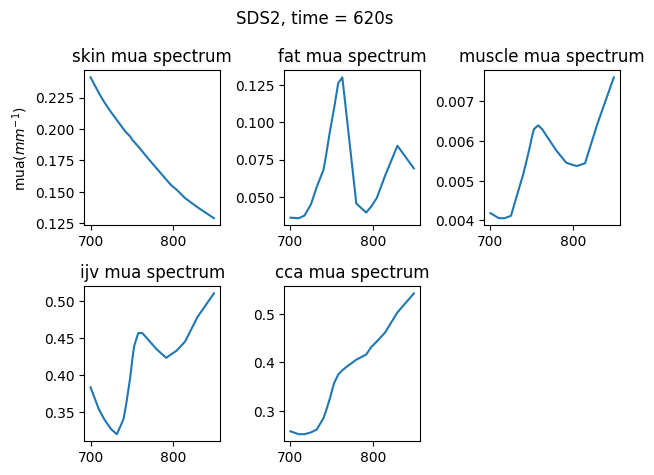

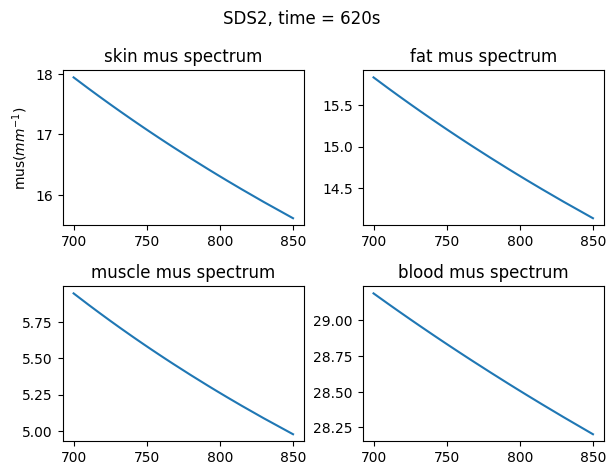

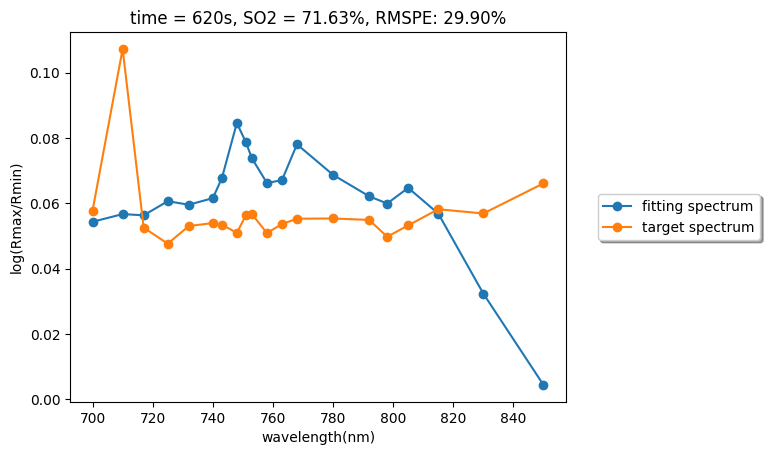

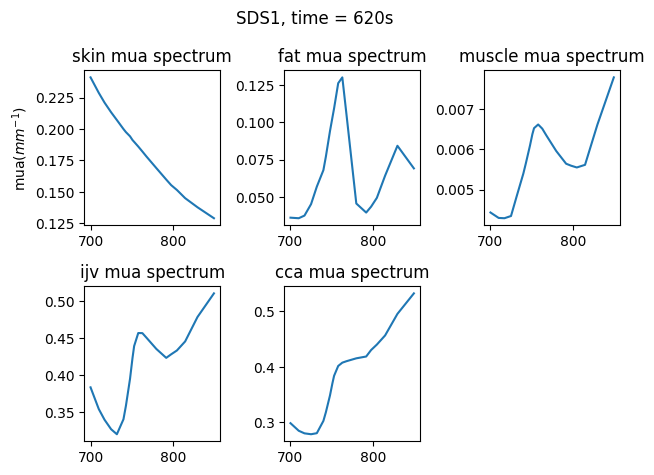

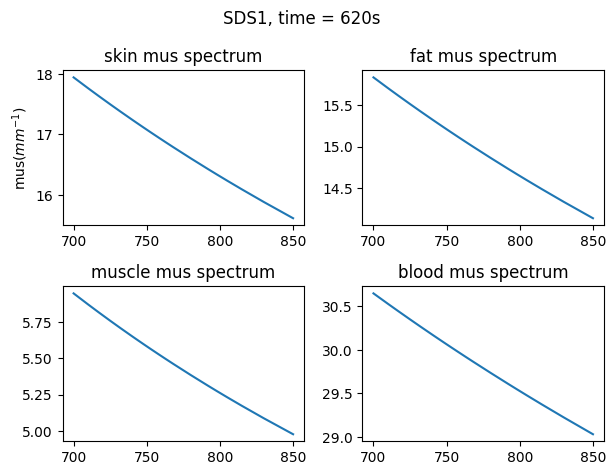

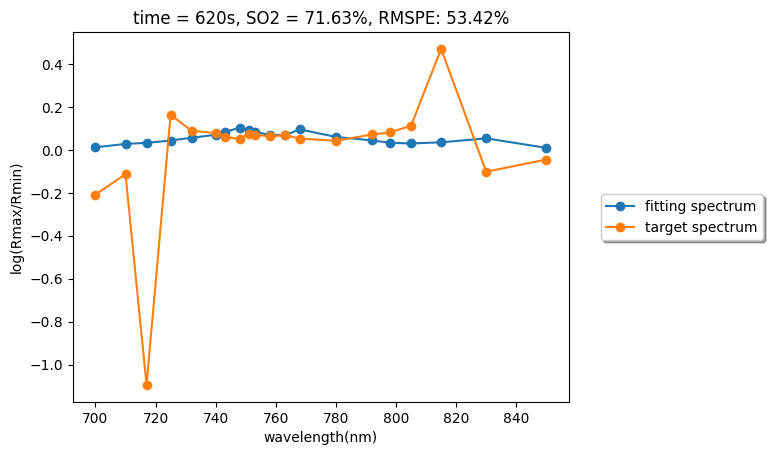

In [80]:

for t_idx, time in enumerate(range(10, recovery_end-50, 10)):
    if time == 0:
        # fit baseline go get stable superficial OPs
        need_fit_data_SDS1 = np.load(os.path.join("dataset", subject, 'SDS1', date, exp, f"SDS1_OD_baseline.npy"))
        need_fit_data_SDS2 = np.load(os.path.join("dataset", subject, 'SDS2', date, exp, f"SDS2_OD_baseline.npy"))
    else:
        # fit baseline go get stable superficial OPs
        need_fit_data_SDS1 = np.load(os.path.join("dataset", subject, 'SDS1', date, exp, f"SDS1_OD_baseline.npy"))
        need_fit_data_SDS2 = np.load(os.path.join("dataset", subject, 'SDS2', date, exp, f"SDS2_OD_{time}s.npy"))

    # 1st fit short 
    x0 = np.array([0.5*(mus_ab_bound['skin']['max'][0]+mus_ab_bound['skin']['min'][0]), 
                0.5*(mus_ab_bound['skin']['max'][1]+mus_ab_bound['skin']['min'][1]),
                0.5*(mus_ab_bound['fat']['max'][0]+mus_ab_bound['fat']['min'][0]), 
                0.5*(mus_ab_bound['fat']['max'][1]+mus_ab_bound['fat']['min'][1]),
                0.5*(mus_ab_bound['muscle']['max'][0]+mus_ab_bound['muscle']['min'][0]), 
                0.5*(mus_ab_bound['muscle']['max'][1]+mus_ab_bound['muscle']['min'][1]),
                0.5*(mus_ab_bound['blood']['max'][0]+mus_ab_bound['blood']['min'][0]), 
                0.5*(mus_ab_bound['blood']['max'][1]+mus_ab_bound['blood']['min'][1]),
                np.mean(absorbing_chromophores_frac['skin']['f_blood_bound']),
                np.mean(absorbing_chromophores_frac['skin']['SO2_bound']),
                np.mean(absorbing_chromophores_frac['skin']['f_fat_bound']),
                np.mean(absorbing_chromophores_frac['skin']['f_water_bound']),
                np.mean(absorbing_chromophores_frac['skin']['f_mel_bound']),
                np.mean(absorbing_chromophores_frac['skin']['f_col_bound']),
                np.mean(absorbing_chromophores_frac['fat']['f_blood_bound']),
                np.mean(absorbing_chromophores_frac['fat']['SO2_bound']),
                np.mean(absorbing_chromophores_frac['fat']['f_fat_bound']),
                np.mean(absorbing_chromophores_frac['fat']['f_water_bound']),
                np.mean(absorbing_chromophores_frac['fat']['f_mel_bound']),
                np.mean(absorbing_chromophores_frac['fat']['f_col_bound']),
                np.mean(absorbing_chromophores_frac['muscle']['f_blood_bound']),
                np.mean(absorbing_chromophores_frac['muscle']['SO2_bound']),
                np.mean(absorbing_chromophores_frac['muscle']['f_fat_bound']),
                np.mean(absorbing_chromophores_frac['muscle']['f_water_bound']),
                np.mean(absorbing_chromophores_frac['muscle']['f_mel_bound']),
                np.mean(absorbing_chromophores_frac['muscle']['f_col_bound']),
                np.mean(absorbing_chromophores_frac['ijv']['f_blood_bound']),
                np.mean(absorbing_chromophores_frac['ijv']['SO2_bound']),
                np.mean(absorbing_chromophores_frac['ijv']['f_fat_bound']),
                np.mean(absorbing_chromophores_frac['ijv']['f_water_bound']),
                np.mean(absorbing_chromophores_frac['ijv']['f_mel_bound']),
                np.mean(absorbing_chromophores_frac['ijv']['f_col_bound']),
                np.mean(absorbing_chromophores_frac['cca']['f_blood_bound']),
                np.mean(absorbing_chromophores_frac['cca']['SO2_bound']),
                np.mean(absorbing_chromophores_frac['cca']['f_fat_bound']),
                np.mean(absorbing_chromophores_frac['cca']['f_water_bound']),
                np.mean(absorbing_chromophores_frac['cca']['f_mel_bound']),
                np.mean(absorbing_chromophores_frac['cca']['f_col_bound']),
                ])

    bounds = ((mus_ab_bound['skin']['min'][0], mus_ab_bound['skin']['max'][0]), 
            (0.001, mus_ab_bound['skin']['max'][1]),
            (mus_ab_bound['fat']['min'][0], mus_ab_bound['fat']['max'][0]), 
            (mus_ab_bound['fat']['min'][1], mus_ab_bound['fat']['max'][1]),
            (mus_ab_bound['muscle']['min'][0], mus_ab_bound['muscle']['max'][0]), 
            (mus_ab_bound['muscle']['min'][1], mus_ab_bound['muscle']['max'][1]),
            (mus_ab_bound['blood']['min'][0], mus_ab_bound['blood']['max'][0]), 
            (mus_ab_bound['blood']['min'][1], mus_ab_bound['blood']['max'][1]),
            (absorbing_chromophores_frac['skin']['f_blood_bound'][0], absorbing_chromophores_frac['skin']['f_blood_bound'][1]),
            (absorbing_chromophores_frac['skin']['SO2_bound'][0], absorbing_chromophores_frac['skin']['SO2_bound'][1]),
            (0, 0),
            (absorbing_chromophores_frac['skin']['f_water_bound'][0], absorbing_chromophores_frac['skin']['f_water_bound'][1]),
            (absorbing_chromophores_frac['skin']['f_mel_bound'][0], absorbing_chromophores_frac['skin']['f_mel_bound'][1]),
            (0, None),
            (absorbing_chromophores_frac['fat']['f_blood_bound'][0], absorbing_chromophores_frac['fat']['f_blood_bound'][1]),
            (absorbing_chromophores_frac['fat']['SO2_bound'][0], absorbing_chromophores_frac['fat']['SO2_bound'][1]),
            (absorbing_chromophores_frac['fat']['f_fat_bound'][0], absorbing_chromophores_frac['fat']['f_fat_bound'][1]),
            (absorbing_chromophores_frac['fat']['f_water_bound'][0], absorbing_chromophores_frac['fat']['f_water_bound'][1]),
            (0, 0),
            (0, None),
            (absorbing_chromophores_frac['muscle']['f_blood_bound'][0], absorbing_chromophores_frac['muscle']['f_blood_bound'][1]),
            (absorbing_chromophores_frac['muscle']['SO2_bound'][0], absorbing_chromophores_frac['muscle']['SO2_bound'][1]),
            (0, 0),
            (absorbing_chromophores_frac['muscle']['f_water_bound'][0], absorbing_chromophores_frac['muscle']['f_water_bound'][1]),
            (0, 0),
            (0, None),
            (absorbing_chromophores_frac['ijv']['f_blood_bound'][0], absorbing_chromophores_frac['ijv']['f_blood_bound'][1]),
            (abs_SO2[t_idx], abs_SO2[t_idx]), # ijv SO2
            (0, 0),
            (absorbing_chromophores_frac['ijv']['f_water_bound'][0], absorbing_chromophores_frac['ijv']['f_water_bound'][1]),
            (0, 0),
            (0, 0),
            (absorbing_chromophores_frac['cca']['f_blood_bound'][0], absorbing_chromophores_frac['cca']['f_blood_bound'][1]),
            (absorbing_chromophores_frac['cca']['SO2_bound'][0], absorbing_chromophores_frac['cca']['SO2_bound'][1]),
            (0, 0),
            (absorbing_chromophores_frac['cca']['f_water_bound'][0], absorbing_chromophores_frac['cca']['f_water_bound'][1]),
            (0, 0),
            (0, 0)
            )
    weight = np.array([0.1, 0.1, 0.2, 0.2, 0.4, 0.4, 0.5, 0.7, 0.7, 0.8, 1, 1, 0.9, 0.8, 0.8, 0.9, 1, 0.7, 0.8, 1])
    channel = 0
    res = minimize(fun, x0, args=(need_fit_data_SDS1, weight, channel), method='SLSQP', bounds=bounds, tol=1e-6, options={'eps': 0.00000001, 'disp': False}) # 85s eps=0.00005,  long eps= 0.00000001
    # print('==========first phase==========')
    # print(res)
    best_res_short = res
    log_loss_short = [res.fun]

    # 2nd fit long
    x0 = res.x

    bounds = ((x0[0], x0[0]), 
            (x0[1], x0[1]),
            (x0[2], x0[2]), 
            (x0[3], x0[3]),
            (x0[4], x0[4]), 
            (x0[5], x0[5]),
            (mus_ab_bound['blood']['min'][0], mus_ab_bound['blood']['max'][0]), 
            (mus_ab_bound['blood']['min'][1], mus_ab_bound['blood']['max'][1]),
            (x0[8], x0[8]),
            (x0[9], x0[9]),
            (0, 0),
            (x0[11], x0[11]),
            (x0[12], x0[12]),
            (x0[13], x0[13]),
            (x0[14], x0[14]),
            (x0[15], x0[15]),
            (x0[16], x0[16]),
            (x0[17], x0[17]),
            (0, 0),
            (x0[19], x0[19]),
            (x0[20], x0[20]),
            (x0[21], x0[21]),
            (0, 0),
            (x0[23], x0[23]),
            (0, 0),
            (0, None), # muscle col
            (absorbing_chromophores_frac['ijv']['f_blood_bound'][0], absorbing_chromophores_frac['ijv']['f_blood_bound'][1]),
            (abs_SO2[t_idx], abs_SO2[t_idx]), # ijv SO2
            (0, 0),
            (absorbing_chromophores_frac['ijv']['f_water_bound'][0], absorbing_chromophores_frac['ijv']['f_water_bound'][1]),
            (0, 0),
            (0, 0),
            (absorbing_chromophores_frac['cca']['f_blood_bound'][0], absorbing_chromophores_frac['cca']['f_blood_bound'][1]),
            (absorbing_chromophores_frac['cca']['SO2_bound'][0], absorbing_chromophores_frac['cca']['SO2_bound'][1]),
            (0, 0),
            (absorbing_chromophores_frac['cca']['f_water_bound'][0], absorbing_chromophores_frac['cca']['f_water_bound'][1]),
            (0, 0),
            (0, 0)
            )
    weight = np.array([0.1, 0.1, 0.2, 0.2, 0.4, 0.4, 0.5, 0.7, 0.7, 0.8, 1, 1, 0.9, 0.8, 0.8, 0.9, 1, 0.7, 0.8, 1])
    channel = 1
    res = minimize(fun, x0, args=(need_fit_data_SDS2, weight, channel), method='SLSQP', bounds=bounds, tol=1e-6, options={'eps': 0.00005, 'disp': False}) # 85s eps=0.00005,  long eps= 0.00000001
    # print('==========second phase==========')
    # print(res)
    best_res_long = res
    log_loss_long = [res.fun]

    for i in range(100):
        print(f"now run {i}")
        # 3rd fit short
        x0 = res.x

        bounds = ((mus_ab_bound['skin']['min'][0], mus_ab_bound['skin']['max'][0]), 
                (0.001, mus_ab_bound['skin']['max'][1]),
                (mus_ab_bound['fat']['min'][0], mus_ab_bound['fat']['max'][0]), 
                (mus_ab_bound['fat']['min'][1], mus_ab_bound['fat']['max'][1]),
                (mus_ab_bound['muscle']['min'][0], mus_ab_bound['muscle']['max'][0]), 
                (mus_ab_bound['muscle']['min'][1], mus_ab_bound['muscle']['max'][1]),
                (x0[6], x0[6]), 
                (x0[7], x0[7]),
                (absorbing_chromophores_frac['skin']['f_blood_bound'][0], absorbing_chromophores_frac['skin']['f_blood_bound'][1]),
                (absorbing_chromophores_frac['skin']['SO2_bound'][0], absorbing_chromophores_frac['skin']['SO2_bound'][1]),
                (0, 0),
                (absorbing_chromophores_frac['skin']['f_water_bound'][0], absorbing_chromophores_frac['skin']['f_water_bound'][1]),
                (absorbing_chromophores_frac['skin']['f_mel_bound'][0], absorbing_chromophores_frac['skin']['f_mel_bound'][1]),
                (0, None),
                (absorbing_chromophores_frac['fat']['f_blood_bound'][0], absorbing_chromophores_frac['fat']['f_blood_bound'][1]),
                (absorbing_chromophores_frac['fat']['SO2_bound'][0], absorbing_chromophores_frac['fat']['SO2_bound'][1]),
                (absorbing_chromophores_frac['fat']['f_fat_bound'][0], absorbing_chromophores_frac['fat']['f_fat_bound'][1]),
                (absorbing_chromophores_frac['fat']['f_water_bound'][0], absorbing_chromophores_frac['fat']['f_water_bound'][1]),
                (0, 0),
                (0, None),
                (absorbing_chromophores_frac['muscle']['f_blood_bound'][0], absorbing_chromophores_frac['muscle']['f_blood_bound'][1]),
                (absorbing_chromophores_frac['muscle']['SO2_bound'][0], absorbing_chromophores_frac['muscle']['SO2_bound'][1]),
                (0, 0),
                (absorbing_chromophores_frac['muscle']['f_water_bound'][0], absorbing_chromophores_frac['muscle']['f_water_bound'][1]),
                (0, 0),
                (0, None),
                (x0[26], x0[26]),
                (abs_SO2[t_idx], abs_SO2[t_idx]), # ijv SO2
                (0, 0),
                (x0[29], x0[29]),
                (0, 0),
                (0, 0),
                (x0[32], x0[32]),
                (x0[33], x0[33]),
                (0, 0),
                (x0[35], x0[35]),
                (0, 0),
                (0, 0)
                )
        weight = np.array([0.1, 0.1, 0.2, 0.2, 0.4, 0.4, 0.5, 0.7, 0.7, 0.8, 1, 1, 0.9, 0.8, 0.8, 0.9, 1, 0.7, 0.8, 1])
        channel = 0
        res = minimize(fun, x0, args=(need_fit_data_SDS1, weight, channel), method='SLSQP', bounds=bounds, tol=1e-6, options={'eps': 0.00000001, 'disp': False}) # 85s eps=0.00005,  long eps= 0.00000001
        # print('==========third phase==========')
        # print(res)
        log_loss_short += [res.fun]
        if res.fun < best_res_short.fun:
            best_res_short = res

        
        # # 4th fit long
        x0 = res.x

        bounds = ((x0[0], x0[0]), 
                (x0[1], x0[1]),
                (x0[2], x0[2]), 
                (x0[3], x0[3]),
                (x0[4], x0[4]), 
                (x0[5], x0[5]),
                (mus_ab_bound['blood']['min'][0], mus_ab_bound['blood']['max'][0]), 
                (mus_ab_bound['blood']['min'][1], mus_ab_bound['blood']['max'][1]),
                (x0[8], x0[8]),
                (x0[9], x0[9]),
                (0, 0),
                (x0[11], x0[11]),
                (x0[12], x0[12]),
                (x0[13], x0[13]),  # skin col
                (x0[14], x0[14]),
                (x0[15], x0[15]),
                (x0[16], x0[16]),
                (x0[17], x0[17]), 
                (0, 0),
                (x0[19], x0[19]), # fat col
                (x0[20], x0[20]),
                (x0[21], x0[21]),
                (0, 0),
                (x0[23], x0[23]),
                (0, 0),
                (0, None), # muscle col
                (absorbing_chromophores_frac['ijv']['f_blood_bound'][0], absorbing_chromophores_frac['ijv']['f_blood_bound'][1]),
                (abs_SO2[t_idx], abs_SO2[t_idx]), # ijv SO2
                (0, 0),
                (absorbing_chromophores_frac['ijv']['f_water_bound'][0], absorbing_chromophores_frac['ijv']['f_water_bound'][1]),
                (0, 0),
                (0, 0),
                (absorbing_chromophores_frac['cca']['f_blood_bound'][0], absorbing_chromophores_frac['cca']['f_blood_bound'][1]),
                (absorbing_chromophores_frac['cca']['SO2_bound'][0], absorbing_chromophores_frac['cca']['SO2_bound'][1]),
                (0, 0),
                (absorbing_chromophores_frac['cca']['f_water_bound'][0], absorbing_chromophores_frac['cca']['f_water_bound'][1]),
                (0, 0),
                (0, 0)
                )
        weight = np.array([0.1, 0.1, 0.2, 0.2, 0.4, 0.4, 0.5, 0.7, 0.7, 0.8, 1, 1, 0.9, 0.8, 0.8, 0.9, 1, 0.7, 0.8, 1])
        channel = 1
        res = minimize(fun, x0, args=(need_fit_data_SDS2, weight, channel), method='SLSQP', bounds=bounds, tol=1e-6, options={'eps': 0.00005, 'disp': False}) # 85s eps=0.00005,  long eps= 0.00000001
        # print('==========forth phase==========')
        # print(res)
        log_loss_long += [res.fun]
        if res.fun < best_res_long.fun:
            best_res_long = res
            
    plot_fitting_result(time=time, using_SDS="SDS2", args=best_res_long, log_loss_short=log_loss_short, log_loss_long=log_loss_long, weight=weight, need_fit_data=need_fit_data_SDS2)
    plot_fitting_result(time=time, using_SDS="SDS1", args=best_res_short, log_loss_short=log_loss_short, log_loss_long=log_loss_long, weight=weight, need_fit_data=need_fit_data_SDS1)


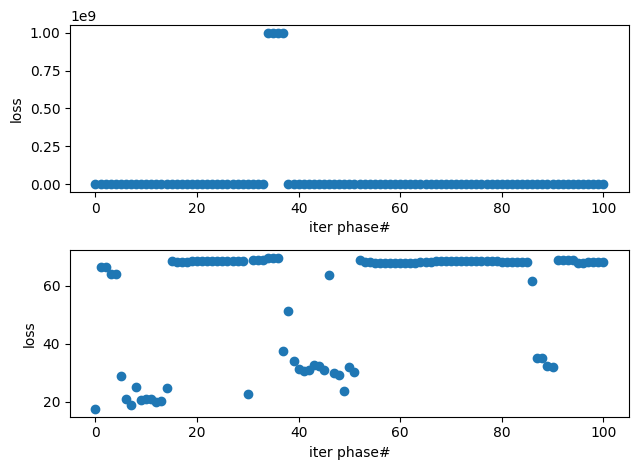

In [73]:
time = 0
using_SDS = "SDS2"
args = best_res_long

fig = plt.figure()
if time == 0:
    fig.suptitle(f"loss {using_SDS}, basline")
else:
    fig.suptitle(f"loss {using_SDS}, time = {time}s")
ax = plt.subplot(2, 1, 1)
ax.plot(log_loss_short, 'o')
ax.set_ylabel("loss")
ax.set_xlabel("fitting phase#")

ax = plt.subplot(2, 1, 2)
ax.plot(log_loss_long, 'o')
ax.set_ylabel("loss")
ax.set_xlabel("fitting phase#")
plt.tight_layout()
if time == 0:
    plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "loss", f'baseline_loss.png'), dpi=300, format='png', bbox_inches='tight')
else:
    plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "loss", f'{time}s_loss.png'), dpi=300, format='png', bbox_inches='tight')
plt.close()

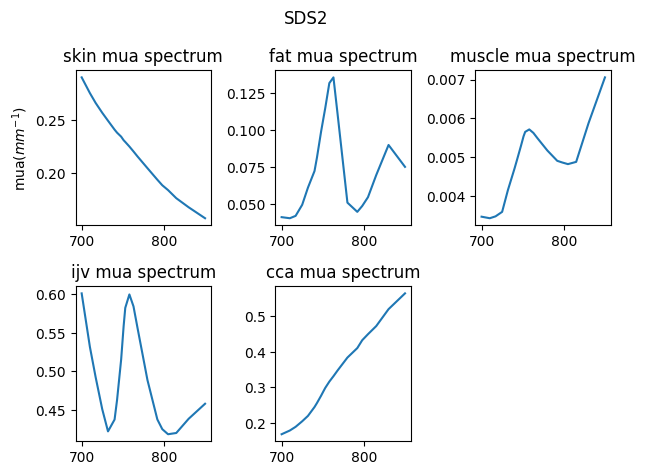

In [62]:
time = 0
using_SDS = "SDS2"
args = best_res_long

fig = plt.figure()
if time == 0:
    fig.suptitle(f"{using_SDS}, basline")
else:
    fig.suptitle(f"{using_SDS}, time = {time}s")

skin_mua_spec = calculateMua(*args.x[8:14]).reshape(-1, 1) 
ax = plt.subplot(2, 3, 1)
ax.set_title('skin mua spectrum')
ax.plot(wavelength, skin_mua_spec)
ax.set_ylabel("mua($mm^{-1}$)")

fat_mua_spec = calculateMua(*args.x[14:20]).reshape(-1, 1) 
ax = plt.subplot(2, 3, 2)
ax.set_title('fat mua spectrum')
ax.plot(wavelength, fat_mua_spec)

muscle_mua_spec = calculateMua(*args.x[20:26]).reshape(-1, 1) 
ax = plt.subplot(2, 3, 3)
ax.set_title('muscle mua spectrum')
ax.plot(wavelength, muscle_mua_spec)

ijv_mua_spec = calculateMua(*args.x[26:32]).reshape(-1, 1) 
ax = plt.subplot(2, 3, 4)
ax.set_title('ijv mua spectrum')
ax.plot(wavelength, ijv_mua_spec)

cca_mua_spec = calculateMua(*args.x[32:38]).reshape(-1, 1) 
ax = plt.subplot(2, 3, 5)
ax.set_title('cca mua spectrum')
ax.plot(wavelength, cca_mua_spec)


plt.tight_layout()
if time == 0:
    plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "mua", 'baseline_mua.png'), dpi=300, format='png', bbox_inches='tight')
else:
    plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "mua", f'{time}s_mua.png'), dpi=300, format='png', bbox_inches='tight')
plt.close()



In [83]:
import cv2 
import os
import random
from glob import glob
from natsort import natsorted

def plot_fitting_video(path):
    files = glob(os.path.join(path, '*.png'))
    files = natsorted(files)
    img = cv2.imread(files[0])
    fps = 3
    size = (img.shape[1], img.shape[0]) # 寬 和 高
    print(size)
    fourcc = cv2.VideoWriter_fourcc('m', 'p', '4', 'v') #影片編碼格式
    videoWrite = cv2.VideoWriter(os.path.join(path, 'video.mp4'), fourcc, fps, size)


    # images = [img for img in os.listdir(os.path.join('pic', subject, f'{date}_invivo_result',  'MBLL')) if img.endswith(".png")]
    out_num = len(files)
    for i in range(0, out_num, 1):
        fileName = files[i]
        img = cv2.imread(fileName)
        img = cv2.resize(img, size, interpolation = cv2.INTER_AREA)
        videoWrite.write(img)
    videoWrite.release()


using_SDS = 'SDS1'
path = os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "spectrum")
plot_fitting_video(path)
path = os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "mus")
plot_fitting_video(path)
path = os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "mua")
plot_fitting_video(path)
# path = os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "loss")
# plot_fitting_video(path)


(2319, 1361)
(1836, 1426)
(1984, 1426)


In [23]:
fitting_SO2 = []
for time in range(10, recovery_end-10, 10):
    chromophore_set = pd.read_csv(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "chromophore", f"{time}s_chromophore.csv"))
    fitting_SO2 += [chromophore_set['SO2'][3]]
fitting_SO2 = np.array(fitting_SO2)
np.save(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "chromophore", f"fitting_SO2.npy"), fitting_SO2)

In [65]:
time = 0
using_SDS = "SDS2"
args = best_res_long

skin_mua_consist = args.x[8:14].reshape(1,-1)
fat_mua_consist = args.x[14:20].reshape(1,-1)
muscle_mua_consist = args.x[20:26].reshape(1,-1)
ijv_mua_consist = args.x[26:32].reshape(1,-1)
cca_mua_consist = args.x[32:38].reshape(1,-1)

mua_chromophore_array = np.concatenate((skin_mua_consist, fat_mua_consist, muscle_mua_consist,
                                        ijv_mua_consist, cca_mua_consist))
df = pd.DataFrame(mua_chromophore_array, columns=['f_blood', 'SO2', 'f_fat', 'f_water', 'f_mel', 'fol'], 
                  index=['skin', 'fat', 'muscle', 'ijv', 'cca'])
if time == 0:
    df.to_csv(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "chromophore", 'baseline_chromophore.csv'))
else:
    df.to_csv(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "chromophore", f'{time}s_chromophore.csv'))


,f_blood,SO2,f_fat,f_water,f_mel,fol
skin,0.019222,0.700000,0.00000,0.720000,0.013175,0.150000
fat,0.023266,0.700351,0.97748,0.100000,0.000000,0.098016
muscle,0.007237,0.699387,0.00000,0.848557,0.000000,0.007969
ijv,1.000000,0.446537,0.00000,0.000000,0.000000,0.000000
cca,1.000000,0.984037,0.00000,0.000000,0.000000,0.000000


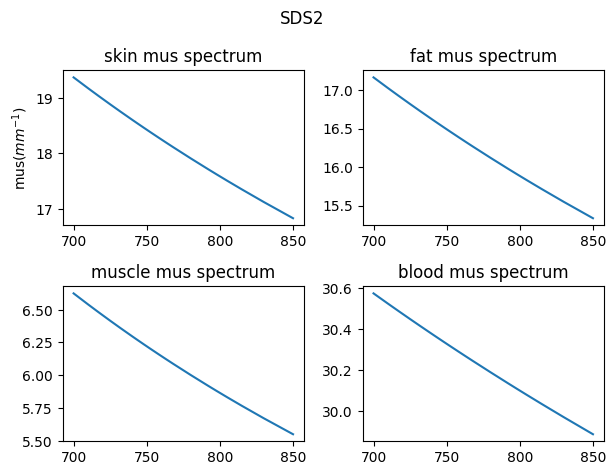

In [63]:
time = 0
using_SDS = "SDS2"
args = best_res_long

fig = plt.figure()
if time == 0:
    fig.suptitle(f"{using_SDS}, baseline")
else:
    fig.suptitle(f"{using_SDS}, time = {time}s")

a1, k1 = args.x[0], args.x[1]
ax = plt.subplot(2, 2, 1)
ax.set_title('skin mus spectrum')
ax.plot(wavelength, calculateMus('skin', a1, k1).reshape(-1, 1))
ax.set_ylabel("mus($mm^{-1}$)")

a2, k2 = args.x[2], args.x[3]
ax = plt.subplot(2, 2, 2)
ax.set_title('fat mus spectrum')
ax.plot(wavelength, calculateMus('fat', a2, k2).reshape(-1, 1) )

a3, k3 = args.x[4], args.x[5]
ax = plt.subplot(2, 2, 3)
ax.set_title('muscle mus spectrum')
ax.plot(wavelength, calculateMus('muscle', a3, k3).reshape(-1, 1) )

a4, k4 = args.x[6], args.x[7]
ax = plt.subplot(2, 2, 4)
ax.set_title('blood mus spectrum')
ax.plot(wavelength, calculateMus('blood', a4, k4).reshape(-1, 1) )
plt.tight_layout()
if time == 0:
    plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "mus", 'baseline_mus.png'), dpi=300, format='png', bbox_inches='tight')
else:
    plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "mus", f'{time}s_mus.png'), dpi=300, format='png', bbox_inches='tight')
plt.close()

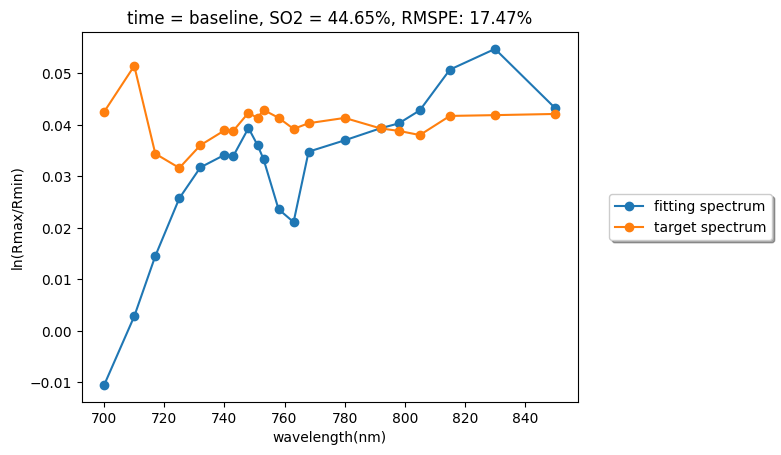

In [71]:
time = 0
args = best_res_long.x
using_SDS = "SDS2"
# mus

a1, k1 = args[0], args[1]
a2, k2 = args[2], args[3]
a3, k3 = args[4], args[5]
a4, k4 = args[6], args[7]
skin_mus_spec = calculateMus('skin', a1, k1).reshape(-1, 1) 
fat_mus_spec = calculateMus('fat', a2, k2).reshape(-1, 1) 
muscle_mus_spec = calculateMus('muscle', a3, k3).reshape(-1, 1)
ijv_mus_spec = calculateMus('blood', a4, k4).reshape(-1, 1)
cca_mus_spec = ijv_mus_spec.copy()
mus_spec = np.concatenate((skin_mus_spec, fat_mus_spec, muscle_mus_spec, ijv_mus_spec, cca_mus_spec), axis=1)

# mua
skin_mua_spec = calculateMua(*args[8:14]).reshape(-1, 1) 
fat_mua_spec = calculateMua(*args[14:20]).reshape(-1, 1) 
muscle_mua_spec = calculateMua(*args[20:26]).reshape(-1, 1) 
ijv_mua_spec = calculateMua(*args[26:32]).reshape(-1, 1) 
cca_mua_spec = calculateMua(*args[32:38]).reshape(-1, 1) 
mua_spec = np.concatenate((skin_mua_spec, fat_mua_spec, muscle_mua_spec, ijv_mua_spec, cca_mua_spec), axis=1)

OPs2 = np.concatenate((mus_spec, mua_spec), axis=1)
OPs2_normalized = OPs_normalized(OPs2)
ln_R_large = large_ANN_model(OPs2_normalized.to(torch.float32).cuda())
R_large = torch.exp(-ln_R_large).detach().cpu().numpy() + 1e-9
ln_R_small = small_ANN_model(OPs2_normalized.to(torch.float32).cuda())
R_small = torch.exp(-ln_R_small).detach().cpu().numpy() + 1e-9
predict_RmaxRmin_2 = np.log(R_small/R_large + 1e-9)
# predict_RmaxRmin_2 = R_large
if time == 0:
    plt.title(f'baseline, SO2 = {args[-11]*100:.2f}%, RMSPE: {np.sqrt(np.mean(np.square(100*weight*(predict_RmaxRmin_2[:,1] - need_fit_data_SDS2)/need_fit_data_SDS2))):.2f}%')
else:
    plt.title(f'{time}, SO2 = {args[-11]*100:.2f}%, RMSPE: {np.sqrt(np.mean(np.square(100*weight*(predict_RmaxRmin_2[:,1] - need_fit_data_SDS2)/need_fit_data_SDS2))):.2f}%')
plt.plot(wavelength, predict_RmaxRmin_2[:,1], 'o-', label='fitting spectrum')
plt.plot(wavelength, need_fit_data_SDS2, 'o-', label="target spectrum")
plt.ylabel("ln(Rmax/Rmin)")
plt.xlabel("wavelength(nm)")
plt.legend(loc='center left', bbox_to_anchor=(1.05, 0.5),
          fancybox=True, shadow=True)
if time == 0:
    plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "mus", 'baseline_spectrum.png'), dpi=300, format='png', bbox_inches='tight')
else:
    plt.savefig(os.path.join('pic', subject, f'{date}_invivo_result', exp, "fitting", using_SDS, "fit_result_OPs", "mus", f'{time}s_spectrum.png'), dpi=300, format='png', bbox_inches='tight')
plt.close()